# Đọc BIDMC

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [18],
        [18],
        [18],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [18],
        [17],
        [17],
        [17],
        [18],
        [18],
        [18],
        [18],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
        [17],
     

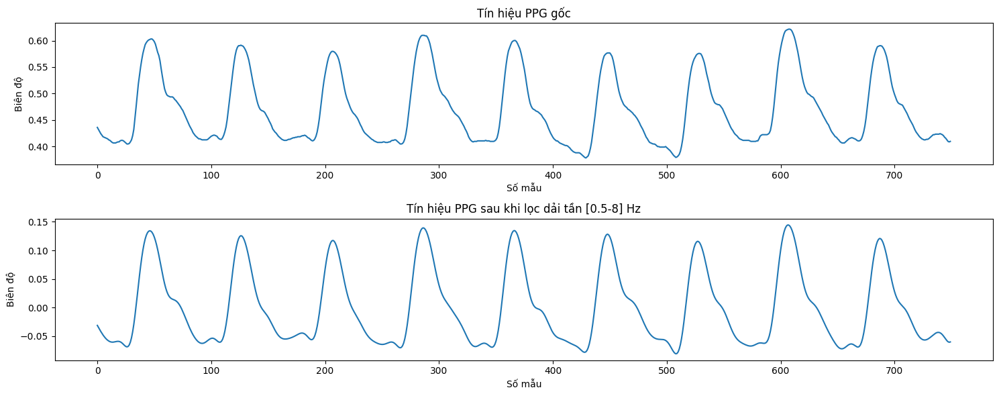

Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [19],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
        [20],
     

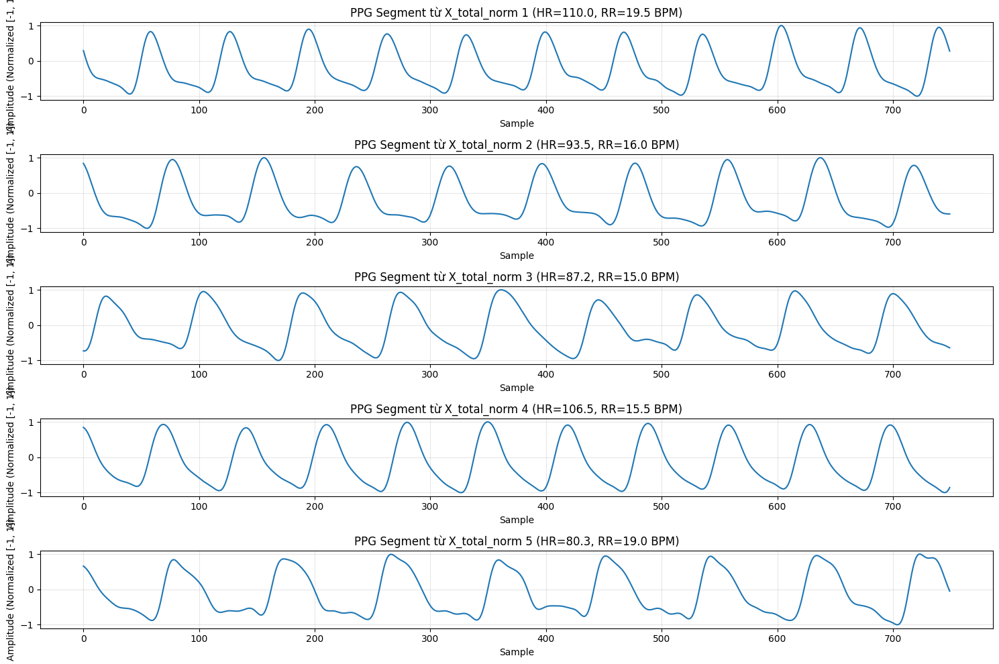

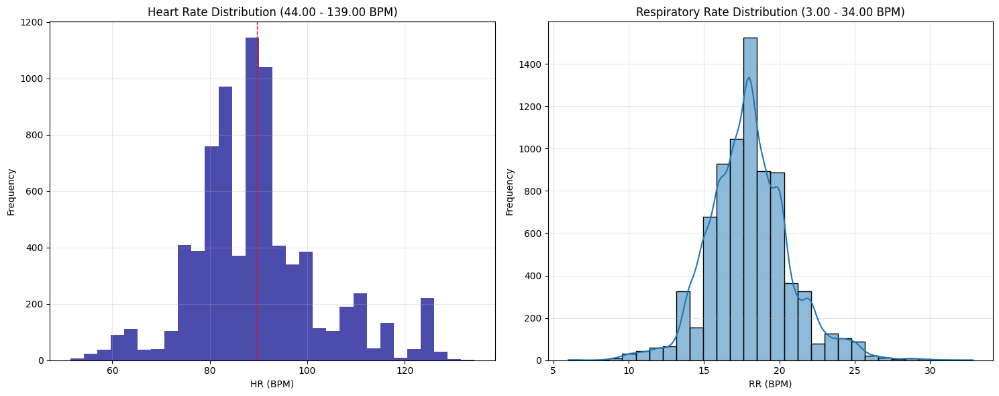

Đã lưu dữ liệu vào file 'processed_bidmc_data_with_rr.mat')
- Kích thước tập huấn luyện: (6232, 750)
- Kích thước tập kiểm thử: (1559, 750)


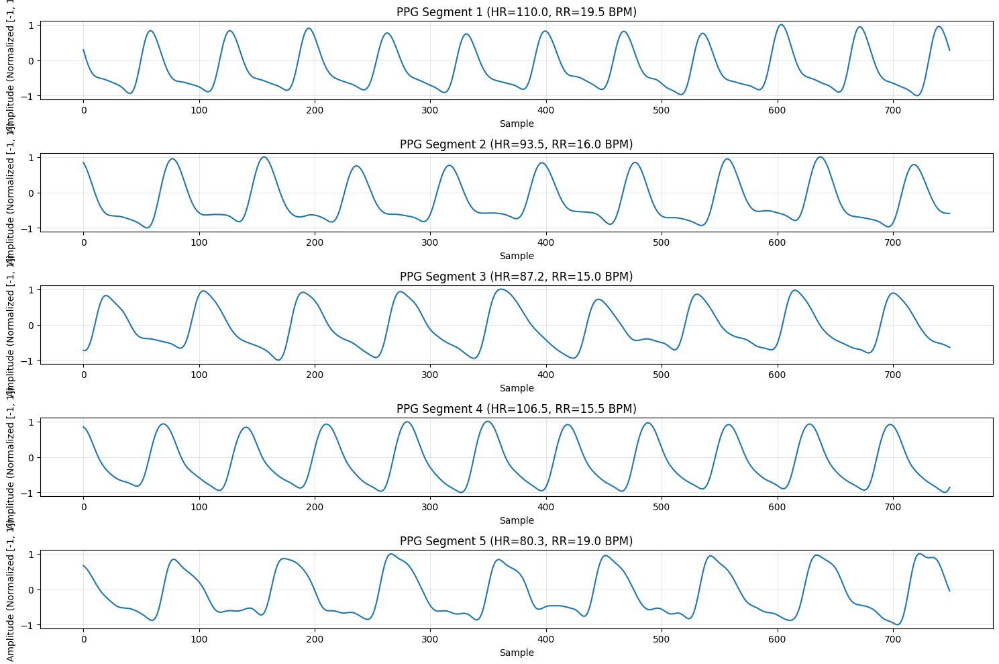


Tiền xử lý dữ liệu hoàn tất. Dữ liệu đã được lưu vào thư mục processed.


In [ ]:
import numpy as np
import scipy.io as sio
import os
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
from scipy import signal
import seaborn as sns

# Sửa đường dẫn để phù hợp với vị trí thực tế của file
data_path = '/content/drive/MyDrive/Big/bidmc/bidmc_data.mat'

# Tạo thư mục figures và processed trong Google Drive
figures_path = '/content/drive/MyDrive/Big/bidmc/figures/'
processed_path = '/content/drive/MyDrive/Big/bidmc/processed/'

os.makedirs(processed_path, exist_ok=True)
os.makedirs(figures_path, exist_ok=True)

# Tải dữ liệu
print("Đang tải dữ liệu từ file .mat...")
mat_data = sio.loadmat(data_path)
data = mat_data['data'][0]  # 53 bản ghi
print(f"Số lượng bản ghi: {len(data)}")

# Tham số
fs = 125  # Tần số lấy mẫu (Hz)
segment_length = 750  # 6 giây (750 mẫu)
overlap = 0.5  # 50% chồng lấp

# Hàm kiểm tra và trích xuất mảng phẳng
def extract_flat_array(data, field='v', record_idx=None):
    try:
        if hasattr(data, 'dtype') and data.dtype.names is not None and field in data.dtype.names:
            values = data[field]
            print(f"- Bản ghi {record_idx}: Tìm thấy trường '{field}', shape ban đầu: {values.shape}")
        else:
            values = data
            print(f"- Bản ghi {record_idx}: Không có trường '{field}', shape ban đầu: {values.shape}")

        # Kiểm tra nội dung
        print(f"- Nội dung của '{field}' (5 phần tử đầu): {values[:5]}")

        # Xử lý mảng lồng nhau
        if values.size == 1 and isinstance(values[0], np.ndarray):
            flat_values = values[0].flatten()
            print(f"- Phát hiện mảng lồng nhau, shape sau khi trích xuất: {flat_values.shape}")
        else:
            flat_values = values.flatten()

        if len(flat_values) == 0:
            raise ValueError("Mảng trống sau khi flatten")

        # Kiểm tra giá trị nan
        if np.any(np.isnan(flat_values)):
            raise ValueError(f"Mảng chứa giá trị nan: {flat_values[:5]}...")

        return flat_values.astype(float)
    except Exception as e:
        raise ValueError(f"Lỗi trích xuất: {e}")

# Hàm tính RR từ tín hiệu hô hấp
def compute_rr_from_resp(resp_signal, fs, record_idx):
    try:
        nyquist = fs / 2
        low_cutoff = 0.1 / nyquist
        high_cutoff = 1.0 / nyquist
        b, a = signal.butter(4, [low_cutoff, high_cutoff], btype='band')
        resp_filtered = signal.filtfilt(b, a, resp_signal)

        peaks, _ = signal.find_peaks(resp_filtered, distance=int(fs * 2))  # Min 2s giữa các hơi thở
        time_seconds = len(resp_signal) / fs
        rr_bpm = (len(peaks) / time_seconds) * 60
        print(f"- Bản ghi {record_idx}: RR ước tính: {rr_bpm:.2f} BPM, số đỉnh: {len(peaks)}")

        if record_idx == 0:
            plt.figure(figsize=(15, 5))
            plt.plot(resp_filtered[:1000])
            plt.plot(peaks[:10], resp_filtered[peaks[:10]], 'ro')
            plt.title(f'Tín hiệu hô hấp (Bản ghi {record_idx})')
            plt.xlabel('Samples')
            plt.ylabel('Amplitude')
            plt.grid(True)
            plt.savefig(os.path.join(figures_path, f'resp_signal_record_{record_idx}.png'))
            plt.show()

        return rr_bpm, len(peaks)
    except Exception as e:
        print(f"- Lỗi khi tính RR từ tín hiệu hô hấp bản ghi {record_idx}: {e}")
        return None, 0

# Tiền xử lý dữ liệu
ppg_segments = []
hr_raw_segments = []
rr_raw_segments = []
valid_records = 0

# Thu thập tất cả giá trị HR để tính mean và std
all_hr_values = []
all_rr_values = []

# Bước 1: Thu thập tất cả giá trị HR và RR từ các bản ghi
for i, record in enumerate(data):
    try:
        # Trích xuất HR
        params = record['ref'][0, 0]['params'][0, 0]
        hr_values = extract_flat_array(params['hr'][0], 'v', i)

        if len(hr_values) > 0:
            all_hr_values.extend(hr_values)

        # Trích xuất RR
        if 'rr' in params.dtype.names:
            rr_values = extract_flat_array(params['rr'][0], 'v', i)
            print(f"- Bản ghi {i}: Tìm thấy RR trong params.rr, shape: {rr_values.shape}")
            all_rr_values.extend(rr_values)
        else:
            print(f"- Bản ghi {i}: Không tìm thấy params.rr, thử tín hiệu hô hấp")
            sig = record['sig'][0, 0]
            if sig.shape[1] >= 3:
                resp_signal = sig[:, 2].flatten()
                rr_bpm, num_peaks = compute_rr_from_resp(resp_signal, fs, i)
                if rr_bpm is not None:
                    num_segments = (len(resp_signal) - segment_length) // int(segment_length * (1 - overlap)) + 1
                    rr_values = np.full(num_segments, rr_bpm)
                    all_rr_values.extend(rr_values)
            else:
                print(f"- Bản ghi {i}: Không có tín hiệu hô hấp, bỏ qua")

    except Exception as e:
        print(f"- Lỗi khi thu thập HR từ bản ghi {i}: {e}")

# Tính mean và std cho HR
hr_mean = np.mean(all_hr_values)
hr_std = np.std(all_hr_values)

# Xác định phạm vi HR (min và max của toàn bộ dữ liệu)
HR_MIN = np.min(all_hr_values)
HR_MAX = np.max(all_hr_values)

# Thống kê RR
if all_rr_values:
    rr_mean = np.mean(all_rr_values)
    rr_std = np.std(all_rr_values)
    RR_MIN = np.min(all_rr_values)
    RR_MAX = np.max(all_rr_values)
    print(f"\nThống kê:")
    print(f"- HR: mean = {hr_mean:.2f}, std = {hr_std:.2f}, phạm vi = [{HR_MIN:.2f}, {HR_MAX:.2f}]")
    print(f"- RR: mean = {rr_mean:.2f}, std = {rr_std:.2f}, phạm vi = [{RR_MIN:.2f}, {RR_MAX:.2f}]")
else:
    print("\nKhông tìm thấy RR. Kết thúc tiền xử lý.")
    exit()

# Bước 2: Xử lý dữ liệu với phạm vi HR đã xác định
for i, record in enumerate(data):
    try:
        # Trích xuất tín hiệu PPG
        ppg = record['ppg'][0, 0]['v'].flatten()
        print(f"\nXử lý bản ghi {i}:")
        print(f"- Độ dài tín hiệu PPG gốc: {len(ppg)} mẫu ({len(ppg)/fs:.2f} giây)")

        # Trích xuất HR
        params = record['ref'][0, 0]['params'][0, 0]
        hr_values = extract_flat_array(params['hr'][0], 'v', i)

        # Kiểm tra dữ liệu HR
        if len(hr_values) < 2:
            print(f"- Không đủ dữ liệu HR cho bản ghi {i} (HR: {len(hr_values)}), bỏ qua")
            continue

        print(f"- Số giá trị HR gốc: {len(hr_values)}, Giá trị đầu tiên: {hr_values[0]:.2f}")

        # Trích xuất RR
        if 'rr' in params.dtype.names:
            rr_values = extract_flat_array(params['rr'][0], 'v', i)
            print(f"- Số giá trị RR gốc: {len(rr_values)}, Giá trị đầu tiên: {rr_values[0]:.2f}")
        else:
            print(f"- Không có params.rr, tính RR từ tín hiệu hô hấp")
            sig = record['sig'][0, 0]
            if sig.shape[1] >= 3:
                resp_signal = sig[:, 2].flatten()
                rr_bpm, _ = compute_rr_from_resp(resp_signal, fs, i)
                if rr_bpm is None:
                    print(f"- Không tính được RR cho bản ghi {i}, bỏ qua")
                    continue
                num_segments = (len(ppg) - segment_length) // int(segment_length * (1 - overlap)) + 1
                rr_values = np.full(num_segments, rr_bpm)
            else:
                print(f"- Không có tín hiệu hô hấp cho bản ghi {i}, bỏ qua")
                continue

        # Lọc tín hiệu PPG trong dải tần [0.5-8] Hz
        nyquist = fs / 2
        low_cutoff = 0.5 / nyquist
        high_cutoff = 8.0 / nyquist
        b, a = signal.butter(4, [low_cutoff, high_cutoff], btype='band')
        ppg_filtered = signal.filtfilt(b, a, ppg)

        # Vẽ so sánh tín hiệu PPG gốc và sau khi lọc
        plt.figure(figsize=(15, 6))

        # Vẽ tín hiệu PPG gốc
        plt.subplot(2, 1, 1)
        plt.plot(ppg[:750])  # Hiển thị 750 mẫu đầu tiên
        plt.title('Tín hiệu PPG gốc')
        plt.xlabel('Số mẫu')
        plt.ylabel('Biên độ')

        # Vẽ tín hiệu PPG sau khi lọc
        plt.subplot(2, 1, 2)
        plt.plot(ppg_filtered[:750])  # Hiển thị 750 mẫu đầu tiên
        plt.title('Tín hiệu PPG sau khi lọc dải tần [0.5-8] Hz')
        plt.xlabel('Số mẫu')
        plt.ylabel('Biên độ')

        plt.tight_layout()
        plt.savefig(os.path.join(figures_path, f'ppg_filter_comparison_record_{i}.png'))
        if i == 0:  # Chỉ hiển thị hình vẽ cho bản ghi đầu tiên
            plt.show()
        else:
            plt.close()

        # Phân đoạn tín hiệu
        step = int(segment_length * (1 - overlap))
        num_segments = (len(ppg) - segment_length) // step + 1
        print(f"- Số đoạn tín hiệu: {num_segments}")

        hr_fs = len(hr_values) / (len(ppg) / fs)  # Tần số lấy mẫu của HR
        rr_fs = len(rr_values) / (len(ppg) / fs)  # Tần số lấy mẫu của RR

        for j in range(num_segments):
            start = j * step
            end = start + segment_length

            if end <= len(ppg):
                # Lấy đoạn tín hiệu PPG đã lọc
                ppg_seg = ppg_filtered[start:end]

                # Chuẩn hóa từng đoạn PPG về [-1, 1]
                scaler = MinMaxScaler(feature_range=(-1, 1))
                ppg_seg_normalized = scaler.fit_transform(ppg_seg.reshape(-1, 1)).flatten()

                hr_start_idx = int(start / fs * hr_fs)
                hr_end_idx = min(int(end / fs * hr_fs), len(hr_values))

                hr_raw_seg = np.mean(hr_values[hr_start_idx:hr_end_idx]) if hr_end_idx > hr_start_idx else hr_values[hr_start_idx]

                # Tính RR cho đoạn
                rr_start_idx = int(start / fs * rr_fs)
                rr_end_idx = min(int(end / fs * rr_fs), len(rr_values))
                rr_raw_seg = np.mean(rr_values[rr_start_idx:rr_end_idx]) if rr_end_idx > rr_start_idx else rr_values[rr_start_idx]

                if np.isnan(hr_raw_seg) or np.isnan(rr_raw_seg):
                    print(f"- Lỗi: Đoạn {j} chứa nan (HR: {hr_raw_seg}, RR: {rr_raw_seg})")
                    continue

                # Lấy tất cả các đoạn
                ppg_segments.append(ppg_seg_normalized)
                hr_raw_segments.append(hr_raw_seg)
                rr_raw_segments.append(rr_raw_seg)

        valid_records += 1
        print(f"- Đã xử lý thành công bản ghi {i}")

    except Exception as e:
        print(f"- Lỗi khi xử lý bản ghi {i}: {e}")

# Chuyển thành mảng numpy
ppg_segments = np.array(ppg_segments)
hr_raw_segments = np.array(hr_raw_segments)
rr_raw_segments = np.array(rr_raw_segments)

# Kiểm tra dữ liệu
print(f"\nTổng kết tiền xử lý:")
print(f"- Số bản ghi xử lý thành công: {valid_records}/{len(data)}")
print(f"- Tổng số đoạn tín hiệu: {len(ppg_segments)}")
print(f"- HR segments shape: {hr_raw_segments.shape}")
print(f"- RR segments shape: {rr_raw_segments.shape}")
if len(ppg_segments) == 0:
    print("Không có dữ liệu hợp lệ. Tạo dữ liệu giả lập để minh họa.")
    num_samples = 100
    ppg_segments = np.random.rand(num_samples, segment_length)
    hr_raw_segments = np.random.uniform(HR_MIN, HR_MAX, num_samples)
    rr_raw_segments = np.random.uniform(6, 30, num_samples)
    print(f"- Đã tạo {num_samples} mẫu dữ liệu giả lập.")

# Chia dữ liệu thành train/test (80/20)
train_size = int(0.8 * len(ppg_segments))
indices = np.random.permutation(len(ppg_segments))
train_indices = indices[:train_size]
test_indices = indices[train_size:]

X_train = ppg_segments[train_indices]
X_test = ppg_segments[test_indices]
hr_raw_train = hr_raw_segments[train_indices]
hr_raw_test = hr_raw_segments[test_indices]
rr_raw_train = rr_raw_segments[train_indices]
rr_raw_test = rr_raw_segments[test_indices]

# Chuẩn hóa dữ liệu X_train và X_test
X_train_norm = X_train.copy()  # Đã chuẩn hóa từng đoạn rồi
X_test_norm = X_test.copy()    # Đã chuẩn hóa từng đoạn rồi

# Tạo X_total_norm và hr_total_norm
X_total_norm = np.vstack((X_train_norm, X_test_norm))
hr_raw_total = np.concatenate((hr_raw_train, hr_raw_test))
rr_raw_total = np.concatenate((rr_raw_train, rr_raw_test))

# In shape của dữ liệu tổng hợp
print(f"\nDữ liệu tổng hợp:")
print(f"- X_total_norm shape: {X_total_norm.shape}")
print(f"- hr_raw_total shape: {hr_raw_total.shape}")
print(f"- rr_raw_total shape: {rr_raw_total.shape}")

# Vẽ một vài mẫu từ X_total để kiểm tra
plt.figure(figsize=(15, 10))
for i in range(min(5, len(X_total_norm))):
    plt.subplot(5, 1, i+1)
    plt.plot(X_total_norm[i])
    plt.title(f'PPG Segment từ X_total_norm {i+1} (HR={hr_raw_total[i]:.1f}, RR={rr_raw_total[i]:.1f} BPM)')
    plt.xlabel('Sample')
    plt.ylabel('Amplitude (Normalized [-1, 1])')
    plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig(os.path.join(figures_path, 'X_total_norm_samples_with_rr.png'))
plt.show()

# Vẽ phân phối HR và RR
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
plt.hist(hr_raw_segments, bins=30, alpha=0.7, color='darkblue')
plt.axvline(np.mean(hr_raw_segments), color='red', linestyle='dashed', linewidth=1)
plt.title(f'Heart Rate Distribution ({HR_MIN:.2f} - {HR_MAX:.2f} BPM)')
plt.xlabel('HR (BPM)')
plt.ylabel('Frequency')
plt.grid(True, alpha=0.3)

plt.subplot(1, 2, 2)
sns.histplot(rr_raw_total, kde=True, bins=30)
plt.title(f'Respiratory Rate Distribution ({RR_MIN:.2f} - {RR_MAX:.2f} BPM)')
plt.xlabel('RR (BPM)')
plt.ylabel('Frequency')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig(os.path.join(figures_path, 'hr_rr_distribution.png'))
plt.show()

# Lưu dữ liệu đã xử lý vào file .mat
import scipy.io as sio

# Tạo dictionary chứa tất cả dữ liệu cần lưu
data_to_save = {
    'X_train_norm': X_train_norm,
    'X_test_norm': X_test_norm,
    'hr_raw_train': hr_raw_train,
    'hr_raw_test': hr_raw_test,
    'rr_raw_train': rr_raw_train,
    'rr_raw_test': rr_raw_test,
    'X_total_norm': X_total_norm,
    'hr_raw_total': hr_raw_total,
    'rr_raw_total': rr_raw_total
}

# Lưu vào file .mat
sio.savemat(os.path.join(processed_path, 'processed_bidmc_data_with_rr.mat'), data_to_save)
print("Đã lưu dữ liệu vào file 'processed_bidmc_data_with_rr.mat')")

# In kích thước dữ liệu
print(f"- Kích thước tập huấn luyện: {X_train.shape}")
print(f"- Kích thước tập kiểm thử: {X_test.shape}")

# Ghi thông tin tiền xử lý vào file
with open(os.path.join(processed_path, 'preprocessing_info_with_rr.txt'), 'w', encoding='utf-8') as f:
    f.write("THONG TIN TIEN XU LY DU LIEU\n")
    f.write("============================\n\n")
    f.write(f"So ban ghi xu ly thanh cong: {valid_records}/{len(data)}\n")
    f.write(f"Tong so doan tin hieu: {len(ppg_segments)}\n\n")
    f.write("Tham so tien xu ly:\n")
    f.write(f"- Tan so lay mau: {fs} Hz\n")
    f.write(f"- Do dai doan tin hieu: {segment_length} mau ({segment_length/fs} giay)\n")
    f.write(f"- Do chong lap: {overlap*100}%\n\n")
    f.write("Kich thuoc du lieu:\n")
    f.write(f"- Tap huan luyen: {X_train.shape[0]} mau\n")
    f.write(f"- Tap kiem thu: {X_test.shape[0]} mau\n")
    f.write(f"- Toan bo du lieu: {X_total_norm.shape[0]} mau\n\n")
    f.write("Thong tin chuẩn hóa:\n")
    f.write(f"- PPG: Chuẩn hóa MinMax [-1, 1] cho từng đoạn\n")
    f.write(f"- HR: Giá trị thô (raw) trong phạm vi [{HR_MIN:.2f}, {HR_MAX:.2f}] BPM\n")
    f.write(f"- RR: Giá trị thô (raw) trong phạm vi [{RR_MIN:.2f}, {RR_MAX:.2f}] BPM\n\n")
    f.write("Thong ke HR (raw):\n")
    f.write(f"- Min: {np.min(hr_raw_segments):.4f}, Max: {np.max(hr_raw_segments):.4f}\n")
    f.write(f"- Mean: {np.mean(hr_raw_segments):.4f}, Std: {np.std(hr_raw_segments):.4f}\n\n")
    f.write("Thong ke RR (raw):\n")
    f.write(f"- Min: {np.min(rr_raw_segments):.4f}, Max: {np.max(rr_raw_segments):.4f}\n")
    f.write(f"- Mean: {np.mean(rr_raw_segments):.4f}, Std: {np.std(rr_raw_segments):.4f}\n\n")
    if valid_records == 0:
        f.write("\nLuu y: Du lieu la gia lap do khong trich xuat duoc tu BIDMC.\n")

# Vẽ một số đoạn PPG
plt.figure(figsize=(15, 10))
for i in range(min(5, len(X_train))):
    plt.subplot(5, 1, i+1)
    plt.plot(X_train[i])
    actual_hr = hr_raw_train[i]
    actual_rr = rr_raw_train[i]
    plt.title(f'PPG Segment {i+1} (HR={actual_hr:.1f}, RR={actual_rr:.1f} BPM)')
    plt.xlabel('Sample')
    plt.ylabel('Amplitude (Normalized [-1, 1])')
    plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig(os.path.join(figures_path, 'preprocessed_ppg_segments_with_rr.png'))
plt.show()

print("\nTiền xử lý dữ liệu hoàn tất. Dữ liệu đã được lưu vào thư mục processed.")

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Đang tải dữ liệu từ file .mat...
Keys trong file .mat: ['__header__', '__version__', '__globals__', 'X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'rr_raw_train', 'rr_raw_test', 'X_total_norm', 'hr_raw_total', 'rr_raw_total']

Shape của các dữ liệu:
X_train_norm shape: (6232, 750)
X_test_norm shape: (1559, 750)
hr_raw_train shape: (6232,)
hr_raw_test shape: (1559,)
rr_raw_train shape: (6232,)
rr_raw_test shape: (1559,)
X_total_norm shape: (7791, 750)
hr_raw_total shape: (7791,)
rr_raw_total shape: (7791,)

Kiểm tra giá trị NaN và vô cực:
Có giá trị NaN trong X_train_norm: False
Có giá trị vô cực trong X_train_norm: False
Có giá trị NaN trong hr_raw_train: False
Có giá trị vô cực trong hr_raw_train: False
Có giá trị NaN trong rr_raw_train: False
Có giá trị vô cực trong rr_raw_train: False

Phạm vi giá trị:
Giá trị m

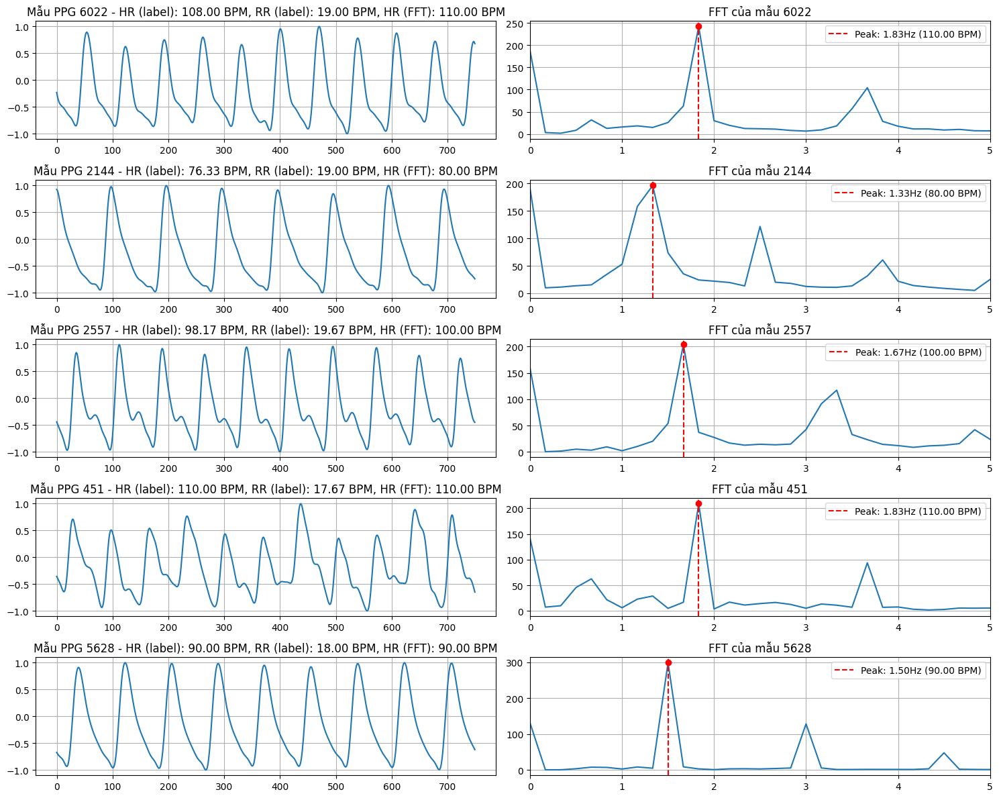


Kích thước batch dữ liệu: torch.Size([64, 750])
Kích thước batch điều kiện: torch.Size([64, 2])


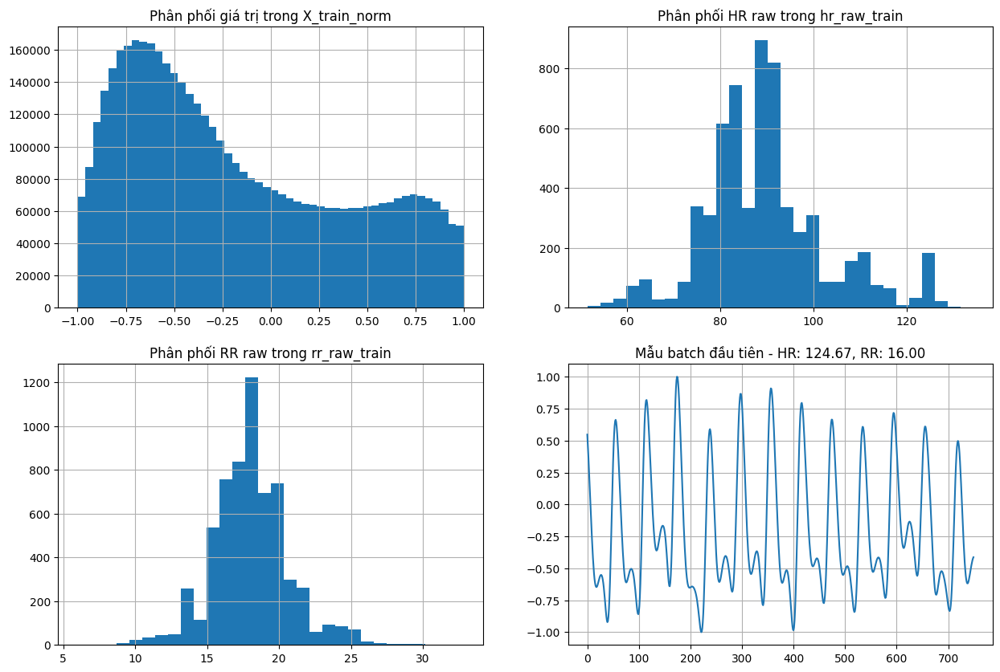

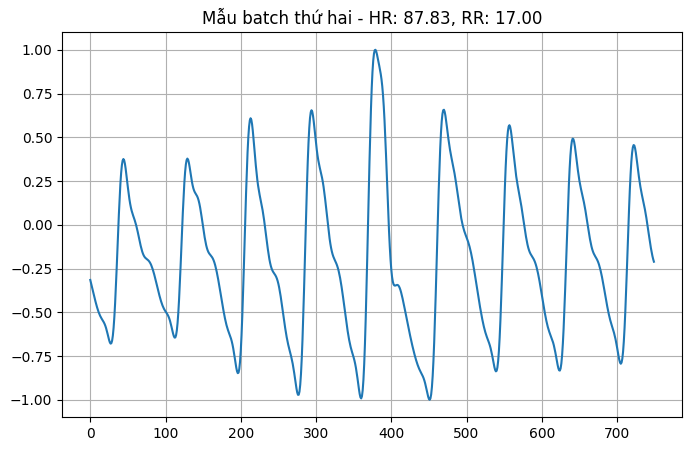

<Figure size 640x480 with 0 Axes>

In [ ]:
import numpy as np
import scipy.io as sio
import matplotlib.pyplot as plt
from scipy import signal
import torch
from torch.utils.data import TensorDataset, DataLoader
from google.colab import drive

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Đường dẫn đến file processed_bidmc_data_with_rr.mat trên Google Drive
data_path = '/content/drive/MyDrive/Big/bidmc/processed/processed_bidmc_data_with_rr.mat'

# Load data từ file .mat
print("Đang tải dữ liệu từ file .mat...")
mat_data = sio.loadmat(data_path)

# Kiểm tra các keys trong file
print("Keys trong file .mat:", list(mat_data.keys()))

# Kiểm tra dữ liệu đã load
X_train_norm = mat_data['X_train_norm']
X_test_norm = mat_data['X_test_norm']
hr_raw_train = mat_data['hr_raw_train'].flatten()
hr_raw_test = mat_data['hr_raw_test'].flatten()
rr_raw_train = mat_data['rr_raw_train'].flatten()
rr_raw_test = mat_data['rr_raw_test'].flatten()
X_total_norm = mat_data['X_total_norm']
hr_raw_total = mat_data['hr_raw_total'].flatten()
rr_raw_total = mat_data['rr_raw_total'].flatten()

# In ra shape của các dữ liệu
print("\nShape của các dữ liệu:")
print(f"X_train_norm shape: {X_train_norm.shape}")
print(f"X_test_norm shape: {X_test_norm.shape}")
print(f"hr_raw_train shape: {hr_raw_train.shape}")
print(f"hr_raw_test shape: {hr_raw_test.shape}")
print(f"rr_raw_train shape: {rr_raw_train.shape}")
print(f"rr_raw_test shape: {rr_raw_test.shape}")
print(f"X_total_norm shape: {X_total_norm.shape}")
print(f"hr_raw_total shape: {hr_raw_total.shape}")
print(f"rr_raw_total shape: {rr_raw_total.shape}")

# Kiểm tra giá trị NaN hoặc vô cực
print("\nKiểm tra giá trị NaN và vô cực:")
print(f"Có giá trị NaN trong X_train_norm: {np.isnan(X_train_norm).any()}")
print(f"Có giá trị vô cực trong X_train_norm: {np.isinf(X_train_norm).any()}")
print(f"Có giá trị NaN trong hr_raw_train: {np.isnan(hr_raw_train).any()}")
print(f"Có giá trị vô cực trong hr_raw_train: {np.isinf(hr_raw_train).any()}")
print(f"Có giá trị NaN trong rr_raw_train: {np.isnan(rr_raw_train).any()}")
print(f"Có giá trị vô cực trong rr_raw_train: {np.isinf(rr_raw_train).any()}")

# Kiểm tra phạm vi giá trị
print("\nPhạm vi giá trị:")
print(f"Giá trị min của X_train_norm: {np.min(X_train_norm)}")
print(f"Giá trị max của X_train_norm: {np.max(X_train_norm)}")
print(f"HR range: [{np.min(hr_raw_train):.2f}, {np.max(hr_raw_train):.2f}] BPM")
print(f"RR range: [{np.min(rr_raw_train):.2f}, {np.max(rr_raw_train):.2f}] BPM")

# Định nghĩa hàm tính FFT và trích xuất HR từ FFT
def compute_fft(signal, fs=125):
    """Tính FFT của tín hiệu"""
    n = len(signal)
    fft_result = np.abs(np.fft.rfft(signal))
    freqs = np.fft.rfftfreq(n, d=1/fs)
    return freqs, fft_result

def extract_hr_from_fft(signal, fs=125):
    """Trích xuất nhịp tim từ FFT của tín hiệu PPG"""
    freqs, fft_result = compute_fft(signal, fs)

    # Lọc dải tần số liên quan đến nhịp tim (0.5Hz - 3.5Hz ~ 30-210 BPM)
    mask = (freqs >= 0.5) & (freqs <= 3.5)
    filtered_freqs = freqs[mask]
    filtered_fft = fft_result[mask]

    # Tìm đỉnh cao nhất trong dải tần số
    if len(filtered_freqs) > 0:
        peak_idx = np.argmax(filtered_fft)
        peak_freq = filtered_freqs[peak_idx]

        # Chuyển đổi từ Hz sang BPM
        hr_from_fft = peak_freq * 60
        return hr_from_fft, peak_freq, filtered_freqs, filtered_fft
    else:
        return None, None, filtered_freqs, filtered_fft

# Tạo DataLoader
train_dataset = TensorDataset(
    torch.FloatTensor(X_train_norm),
    torch.FloatTensor(np.stack((hr_raw_train, rr_raw_train), axis=1))
)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)

# Hiển thị một số mẫu dữ liệu
plt.figure(figsize=(15, 12))

# Hiển thị 5 mẫu PPG ngẫu nhiên từ tập train
num_samples = 5
random_indices = np.random.choice(len(X_train_norm), num_samples, replace=False)

for i, idx in enumerate(random_indices):
    plt.subplot(num_samples, 2, 2*i+1)
    plt.plot(X_train_norm[idx])

    # Trích xuất HR từ FFT
    hr_fft, peak_freq, filtered_freqs, filtered_fft = extract_hr_from_fft(X_train_norm[idx])
    hr_label = f"HR (label): {hr_raw_train[idx]:.2f} BPM"
    rr_label = f"RR (label): {rr_raw_train[idx]:.2f} BPM"
    hr_fft_text = f"HR (FFT): {hr_fft:.2f} BPM" if hr_fft is not None else "HR (FFT): N/A"

    plt.title(f"Mẫu PPG {idx} - {hr_label}, {rr_label}, {hr_fft_text}")
    plt.grid(True)

    # Hiển thị FFT của mẫu
    plt.subplot(num_samples, 2, 2*i+2)
    freqs, amplitude = compute_fft(X_train_norm[idx])
    plt.plot(freqs, amplitude)

    # Đánh dấu đỉnh FFT tương ứng với HR
    if peak_freq is not None:
        plt.axvline(x=peak_freq, color='r', linestyle='--',
                   label=f'Peak: {peak_freq:.2f}Hz ({hr_fft:.2f} BPM)')
        plt.plot(peak_freq, np.max(filtered_fft), 'ro')

    plt.xlim(0, 5)  # Giới hạn tần số hiển thị đến 5Hz
    plt.title(f"FFT của mẫu {idx}")
    plt.grid(True)
    plt.legend()

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_fft_samples.png')
plt.show()

# Kiểm tra phân phối của dữ liệu
plt.figure(figsize=(15, 10))

# Phân phối giá trị trong X_train_norm
plt.subplot(2, 2, 1)
plt.hist(X_train_norm.flatten(), bins=50)
plt.title("Phân phối giá trị trong X_train_norm")
plt.grid(True)

# Phân phối HR trong hr_raw_train
plt.subplot(2, 2, 2)
plt.hist(hr_raw_train, bins=30)
plt.title("Phân phối HR raw trong hr_raw_train")
plt.grid(True)

# Phân phối RR trong rr_raw_train
plt.subplot(2, 2, 3)
plt.hist(rr_raw_train, bins=30)
plt.title("Phân phối RR raw trong rr_raw_train")
plt.grid(True)

# Kiểm tra batch từ DataLoader
try:
    sample_batch_data, sample_batch_condition = next(iter(train_loader))
    print(f"\nKích thước batch dữ liệu: {sample_batch_data.shape}")
    print(f"Kích thước batch điều kiện: {sample_batch_condition.shape}")

    # Hiển thị một số mẫu từ batch
    plt.subplot(2, 2, 4)
    plt.plot(sample_batch_data[0].numpy())
    plt.title(f"Mẫu batch đầu tiên - HR: {sample_batch_condition[0, 0]:.2f}, RR: {sample_batch_condition[0, 1]:.2f}")
    plt.grid(True)

    # Chỉ hiển thị mẫu thứ hai nếu batch có ít nhất 2 mẫu
    if sample_batch_data.shape[0] > 1:
        plt.figure(figsize=(8, 5))
        plt.plot(sample_batch_data[1].numpy())
        plt.title(f"Mẫu batch thứ hai - HR: {sample_batch_condition[1, 0]:.2f}, RR: {sample_batch_condition[1, 1]:.2f}")
        plt.grid(True)
        plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/batch_sample_2.png')
        plt.show()
    else:
        print("Batch chỉ có 1 mẫu, không hiển thị mẫu thứ hai.")

    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/distributions.png')
    plt.show()
except Exception as e:
    print(f"Lỗi khi lấy batch từ DataLoader: {e}")

# CVAE HR với bidmc

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Using device: cuda
Đang load dữ liệu từ file processed_bidmc_data_with_rr.mat...
Keys trong file .mat: ['__header__', '__version__', '__globals__', 'X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'rr_raw_train', 'rr_raw_test', 'X_total_norm', 'hr_raw_total', 'rr_raw_total']
X_total_loaded shape: (7791, 750)
hr_raw_total_loaded shape: (7791,)

Thống kê HR raw total:
Min: 51.33, Max: 134.33
Mean: 89.61, Std: 12.99
Mean ± 2*Std: [63.62, 115.59]


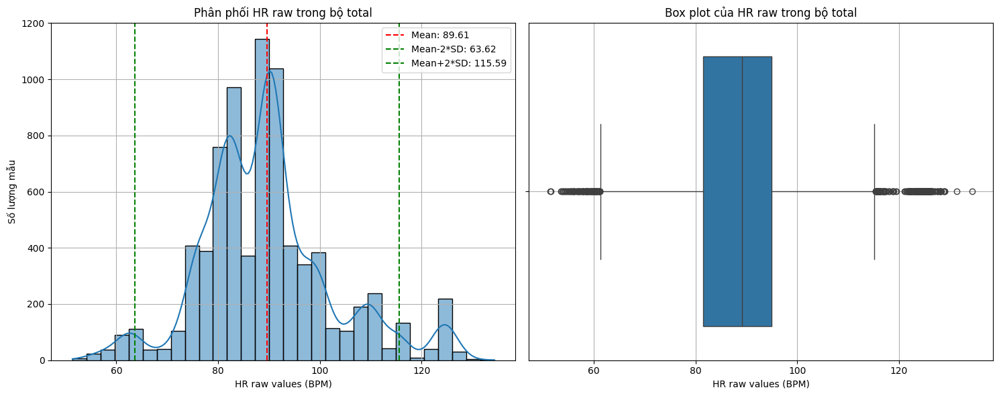

X_total_filtered shape after outlier removal: (7186, 750)
hr_raw_total_filtered shape: (7186,)

Thống kê HR raw total sau khi chuẩn hóa:
Min: 0.0009, Max: 0.9982
Mean: 0.4847, Std: 0.1888


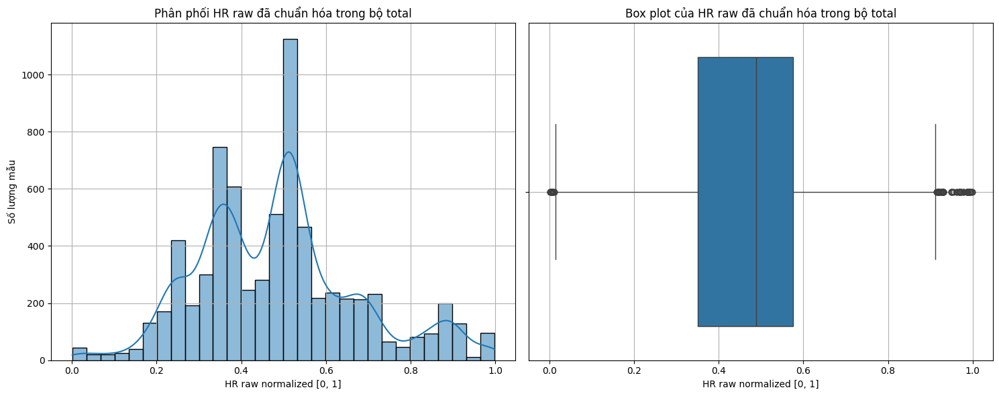

X_train_filtered shape: (5748, 750)
X_test_filtered shape: (1438, 750)

Thống kê HR raw sau khi chia tập:
Train - Min: 0.0009, Max: 0.9982
Train - Mean: 0.4831, Std: 0.1897
Test - Min: 0.0041, Max: 0.9982
Test - Mean: 0.4910, Std: 0.1853


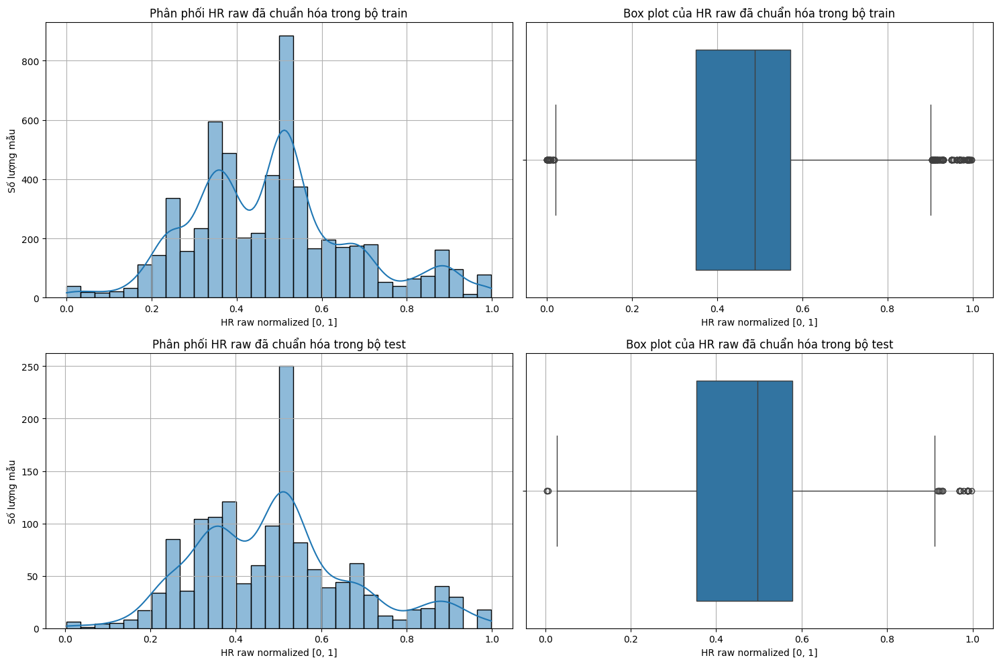

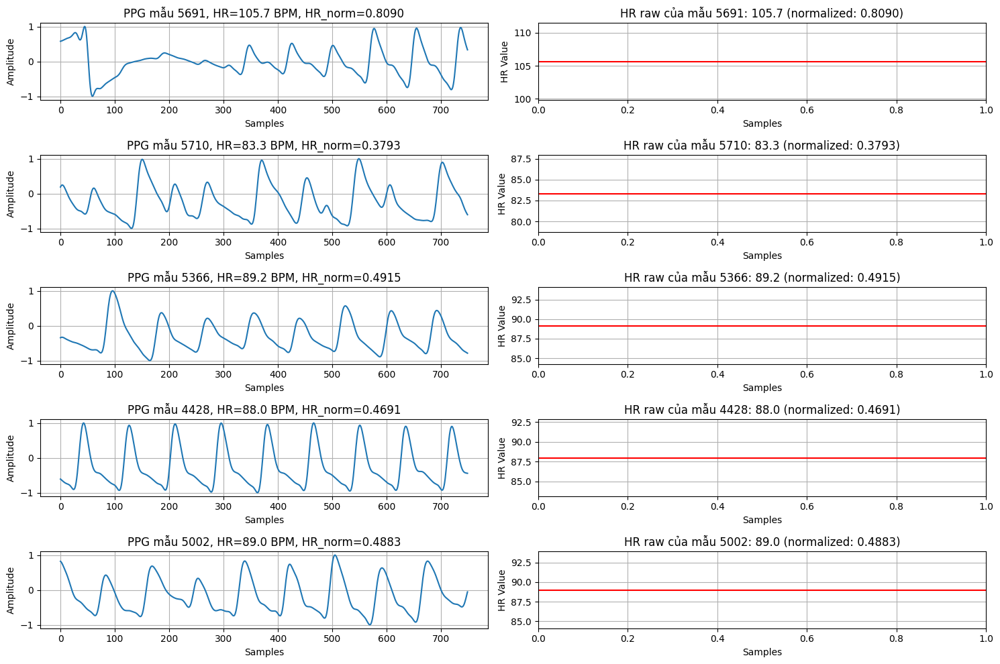

CVAEFixed(
  (encoder): EncoderFixed(
    (encoder): Sequential(
      (0): Linear(in_features=751, out_features=256, bias=True)
      (1): ReLU()
      (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): Dropout(p=0.2, inplace=False)
      (4): Linear(in_features=256, out_features=128, bias=True)
      (5): ReLU()
      (6): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): Dropout(p=0.2, inplace=False)
      (8): Linear(in_features=128, out_features=64, bias=True)
      (9): ReLU()
      (10): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): Dropout(p=0.2, inplace=False)
    )
    (z_mean): Linear(in_features=64, out_features=64, bias=True)
    (z_log_var): Linear(in_features=64, out_features=64, bias=True)
    (sampling): Sampling()
  )
  (decoder): DecoderFixed(
    (decoder): Sequential(
      (0): Linear(in_features=65, out_features=64, bias=True)
    

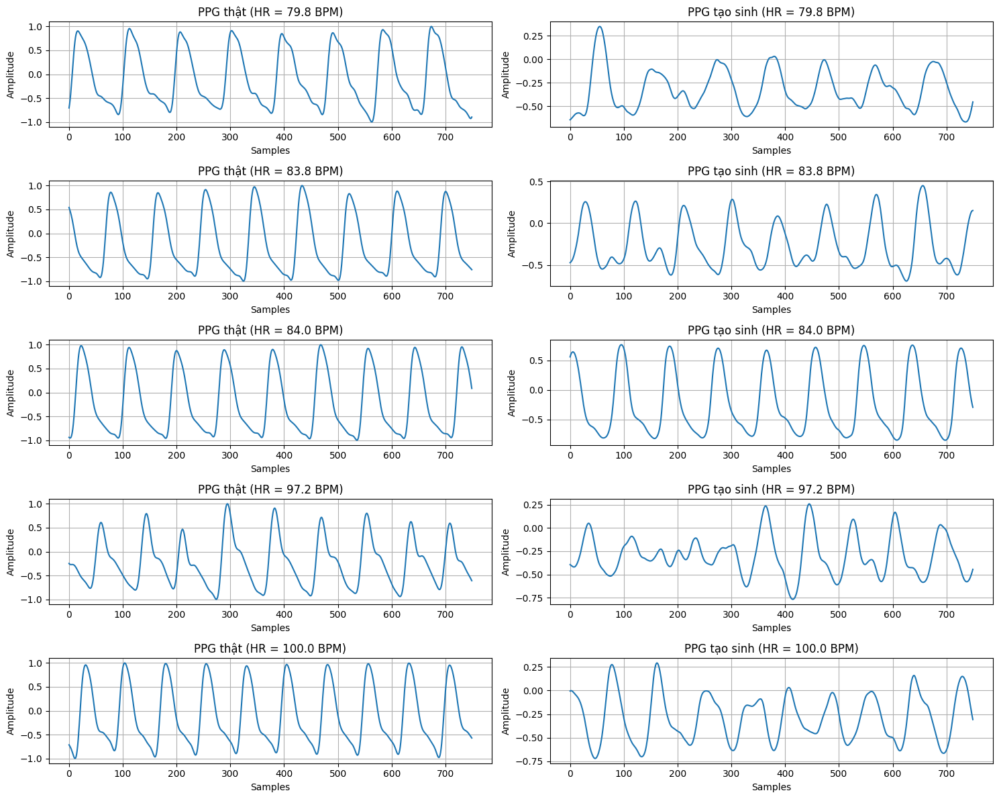

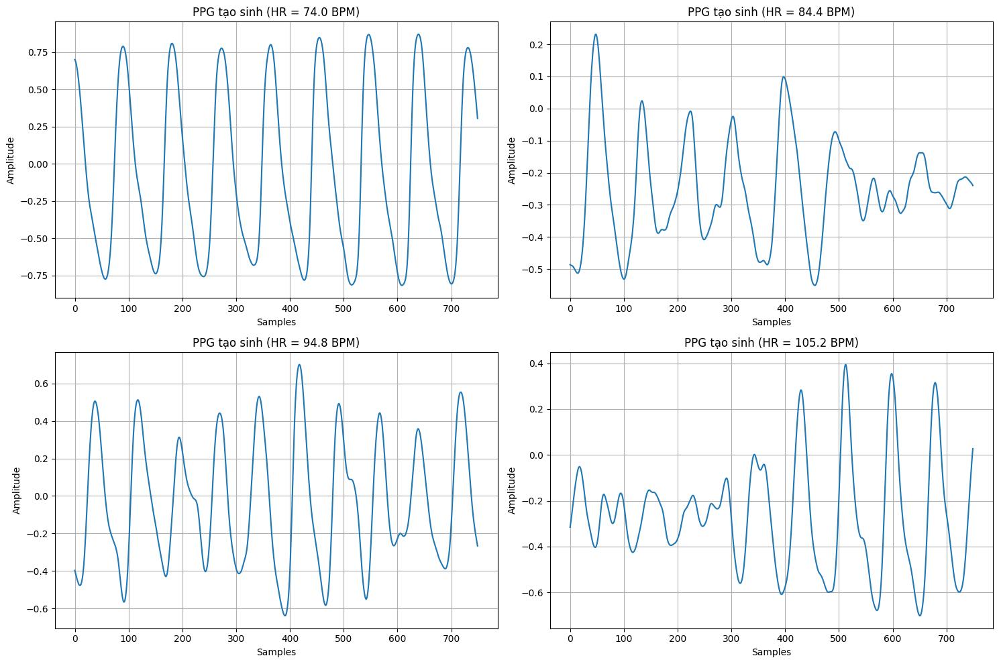

In [ ]:
import numpy as np
import scipy.io as sio
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
from google.colab import drive
import os

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load dữ liệu BIDMC
data_path = '/content/drive/MyDrive/Big/bidmc/processed/processed_bidmc_data_with_rr.mat'
print("Đang load dữ liệu từ file processed_bidmc_data_with_rr.mat...")
loaded_data = sio.loadmat(data_path)

# Kiểm tra các keys trong file
print("Keys trong file .mat:", list(loaded_data.keys()))

# Trích xuất dữ liệu
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
hr_raw_train_loaded = loaded_data['hr_raw_train'].flatten()
hr_raw_test_loaded = loaded_data['hr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
hr_raw_total_loaded = loaded_data['hr_raw_total'].flatten()

print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"hr_raw_total_loaded shape: {hr_raw_total_loaded.shape}")

# Thống kê và lọc ngoại lai HR
hr_raw_total_mean = np.mean(hr_raw_total_loaded)
hr_raw_total_std = np.std(hr_raw_total_loaded)
hr_raw_lower_bound = hr_raw_total_mean - 2 * hr_raw_total_std
hr_raw_upper_bound = hr_raw_total_mean + 2 * hr_raw_total_std

# In thống kê HR thô
print("\nThống kê HR raw total:")
print(f"Min: {np.min(hr_raw_total_loaded):.2f}, Max: {np.max(hr_raw_total_loaded):.2f}")
print(f"Mean: {hr_raw_total_mean:.2f}, Std: {hr_raw_total_std:.2f}")
print(f"Mean ± 2*Std: [{hr_raw_lower_bound:.2f}, {hr_raw_upper_bound:.2f}]")

# Vẽ phân phối HR thô
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(hr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {hr_raw_total_mean:.2f}')
plt.axvline(hr_raw_lower_bound, color='g', linestyle='--', label=f'Mean-2*SD: {hr_raw_lower_bound:.2f}')
plt.axvline(hr_raw_upper_bound, color='g', linestyle='--', label=f'Mean+2*SD: {hr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_loaded)
plt.title('Box plot của HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/hr_raw_total_distribution_bidmc.png')
plt.show()

# Lọc dữ liệu
valid_mask_total = np.logical_and(
    hr_raw_total_loaded >= hr_raw_lower_bound,
    hr_raw_total_loaded <= hr_raw_upper_bound
)

X_total_filtered = X_total_loaded[valid_mask_total]
hr_raw_total_filtered = hr_raw_total_loaded[valid_mask_total]

print(f"X_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"hr_raw_total_filtered shape: {hr_raw_total_filtered.shape}")

# Chuẩn hóa HR về [0, 1]
def normalize_hr_raw(hr_raw_data, hr_min, hr_max):
    normalized = (hr_raw_data - hr_min) / (hr_max - hr_min)
    normalized = np.clip(normalized, 0, 1)
    return normalized

hr_raw_total_normalized = normalize_hr_raw(hr_raw_total_filtered, hr_raw_lower_bound, hr_raw_upper_bound)

# In thống kê HR sau chuẩn hóa
print("\nThống kê HR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(hr_raw_total_normalized):.4f}, Max: {np.max(hr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(hr_raw_total_normalized):.4f}, Std: {np.std(hr_raw_total_normalized):.4f}")

# Vẽ phân phối HR sau chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/hr_normalized_total_distribution_bidmc.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, hr_raw_train_normalized, hr_raw_test_normalized = train_test_split(
    X_total_filtered, hr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy HR thô tương ứng cho train/test
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
hr_raw_train_filtered = hr_raw_total_filtered[train_indices]
hr_raw_test_filtered = hr_raw_total_filtered[test_indices]

print(f"X_train_filtered shape: {X_train_filtered.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")

# In thống kê HR sau khi chia tập
print("\nThống kê HR raw sau khi chia tập:")
print(f"Train - Min: {np.min(hr_raw_train_normalized):.4f}, Max: {np.max(hr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(hr_raw_train_normalized):.4f}, Std: {np.std(hr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(hr_raw_test_normalized):.4f}, Max: {np.max(hr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(hr_raw_test_normalized):.4f}, Std: {np.std(hr_raw_test_normalized):.4f}")

# Vẽ phân phối HR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=hr_raw_train_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(hr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=hr_raw_test_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/hr_normalized_train_test_distribution_bidmc.png')
plt.show()

# Vẽ một vài mẫu PPG để kiểm tra
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, HR={hr_raw_train_filtered[idx]:.1f} BPM, HR_norm={hr_raw_train_normalized[idx]:.4f}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(hr_raw_train_filtered[idx], color='r')
    plt.title(f'HR raw của mẫu {idx}: {hr_raw_train_filtered[idx]:.1f} (normalized: {hr_raw_train_normalized[idx]:.4f})')
    plt.xlabel('Samples')
    plt.ylabel('HR Value')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_samples_bidmc.png')
plt.show()

# Chuyển sang tensor
X_train_tensor = torch.tensor(X_train_filtered, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test_filtered, dtype=torch.float32)
hr_train_tensor = torch.tensor(hr_raw_train_normalized, dtype=torch.float32).unsqueeze(1)
hr_test_tensor = torch.tensor(hr_raw_test_normalized, dtype=torch.float32).unsqueeze(1)

# Tạo DataLoader
train_dataset = TensorDataset(X_train_tensor, hr_train_tensor)
test_dataset = TensorDataset(X_test_tensor, hr_test_tensor)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def __init__(self):
        super(Sampling, self).__init__()

    def forward(self, z_mean, z_log_var):
        batch, dim = z_mean.shape
        epsilon = torch.randn(batch, dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class EncoderFixed(nn.Module):
    def __init__(self, input_size, condition_size, hidden_dims, latent_dim):
        super(EncoderFixed, self).__init__()
        layers = []
        current_dim = input_size + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.encoder = nn.Sequential(*layers)
        self.z_mean = nn.Linear(current_dim, latent_dim)
        self.z_log_var = nn.Linear(current_dim, latent_dim)
        self.sampling = Sampling()

    def forward(self, x, condition):
        x_combined = torch.cat([x, condition], dim=1)
        hidden = self.encoder(x_combined)
        z_mean = self.z_mean(hidden)
        z_log_var = self.z_log_var(hidden)
        z = self.sampling(z_mean, z_log_var)
        return z, z_mean, z_log_var

# Định nghĩa Decoder
class DecoderFixed(nn.Module):
    def __init__(self, latent_dim, condition_size, hidden_dims, output_size):
        super(DecoderFixed, self).__init__()
        layers = []
        current_dim = latent_dim + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.decoder = nn.Sequential(*layers)
        self.output_layer = nn.Linear(current_dim, output_size)

    def forward(self, z, condition):
        z_combined = torch.cat([z, condition], dim=1)
        hidden = self.decoder(z_combined)
        x = torch.tanh(self.output_layer(hidden))
        return x

# Định nghĩa CVAE
class CVAEFixed(nn.Module):
    def __init__(self, input_size, condition_size, latent_dim, hidden_dims):
        super(CVAEFixed, self).__init__()
        self.encoder = EncoderFixed(input_size, condition_size, hidden_dims, latent_dim)
        self.decoder = DecoderFixed(latent_dim, condition_size, hidden_dims[::-1], input_size)

    def forward(self, x, condition):
        z, z_mean, z_log_var = self.encoder(x, condition)
        reconstruction = self.decoder(z, condition)
        return reconstruction, z_mean, z_log_var

# Khởi tạo mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 1
latent_dim = 64
hidden_dims = [256, 128, 64]

cvae = CVAEFixed(input_size, condition_size, latent_dim, hidden_dims).to(device)
print(cvae)

# Hàm mất mát
def cvae_loss(reconstruction, x, z_mean, z_log_var, beta=1.0):
    recon_loss = F.mse_loss(reconstruction, x, reduction='sum')
    kl_loss = -0.5 * torch.sum(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    return recon_loss + beta * kl_loss

# Huấn luyện mô hình
optimizer = torch.optim.Adam(cvae.parameters(), lr=1e-3)
num_epochs = 50

cvae.train()
for epoch in range(num_epochs):
    total_loss = 0
    for batch_idx, (x, condition) in enumerate(train_loader):
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    avg_loss = total_loss / len(train_loader.dataset)
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.6f}")

# Đánh giá trên tập test
cvae.eval()
total_test_loss = 0
with torch.no_grad():
    for x, condition in test_loader:
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        total_test_loss += loss.item()

print(f"Test Loss: {total_test_loss/len(test_loader.dataset):.6f}")

# Lưu mô hình
os.makedirs('/content/drive/MyDrive/Big/bidmc/models/', exist_ok=True)
torch.save(cvae.state_dict(), '/content/drive/MyDrive/Big/bidmc/models/cvae_bidmc.pth')

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(cvae, hr_value, device):
    cvae.eval()
    with torch.no_grad():
        hr_condition = hr_value.unsqueeze(0).to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = cvae.decoder(z, hr_condition)
    return generated

# Trực quan hóa PPG thật và tạo sinh
n_samples = 5
test_samples = []
test_conditions = []

for i, (data, condition) in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0])
    test_conditions.append(condition[0])

generated_samples = []
for hr_condition in test_conditions:
    generated = evaluate_generation(cvae, hr_condition, device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (HR = {test_conditions[i].item()*(hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR = {test_conditions[i].item()*(hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_comparison_bidmc.png')
plt.show()

# Tạo PPG với các giá trị HR khác nhau
hr_values = np.linspace(0.2, 0.8, 4)
generated_hr_samples = []

for hr in hr_values:
    hr_tensor = torch.tensor([hr], dtype=torch.float32)
    generated = evaluate_generation(cvae, hr_tensor, device)
    generated_hr_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 10))
for i, hr in enumerate(hr_values):
    plt.subplot(2, 2, i+1)
    plt.plot(generated_hr_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR = {hr*(hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_generated_hr_bidmc.png')
plt.show()

# CVAE RR với bidmc

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Using device: cuda
Đang load dữ liệu từ file processed_bidmc_data_with_rr.mat...
Keys trong file .mat: ['__header__', '__version__', '__globals__', 'X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'rr_raw_train', 'rr_raw_test', 'X_total_norm', 'hr_raw_total', 'rr_raw_total']
X_total_loaded shape: (7791, 750)
rr_raw_total_loaded shape: (7791,)

Thống kê RR raw total:
Min: 6.00, Max: 32.83
Mean: 17.99, Std: 2.71
Mean ± 2*Std: [12.58, 23.40]


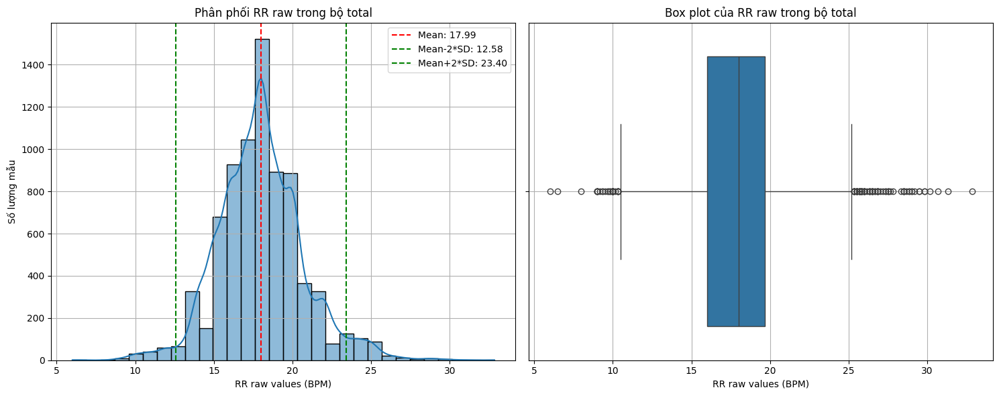

X_total_filtered shape after outlier removal: (7350, 750)
rr_raw_total_filtered shape: (7350,)

Thống kê RR raw total sau khi chuẩn hóa:
Min: 0.0082, Max: 0.9935
Mean: 0.4881, Std: 0.1993


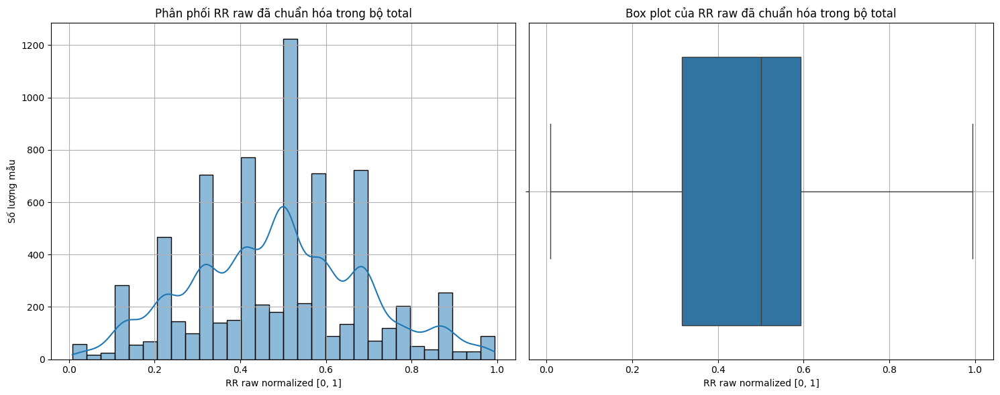

X_train_filtered shape: (5880, 750)
X_test_filtered shape: (1470, 750)

Thống kê RR raw sau khi chia tập:
Train - Min: 0.0082, Max: 0.9935
Train - Mean: 0.4884, Std: 0.1982
Test - Min: 0.0236, Max: 0.9935
Test - Mean: 0.4869, Std: 0.2037


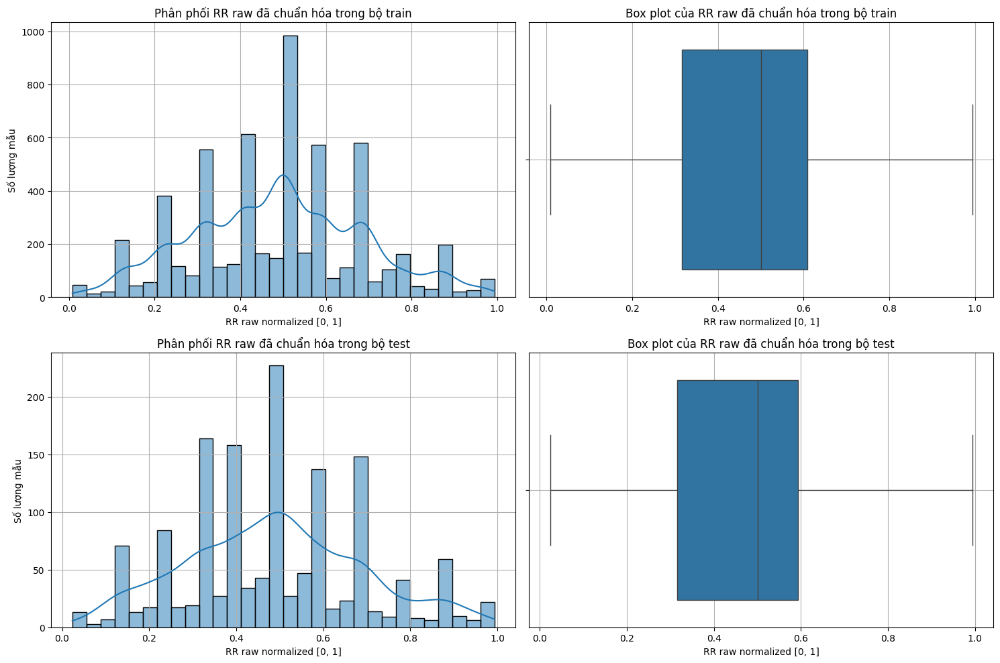

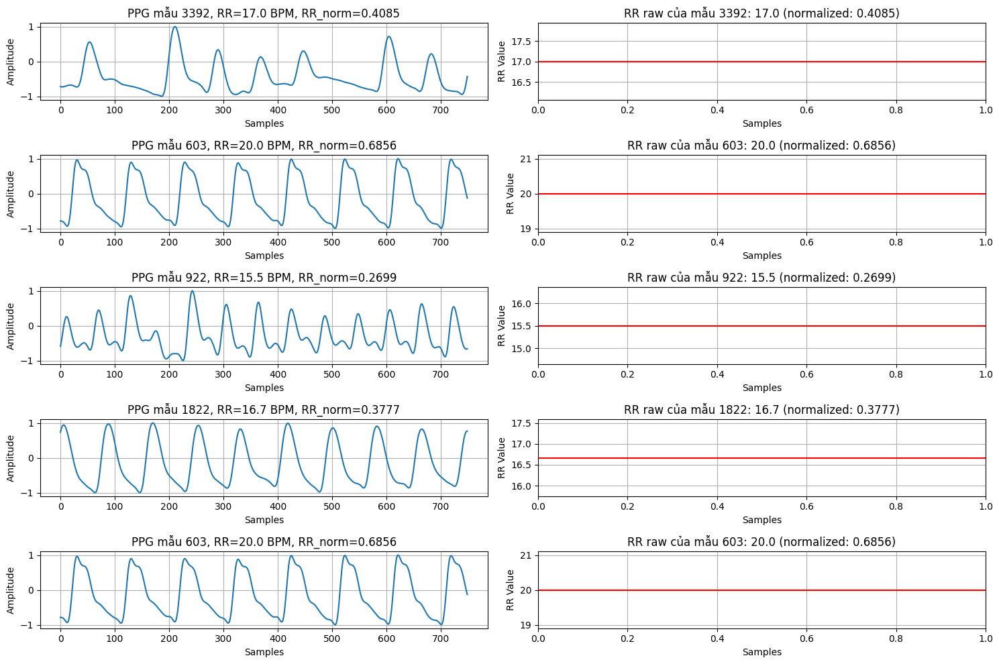

CVAEFixed(
  (encoder): EncoderFixed(
    (encoder): Sequential(
      (0): Linear(in_features=751, out_features=256, bias=True)
      (1): ReLU()
      (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): Dropout(p=0.2, inplace=False)
      (4): Linear(in_features=256, out_features=128, bias=True)
      (5): ReLU()
      (6): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): Dropout(p=0.2, inplace=False)
      (8): Linear(in_features=128, out_features=64, bias=True)
      (9): ReLU()
      (10): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): Dropout(p=0.2, inplace=False)
    )
    (z_mean): Linear(in_features=64, out_features=64, bias=True)
    (z_log_var): Linear(in_features=64, out_features=64, bias=True)
    (sampling): Sampling()
  )
  (decoder): DecoderFixed(
    (decoder): Sequential(
      (0): Linear(in_features=65, out_features=64, bias=True)
    

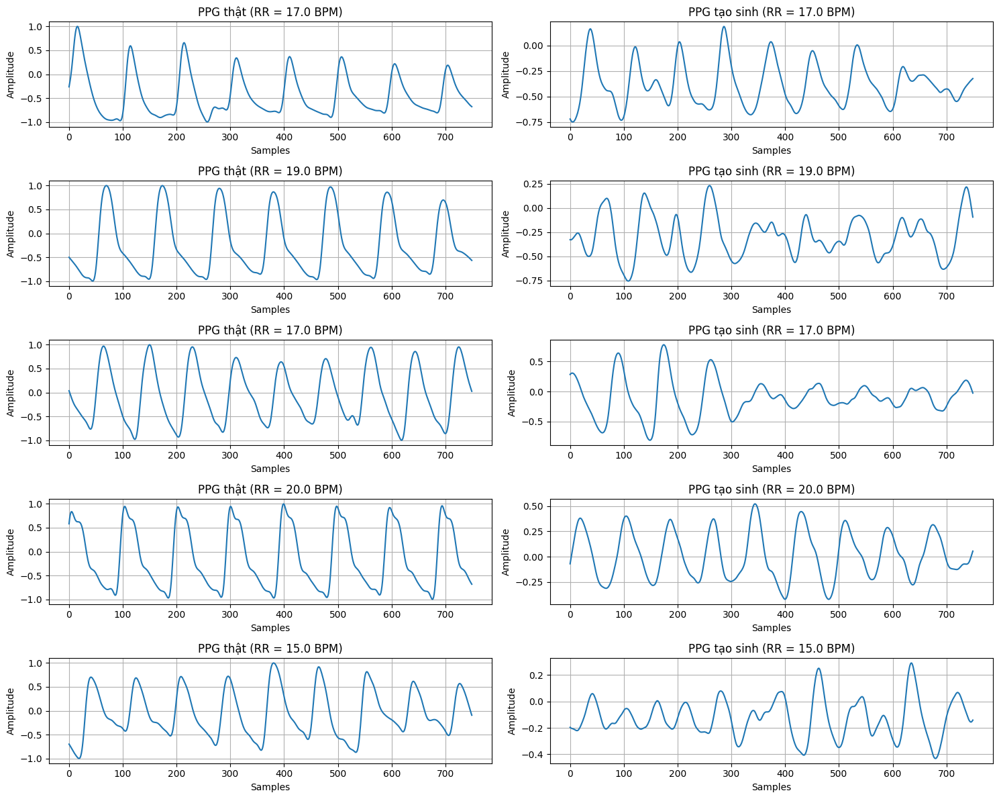

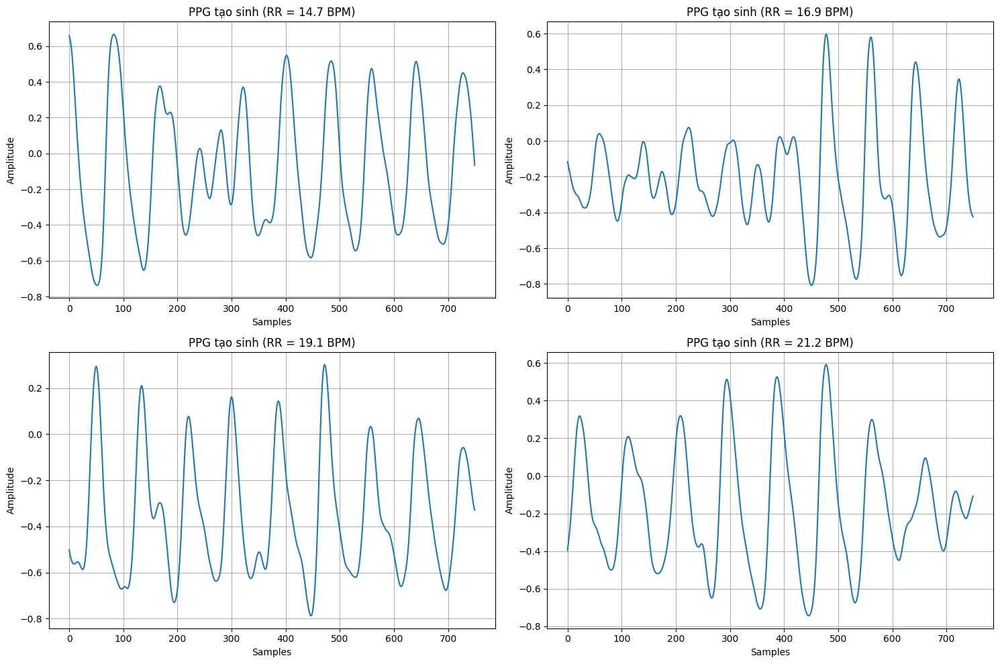

In [ ]:
import numpy as np
import scipy.io as sio
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
from google.colab import drive
import os

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load dữ liệu BIDMC
data_path = '/content/drive/MyDrive/Big/bidmc/processed/processed_bidmc_data_with_rr.mat'
print("Đang load dữ liệu từ file processed_bidmc_data_with_rr.mat...")
loaded_data = sio.loadmat(data_path)

# Kiểm tra các keys trong file
print("Keys trong file .mat:", list(loaded_data.keys()))

# Trích xuất dữ liệu
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
rr_raw_train_loaded = loaded_data['rr_raw_train'].flatten()
rr_raw_test_loaded = loaded_data['rr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
rr_raw_total_loaded = loaded_data['rr_raw_total'].flatten()

print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"rr_raw_total_loaded shape: {rr_raw_total_loaded.shape}")

# Thống kê và lọc ngoại lai RR
rr_raw_total_mean = np.mean(rr_raw_total_loaded)
rr_raw_total_std = np.std(rr_raw_total_loaded)
rr_raw_lower_bound = rr_raw_total_mean - 2 * rr_raw_total_std
rr_raw_upper_bound = rr_raw_total_mean + 2 * rr_raw_total_std

# In thống kê RR thô
print("\nThống kê RR raw total:")
print(f"Min: {np.min(rr_raw_total_loaded):.2f}, Max: {np.max(rr_raw_total_loaded):.2f}")
print(f"Mean: {rr_raw_total_mean:.2f}, Std: {rr_raw_total_std:.2f}")
print(f"Mean ± 2*Std: [{rr_raw_lower_bound:.2f}, {rr_raw_upper_bound:.2f}]")

# Vẽ phân phối RR thô
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(rr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối RR raw trong bộ total')
plt.xlabel('RR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(rr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {rr_raw_total_mean:.2f}')
plt.axvline(rr_raw_lower_bound, color='g', linestyle='--', label=f'Mean-2*SD: {rr_raw_lower_bound:.2f}')
plt.axvline(rr_raw_upper_bound, color='g', linestyle='--', label=f'Mean+2*SD: {rr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=rr_raw_total_loaded)
plt.title('Box plot của RR raw trong bộ total')
plt.xlabel('RR raw values (BPM)')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/rr_raw_total_distribution_bidmc.png')
plt.show()

# Lọc dữ liệu
valid_mask_total = np.logical_and(
    rr_raw_total_loaded >= rr_raw_lower_bound,
    rr_raw_total_loaded <= rr_raw_upper_bound
)

X_total_filtered = X_total_loaded[valid_mask_total]
rr_raw_total_filtered = rr_raw_total_loaded[valid_mask_total]

print(f"X_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"rr_raw_total_filtered shape: {rr_raw_total_filtered.shape}")

# Chuẩn hóa RR về [0, 1]
def normalize_rr_raw(rr_raw_data, rr_min, rr_max):
    normalized = (rr_raw_data - rr_min) / (rr_max - rr_min)
    normalized = np.clip(normalized, 0, 1)
    return normalized

rr_raw_total_normalized = normalize_rr_raw(rr_raw_total_filtered, rr_raw_lower_bound, rr_raw_upper_bound)

# In thống kê RR sau chuẩn hóa
print("\nThống kê RR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(rr_raw_total_normalized):.4f}, Max: {np.max(rr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(rr_raw_total_normalized):.4f}, Std: {np.std(rr_raw_total_normalized):.4f}")

# Vẽ phân phối RR sau chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(rr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ total')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=rr_raw_total_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ total')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/rr_normalized_total_distribution_bidmc.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, rr_raw_train_normalized, rr_raw_test_normalized = train_test_split(
    X_total_filtered, rr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy RR thô tương ứng cho train/test
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
rr_raw_train_filtered = rr_raw_total_filtered[train_indices]
rr_raw_test_filtered = rr_raw_total_filtered[test_indices]

print(f"X_train_filtered shape: {X_train_filtered.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")

# In thống kê RR sau khi chia tập
print("\nThống kê RR raw sau khi chia tập:")
print(f"Train - Min: {np.min(rr_raw_train_normalized):.4f}, Max: {np.max(rr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(rr_raw_train_normalized):.4f}, Std: {np.std(rr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(rr_raw_test_normalized):.4f}, Max: {np.max(rr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(rr_raw_test_normalized):.4f}, Std: {np.std(rr_raw_test_normalized):.4f}")

# Vẽ phân phối RR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(rr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ train')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=rr_raw_train_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ train')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(rr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ test')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=rr_raw_test_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ test')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/rr_normalized_train_test_distribution_bidmc.png')
plt.show()

# Vẽ một vài mẫu PPG để kiểm tra
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, RR={rr_raw_train_filtered[idx]:.1f} BPM, RR_norm={rr_raw_train_normalized[idx]:.4f}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(rr_raw_train_filtered[idx], color='r')
    plt.title(f'RR raw của mẫu {idx}: {rr_raw_train_filtered[idx]:.1f} (normalized: {rr_raw_train_normalized[idx]:.4f})')
    plt.xlabel('Samples')
    plt.ylabel('RR Value')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_samples_bidmc_rr.png')
plt.show()

# Chuyển sang tensor
X_train_tensor = torch.tensor(X_train_filtered, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test_filtered, dtype=torch.float32)
rr_train_tensor = torch.tensor(rr_raw_train_normalized, dtype=torch.float32).unsqueeze(1)
rr_test_tensor = torch.tensor(rr_raw_test_normalized, dtype=torch.float32).unsqueeze(1)

# Tạo DataLoader
train_dataset = TensorDataset(X_train_tensor, rr_train_tensor)
test_dataset = TensorDataset(X_test_tensor, rr_test_tensor)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def __init__(self):
        super(Sampling, self).__init__()

    def forward(self, z_mean, z_log_var):
        batch, dim = z_mean.shape
        epsilon = torch.randn(batch, dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class EncoderFixed(nn.Module):
    def __init__(self, input_size, condition_size, hidden_dims, latent_dim):
        super(EncoderFixed, self).__init__()
        layers = []
        current_dim = input_size + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.encoder = nn.Sequential(*layers)
        self.z_mean = nn.Linear(current_dim, latent_dim)
        self.z_log_var = nn.Linear(current_dim, latent_dim)
        self.sampling = Sampling()

    def forward(self, x, condition):
        x_combined = torch.cat([x, condition], dim=1)
        hidden = self.encoder(x_combined)
        z_mean = self.z_mean(hidden)
        z_log_var = self.z_log_var(hidden)
        z = self.sampling(z_mean, z_log_var)
        return z, z_mean, z_log_var

# Định nghĩa Decoder
class DecoderFixed(nn.Module):
    def __init__(self, latent_dim, condition_size, hidden_dims, output_size):
        super(DecoderFixed, self).__init__()
        layers = []
        current_dim = latent_dim + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.decoder = nn.Sequential(*layers)
        self.output_layer = nn.Linear(current_dim, output_size)

    def forward(self, z, condition):
        z_combined = torch.cat([z, condition], dim=1)
        hidden = self.decoder(z_combined)
        x = torch.tanh(self.output_layer(hidden))
        return x

# Định nghĩa CVAE
class CVAEFixed(nn.Module):
    def __init__(self, input_size, condition_size, latent_dim, hidden_dims):
        super(CVAEFixed, self).__init__()
        self.encoder = EncoderFixed(input_size, condition_size, hidden_dims, latent_dim)
        self.decoder = DecoderFixed(latent_dim, condition_size, hidden_dims[::-1], input_size)

    def forward(self, x, condition):
        z, z_mean, z_log_var = self.encoder(x, condition)
        reconstruction = self.decoder(z, condition)
        return reconstruction, z_mean, z_log_var

# Khởi tạo mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 1
latent_dim = 64
hidden_dims = [256, 128, 64]

cvae = CVAEFixed(input_size, condition_size, latent_dim, hidden_dims).to(device)
print(cvae)

# Hàm mất mát
def cvae_loss(reconstruction, x, z_mean, z_log_var, beta=1.0):
    recon_loss = F.mse_loss(reconstruction, x, reduction='sum')
    kl_loss = -0.5 * torch.sum(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    return recon_loss + beta * kl_loss

# Huấn luyện mô hình
optimizer = torch.optim.Adam(cvae.parameters(), lr=1e-3)
num_epochs = 50

cvae.train()
for epoch in range(num_epochs):
    total_loss = 0
    for batch_idx, (x, condition) in enumerate(train_loader):
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    avg_loss = total_loss / len(train_loader.dataset)
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.6f}")

# Đánh giá trên tập test
cvae.eval()
total_test_loss = 0
with torch.no_grad():
    for x, condition in test_loader:
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        total_test_loss += loss.item()

print(f"Test Loss: {total_test_loss/len(test_loader.dataset):.6f}")

# Lưu mô hình
os.makedirs('/content/drive/MyDrive/Big/bidmc/models/', exist_ok=True)
torch.save(cvae.state_dict(), '/content/drive/MyDrive/Big/bidmc/models/cvae_bidmc_rr.pth')

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(cvae, rr_value, device):
    cvae.eval()
    with torch.no_grad():
        rr_condition = rr_value.unsqueeze(0).to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = cvae.decoder(z, rr_condition)
    return generated

# Trực quan hóa PPG thật và tạo sinh
n_samples = 5
test_samples = []
test_conditions = []

for i, (data, condition) in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0])
    test_conditions.append(condition[0])

generated_samples = []
for rr_condition in test_conditions:
    generated = evaluate_generation(cvae, rr_condition, device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (RR = {test_conditions[i].item()*(rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (RR = {test_conditions[i].item()*(rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_comparison_bidmc_rr.png')
plt.show()

# Tạo PPG với các giá trị RR khác nhau
rr_values = np.linspace(0.2, 0.8, 4)
generated_rr_samples = []

for rr in rr_values:
    rr_tensor = torch.tensor([rr], dtype=torch.float32)
    generated = evaluate_generation(cvae, rr_tensor, device)
    generated_rr_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 10))
for i, rr in enumerate(rr_values):
    plt.subplot(2, 2, i+1)
    plt.plot(generated_rr_samples[i].numpy())
    plt.title(f'PPG tạo sinh (RR = {rr*(rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_generated_rr_bidmc.png')
plt.show()

# CVAE HR+RR với bidmc

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Using device: cuda
Đang load dữ liệu từ file processed_bidmc_data_with_rr.mat...
Keys trong file .mat: ['__header__', '__version__', '__globals__', 'X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'rr_raw_train', 'rr_raw_test', 'X_total_norm', 'hr_raw_total', 'rr_raw_total']
X_total_loaded shape: (7791, 750)
hr_raw_total_loaded shape: (7791,)
rr_raw_total_loaded shape: (7791,)

Thống kê HR raw total:
Min: 51.33, Max: 134.33
Mean: 89.61, Std: 12.99
Mean ± 2*Std: [63.62, 115.59]

Thống kê RR raw total:
Min: 6.00, Max: 32.83
Mean: 17.99, Std: 2.71
Mean ± 2*Std: [12.58, 23.40]


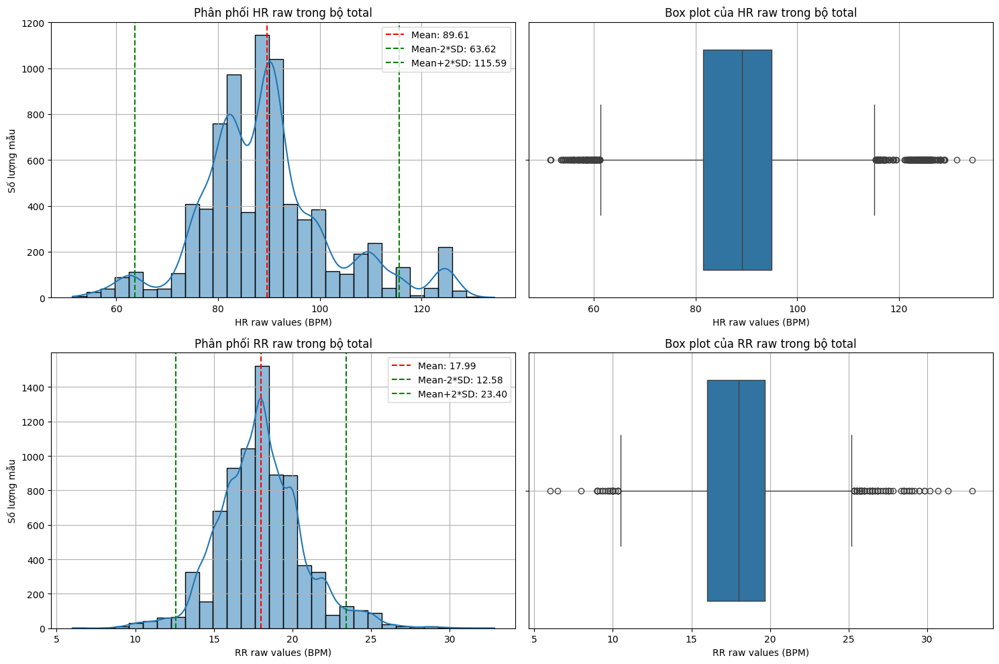

X_total_filtered shape after outlier removal: (6749, 750)
hr_raw_total_filtered shape: (6749,)
rr_raw_total_filtered shape: (6749,)

Thống kê HR raw total sau khi chuẩn hóa:
Min: 0.0009, Max: 0.9982
Mean: 0.4837, Std: 0.1894

Thống kê RR raw total sau khi chuẩn hóa:
Min: 0.0082, Max: 0.9935
Mean: 0.4943, Std: 0.2017


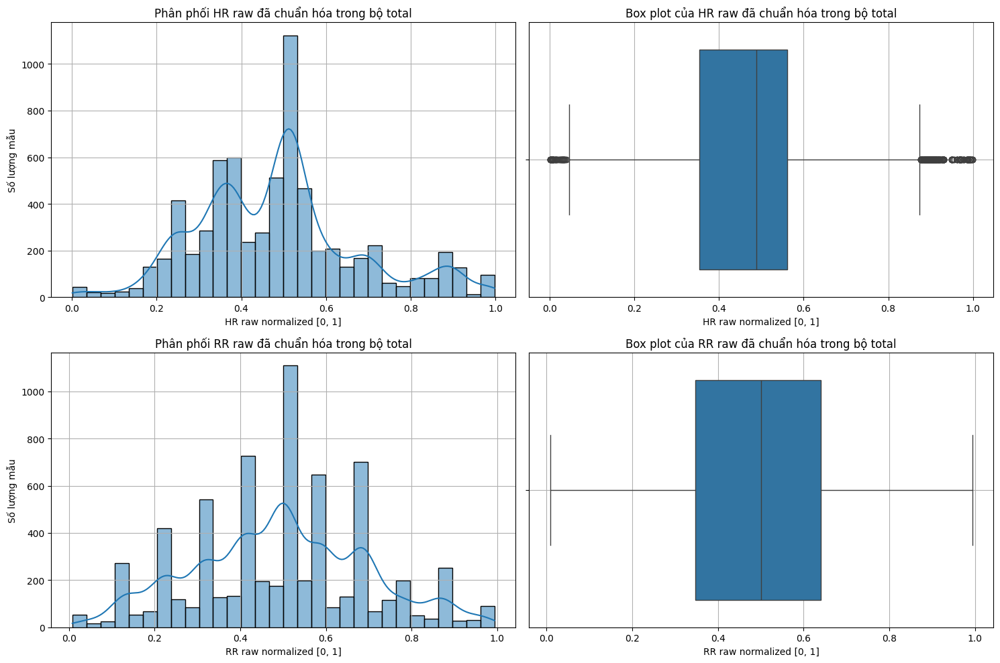

X_train_filtered shape: (5399, 750)
X_test_filtered shape: (1350, 750)

Thống kê HR raw sau khi chia tập:
Train - Min: 0.0009, Max: 0.9982
Train - Mean: 0.4845, Std: 0.1897
Test - Min: 0.0009, Max: 0.9982
Test - Mean: 0.4807, Std: 0.1886

Thống kê RR raw sau khi chia tập:
Train - Min: 0.0082, Max: 0.9935
Train - Mean: 0.4941, Std: 0.2011
Test - Min: 0.0390, Max: 0.9935
Test - Mean: 0.4954, Std: 0.2044


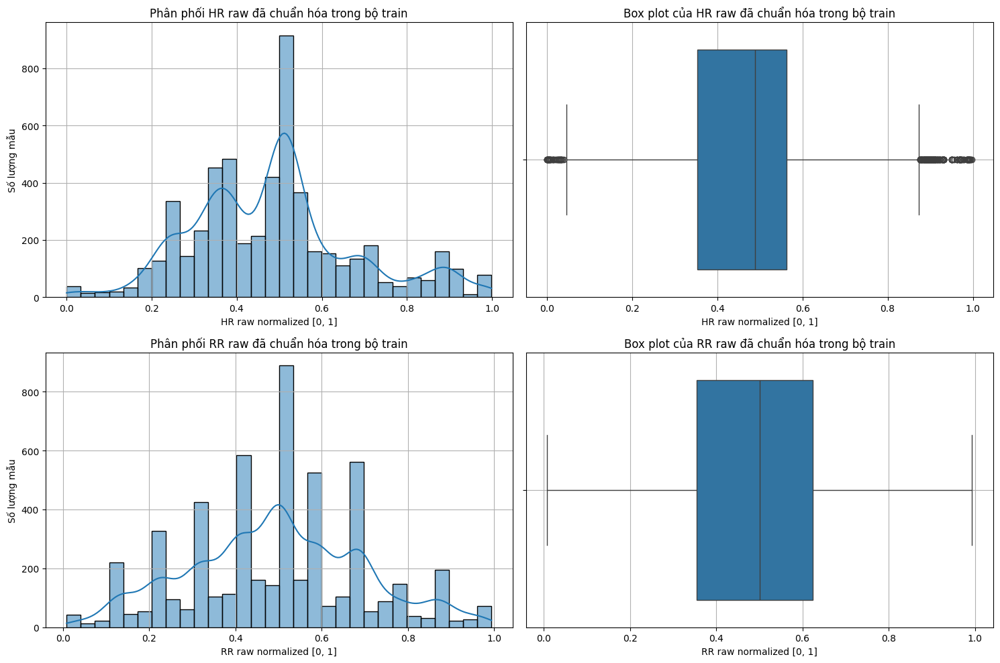

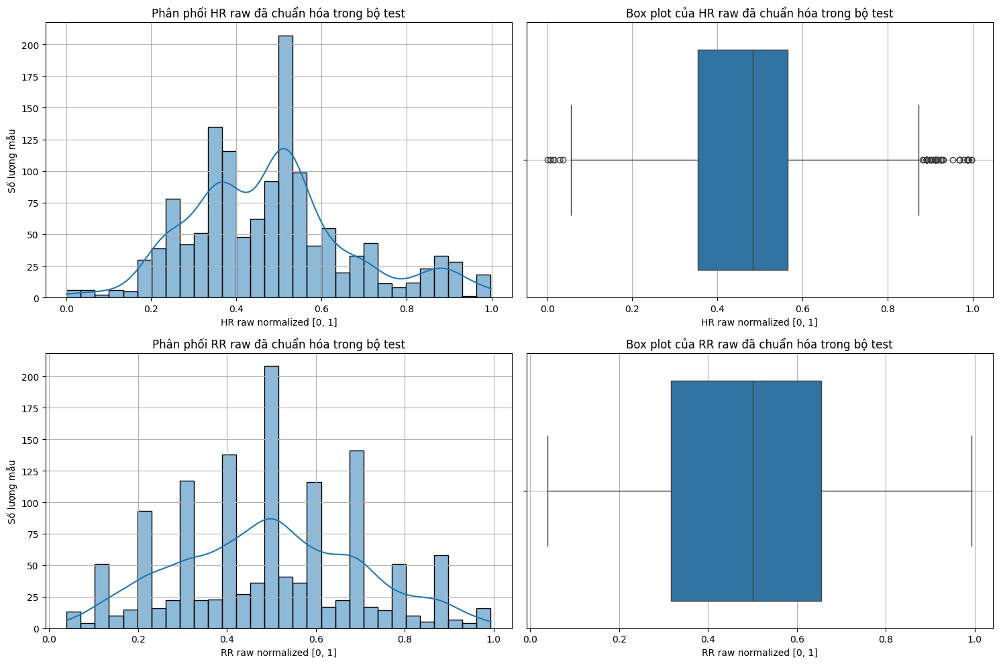

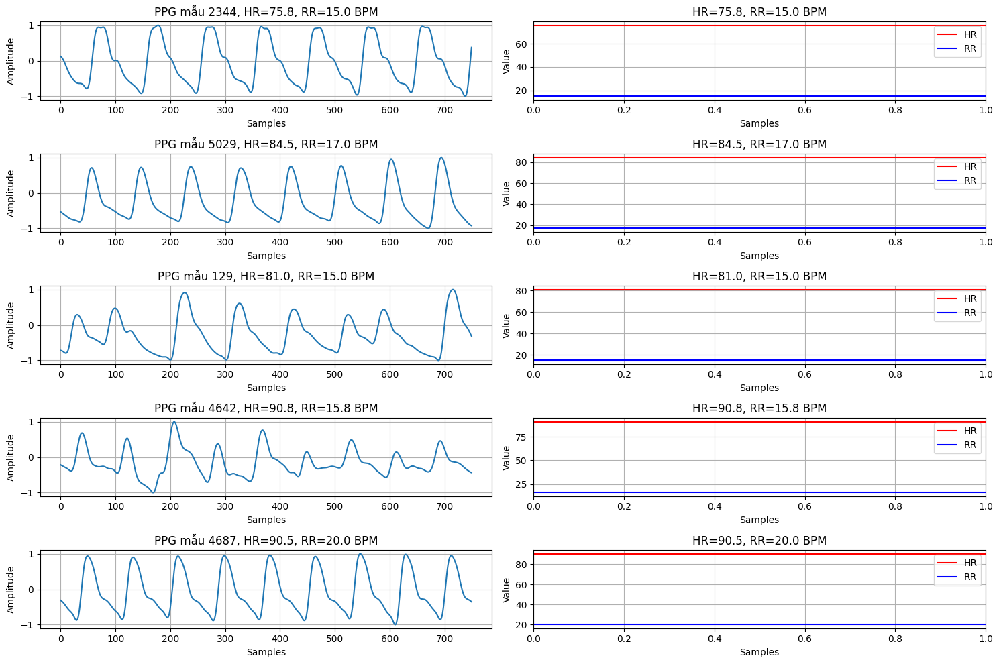

CVAEFixed(
  (encoder): EncoderFixed(
    (encoder): Sequential(
      (0): Linear(in_features=752, out_features=256, bias=True)
      (1): ReLU()
      (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): Dropout(p=0.2, inplace=False)
      (4): Linear(in_features=256, out_features=128, bias=True)
      (5): ReLU()
      (6): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): Dropout(p=0.2, inplace=False)
      (8): Linear(in_features=128, out_features=64, bias=True)
      (9): ReLU()
      (10): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): Dropout(p=0.2, inplace=False)
    )
    (z_mean): Linear(in_features=64, out_features=64, bias=True)
    (z_log_var): Linear(in_features=64, out_features=64, bias=True)
    (sampling): Sampling()
  )
  (decoder): DecoderFixed(
    (decoder): Sequential(
      (0): Linear(in_features=66, out_features=64, bias=True)
    

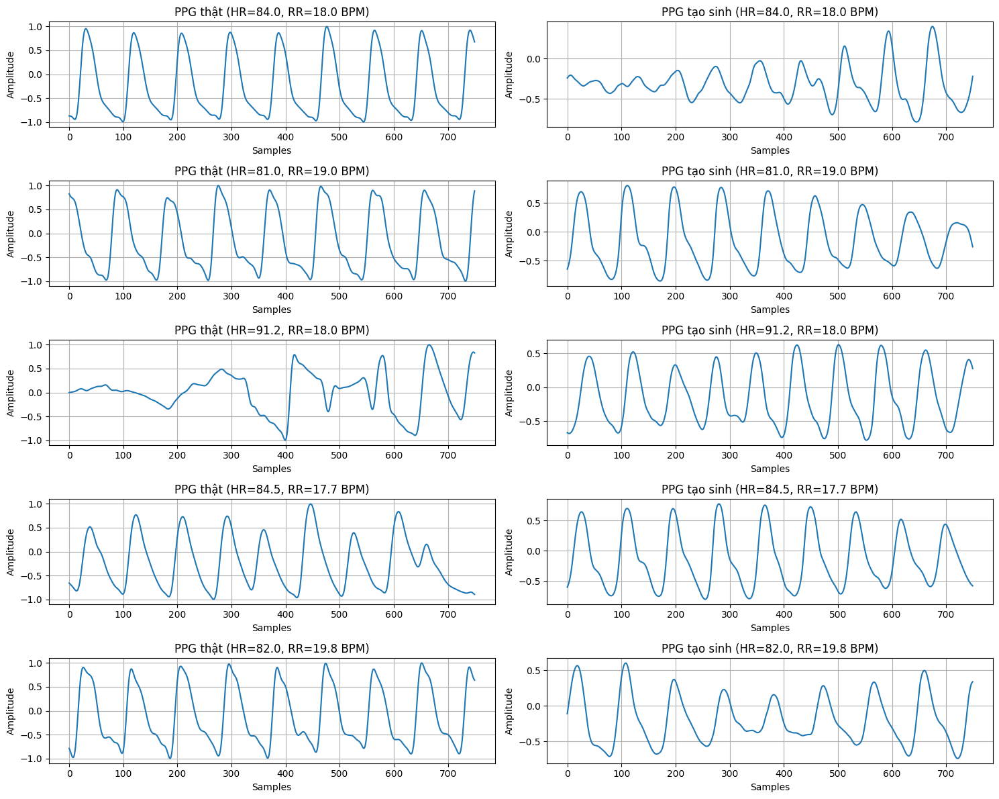

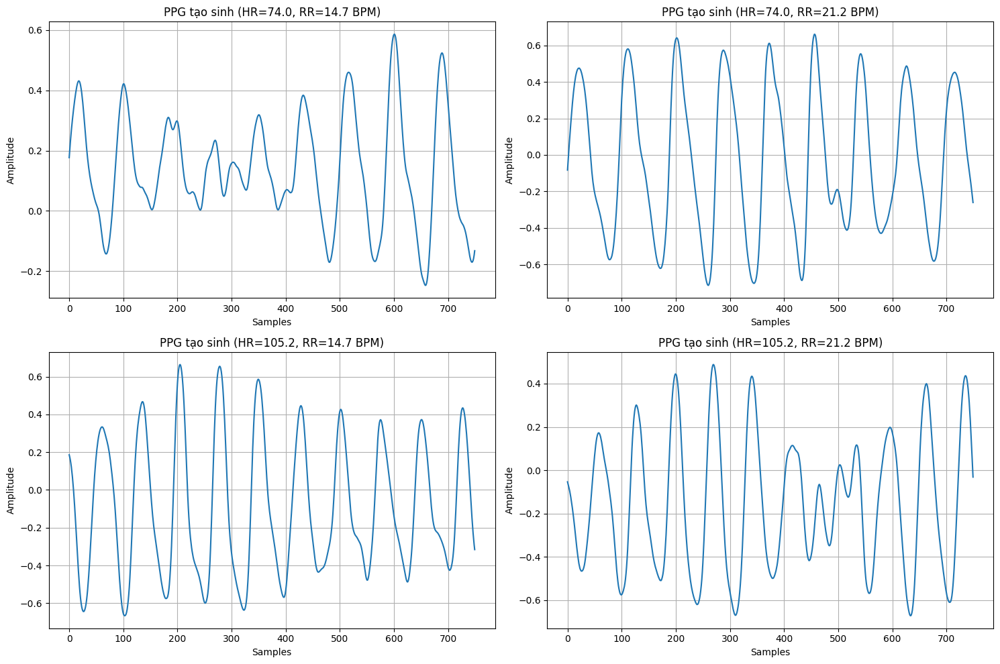

In [ ]:
import numpy as np
import scipy.io as sio
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
from google.colab import drive
import os

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load dữ liệu BIDMC
data_path = '/content/drive/MyDrive/Big/bidmc/processed/processed_bidmc_data_with_rr.mat'
print("Đang load dữ liệu từ file processed_bidmc_data_with_rr.mat...")
loaded_data = sio.loadmat(data_path)

# Kiểm tra các keys trong file
print("Keys trong file .mat:", list(loaded_data.keys()))

# Trích xuất dữ liệu
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
hr_raw_train_loaded = loaded_data['hr_raw_train'].flatten()
hr_raw_test_loaded = loaded_data['hr_raw_test'].flatten()
rr_raw_train_loaded = loaded_data['rr_raw_train'].flatten()
rr_raw_test_loaded = loaded_data['rr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
hr_raw_total_loaded = loaded_data['hr_raw_total'].flatten()
rr_raw_total_loaded = loaded_data['rr_raw_total'].flatten()

print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"hr_raw_total_loaded shape: {hr_raw_total_loaded.shape}")
print(f"rr_raw_total_loaded shape: {rr_raw_total_loaded.shape}")

# Thống kê và lọc ngoại lai HR
hr_raw_total_mean = np.mean(hr_raw_total_loaded)
hr_raw_total_std = np.std(hr_raw_total_loaded)
hr_raw_lower_bound = hr_raw_total_mean - 2 * hr_raw_total_std
hr_raw_upper_bound = hr_raw_total_mean + 2 * hr_raw_total_std

# Thống kê và lọc ngoại lai RR
rr_raw_total_mean = np.mean(rr_raw_total_loaded)
rr_raw_total_std = np.std(rr_raw_total_loaded)
rr_raw_lower_bound = rr_raw_total_mean - 2 * rr_raw_total_std
rr_raw_upper_bound = rr_raw_total_mean + 2 * rr_raw_total_std

# In thống kê HR và RR thô
print("\nThống kê HR raw total:")
print(f"Min: {np.min(hr_raw_total_loaded):.2f}, Max: {np.max(hr_raw_total_loaded):.2f}")
print(f"Mean: {hr_raw_total_mean:.2f}, Std: {hr_raw_total_std:.2f}")
print(f"Mean ± 2*Std: [{hr_raw_lower_bound:.2f}, {hr_raw_upper_bound:.2f}]")

print("\nThống kê RR raw total:")
print(f"Min: {np.min(rr_raw_total_loaded):.2f}, Max: {np.max(rr_raw_total_loaded):.2f}")
print(f"Mean: {rr_raw_total_mean:.2f}, Std: {rr_raw_total_std:.2f}")
print(f"Mean ± 2*Std: [{rr_raw_lower_bound:.2f}, {rr_raw_upper_bound:.2f}]")

# Vẽ phân phối HR và RR thô
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(hr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {hr_raw_total_mean:.2f}')
plt.axvline(hr_raw_lower_bound, color='g', linestyle='--', label=f'Mean-2*SD: {hr_raw_lower_bound:.2f}')
plt.axvline(hr_raw_upper_bound, color='g', linestyle='--', label=f'Mean+2*SD: {hr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=hr_raw_total_loaded)
plt.title('Box plot của HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(rr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối RR raw trong bộ total')
plt.xlabel('RR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(rr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {rr_raw_total_mean:.2f}')
plt.axvline(rr_raw_lower_bound, color='g', linestyle='--', label=f'Mean-2*SD: {rr_raw_lower_bound:.2f}')
plt.axvline(rr_raw_upper_bound, color='g', linestyle='--', label=f'Mean+2*SD: {rr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=rr_raw_total_loaded)
plt.title('Box plot của RR raw trong bộ total')
plt.xlabel('RR raw values (BPM)')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/hr_rr_raw_total_distribution_bidmc.png')
plt.show()

# Lọc dữ liệu dựa trên cả HR và RR
valid_mask_total = np.logical_and(
    np.logical_and(
        hr_raw_total_loaded >= hr_raw_lower_bound,
        hr_raw_total_loaded <= hr_raw_upper_bound
    ),
    np.logical_and(
        rr_raw_total_loaded >= rr_raw_lower_bound,
        rr_raw_total_loaded <= rr_raw_upper_bound
    )
)

X_total_filtered = X_total_loaded[valid_mask_total]
hr_raw_total_filtered = hr_raw_total_loaded[valid_mask_total]
rr_raw_total_filtered = rr_raw_total_loaded[valid_mask_total]

print(f"X_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"hr_raw_total_filtered shape: {hr_raw_total_filtered.shape}")
print(f"rr_raw_total_filtered shape: {rr_raw_total_filtered.shape}")

# Chuẩn hóa HR và RR về [0, 1]
def normalize_raw(data, min_val, max_val):
    normalized = (data - min_val) / (max_val - min_val)
    normalized = np.clip(normalized, 0, 1)
    return normalized

hr_raw_total_normalized = normalize_raw(hr_raw_total_filtered, hr_raw_lower_bound, hr_raw_upper_bound)
rr_raw_total_normalized = normalize_raw(rr_raw_total_filtered, rr_raw_lower_bound, rr_raw_upper_bound)

# In thống kê HR và RR sau chuẩn hóa
print("\nThống kê HR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(hr_raw_total_normalized):.4f}, Max: {np.max(hr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(hr_raw_total_normalized):.4f}, Std: {np.std(hr_raw_total_normalized):.4f}")

print("\nThống kê RR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(rr_raw_total_normalized):.4f}, Max: {np.max(rr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(rr_raw_total_normalized):.4f}, Std: {np.std(rr_raw_total_normalized):.4f}")

# Vẽ phân phối HR và RR sau chuẩn hóa
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=hr_raw_total_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(rr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ total')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=rr_raw_total_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ total')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/hr_rr_normalized_total_distribution_bidmc.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, hr_raw_train_normalized, hr_raw_test_normalized, rr_raw_train_normalized, rr_raw_test_normalized = train_test_split(
    X_total_filtered, hr_raw_total_normalized, rr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy HR và RR thô tương ứng cho train/test
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
hr_raw_train_filtered = hr_raw_total_filtered[train_indices]
hr_raw_test_filtered = hr_raw_total_filtered[test_indices]
rr_raw_train_filtered = rr_raw_total_filtered[train_indices]
rr_raw_test_filtered = rr_raw_total_filtered[test_indices]

print(f"X_train_filtered shape: {X_train_filtered.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")

# Kết hợp HR và RR thành tensor điều kiện
hr_rr_train_normalized = np.stack((hr_raw_train_normalized, rr_raw_train_normalized), axis=1)
hr_rr_test_normalized = np.stack((hr_raw_test_normalized, rr_raw_test_normalized), axis=1)

# In thống kê HR và RR sau khi chia tập
print("\nThống kê HR raw sau khi chia tập:")
print(f"Train - Min: {np.min(hr_raw_train_normalized):.4f}, Max: {np.max(hr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(hr_raw_train_normalized):.4f}, Std: {np.std(hr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(hr_raw_test_normalized):.4f}, Max: {np.max(hr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(hr_raw_test_normalized):.4f}, Std: {np.std(hr_raw_test_normalized):.4f}")

print("\nThống kê RR raw sau khi chia tập:")
print(f"Train - Min: {np.min(rr_raw_train_normalized):.4f}, Max: {np.max(rr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(rr_raw_train_normalized):.4f}, Std: {np.std(rr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(rr_raw_test_normalized):.4f}, Max: {np.max(rr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(rr_raw_test_normalized):.4f}, Std: {np.std(rr_raw_test_normalized):.4f}")

# Vẽ phân phối HR và RR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=hr_raw_train_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(rr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ train')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=rr_raw_train_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ train')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/hr_rr_normalized_train_distribution_bidmc.png')
plt.show()

plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=hr_raw_test_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(rr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ test')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=rr_raw_test_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ test')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/hr_rr_normalized_test_distribution_bidmc.png')
plt.show()

# Vẽ một vài mẫu PPG để kiểm tra
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, HR={hr_raw_train_filtered[idx]:.1f}, RR={rr_raw_train_filtered[idx]:.1f} BPM')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(hr_raw_train_filtered[idx], color='r', label='HR')
    plt.axhline(rr_raw_train_filtered[idx], color='b', label='RR')
    plt.title(f'HR={hr_raw_train_filtered[idx]:.1f}, RR={rr_raw_train_filtered[idx]:.1f} BPM')
    plt.xlabel('Samples')
    plt.ylabel('Value')
    plt.legend()
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_samples_bidmc_hr_rr.png')
plt.show()

# Chuyển sang tensor
X_train_tensor = torch.tensor(X_train_filtered, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test_filtered, dtype=torch.float32)
hr_rr_train_tensor = torch.tensor(hr_rr_train_normalized, dtype=torch.float32)
hr_rr_test_tensor = torch.tensor(hr_rr_test_normalized, dtype=torch.float32)

# Tạo DataLoader
train_dataset = TensorDataset(X_train_tensor, hr_rr_train_tensor)
test_dataset = TensorDataset(X_test_tensor, hr_rr_test_tensor)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def __init__(self):
        super(Sampling, self).__init__()

    def forward(self, z_mean, z_log_var):
        batch, dim = z_mean.shape
        epsilon = torch.randn(batch, dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class EncoderFixed(nn.Module):
    def __init__(self, input_size, condition_size, hidden_dims, latent_dim):
        super(EncoderFixed, self).__init__()
        layers = []
        current_dim = input_size + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.encoder = nn.Sequential(*layers)
        self.z_mean = nn.Linear(current_dim, latent_dim)
        self.z_log_var = nn.Linear(current_dim, latent_dim)
        self.sampling = Sampling()

    def forward(self, x, condition):
        x_combined = torch.cat([x, condition], dim=1)
        hidden = self.encoder(x_combined)
        z_mean = self.z_mean(hidden)
        z_log_var = self.z_log_var(hidden)
        z = self.sampling(z_mean, z_log_var)
        return z, z_mean, z_log_var

# Định nghĩa Decoder
class DecoderFixed(nn.Module):
    def __init__(self, latent_dim, condition_size, hidden_dims, output_size):
        super(DecoderFixed, self).__init__()
        layers = []
        current_dim = latent_dim + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.decoder = nn.Sequential(*layers)
        self.output_layer = nn.Linear(current_dim, output_size)

    def forward(self, z, condition):
        z_combined = torch.cat([z, condition], dim=1)
        hidden = self.decoder(z_combined)
        x = torch.tanh(self.output_layer(hidden))
        return x

# Định nghĩa CVAE
class CVAEFixed(nn.Module):
    def __init__(self, input_size, condition_size, latent_dim, hidden_dims):
        super(CVAEFixed, self).__init__()
        self.encoder = EncoderFixed(input_size, condition_size, hidden_dims, latent_dim)
        self.decoder = DecoderFixed(latent_dim, condition_size, hidden_dims[::-1], input_size)

    def forward(self, x, condition):
        z, z_mean, z_log_var = self.encoder(x, condition)
        reconstruction = self.decoder(z, condition)
        return reconstruction, z_mean, z_log_var

# Khởi tạo mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 2  # HR + RR
latent_dim = 64
hidden_dims = [256, 128, 64]

cvae = CVAEFixed(input_size, condition_size, latent_dim, hidden_dims).to(device)
print(cvae)

# Hàm mất mát
def cvae_loss(reconstruction, x, z_mean, z_log_var, beta=1.0):
    recon_loss = F.mse_loss(reconstruction, x, reduction='sum')
    kl_loss = -0.5 * torch.sum(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    return recon_loss + beta * kl_loss

# Huấn luyện mô hình
optimizer = torch.optim.Adam(cvae.parameters(), lr=1e-3)
num_epochs = 50

cvae.train()
for epoch in range(num_epochs):
    total_loss = 0
    for batch_idx, (x, condition) in enumerate(train_loader):
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    avg_loss = total_loss / len(train_loader.dataset)
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.6f}")

# Đánh giá trên tập test
cvae.eval()
total_test_loss = 0
with torch.no_grad():
    for x, condition in test_loader:
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        total_test_loss += loss.item()

print(f"Test Loss: {total_test_loss/len(test_loader.dataset):.6f}")

# Lưu mô hình
os.makedirs('/content/drive/MyDrive/Big/bidmc/models/', exist_ok=True)
torch.save(cvae.state_dict(), '/content/drive/MyDrive/Big/bidmc/models/cvae_bidmc_hr_rr.pth')

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(cvae, hr_rr_value, device):
    cvae.eval()
    with torch.no_grad():
        hr_rr_condition = hr_rr_value.to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = cvae.decoder(z, hr_rr_condition)
    return generated

# Trực quan hóa PPG thật và tạo sinh
n_samples = 5
test_samples = []
test_conditions = []

for i, (data, condition) in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0])
    test_conditions.append(condition[0])

generated_samples = []
for hr_rr_condition in test_conditions:
    generated = evaluate_generation(cvae, hr_rr_condition.unsqueeze(0), device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    hr_val = test_conditions[i][0].item() * (hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound
    rr_val = test_conditions[i][1].item() * (rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (HR={hr_val:.1f}, RR={rr_val:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR={hr_val:.1f}, RR={rr_val:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_comparison_bidmc_hr_rr.png')
plt.show()

# Tạo PPG với các giá trị HR và RR khác nhau
hr_values = np.linspace(0.2, 0.8, 2)
rr_values = np.linspace(0.2, 0.8, 2)
generated_hr_rr_samples = []

for hr in hr_values:
    for rr in rr_values:
        hr_rr_tensor = torch.tensor([[hr, rr]], dtype=torch.float32)
        generated = evaluate_generation(cvae, hr_rr_tensor, device)
        generated_hr_rr_samples.append((generated.cpu().squeeze(0), hr, rr))

plt.figure(figsize=(15, 10))
for i, (generated, hr, rr) in enumerate(generated_hr_rr_samples):
    hr_val = hr * (hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound
    rr_val = rr * (rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound
    plt.subplot(2, 2, i+1)
    plt.plot(generated.numpy())
    plt.title(f'PPG tạo sinh (HR={hr_val:.1f}, RR={rr_val:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/bidmc/figures/ppg_generated_hr_rr_bidmc.png')
plt.show()

# Capno

Bước 1: Đang tổng hợp dữ liệu từ tất cả các file...
Đang đọc file: /content/drive/MyDrive/Big/capno/data/mat/0370_8min.mat
Các khóa trong file: ['#refs#', 'SFresults', 'labels', 'meta', 'param', 'reference', 'signal']
Đã downsample tín hiệu từ 300Hz xuống 125Hz
Đã đọc thành công file 0370_8min.mat
Độ dài tín hiệu PPG: 60000
Độ dài tín hiệu HR: 584
Độ dài tín hiệu RR: 69
Tần số lấy mẫu: 125 Hz
--------------------------------------------------
Đang đọc file: /content/drive/MyDrive/Big/capno/data/mat/0331_8min.mat
Các khóa trong file: ['#refs#', 'SFresults', 'labels', 'meta', 'param', 'reference', 'signal']
Đã downsample tín hiệu từ 300Hz xuống 125Hz
Đã đọc thành công file 0331_8min.mat
Độ dài tín hiệu PPG: 60000
Độ dài tín hiệu HR: 537
Độ dài tín hiệu RR: 114
Tần số lấy mẫu: 125 Hz
--------------------------------------------------
Đang đọc file: /content/drive/MyDrive/Big/capno/data/mat/0330_8min.mat
Các khóa trong file: ['#refs#', 'SFresults', 'labels', 'meta', 'param', 'reference', '

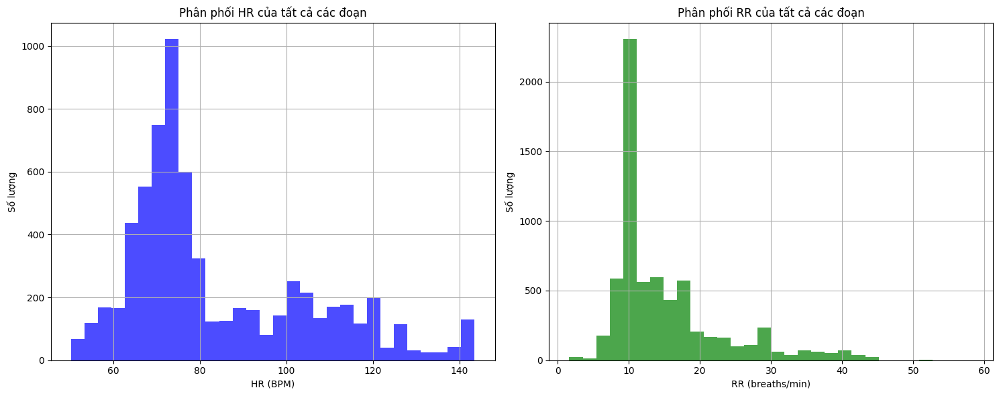

Thống kê HR:
Mean: 83.97 BPM
Std: 21.08 BPM
Min: 50.23 BPM
Max: 143.53 BPM
Thống kê RR:
Mean: 15.20 breaths/min
Std: 7.83 breaths/min
Min: 1.63 breaths/min
Max: 58.37 breaths/min
Tổng số đoạn: 6668
Độ dài mỗi segment: 750 điểm (~6.00 giây ở 125Hz)


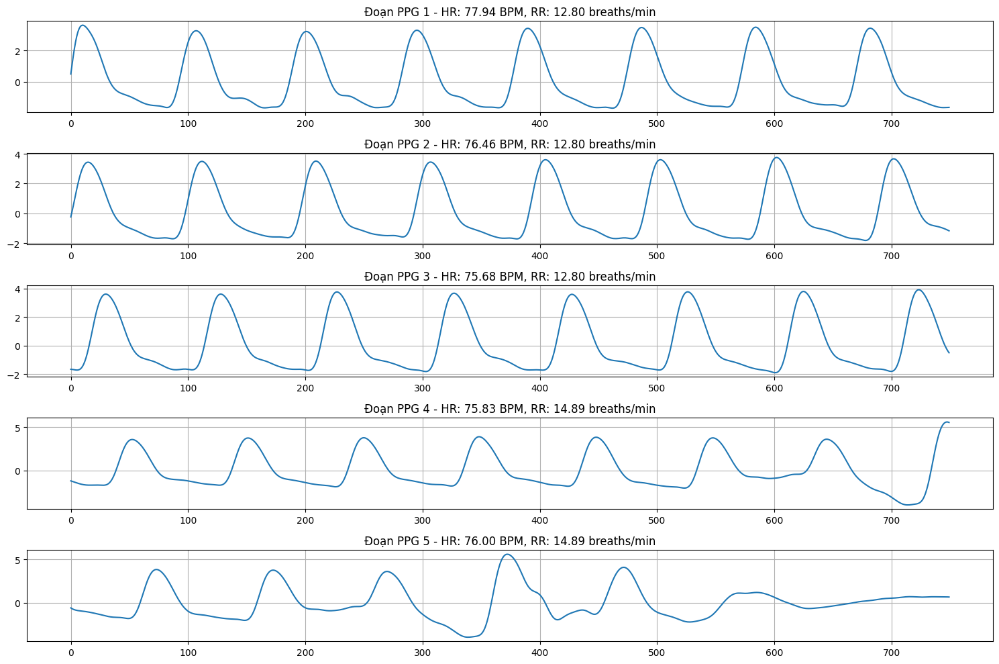


Đang chuẩn bị DataLoader cho huấn luyện...

Thông tin xử lý:
Tổng số đoạn PPG: 6668
Kích thước tập train: (5334, 750)
Kích thước tập test: (1334, 750)
Kích thước hr_raw_train: (5334,)
Kích thước rr_raw_train: (5334,)
Đã lưu dữ liệu vào file 'processed_capno_data_with_rr.mat'

Shape của các dữ liệu:
X_train shape: (5334, 750)
X_test shape: (1334, 750)
X_train_norm shape: (5334, 750)
X_test_norm shape: (1334, 750)
hr_raw_train shape: (5334,)
hr_raw_test shape: (1334,)
rr_raw_train shape: (5334,)
rr_raw_test shape: (1334,)

Kiểm tra một số segment PPG, HR và RR tương ứng:

Mẫu từ tập train:
Segment 0:
  - Độ dài segment PPG: 750
  - Giá trị HR (BPM): 74.74
  - Giá trị RR (breaths/min): 9.99


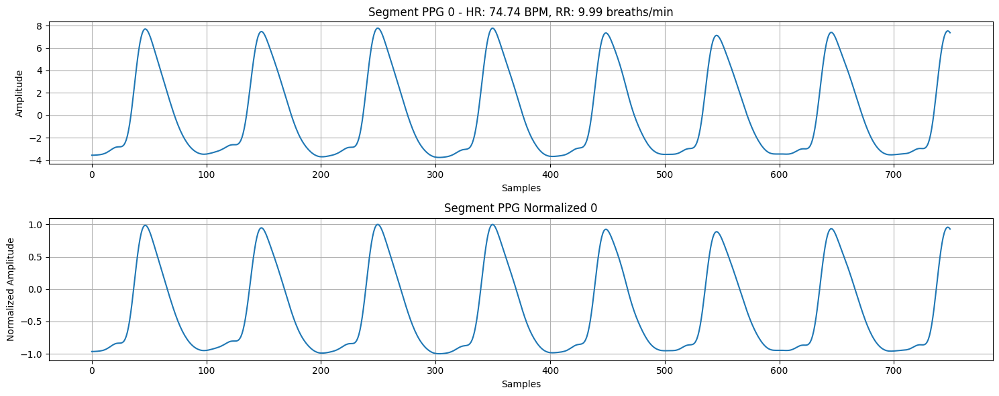

Segment 1:
  - Độ dài segment PPG: 750
  - Giá trị HR (BPM): 66.46
  - Giá trị RR (breaths/min): 11.98


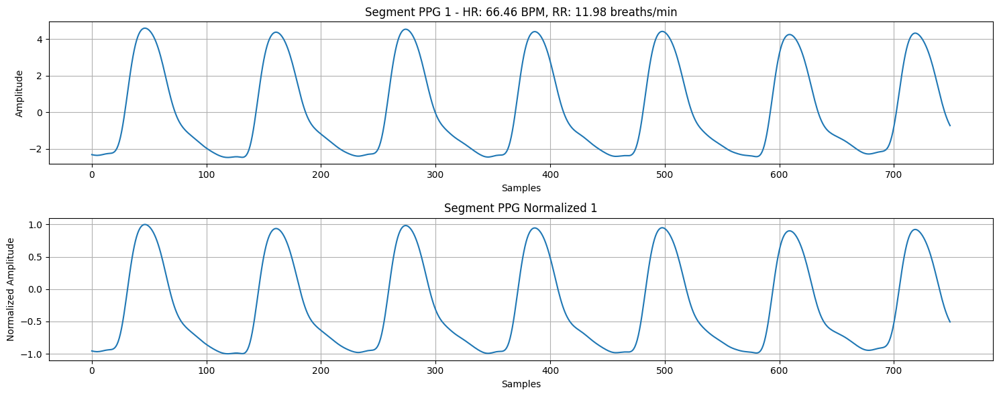

Segment 2:
  - Độ dài segment PPG: 750
  - Giá trị HR (BPM): 141.07
  - Giá trị RR (breaths/min): 36.33


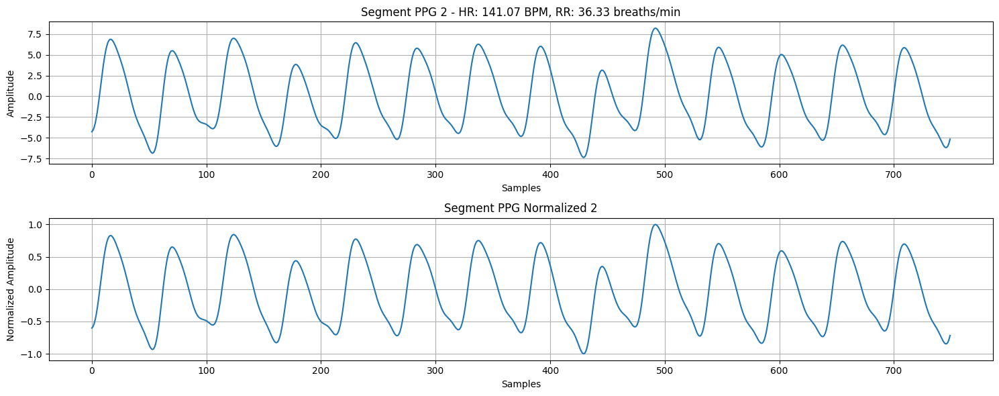


Mẫu từ tập test:
Segment 0:
  - Độ dài segment PPG: 750
  - Giá trị HR (BPM): 80.22
  - Giá trị RR (breaths/min): 17.17


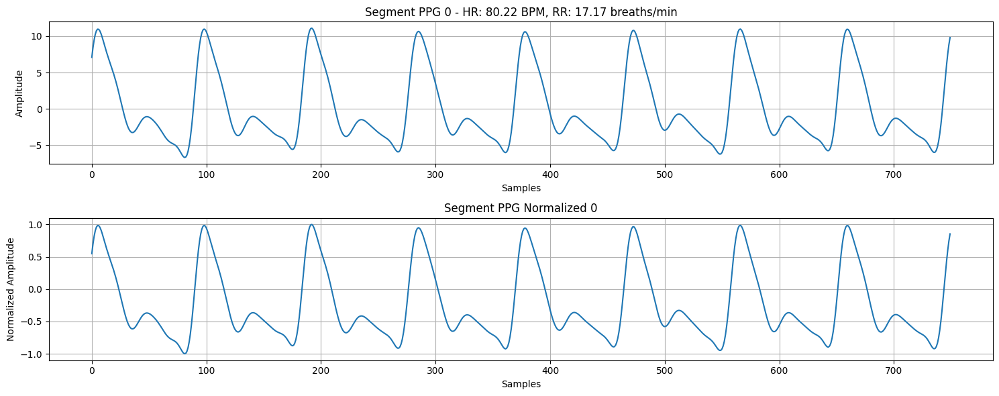

Segment 1:
  - Độ dài segment PPG: 750
  - Giá trị HR (BPM): 61.16
  - Giá trị RR (breaths/min): 14.22


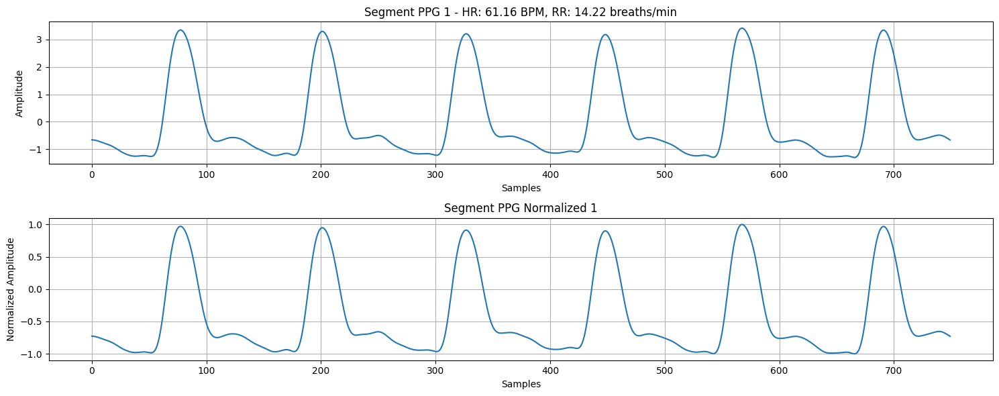

Segment 2:
  - Độ dài segment PPG: 750
  - Giá trị HR (BPM): 70.96
  - Giá trị RR (breaths/min): 8.98


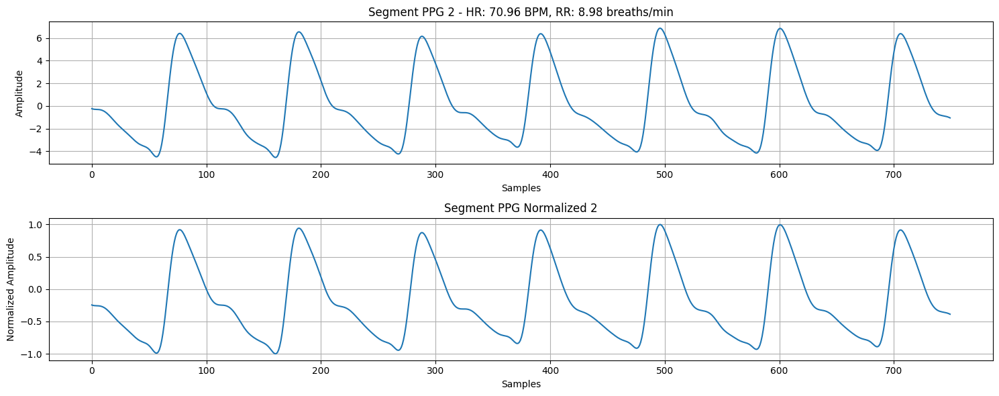

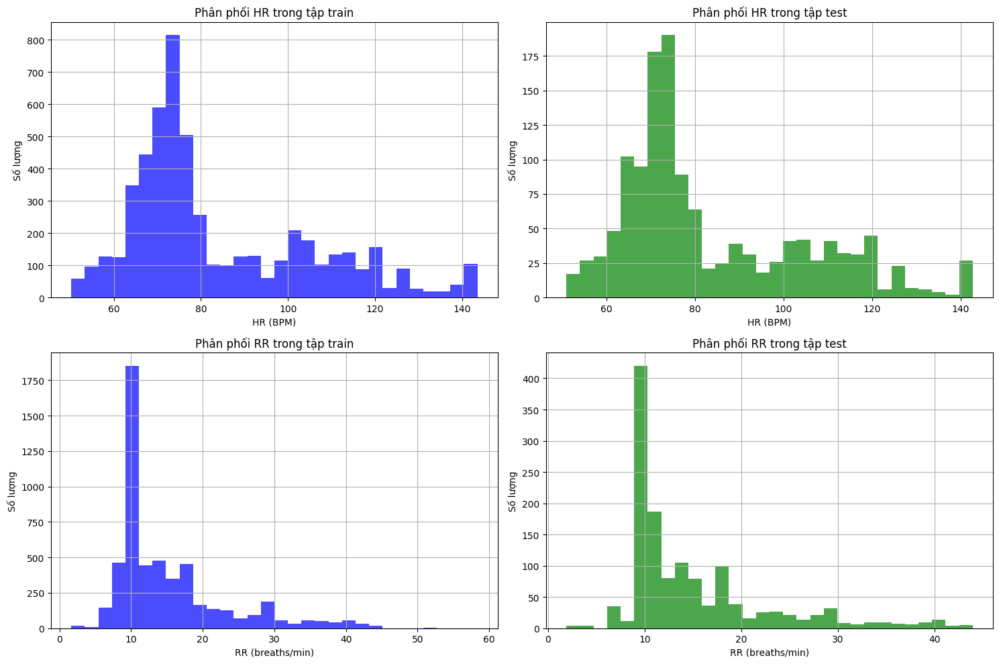

In [ ]:
import os
import h5py
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
import torch
from torch.utils.data import TensorDataset, DataLoader
from sklearn.preprocessing import MinMaxScaler

def downsample_signal(signal_data, original_fs=300, target_fs=125):
    """
    Downsample tín hiệu từ tần số gốc xuống tần số mục tiêu
    """
    new_length = int(len(signal_data) * target_fs / original_fs)
    resampled_signal = signal.resample(signal_data, new_length)
    return resampled_signal

def load_mat_file(file_path):
    """Đọc dữ liệu từ file .mat"""
    try:
        with h5py.File(file_path, 'r') as mat_data:
            print(f"Đang đọc file: {file_path}")
            print("Các khóa trong file:", list(mat_data.keys()))

            # Trích xuất tín hiệu PPG
            try:
                ppg_signal = mat_data['signal']['pleth']['y'][0]
            except Exception as e:
                print(f"Lỗi trích xuất PPG: {e}")
                ppg_signal = None

            # Trích xuất nhịp tim (HR)
            try:
                hr_ecg = mat_data['reference']['hr']['ecg']['y'][:]
                # Kiểm tra giá trị HR bất thường
                if np.any(np.isnan(hr_ecg)) or np.any(np.isinf(hr_ecg)):
                    print(f"Cảnh báo: HR chứa giá trị nan hoặc inf trong file {file_path}")
                    hr_ecg = np.nan_to_num(hr_ecg, nan=np.nanmean(hr_ecg), posinf=np.nanmax(hr_ecg), neginf=np.nanmin(hr_ecg))
            except Exception as e:
                print(f"Lỗi trích xuất HR: {e}")
                hr_ecg = None

            # Trích xuất tần số hô hấp (RR)
            try:
                rr_co2 = mat_data['reference']['rr']['co2']['y'][:]
                # Kiểm tra giá trị RR bất thường
                if np.any(np.isnan(rr_co2)) or np.any(np.isinf(rr_co2)):
                    print(f"Cảnh báo: RR chứa giá trị nan hoặc inf trong file {file_path}")
                    rr_co2 = np.nan_to_num(rr_co2, nan=np.nanmean(rr_co2), posinf=np.nanmax(rr_co2), neginf=np.nanmin(rr_co2))
            except Exception as e:
                print(f"Lỗi trích xuất RR: {e}")
                rr_co2 = None

            # Trích xuất tần số lấy mẫu
            try:
                fs_pleth = mat_data['param']['samplingrate']['pleth'][0,0]
            except Exception as e:
                print(f"Lỗi trích xuất tần số lấy mẫu: {e}")
                fs_pleth = 125  # Giá trị mặc định

            # Kiểm tra dữ liệu
            if ppg_signal is None or hr_ecg is None or rr_co2 is None:
                print(f"Dữ liệu không đầy đủ trong file {file_path}")
                return None

            # Downsample tín hiệu PPG từ 300Hz xuống 125Hz
            if fs_pleth == 300:
                ppg_signal = downsample_signal(ppg_signal, original_fs=300, target_fs=125)
                fs_pleth = 125
                print(f"Đã downsample tín hiệu từ 300Hz xuống 125Hz")

            return {
                'ppg_signal': ppg_signal,
                'hr_ecg': hr_ecg,
                'rr_co2': rr_co2,
                'fs': fs_pleth,
                'file_name': os.path.basename(file_path)
            }
    except Exception as e:
        print(f"Lỗi khi mở file {file_path}: {e}")
        return None

def filter_signal(signal_data, fs=125, low_cutoff=0.5, high_cutoff=8.0):
    """Lọc tín hiệu với bộ lọc băng thông"""
    nyquist = fs / 2
    low = low_cutoff / nyquist
    high = high_cutoff / nyquist
    b, a = signal.butter(4, [low, high], btype='band')
    filtered_signal = signal.filtfilt(b, a, signal_data)
    return filtered_signal

def collect_all_data(folder_path):
    """Bước 1: Tổng hợp tất cả các file .mat thành một tập dữ liệu"""
    all_data = []
    for filename in os.listdir(folder_path):
        if filename.endswith('.mat'):
            file_path = os.path.join(folder_path, filename)
            file_data = load_mat_file(file_path)
            if file_data:
                all_data.append(file_data)
                print(f"Đã đọc thành công file {filename}")
                print(f"Độ dài tín hiệu PPG: {len(file_data['ppg_signal'])}")
                print(f"Độ dài tín hiệu HR: {len(file_data['hr_ecg'])}")
                print(f"Độ dài tín hiệu RR: {len(file_data['rr_co2'])}")
                print(f"Tần số lấy mẫu: {file_data['fs']} Hz")
                print("-" * 50)
    print(f"Tổng số file đã đọc: {len(all_data)}")
    return all_data

def segment_all_signals(all_data, segment_length=750, overlap=0.5):
    """Phân đoạn tất cả tín hiệu mà không lọc theo HR hoặc RR"""
    all_ppg_segments = []
    all_ppg_normalized = []
    all_hr_raw = []
    all_rr_raw = []

    for data in all_data:
        ppg_signal = data['ppg_signal']
        hr_values = data['hr_ecg'].flatten()
        rr_values = data['rr_co2'].flatten()
        fs = data['fs']

        # Lọc tín hiệu PPG
        filtered_ppg = filter_signal(ppg_signal, fs=fs)

        # Phân đoạn
        step = int(segment_length * (1 - overlap))
        num_segments = (len(filtered_ppg) - segment_length) // step + 1
        print(f"Xử lý file {data['file_name']}: {num_segments} đoạn")

        for j in range(num_segments):
            start = j * step
            end = start + segment_length

            if end <= len(filtered_ppg):
                # Lấy đoạn tín hiệu PPG
                ppg_seg = filtered_ppg[start:end]

                # Tính vị trí tương ứng trong mảng HR
                hr_start_idx = int(start / len(ppg_signal) * len(hr_values))
                hr_end_idx = int(end / len(ppg_signal) * len(hr_values))
                hr_start_idx = min(hr_start_idx, len(hr_values) - 1)
                hr_end_idx = min(hr_end_idx, len(hr_values))

                # Lấy đoạn HR tương ứng
                segment_hr_values = hr_values[hr_start_idx:hr_end_idx]
                segment_hr = hr_values[hr_start_idx] if len(segment_hr_values) == 0 else np.nanmean(segment_hr_values)

                # Tính vị trí tương ứng trong mảng RR
                rr_start_idx = int(start / len(ppg_signal) * len(rr_values))
                rr_end_idx = int(end / len(ppg_signal) * len(rr_values))
                rr_start_idx = min(rr_start_idx, len(rr_values) - 1)
                rr_end_idx = min(rr_end_idx, len(rr_values))

                # Lấy đoạn RR tương ứng
                segment_rr_values = rr_values[rr_start_idx:rr_end_idx]
                segment_rr = rr_values[rr_start_idx] if len(segment_rr_values) == 0 else np.nanmean(segment_rr_values)

                # Bỏ qua đoạn nếu HR hoặc RR là nan hoặc inf
                if np.isnan(segment_hr) or np.isinf(segment_hr) or np.isnan(segment_rr) or np.isinf(segment_rr):
                    print(f"Bỏ qua đoạn {j} trong file {data['file_name']} do HR hoặc RR không hợp lệ")
                    continue

                # Chuẩn hóa PPG về [-1, 1]
                scaler = MinMaxScaler(feature_range=(-1, 1))
                ppg_seg_normalized = scaler.fit_transform(ppg_seg.reshape(-1, 1)).flatten()

                all_ppg_segments.append(ppg_seg)
                all_ppg_normalized.append(ppg_seg_normalized)
                all_hr_raw.append(segment_hr)
                all_rr_raw.append(segment_rr)

    # Chuyển về numpy array
    all_ppg_segments = np.array(all_ppg_segments)
    all_ppg_normalized = np.array(all_ppg_normalized)
    all_hr_raw = np.array(all_hr_raw)
    all_rr_raw = np.array(all_rr_raw)

    # Kiểm tra và làm sạch dữ liệu trước khi vẽ histogram
    hr_valid_mask = np.isfinite(all_hr_raw)
    rr_valid_mask = np.isfinite(all_rr_raw)
    all_hr_raw = all_hr_raw[hr_valid_mask]
    all_rr_raw = all_rr_raw[rr_valid_mask]
    all_ppg_segments = all_ppg_segments[hr_valid_mask & rr_valid_mask]
    all_ppg_normalized = all_ppg_normalized[hr_valid_mask & rr_valid_mask]

    if len(all_hr_raw) == 0 or len(all_rr_raw) == 0:
        raise ValueError("Không có dữ liệu HR hoặc RR hợp lệ sau khi làm sạch")

    # Vẽ phân phối HR và RR
    plt.figure(figsize=(15, 6))
    plt.subplot(1, 2, 1)
    plt.hist(all_hr_raw, bins=30, alpha=0.7, color='blue')
    plt.title("Phân phối HR của tất cả các đoạn")
    plt.xlabel("HR (BPM)")
    plt.ylabel("Số lượng")
    plt.grid(True)

    plt.subplot(1, 2, 2)
    plt.hist(all_rr_raw, bins=30, alpha=0.7, color='green')
    plt.title("Phân phối RR của tất cả các đoạn")
    plt.xlabel("RR (breaths/min)")
    plt.ylabel("Số lượng")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Tính thống kê HR
    hr_mean = np.nanmean(all_hr_raw)
    hr_std = np.nanstd(all_hr_raw)
    hr_min = np.nanmin(all_hr_raw)
    hr_max = np.nanmax(all_hr_raw)
    print(f"Thống kê HR:")
    print(f"Mean: {hr_mean:.2f} BPM")
    print(f"Std: {hr_std:.2f} BPM")
    print(f"Min: {hr_min:.2f} BPM")
    print(f"Max: {hr_max:.2f} BPM")

    # Tính thống kê RR
    rr_mean = np.nanmean(all_rr_raw)
    rr_std = np.nanstd(all_rr_raw)
    rr_min = np.nanmin(all_rr_raw)
    rr_max = np.nanmax(all_rr_raw)
    print(f"Thống kê RR:")
    print(f"Mean: {rr_mean:.2f} breaths/min")
    print(f"Std: {rr_std:.2f} breaths/min")
    print(f"Min: {rr_min:.2f} breaths/min")
    print(f"Max: {rr_max:.2f} breaths/min")

    print(f"Tổng số đoạn: {len(all_ppg_segments)}")
    print(f"Độ dài mỗi segment: {segment_length} điểm (~{segment_length/125:.2f} giây ở 125Hz)")

    # Vẽ một số đoạn PPG
    plt.figure(figsize=(15, 10))
    for i in range(min(5, len(all_ppg_segments))):
        plt.subplot(5, 1, i+1)
        plt.plot(all_ppg_segments[i])
        plt.title(f"Đoạn PPG {i+1} - HR: {all_hr_raw[i]:.2f} BPM, RR: {all_rr_raw[i]:.2f} breaths/min")
        plt.grid(True)
    plt.tight_layout()
    plt.show()

    return all_ppg_segments, all_ppg_normalized, all_hr_raw, all_rr_raw

def prepare_data_loaders(ppg_segments, ppg_normalized, hr_raw, rr_raw):
    """Chuẩn bị DataLoader cho huấn luyện"""
    train_size = int(0.8 * len(ppg_segments))
    indices = np.random.permutation(len(ppg_segments))
    train_indices = indices[:train_size]
    test_indices = indices[train_size:]

    X_train = ppg_segments[train_indices]
    X_test = ppg_segments[test_indices]
    X_train_norm = ppg_normalized[train_indices]
    X_test_norm = ppg_normalized[test_indices]
    hr_raw_train = hr_raw[train_indices]
    hr_raw_test = hr_raw[test_indices]
    rr_raw_train = rr_raw[train_indices]
    rr_raw_test = rr_raw[test_indices]

    # Chuẩn bị DataLoader
    train_dataset = TensorDataset(
        torch.FloatTensor(X_train_norm),
        torch.FloatTensor(hr_raw_train.reshape(-1, 1)),
        torch.FloatTensor(rr_raw_train.reshape(-1, 1))
    )
    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)

    test_dataset = TensorDataset(
        torch.FloatTensor(X_test_norm),
        torch.FloatTensor(hr_raw_test.reshape(-1, 1)),
        torch.FloatTensor(rr_raw_test.reshape(-1, 1))
    )
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

    print("\nThông tin xử lý:")
    print(f"Tổng số đoạn PPG: {len(ppg_segments)}")
    print(f"Kích thước tập train: {X_train.shape}")
    print(f"Kích thước tập test: {X_test.shape}")
    print(f"Kích thước hr_raw_train: {hr_raw_train.shape}")
    print(f"Kích thước rr_raw_train: {rr_raw_train.shape}")

    return train_loader, test_loader, X_train, X_test, X_train_norm, X_test_norm, hr_raw_train, hr_raw_test, rr_raw_train, rr_raw_test

def process_mat_folder(folder_path):
    """Hàm chính để xử lý toàn bộ thư mục"""
    print("Bước 1: Đang tổng hợp dữ liệu từ tất cả các file...")
    all_data = collect_all_data(folder_path)

    if not all_data:
        raise ValueError("Không có dữ liệu nào được đọc từ thư mục")

    print("\nBước 2: Đang phân đoạn tất cả tín hiệu...")
    all_ppg_segments, all_ppg_normalized, all_hr_raw, all_rr_raw = segment_all_signals(all_data)

    print("\nĐang chuẩn bị DataLoader cho huấn luyện...")
    result = prepare_data_loaders(all_ppg_segments, all_ppg_normalized, all_hr_raw, all_rr_raw)

    return result

# Sử dụng
folder_path = '/content/drive/MyDrive/Big/capno/data/mat'
result = process_mat_folder(folder_path)
train_loader, test_loader, X_train, X_test, X_train_norm, X_test_norm, hr_raw_train, hr_raw_test, rr_raw_train, rr_raw_test = result

# Lưu dữ liệu đã xử lý vào file .mat
import scipy.io as sio
data_to_save = {
    'X_train_norm': X_train_norm,
    'X_test_norm': X_test_norm,
    'hr_raw_train': hr_raw_train,
    'hr_raw_test': hr_raw_test,
    'rr_raw_train': rr_raw_train,
    'rr_raw_test': rr_raw_test,
    'X_total_norm': np.concatenate((X_train_norm, X_test_norm), axis=0),
    'hr_raw_total': np.concatenate((hr_raw_train, hr_raw_test), axis=0),
    'rr_raw_total': np.concatenate((rr_raw_train, rr_raw_test), axis=0)
}
sio.savemat('processed_capno_data_with_rr.mat', data_to_save)
print("Đã lưu dữ liệu vào file 'processed_capno_data_with_rr.mat'")

# In ra shape của các dữ liệu
print("\nShape của các dữ liệu:")
print(f"X_train shape: {X_train.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"X_train_norm shape: {X_train_norm.shape}")
print(f"X_test_norm shape: {X_test_norm.shape}")
print(f"hr_raw_train shape: {hr_raw_train.shape}")
print(f"hr_raw_test shape: {hr_raw_test.shape}")
print(f"rr_raw_train shape: {rr_raw_train.shape}")
print(f"rr_raw_test shape: {rr_raw_test.shape}")

# Kiểm tra một vài segment PPG và giá trị HR, RR tương ứng
print("\nKiểm tra một số segment PPG, HR và RR tương ứng:")
train_sample_indices = np.random.choice(len(X_train), size=3, replace=False)
print("\nMẫu từ tập train:")
for i, idx in enumerate(train_sample_indices):
    ppg_segment = X_train[idx]
    ppg_norm = X_train_norm[idx]
    hr_raw_value = hr_raw_train[idx]
    rr_raw_value = rr_raw_train[idx]

    print(f"Segment {i}:")
    print(f"  - Độ dài segment PPG: {len(ppg_segment)}")
    print(f"  - Giá trị HR (BPM): {hr_raw_value:.2f}")
    print(f"  - Giá trị RR (breaths/min): {rr_raw_value:.2f}")

    plt.figure(figsize=(15, 6))
    plt.subplot(2, 1, 1)
    plt.plot(ppg_segment)
    plt.title(f"Segment PPG {i} - HR: {hr_raw_value:.2f} BPM, RR: {rr_raw_value:.2f} breaths/min")
    plt.xlabel("Samples")
    plt.ylabel("Amplitude")
    plt.grid(True)

    plt.subplot(2, 1, 2)
    plt.plot(ppg_norm)
    plt.title(f"Segment PPG Normalized {i}")
    plt.xlabel("Samples")
    plt.ylabel("Normalized Amplitude")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

test_sample_indices = np.random.choice(len(X_test), size=3, replace=False)
print("\nMẫu từ tập test:")
for i, idx in enumerate(test_sample_indices):
    ppg_segment = X_test[idx]
    ppg_norm = X_test_norm[idx]
    hr_raw_value = hr_raw_test[idx]
    rr_raw_value = rr_raw_test[idx]

    print(f"Segment {i}:")
    print(f"  - Độ dài segment PPG: {len(ppg_segment)}")
    print(f"  - Giá trị HR (BPM): {hr_raw_value:.2f}")
    print(f"  - Giá trị RR (breaths/min): {rr_raw_value:.2f}")

    plt.figure(figsize=(15, 6))
    plt.subplot(2, 1, 1)
    plt.plot(ppg_segment)
    plt.title(f"Segment PPG {i} - HR: {hr_raw_value:.2f} BPM, RR: {rr_raw_value:.2f} breaths/min")
    plt.xlabel("Samples")
    plt.ylabel("Amplitude")
    plt.grid(True)

    plt.subplot(2, 1, 2)
    plt.plot(ppg_norm)
    plt.title(f"Segment PPG Normalized {i}")
    plt.xlabel("Samples")
    plt.ylabel("Normalized Amplitude")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Kiểm tra phân phối HR và RR trong tập train và test
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
plt.hist(hr_raw_train, bins=30, alpha=0.7, color='blue')
plt.title("Phân phối HR trong tập train")
plt.xlabel("HR (BPM)")
plt.ylabel("Số lượng")
plt.grid(True)

plt.subplot(2, 2, 2)
plt.hist(hr_raw_test, bins=30, alpha=0.7, color='green')
plt.title("Phân phối HR trong tập test")
plt.xlabel("HR (BPM)")
plt.ylabel("Số lượng")
plt.grid(True)

plt.subplot(2, 2, 3)
plt.hist(rr_raw_train, bins=30, alpha=0.7, color='blue')
plt.title("Phân phối RR trong tập train")
plt.xlabel("RR (breaths/min)")
plt.ylabel("Số lượng")
plt.grid(True)

plt.subplot(2, 2, 4)
plt.hist(rr_raw_test, bins=30, alpha=0.7, color='green')
plt.title("Phân phối RR trong tập test")
plt.xlabel("RR (breaths/min)")
plt.ylabel("Số lượng")
plt.grid(True)
plt.tight_layout()
plt.show()

Keys trong file .mat: ['__header__', '__version__', '__globals__', 'X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'rr_raw_train', 'rr_raw_test', 'X_total_norm', 'hr_raw_total', 'rr_raw_total']

Shape của các dữ liệu:
X_train_norm shape: (5334, 750)
X_test_norm shape: (1334, 750)
hr_raw_train shape: (5334,)
hr_raw_test shape: (1334,)
rr_raw_train shape: (5334,)
rr_raw_test shape: (1334,)
X_total_norm shape: (6668, 750)
hr_raw_total shape: (6668,)
rr_raw_total shape: (6668,)

Kiểm tra giá trị NaN và vô cực:
Có giá trị NaN trong X_train_norm: False
Có giá trị vô cực trong X_train_norm: False
Có giá trị NaN trong hr_raw_train: False
Có giá trị vô cực trong hr_raw_train: False
Có giá trị NaN trong rr_raw_train: False
Có giá trị vô cực trong rr_raw_train: False

Phạm vi giá trị:
Giá trị min của X_train_norm: -1.0
Giá trị max của X_train_norm: 1.0000000000000004
HR range: [50.23, 143.53] BPM
RR range: [1.63, 58.37] breaths/min

Kiểm tra RR bất thường:
Số đoạn với RR < 10 breath

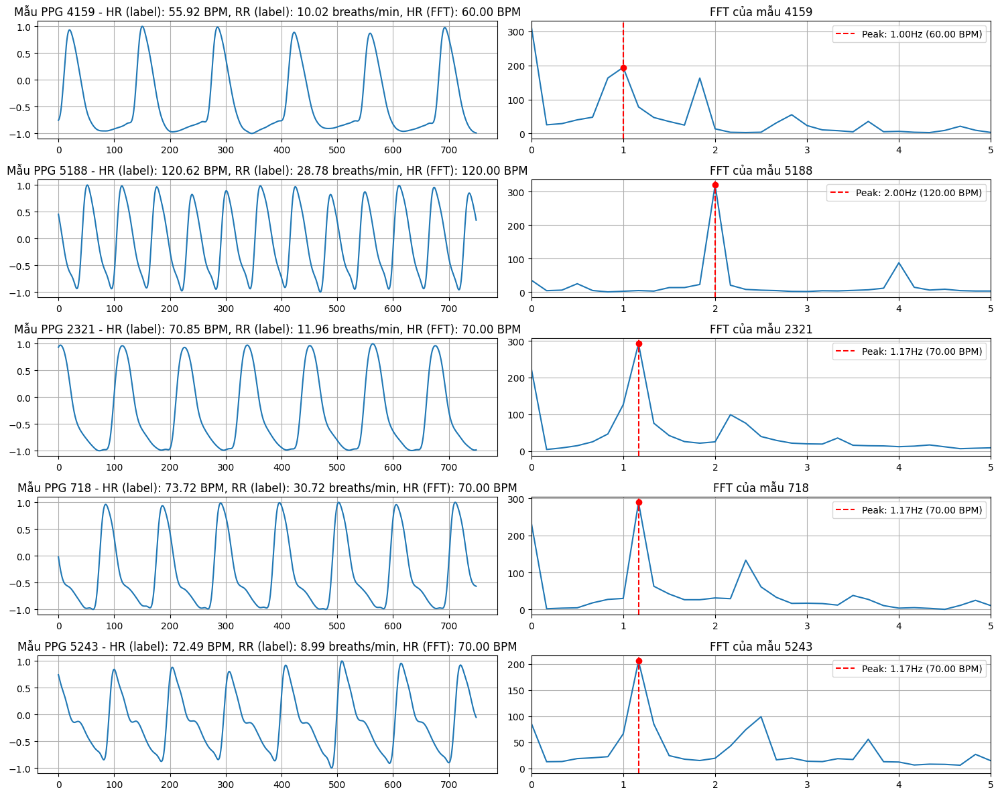


Kích thước batch dữ liệu: torch.Size([64, 750])
Kích thước batch HR: torch.Size([64, 1])
Kích thước batch RR: torch.Size([64, 1])


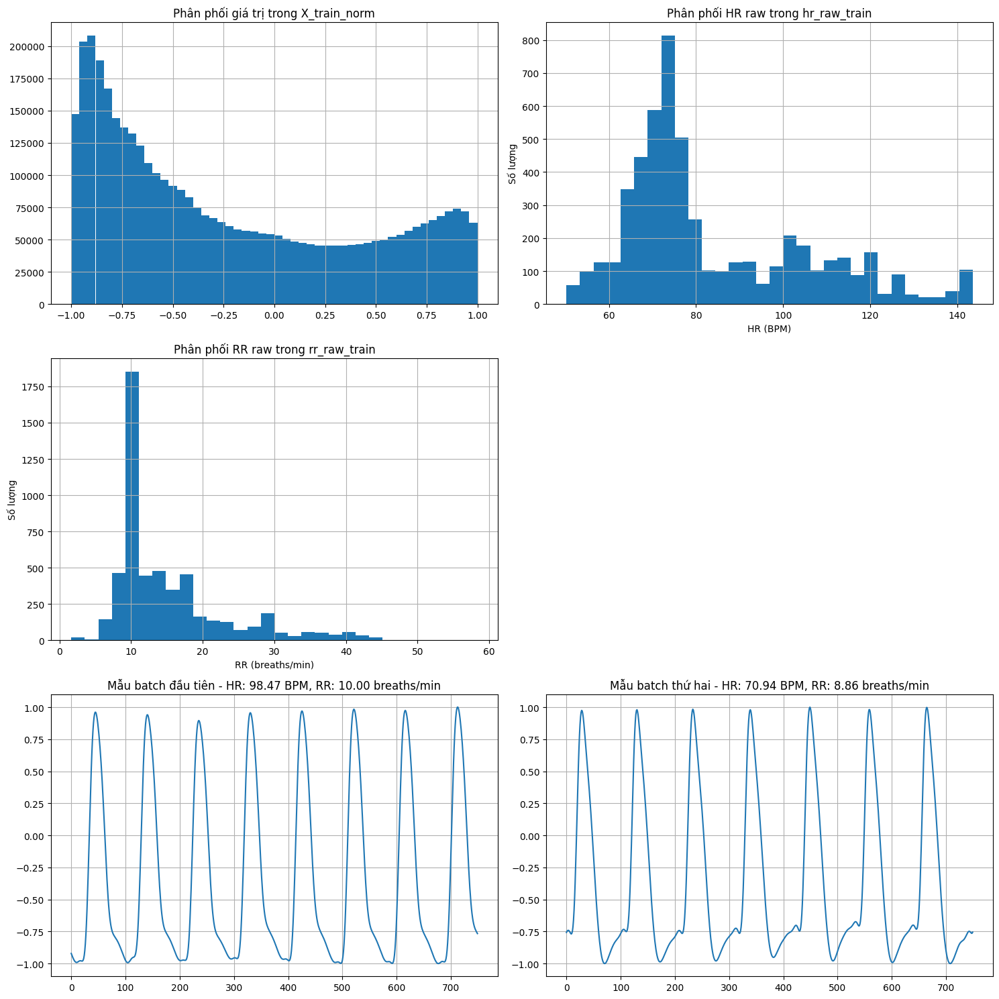

In [ ]:
import scipy.io as sio
import numpy as np
import matplotlib.pyplot as plt

# Load data từ file .mat
data = sio.loadmat('/content/processed_capno_data_with_rr.mat')

# Kiểm tra các keys trong file
print("Keys trong file .mat:", list(data.keys()))

# Kiểm tra dữ liệu đã load
X_train_norm = data['X_train_norm']
X_test_norm = data['X_test_norm']
hr_raw_train = data['hr_raw_train'].flatten()
hr_raw_test = data['hr_raw_test'].flatten()
rr_raw_train = data['rr_raw_train'].flatten()
rr_raw_test = data['rr_raw_test'].flatten()
X_total_norm = data['X_total_norm']
hr_raw_total = data['hr_raw_total'].flatten()
rr_raw_total = data['rr_raw_total'].flatten()

# In ra shape của các dữ liệu
print("\nShape của các dữ liệu:")
print(f"X_train_norm shape: {X_train_norm.shape}")
print(f"X_test_norm shape: {X_test_norm.shape}")
print(f"hr_raw_train shape: {hr_raw_train.shape}")
print(f"hr_raw_test shape: {hr_raw_test.shape}")
print(f"rr_raw_train shape: {rr_raw_train.shape}")
print(f"rr_raw_test shape: {rr_raw_test.shape}")
print(f"X_total_norm shape: {X_total_norm.shape}")
print(f"hr_raw_total shape: {hr_raw_total.shape}")
print(f"rr_raw_total shape: {rr_raw_total.shape}")

# Kiểm tra giá trị NaN hoặc vô cực
print("\nKiểm tra giá trị NaN và vô cực:")
print(f"Có giá trị NaN trong X_train_norm: {np.isnan(X_train_norm).any()}")
print(f"Có giá trị vô cực trong X_train_norm: {np.isinf(X_train_norm).any()}")
print(f"Có giá trị NaN trong hr_raw_train: {np.isnan(hr_raw_train).any()}")
print(f"Có giá trị vô cực trong hr_raw_train: {np.isinf(hr_raw_train).any()}")
print(f"Có giá trị NaN trong rr_raw_train: {np.isnan(rr_raw_train).any()}")
print(f"Có giá trị vô cực trong rr_raw_train: {np.isinf(rr_raw_train).any()}")

# Kiểm tra phạm vi giá trị
print("\nPhạm vi giá trị:")
print(f"Giá trị min của X_train_norm: {np.min(X_train_norm)}")
print(f"Giá trị max của X_train_norm: {np.max(X_train_norm)}")
print(f"HR range: [{np.min(hr_raw_train):.2f}, {np.max(hr_raw_train):.2f}] BPM")
print(f"RR range: [{np.min(rr_raw_train):.2f}, {np.max(rr_raw_train):.2f}] breaths/min")

# Kiểm tra RR bất thường
rr_outliers_low = np.sum(rr_raw_train < 10)
rr_outliers_high = np.sum(rr_raw_train > 24)
print(f"\nKiểm tra RR bất thường:")
print(f"Số đoạn với RR < 10 breaths/min: {rr_outliers_low} ({rr_outliers_low/len(rr_raw_train)*100:.2f}%)")
print(f"Số đoạn với RR > 24 breaths/min: {rr_outliers_high} ({rr_outliers_high/len(rr_raw_train)*100:.2f}%)")

# Định nghĩa hàm tính FFT và trích xuất HR từ FFT
def compute_fft(signal, fs=125):
    """Tính FFT của tín hiệu"""
    n = len(signal)
    fft_result = np.abs(np.fft.rfft(signal))
    freqs = np.fft.rfftfreq(n, d=1/fs)
    return freqs, fft_result

def extract_hr_from_fft(signal, fs=125):
    """Trích xuất nhịp tim từ FFT của tín hiệu PPG"""
    freqs, fft_result = compute_fft(signal, fs)

    # Lọc dải tần số liên quan đến nhịp tim (0.5Hz - 3.5Hz ~ 30-210 BPM)
    mask = (freqs >= 0.5) & (freqs <= 3.5)
    filtered_freqs = freqs[mask]
    filtered_fft = fft_result[mask]

    # Tìm đỉnh cao nhất trong dải tần số
    if len(filtered_freqs) > 0:
        peak_idx = np.argmax(filtered_fft)
        peak_freq = filtered_freqs[peak_idx]

        # Chuyển đổi từ Hz sang BPM
        hr_from_fft = peak_freq * 60
        return hr_from_fft, peak_freq, filtered_freqs, filtered_fft
    else:
        return None, None, filtered_freqs, filtered_fft

# Hiển thị một số mẫu dữ liệu
plt.figure(figsize=(15, 12))

# Hiển thị 5 mẫu PPG ngẫu nhiên từ tập train
num_samples = 5
random_indices = np.random.choice(len(X_train_norm), num_samples, replace=False)

for i, idx in enumerate(random_indices):
    plt.subplot(num_samples, 2, 2*i+1)
    plt.plot(X_train_norm[idx])

    # Trích xuất HR từ FFT
    hr_fft, peak_freq, filtered_freqs, filtered_fft = extract_hr_from_fft(X_train_norm[idx])
    hr_label = f"HR (label): {hr_raw_train[idx]:.2f} BPM"
    rr_label = f"RR (label): {rr_raw_train[idx]:.2f} breaths/min"
    hr_fft_text = f"HR (FFT): {hr_fft:.2f} BPM" if hr_fft is not None else "HR (FFT): N/A"

    plt.title(f"Mẫu PPG {idx} - {hr_label}, {rr_label}, {hr_fft_text}")
    plt.grid(True)

    # Hiển thị FFT của mẫu
    plt.subplot(num_samples, 2, 2*i+2)
    freqs, amplitude = compute_fft(X_train_norm[idx])
    plt.plot(freqs, amplitude)

    # Đánh dấu đỉnh FFT tương ứng với HR
    if peak_freq is not None:
        plt.axvline(x=peak_freq, color='r', linestyle='--',
                   label=f'Peak: {peak_freq:.2f}Hz ({hr_fft:.2f} BPM)')
        plt.plot(peak_freq, np.max(filtered_fft), 'ro')

    plt.xlim(0, 5)  # Giới hạn tần số hiển thị đến 5Hz
    plt.title(f"FFT của mẫu {idx}")
    plt.grid(True)
    plt.legend()

plt.tight_layout()
plt.show()

# Kiểm tra phân phối của dữ liệu
plt.figure(figsize=(15, 15))

# Phân phối giá trị trong X_train_norm
plt.subplot(3, 2, 1)
plt.hist(X_train_norm.flatten(), bins=50)
plt.title("Phân phối giá trị trong X_train_norm")
plt.grid(True)

# Phân phối HR trong hr_raw_train
plt.subplot(3, 2, 2)
plt.hist(hr_raw_train, bins=30)
plt.title("Phân phối HR raw trong hr_raw_train")
plt.xlabel("HR (BPM)")
plt.ylabel("Số lượng")
plt.grid(True)

# Phân phối RR trong rr_raw_train
plt.subplot(3, 2, 3)
plt.hist(rr_raw_train, bins=30)
plt.title("Phân phối RR raw trong rr_raw_train")
plt.xlabel("RR (breaths/min)")
plt.ylabel("Số lượng")
plt.grid(True)

# Kiểm tra batch từ DataLoader
sample_batch_data, sample_batch_hr, sample_batch_rr = next(iter(train_loader))
print(f"\nKích thước batch dữ liệu: {sample_batch_data.shape}")
print(f"Kích thước batch HR: {sample_batch_hr.shape}")
print(f"Kích thước batch RR: {sample_batch_rr.shape}")

# Hiển thị một số mẫu từ batch
plt.subplot(3, 2, 5)
plt.plot(sample_batch_data[0].numpy())
plt.title(f"Mẫu batch đầu tiên - HR: {sample_batch_hr[0, 0]:.2f} BPM, RR: {sample_batch_rr[0, 0]:.2f} breaths/min")
plt.grid(True)

plt.subplot(3, 2, 6)
plt.plot(sample_batch_data[1].numpy())
plt.title(f"Mẫu batch thứ hai - HR: {sample_batch_hr[1, 0]:.2f} BPM, RR: {sample_batch_rr[1, 0]:.2f} breaths/min")
plt.grid(True)

plt.tight_layout()
plt.show()

# CVAE với HR trên bộ capno

Using device: cuda
Đang load dữ liệu từ file processed_capno_data_with_rr.mat...
X_total_loaded shape: (6668, 750)
hr_raw_total_loaded shape: (6668,)

Thống kê HR raw total:
Min: 50.23, Max: 143.53
Mean: 83.97, Std: 21.08
Mean ± 2*Std: [41.82, 126.13]


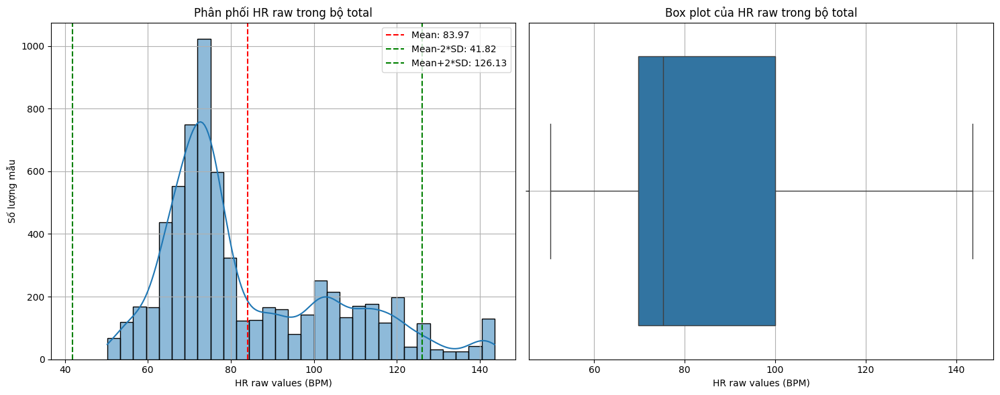

X_total_filtered shape after outlier removal: (6346, 750)
hr_raw_total_filtered shape: (6346,)

Thống kê HR raw total sau khi chuẩn hóa:
Min: 0.0998, Max: 0.9996
Mean: 0.4688, Std: 0.2128


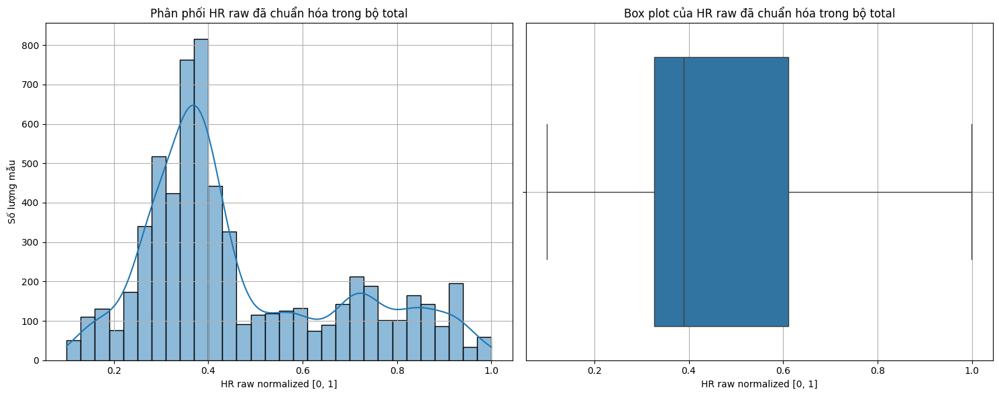

X_train_filtered shape: (5076, 750)
X_test_filtered shape: (1270, 750)

Thống kê HR raw sau khi chia tập:
Train - Min: 0.0998, Max: 0.9996
Train - Mean: 0.4696, Std: 0.2128
Test - Min: 0.1138, Max: 0.9996
Test - Mean: 0.4658, Std: 0.2129


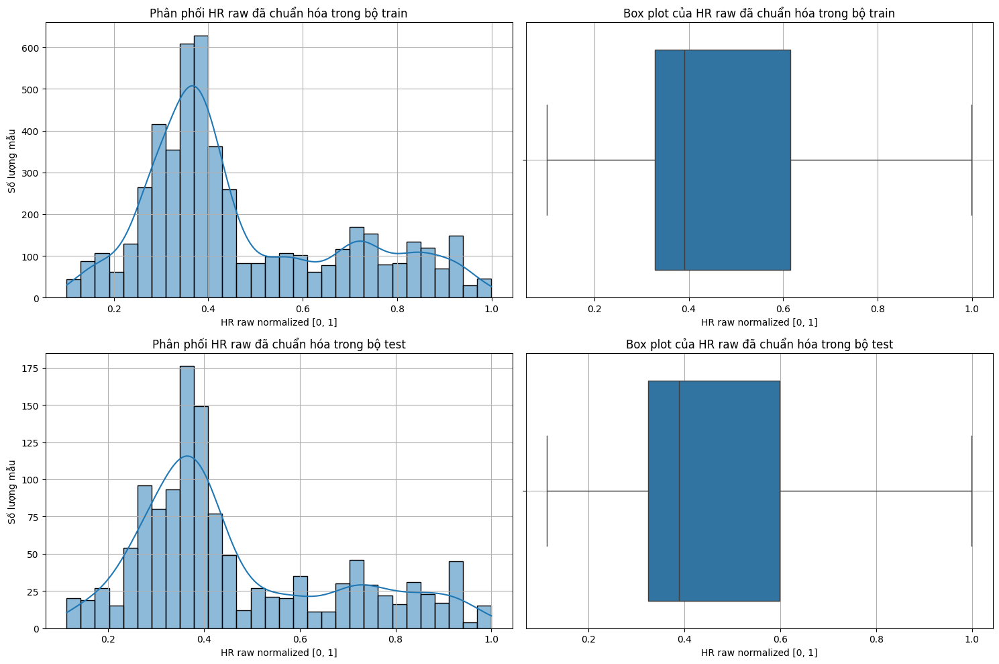

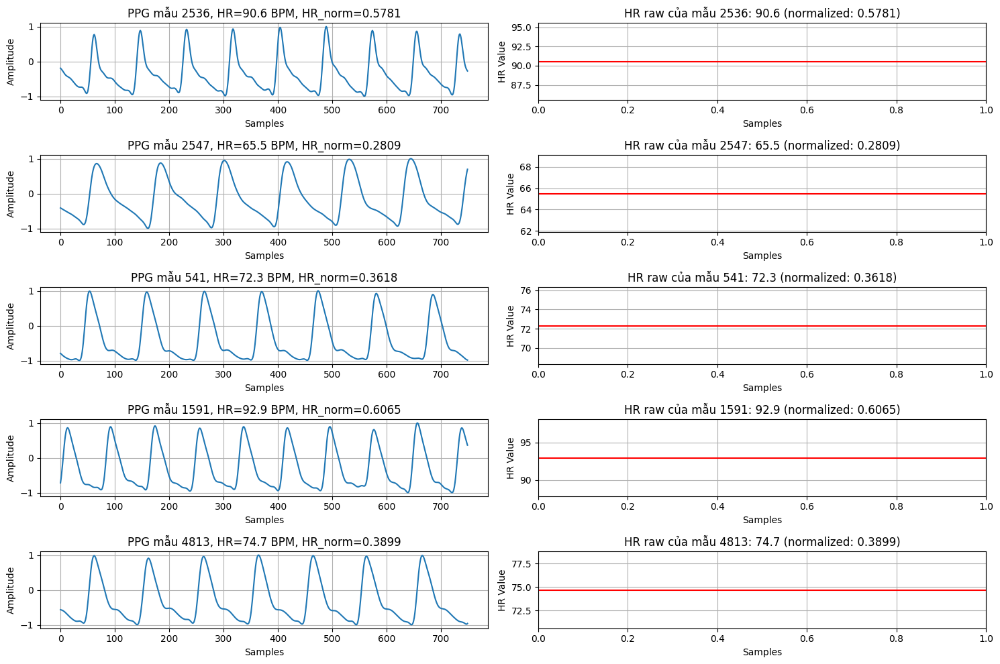

CVAEFixed(
  (encoder): EncoderFixed(
    (encoder): Sequential(
      (0): Linear(in_features=751, out_features=256, bias=True)
      (1): ReLU()
      (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): Dropout(p=0.2, inplace=False)
      (4): Linear(in_features=256, out_features=128, bias=True)
      (5): ReLU()
      (6): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): Dropout(p=0.2, inplace=False)
      (8): Linear(in_features=128, out_features=64, bias=True)
      (9): ReLU()
      (10): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): Dropout(p=0.2, inplace=False)
    )
    (z_mean): Linear(in_features=64, out_features=64, bias=True)
    (z_log_var): Linear(in_features=64, out_features=64, bias=True)
    (sampling): Sampling()
  )
  (decoder): DecoderFixed(
    (decoder): Sequential(
      (0): Linear(in_features=65, out_features=64, bias=True)
    

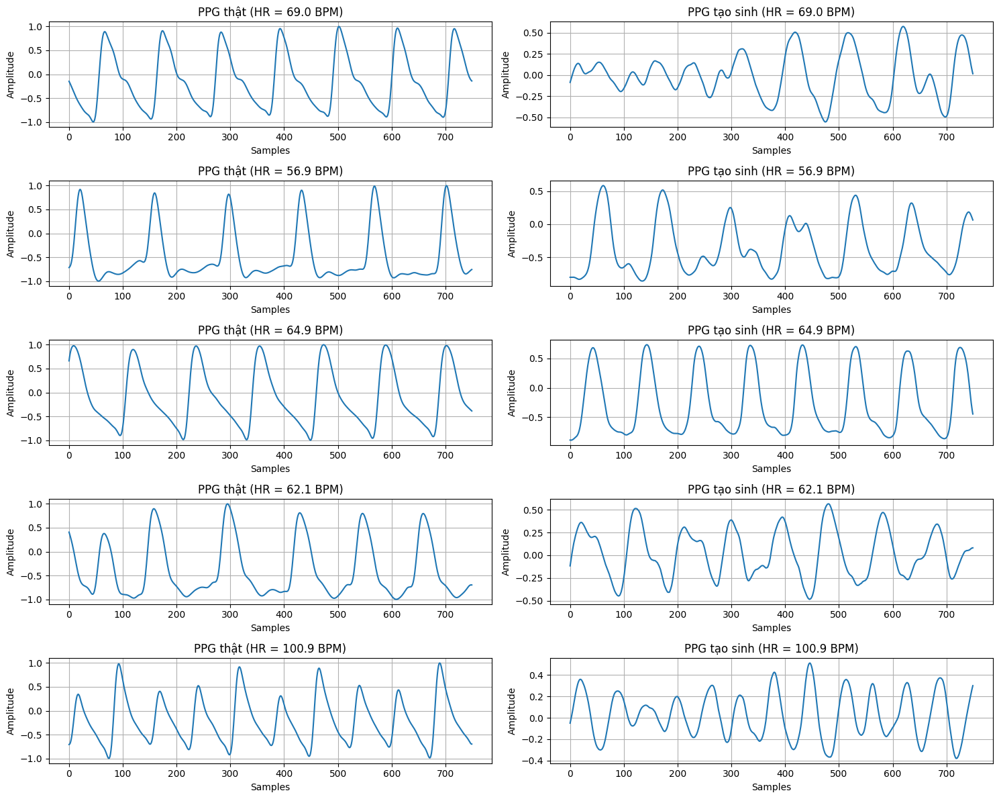

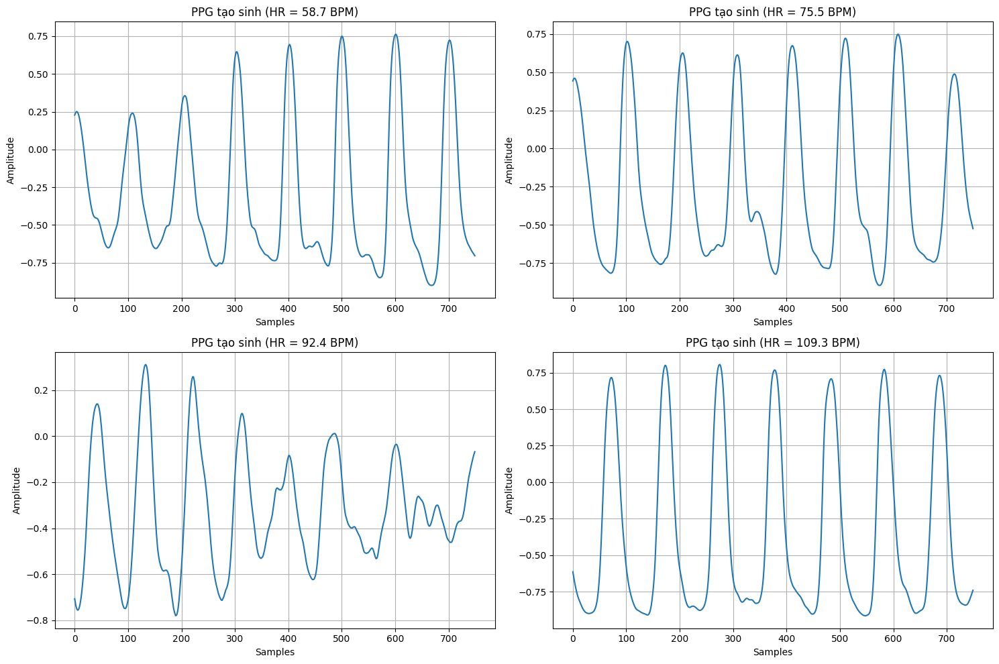

In [ ]:
import numpy as np
import scipy.io as sio
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load dữ liệu Capno
data_path = 'processed_capno_data_with_rr.mat'
print(f"Đang load dữ liệu từ file {data_path}...")
loaded_data = sio.loadmat(data_path)

# Trích xuất dữ liệu (chỉ sử dụng HR, bỏ qua RR)
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
hr_raw_train_loaded = loaded_data['hr_raw_train'].flatten()
hr_raw_test_loaded = loaded_data['hr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
hr_raw_total_loaded = loaded_data['hr_raw_total'].flatten()

print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"hr_raw_total_loaded shape: {hr_raw_total_loaded.shape}")

# Thống kê và lọc ngoại lai HR
hr_raw_total_mean = np.mean(hr_raw_total_loaded)
hr_raw_total_std = np.std(hr_raw_total_loaded)
hr_raw_lower_bound = hr_raw_total_mean - 2 * hr_raw_total_std
hr_raw_upper_bound = hr_raw_total_mean + 2 * hr_raw_total_std

# In thống kê HR thô
print("\nThống kê HR raw total:")
print(f"Min: {np.min(hr_raw_total_loaded):.2f}, Max: {np.max(hr_raw_total_loaded):.2f}")
print(f"Mean: {hr_raw_total_mean:.2f}, Std: {hr_raw_total_std:.2f}")
print(f"Mean ± 2*Std: [{hr_raw_lower_bound:.2f}, {hr_raw_upper_bound:.2f}]")

# Vẽ phân phối HR thô
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(hr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {hr_raw_total_mean:.2f}')
plt.axvline(hr_raw_lower_bound, color='g', linestyle='--', label=f'Mean-2*SD: {hr_raw_lower_bound:.2f}')
plt.axvline(hr_raw_upper_bound, color='g', linestyle='--', label=f'Mean+2*SD: {hr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_loaded)
plt.title('Box plot của HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.grid(True)

plt.tight_layout()
plt.savefig('hr_raw_total_distribution_capno.png')
plt.show()

# Lọc dữ liệu
valid_mask_total = np.logical_and(
    hr_raw_total_loaded >= hr_raw_lower_bound,
    hr_raw_total_loaded <= hr_raw_upper_bound
)

X_total_filtered = X_total_loaded[valid_mask_total]
hr_raw_total_filtered = hr_raw_total_loaded[valid_mask_total]

print(f"X_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"hr_raw_total_filtered shape: {hr_raw_total_filtered.shape}")

# Chuẩn hóa HR về [0, 1]
def normalize_hr_raw(hr_raw_data, hr_min, hr_max):
    normalized = (hr_raw_data - hr_min) / (hr_max - hr_min)
    normalized = np.clip(normalized, 0, 1)
    return normalized

hr_raw_total_normalized = normalize_hr_raw(hr_raw_total_filtered, hr_raw_lower_bound, hr_raw_upper_bound)

# In thống kê HR sau chuẩn hóa
print("\nThống kê HR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(hr_raw_total_normalized):.4f}, Max: {np.max(hr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(hr_raw_total_normalized):.4f}, Std: {np.std(hr_raw_total_normalized):.4f}")

# Vẽ phân phối HR sau chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('hr_normalized_total_distribution_capno.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, hr_raw_train_normalized, hr_raw_test_normalized = train_test_split(
    X_total_filtered, hr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy HR thô tương ứng cho train/test
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
hr_raw_train_filtered = hr_raw_total_filtered[train_indices]
hr_raw_test_filtered = hr_raw_total_filtered[test_indices]

print(f"X_train_filtered shape: {X_train_filtered.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")

# In thống kê HR sau khi chia tập
print("\nThống kê HR raw sau khi chia tập:")
print(f"Train - Min: {np.min(hr_raw_train_normalized):.4f}, Max: {np.max(hr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(hr_raw_train_normalized):.4f}, Std: {np.std(hr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(hr_raw_test_normalized):.4f}, Max: {np.max(hr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(hr_raw_test_normalized):.4f}, Std: {np.std(hr_raw_test_normalized):.4f}")

# Vẽ phân phối HR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=hr_raw_train_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(hr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=hr_raw_test_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('hr_normalized_train_test_distribution_capno.png')
plt.show()

# Vẽ một vài mẫu PPG để kiểm tra
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, HR={hr_raw_train_filtered[idx]:.1f} BPM, HR_norm={hr_raw_train_normalized[idx]:.4f}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(hr_raw_train_filtered[idx], color='r')
    plt.title(f'HR raw của mẫu {idx}: {hr_raw_train_filtered[idx]:.1f} (normalized: {hr_raw_train_normalized[idx]:.4f})')
    plt.xlabel('Samples')
    plt.ylabel('HR Value')
    plt.grid(True)

plt.tight_layout()
plt.savefig('ppg_samples_capno.png')
plt.show()

# Chuyển sang tensor
X_train_tensor = torch.tensor(X_train_filtered, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test_filtered, dtype=torch.float32)
hr_train_tensor = torch.tensor(hr_raw_train_normalized, dtype=torch.float32).unsqueeze(1)
hr_test_tensor = torch.tensor(hr_raw_test_normalized, dtype=torch.float32).unsqueeze(1)

# Tạo DataLoader
train_dataset = TensorDataset(X_train_tensor, hr_train_tensor)
test_dataset = TensorDataset(X_test_tensor, hr_test_tensor)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def forward(self, z_mean, z_log_var):
        batch, dim = z_mean.shape
        epsilon = torch.randn(batch, dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class EncoderFixed(nn.Module):
    def __init__(self, input_size, condition_size, hidden_dims, latent_dim):
        super(EncoderFixed, self).__init__()
        layers = []
        current_dim = input_size + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.encoder = nn.Sequential(*layers)
        self.z_mean = nn.Linear(current_dim, latent_dim)
        self.z_log_var = nn.Linear(current_dim, latent_dim)
        self.sampling = Sampling()

    def forward(self, x, condition):
        x_combined = torch.cat([x, condition], dim=1)
        hidden = self.encoder(x_combined)
        z_mean = self.z_mean(hidden)
        z_log_var = self.z_log_var(hidden)
        z = self.sampling(z_mean, z_log_var)
        return z, z_mean, z_log_var

# Định nghĩa Decoder
class DecoderFixed(nn.Module):
    def __init__(self, latent_dim, condition_size, hidden_dims, output_size):
        super(DecoderFixed, self).__init__()
        layers = []
        current_dim = latent_dim + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.decoder = nn.Sequential(*layers)
        self.output_layer = nn.Linear(current_dim, output_size)

    def forward(self, z, condition):
        z_combined = torch.cat([z, condition], dim=1)
        hidden = self.decoder(z_combined)
        x = torch.tanh(self.output_layer(hidden))
        return x

# Định nghĩa CVAE
class CVAEFixed(nn.Module):
    def __init__(self, input_size, condition_size, latent_dim, hidden_dims):
        super(CVAEFixed, self).__init__()
        self.encoder = EncoderFixed(input_size, condition_size, hidden_dims, latent_dim)
        self.decoder = DecoderFixed(latent_dim, condition_size, hidden_dims[::-1], input_size)

    def forward(self, x, condition):
        z, z_mean, z_log_var = self.encoder(x, condition)
        reconstruction = self.decoder(z, condition)
        return reconstruction, z_mean, z_log_var

# Khởi tạo mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 1  # Chỉ sử dụng HR
latent_dim = 64
hidden_dims = [256, 128, 64]

cvae = CVAEFixed(input_size, condition_size, latent_dim, hidden_dims).to(device)
print(cvae)

# Hàm mất mát
def cvae_loss(reconstruction, x, z_mean, z_log_var, beta=1.0):
    recon_loss = F.mse_loss(reconstruction, x, reduction='sum')
    kl_loss = -0.5 * torch.sum(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    return recon_loss + beta * kl_loss

# Huấn luyện mô hình
optimizer = torch.optim.Adam(cvae.parameters(), lr=1e-3)
num_epochs = 50

cvae.train()
for epoch in range(num_epochs):
    total_loss = 0
    for batch_idx, (x, condition) in enumerate(train_loader):
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    avg_loss = total_loss / len(train_loader.dataset)
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.6f}")

# Đánh giá trên tập test
cvae.eval()
total_test_loss = 0
with torch.no_grad():
    for x, condition in test_loader:
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        total_test_loss += loss.item()

print(f"Test Loss: {total_test_loss/len(test_loader.dataset):.6f}")

# Lưu mô hình
torch.save(cvae.state_dict(), 'cvae_capno_hr_only.pth')

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(cvae, hr_value, device):
    cvae.eval()
    with torch.no_grad():
        hr_condition = hr_value.unsqueeze(0).to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = cvae.decoder(z, hr_condition)
    return generated

# Trực quan hóa PPG thật và tạo sinh
n_samples = 5
test_samples = []
test_conditions = []

for i, (data, condition) in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0])
    test_conditions.append(condition[0])

generated_samples = []
for hr_condition in test_conditions:
    generated = evaluate_generation(cvae, hr_condition, device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (HR = {test_conditions[i].item()*(hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)
    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR = {test_conditions[i].item()*(hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('ppg_comparison_capno_hr_only.png')
plt.show()

# Tạo PPG với các giá trị HR khác nhau
hr_values = np.linspace(0.2, 0.8, 4)
generated_hr_samples = []

for hr in hr_values:
    hr_tensor = torch.tensor([hr], dtype=torch.float32)
    generated = evaluate_generation(cvae, hr_tensor, device)
    generated_hr_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 10))
for i, hr in enumerate(hr_values):
    plt.subplot(2, 2, i+1)
    plt.plot(generated_hr_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR = {hr*(hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('ppg_generated_hr_capno_hr_only.png')
plt.show()

# CVAE với RR trên bộ capno

Using device: cuda
Đang load dữ liệu từ file processed_capno_data_with_rr.mat...
X_total_loaded shape: (6668, 750)
rr_raw_total_loaded shape: (6668,)

Thống kê RR raw total:
Min: 1.63, Max: 58.37
Mean: 15.20, Std: 7.83
Mean ± 2*Std (with physiological bounds): [6.00, 30.85]


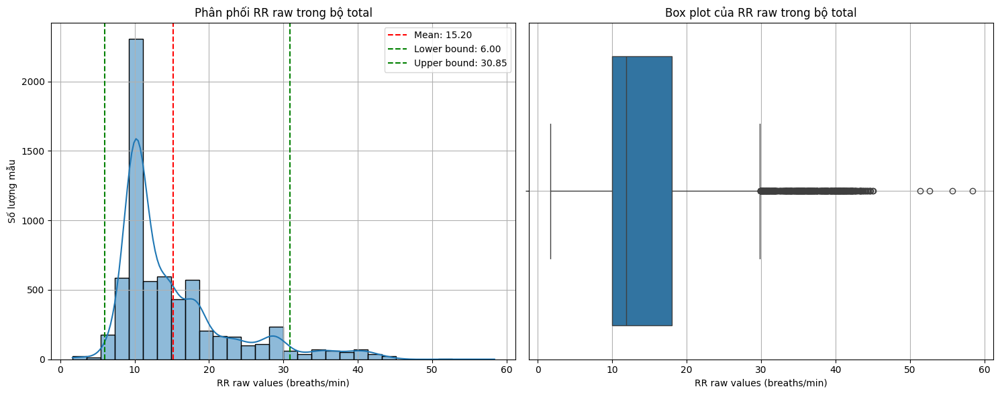

X_total_filtered shape after outlier removal: (6238, 750)
rr_raw_total_filtered shape: (6238,)

Thống kê RR raw total sau khi chuẩn hóa:
Min: 0.0318, Max: 0.9990
Mean: 0.3174, Std: 0.2227


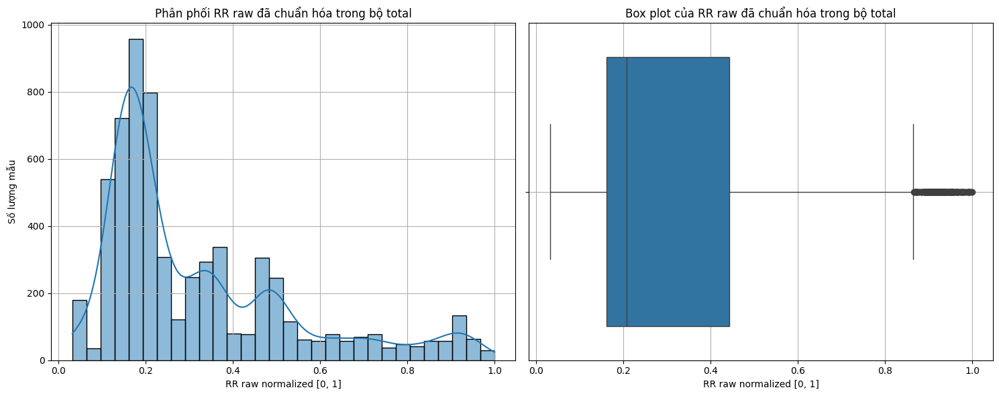

X_train_filtered shape: (4990, 750)
X_test_filtered shape: (1248, 750)

Thống kê RR raw sau khi chia tập:
Train - Min: 0.0318, Max: 0.9990
Train - Mean: 0.3189, Std: 0.2235
Test - Min: 0.0318, Max: 0.9799
Test - Mean: 0.3113, Std: 0.2193


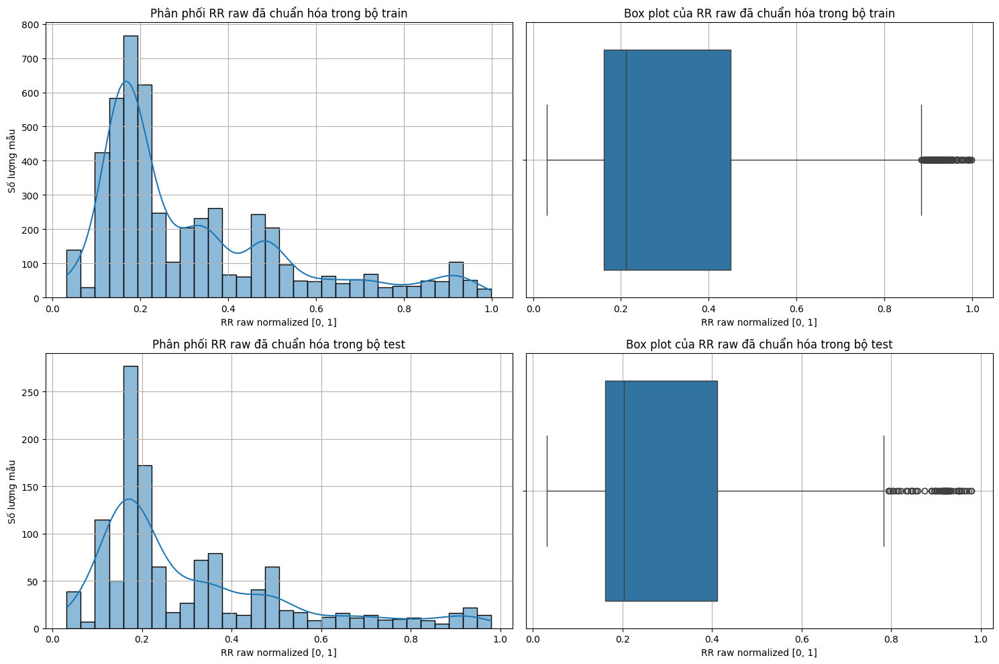

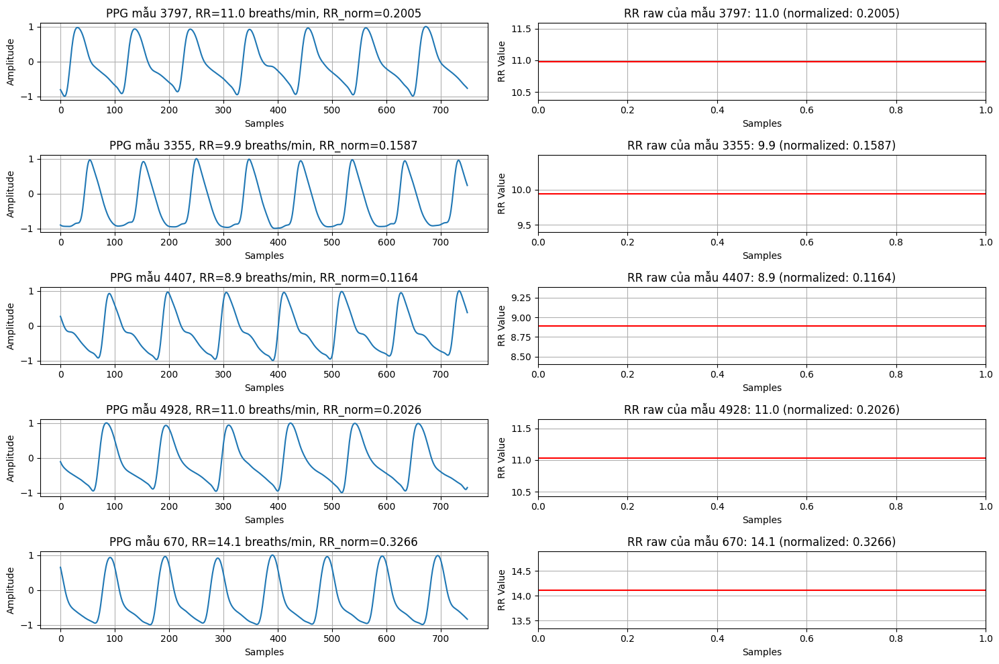

CVAEFixed(
  (encoder): EncoderFixed(
    (encoder): Sequential(
      (0): Linear(in_features=751, out_features=256, bias=True)
      (1): ReLU()
      (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): Dropout(p=0.2, inplace=False)
      (4): Linear(in_features=256, out_features=128, bias=True)
      (5): ReLU()
      (6): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): Dropout(p=0.2, inplace=False)
      (8): Linear(in_features=128, out_features=64, bias=True)
      (9): ReLU()
      (10): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): Dropout(p=0.2, inplace=False)
    )
    (z_mean): Linear(in_features=64, out_features=64, bias=True)
    (z_log_var): Linear(in_features=64, out_features=64, bias=True)
    (sampling): Sampling()
  )
  (decoder): DecoderFixed(
    (decoder): Sequential(
      (0): Linear(in_features=65, out_features=64, bias=True)
    

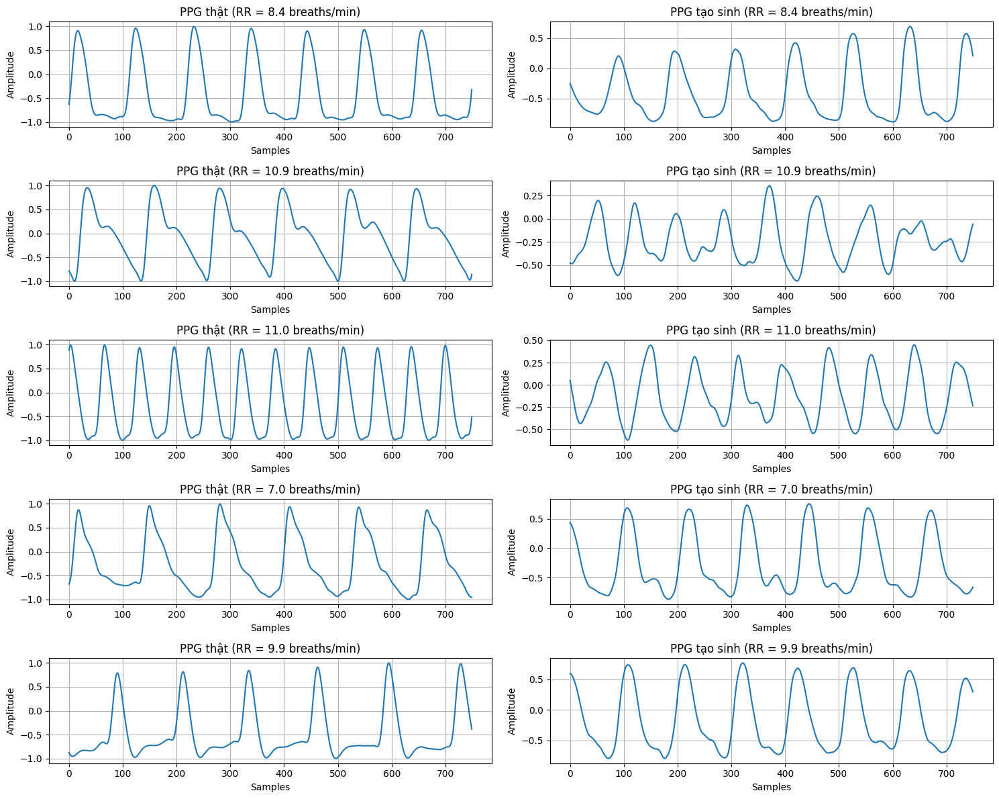

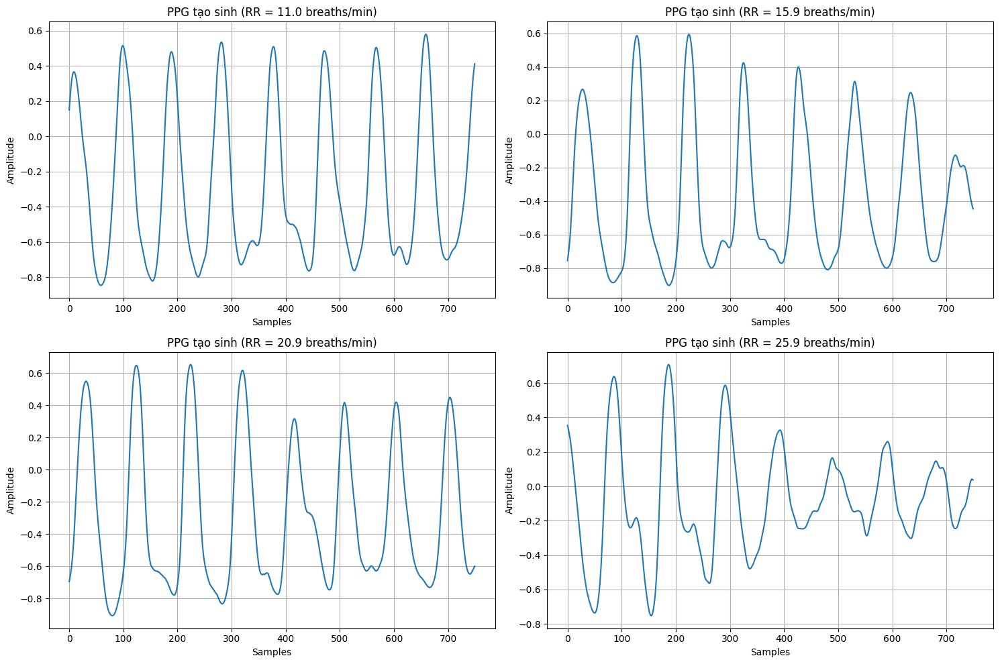

In [ ]:
import numpy as np
import scipy.io as sio
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load dữ liệu Capno
data_path = 'processed_capno_data_with_rr.mat'
print(f"Đang load dữ liệu từ file {data_path}...")
loaded_data = sio.loadmat(data_path)

# Trích xuất dữ liệu (chỉ sử dụng RR, bỏ qua HR)
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
rr_raw_train_loaded = loaded_data['rr_raw_train'].flatten()
rr_raw_test_loaded = loaded_data['rr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
rr_raw_total_loaded = loaded_data['rr_raw_total'].flatten()

print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"rr_raw_total_loaded shape: {rr_raw_total_loaded.shape}")

# Thống kê và lọc ngoại lai RR
rr_raw_total_mean = np.mean(rr_raw_total_loaded)
rr_raw_total_std = np.std(rr_raw_total_loaded)
rr_raw_lower_bound = rr_raw_total_mean - 2 * rr_raw_total_std
rr_raw_upper_bound = rr_raw_total_mean + 2 * rr_raw_total_std
# Áp dụng ngưỡng sinh lý học cho RR (6–40 breaths/min)
rr_raw_lower_bound = max(6, rr_raw_lower_bound)
rr_raw_upper_bound = min(40, rr_raw_upper_bound)

# In thống kê RR thô
print("\nThống kê RR raw total:")
print(f"Min: {np.min(rr_raw_total_loaded):.2f}, Max: {np.max(rr_raw_total_loaded):.2f}")
print(f"Mean: {rr_raw_total_mean:.2f}, Std: {rr_raw_total_std:.2f}")
print(f"Mean ± 2*Std (with physiological bounds): [{rr_raw_lower_bound:.2f}, {rr_raw_upper_bound:.2f}]")

# Vẽ phân phối RR thô
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(rr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối RR raw trong bộ total')
plt.xlabel('RR raw values (breaths/min)')
plt.ylabel('Số lượng mẫu')
plt.axvline(rr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {rr_raw_total_mean:.2f}')
plt.axvline(rr_raw_lower_bound, color='g', linestyle='--', label=f'Lower bound: {rr_raw_lower_bound:.2f}')
plt.axvline(rr_raw_upper_bound, color='g', linestyle='--', label=f'Upper bound: {rr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=rr_raw_total_loaded)
plt.title('Box plot của RR raw trong bộ total')
plt.xlabel('RR raw values (breaths/min)')
plt.grid(True)

plt.tight_layout()
plt.savefig('rr_raw_total_distribution_capno.png')
plt.show()

# Lọc dữ liệu
valid_mask_total = np.logical_and(
    rr_raw_total_loaded >= rr_raw_lower_bound,
    rr_raw_total_loaded <= rr_raw_upper_bound
)

X_total_filtered = X_total_loaded[valid_mask_total]
rr_raw_total_filtered = rr_raw_total_loaded[valid_mask_total]

print(f"X_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"rr_raw_total_filtered shape: {rr_raw_total_filtered.shape}")

# Chuẩn hóa RR về [0, 1]
def normalize_rr_raw(rr_raw_data, rr_min, rr_max):
    normalized = (rr_raw_data - rr_min) / (rr_max - rr_min)
    normalized = np.clip(normalized, 0, 1)
    return normalized

rr_raw_total_normalized = normalize_rr_raw(rr_raw_total_filtered, rr_raw_lower_bound, rr_raw_upper_bound)

# In thống kê RR sau chuẩn hóa
print("\nThống kê RR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(rr_raw_total_normalized):.4f}, Max: {np.max(rr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(rr_raw_total_normalized):.4f}, Std: {np.std(rr_raw_total_normalized):.4f}")

# Vẽ phân phối RR sau chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(rr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ total')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=rr_raw_total_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ total')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('rr_normalized_total_distribution_capno.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, rr_raw_train_normalized, rr_raw_test_normalized = train_test_split(
    X_total_filtered, rr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy RR thô tương ứng cho train/test
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
rr_raw_train_filtered = rr_raw_total_filtered[train_indices]
rr_raw_test_filtered = rr_raw_total_filtered[test_indices]

print(f"X_train_filtered shape: {X_train_filtered.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")

# In thống kê RR sau khi chia tập
print("\nThống kê RR raw sau khi chia tập:")
print(f"Train - Min: {np.min(rr_raw_train_normalized):.4f}, Max: {np.max(rr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(rr_raw_train_normalized):.4f}, Std: {np.std(rr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(rr_raw_test_normalized):.4f}, Max: {np.max(rr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(rr_raw_test_normalized):.4f}, Std: {np.std(rr_raw_test_normalized):.4f}")

# Vẽ phân phối RR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(rr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ train')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=rr_raw_train_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ train')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(rr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ test')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=rr_raw_test_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ test')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('rr_normalized_train_test_distribution_capno.png')
plt.show()

# Vẽ một vài mẫu PPG để kiểm tra
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, RR={rr_raw_train_filtered[idx]:.1f} breaths/min, RR_norm={rr_raw_train_normalized[idx]:.4f}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(rr_raw_train_filtered[idx], color='r')
    plt.title(f'RR raw của mẫu {idx}: {rr_raw_train_filtered[idx]:.1f} (normalized: {rr_raw_train_normalized[idx]:.4f})')
    plt.xlabel('Samples')
    plt.ylabel('RR Value')
    plt.grid(True)

plt.tight_layout()
plt.savefig('ppg_samples_capno_rr.png')
plt.show()

# Chuyển sang tensor
X_train_tensor = torch.tensor(X_train_filtered, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test_filtered, dtype=torch.float32)
rr_train_tensor = torch.tensor(rr_raw_train_normalized, dtype=torch.float32).unsqueeze(1)
rr_test_tensor = torch.tensor(rr_raw_test_normalized, dtype=torch.float32).unsqueeze(1)

# Tạo DataLoader
train_dataset = TensorDataset(X_train_tensor, rr_train_tensor)
test_dataset = TensorDataset(X_test_tensor, rr_test_tensor)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def forward(self, z_mean, z_log_var):
        batch, dim = z_mean.shape
        epsilon = torch.randn(batch, dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class EncoderFixed(nn.Module):
    def __init__(self, input_size, condition_size, hidden_dims, latent_dim):
        super(EncoderFixed, self).__init__()
        layers = []
        current_dim = input_size + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.encoder = nn.Sequential(*layers)
        self.z_mean = nn.Linear(current_dim, latent_dim)
        self.z_log_var = nn.Linear(current_dim, latent_dim)
        self.sampling = Sampling()

    def forward(self, x, condition):
        x_combined = torch.cat([x, condition], dim=1)
        hidden = self.encoder(x_combined)
        z_mean = self.z_mean(hidden)
        z_log_var = self.z_log_var(hidden)
        z = self.sampling(z_mean, z_log_var)
        return z, z_mean, z_log_var

# Định nghĩa Decoder
class DecoderFixed(nn.Module):
    def __init__(self, latent_dim, condition_size, hidden_dims, output_size):
        super(DecoderFixed, self).__init__()
        layers = []
        current_dim = latent_dim + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.decoder = nn.Sequential(*layers)
        self.output_layer = nn.Linear(current_dim, output_size)

    def forward(self, z, condition):
        z_combined = torch.cat([z, condition], dim=1)
        hidden = self.decoder(z_combined)
        x = torch.tanh(self.output_layer(hidden))
        return x

# Định nghĩa CVAE
class CVAEFixed(nn.Module):
    def __init__(self, input_size, condition_size, latent_dim, hidden_dims):
        super(CVAEFixed, self).__init__()
        self.encoder = EncoderFixed(input_size, condition_size, hidden_dims, latent_dim)
        self.decoder = DecoderFixed(latent_dim, condition_size, hidden_dims[::-1], input_size)

    def forward(self, x, condition):
        z, z_mean, z_log_var = self.encoder(x, condition)
        reconstruction = self.decoder(z, condition)
        return reconstruction, z_mean, z_log_var

# Khởi tạo mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 1  # Chỉ sử dụng RR
latent_dim = 64
hidden_dims = [256, 128, 64]

cvae = CVAEFixed(input_size, condition_size, latent_dim, hidden_dims).to(device)
print(cvae)

# Hàm mất mát
def cvae_loss(reconstruction, x, z_mean, z_log_var, beta=1.0):
    recon_loss = F.mse_loss(reconstruction, x, reduction='sum')
    kl_loss = -0.5 * torch.sum(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    return recon_loss + beta * kl_loss

# Huấn luyện mô hình
optimizer = torch.optim.Adam(cvae.parameters(), lr=1e-3)
num_epochs = 50

cvae.train()
for epoch in range(num_epochs):
    total_loss = 0
    for batch_idx, (x, condition) in enumerate(train_loader):
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    avg_loss = total_loss / len(train_loader.dataset)
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.6f}")

# Đánh giá trên tập test
cvae.eval()
total_test_loss = 0
with torch.no_grad():
    for x, condition in test_loader:
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        total_test_loss += loss.item()

print(f"Test Loss: {total_test_loss/len(test_loader.dataset):.6f}")

# Lưu mô hình
torch.save(cvae.state_dict(), 'cvae_capno_rr_only.pth')

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(cvae, rr_value, device):
    cvae.eval()
    with torch.no_grad():
        rr_condition = rr_value.unsqueeze(0).to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = cvae.decoder(z, rr_condition)
    return generated

# Trực quan hóa PPG thật và tạo sinh
n_samples = 5
test_samples = []
test_conditions = []

for i, (data, condition) in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0])
    test_conditions.append(condition[0])

generated_samples = []
for rr_condition in test_conditions:
    generated = evaluate_generation(cvae, rr_condition, device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (RR = {test_conditions[i].item()*(rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound:.1f} breaths/min)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)
    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (RR = {test_conditions[i].item()*(rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound:.1f} breaths/min)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('ppg_comparison_capno_rr_only.png')
plt.show()

# Tạo PPG với các giá trị RR khác nhau
rr_values = np.linspace(0.2, 0.8, 4)
generated_rr_samples = []

for rr in rr_values:
    rr_tensor = torch.tensor([rr], dtype=torch.float32)
    generated = evaluate_generation(cvae, rr_tensor, device)
    generated_rr_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 10))
for i, rr in enumerate(rr_values):
    plt.subplot(2, 2, i+1)
    plt.plot(generated_rr_samples[i].numpy())
    plt.title(f'PPG tạo sinh (RR = {rr*(rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound:.1f} breaths/min)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('ppg_generated_rr_capno_rr_only.png')
plt.show()

# CVAE với HR+RR trên bộ capno

Using device: cuda
Đang load dữ liệu từ file processed_capno_data_with_rr.mat...
X_total_loaded shape: (6668, 750)
hr_raw_total_loaded shape: (6668,)
rr_raw_total_loaded shape: (6668,)

Thống kê HR raw total:
Min: 50.23, Max: 143.53
Mean: 83.97, Std: 21.08
Bounds: [41.82, 126.13]

Thống kê RR raw total:
Min: 1.63, Max: 58.37
Mean: 15.20, Std: 7.83
Bounds: [6.00, 30.85]


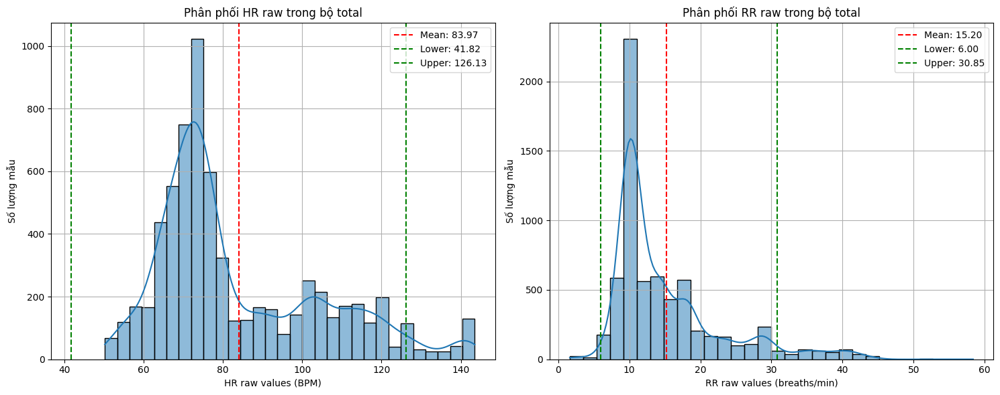

X_total_filtered shape after outlier removal: (6074, 750)
hr_raw_total_filtered shape: (6074,)
rr_raw_total_filtered shape: (6074,)

Thống kê HR raw total sau khi chuẩn hóa:
Min: 0.0998, Max: 0.9996
Mean: 0.4609, Std: 0.2100

Thống kê RR raw total sau khi chuẩn hóa:
Min: 0.0318, Max: 0.9990
Mean: 0.3151, Std: 0.2197


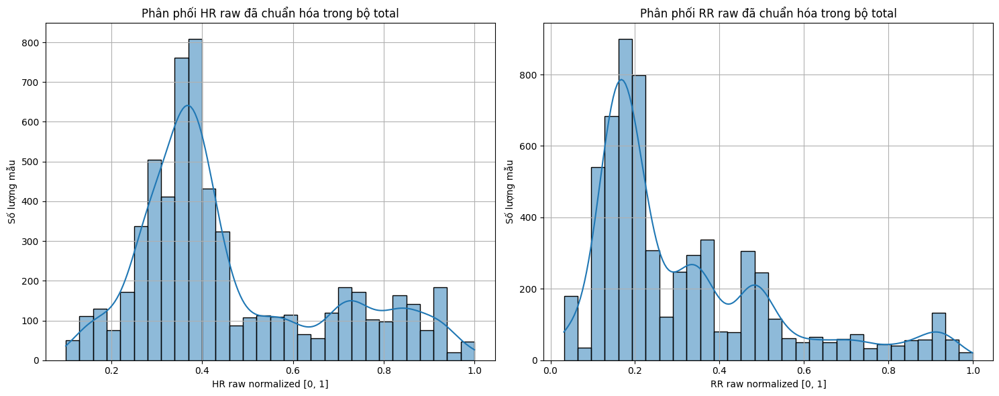

X_train_filtered shape: (4859, 750)
X_test_filtered shape: (1215, 750)

Thống kê HR raw sau khi chia tập:
Train - Min: 0.1026, Max: 0.9994
Train - Mean: 0.4594, Std: 0.2090
Test - Min: 0.0998, Max: 0.9996
Test - Mean: 0.4669, Std: 0.2140

Thống kê RR raw sau khi chia tập:
Train - Min: 0.0318, Max: 0.9990
Train - Mean: 0.3124, Std: 0.2169
Test - Min: 0.0392, Max: 0.9930
Test - Mean: 0.3260, Std: 0.2303


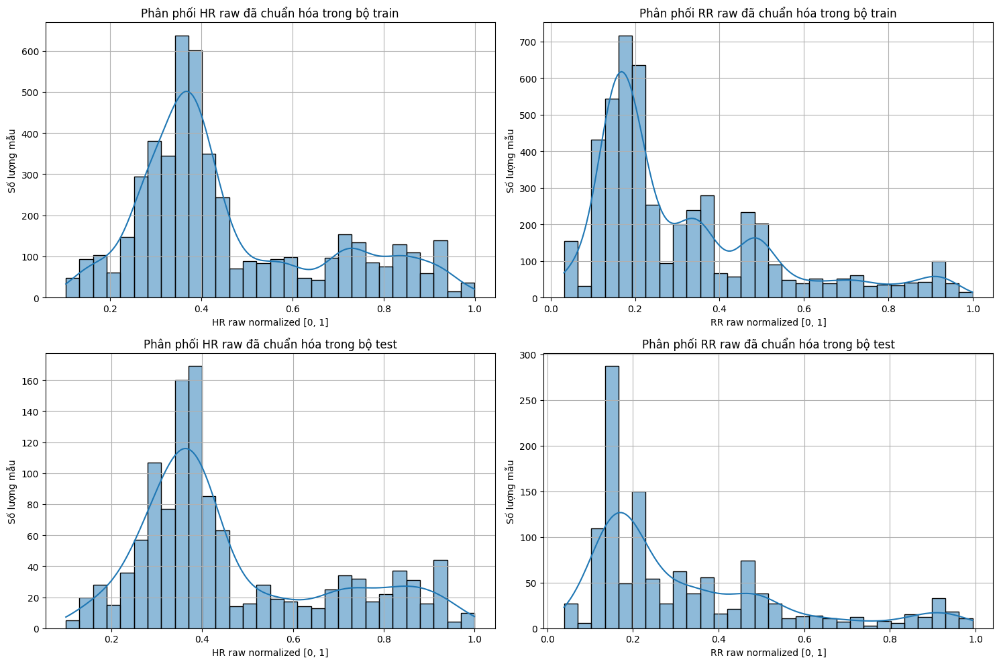

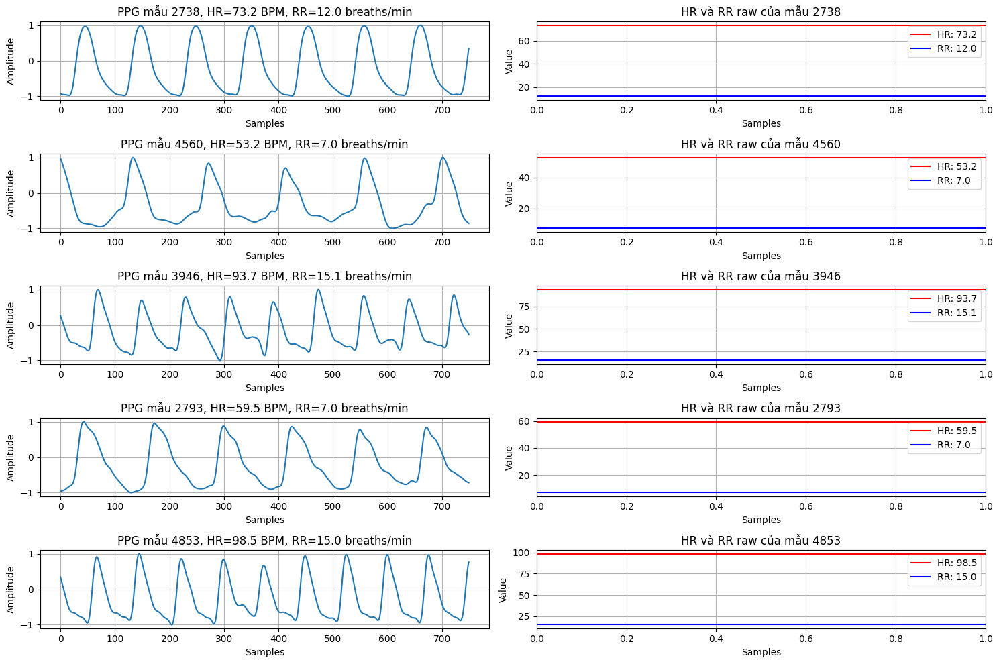

CVAEFixed(
  (encoder): EncoderFixed(
    (encoder): Sequential(
      (0): Linear(in_features=752, out_features=256, bias=True)
      (1): ReLU()
      (2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (3): Dropout(p=0.2, inplace=False)
      (4): Linear(in_features=256, out_features=128, bias=True)
      (5): ReLU()
      (6): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): Dropout(p=0.2, inplace=False)
      (8): Linear(in_features=128, out_features=64, bias=True)
      (9): ReLU()
      (10): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): Dropout(p=0.2, inplace=False)
    )
    (z_mean): Linear(in_features=64, out_features=64, bias=True)
    (z_log_var): Linear(in_features=64, out_features=64, bias=True)
    (sampling): Sampling()
  )
  (decoder): DecoderFixed(
    (decoder): Sequential(
      (0): Linear(in_features=66, out_features=64, bias=True)
    

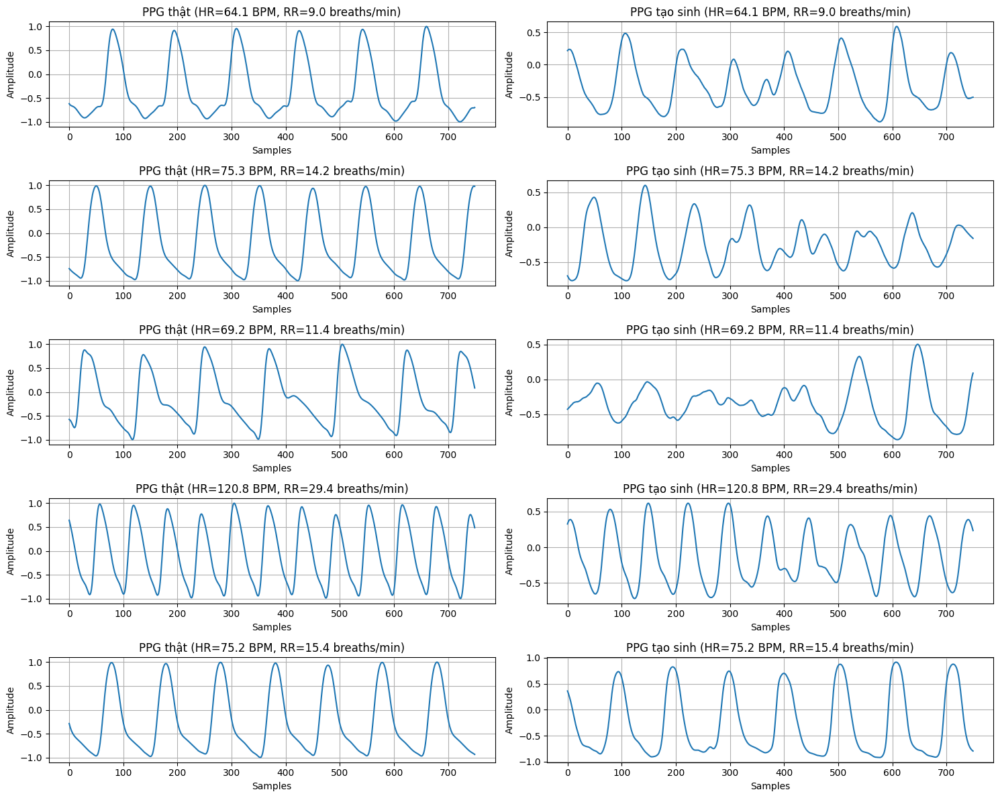

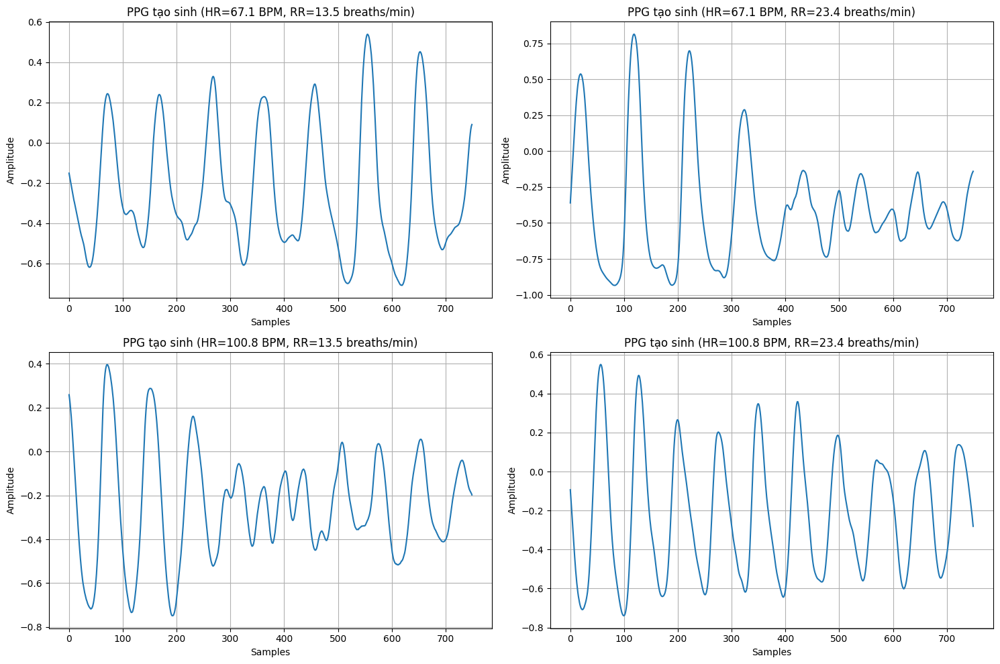

In [ ]:
import numpy as np
import scipy.io as sio
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load dữ liệu Capno
data_path = 'processed_capno_data_with_rr.mat'
print(f"Đang load dữ liệu từ file {data_path}...")
loaded_data = sio.loadmat(data_path)

# Trích xuất dữ liệu
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
hr_raw_train_loaded = loaded_data['hr_raw_train'].flatten()
hr_raw_test_loaded = loaded_data['hr_raw_test'].flatten()
rr_raw_train_loaded = loaded_data['rr_raw_train'].flatten()
rr_raw_test_loaded = loaded_data['rr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
hr_raw_total_loaded = loaded_data['hr_raw_total'].flatten()
rr_raw_total_loaded = loaded_data['rr_raw_total'].flatten()

print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"hr_raw_total_loaded shape: {hr_raw_total_loaded.shape}")
print(f"rr_raw_total_loaded shape: {rr_raw_total_loaded.shape}")

# Thống kê và lọc ngoại lai
# HR
hr_raw_total_mean = np.mean(hr_raw_total_loaded)
hr_raw_total_std = np.std(hr_raw_total_loaded)
hr_raw_lower_bound = max(30, hr_raw_total_mean - 2 * hr_raw_total_std)  # HR tối thiểu 30 BPM
hr_raw_upper_bound = min(200, hr_raw_total_mean + 2 * hr_raw_total_std)  # HR tối đa 200 BPM

# RR
rr_raw_total_mean = np.mean(rr_raw_total_loaded)
rr_raw_total_std = np.std(rr_raw_total_loaded)
rr_raw_lower_bound = max(6, rr_raw_total_mean - 2 * rr_raw_total_std)  # RR tối thiểu 6 breaths/min
rr_raw_upper_bound = min(40, rr_raw_total_mean + 2 * rr_raw_total_std)  # RR tối đa 40 breaths/min

# In thống kê
print("\nThống kê HR raw total:")
print(f"Min: {np.min(hr_raw_total_loaded):.2f}, Max: {np.max(hr_raw_total_loaded):.2f}")
print(f"Mean: {hr_raw_total_mean:.2f}, Std: {hr_raw_total_std:.2f}")
print(f"Bounds: [{hr_raw_lower_bound:.2f}, {hr_raw_upper_bound:.2f}]")

print("\nThống kê RR raw total:")
print(f"Min: {np.min(rr_raw_total_loaded):.2f}, Max: {np.max(rr_raw_total_loaded):.2f}")
print(f"Mean: {rr_raw_total_mean:.2f}, Std: {rr_raw_total_std:.2f}")
print(f"Bounds: [{rr_raw_lower_bound:.2f}, {rr_raw_upper_bound:.2f}]")

# Vẽ phân phối HR và RR thô
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(hr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {hr_raw_total_mean:.2f}')
plt.axvline(hr_raw_lower_bound, color='g', linestyle='--', label=f'Lower: {hr_raw_lower_bound:.2f}')
plt.axvline(hr_raw_upper_bound, color='g', linestyle='--', label=f'Upper: {hr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.histplot(rr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối RR raw trong bộ total')
plt.xlabel('RR raw values (breaths/min)')
plt.ylabel('Số lượng mẫu')
plt.axvline(rr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {rr_raw_total_mean:.2f}')
plt.axvline(rr_raw_lower_bound, color='g', linestyle='--', label=f'Lower: {rr_raw_lower_bound:.2f}')
plt.axvline(rr_raw_upper_bound, color='g', linestyle='--', label=f'Upper: {rr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('hr_rr_raw_total_distribution_capno.png')
plt.show()

# Lọc dữ liệu
valid_mask_total = np.logical_and(
    np.logical_and(hr_raw_total_loaded >= hr_raw_lower_bound, hr_raw_total_loaded <= hr_raw_upper_bound),
    np.logical_and(rr_raw_total_loaded >= rr_raw_lower_bound, rr_raw_total_loaded <= rr_raw_upper_bound)
)

X_total_filtered = X_total_loaded[valid_mask_total]
hr_raw_total_filtered = hr_raw_total_loaded[valid_mask_total]
rr_raw_total_filtered = rr_raw_total_loaded[valid_mask_total]

print(f"X_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"hr_raw_total_filtered shape: {hr_raw_total_filtered.shape}")
print(f"rr_raw_total_filtered shape: {rr_raw_total_filtered.shape}")

# Chuẩn hóa HR và RR về [0, 1]
def normalize_raw(data, min_val, max_val):
    normalized = (data - min_val) / (max_val - min_val)
    normalized = np.clip(normalized, 0, 1)
    return normalized

hr_raw_total_normalized = normalize_raw(hr_raw_total_filtered, hr_raw_lower_bound, hr_raw_upper_bound)
rr_raw_total_normalized = normalize_raw(rr_raw_total_filtered, rr_raw_lower_bound, rr_raw_upper_bound)

# In thống kê sau chuẩn hóa
print("\nThống kê HR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(hr_raw_total_normalized):.4f}, Max: {np.max(hr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(hr_raw_total_normalized):.4f}, Std: {np.std(hr_raw_total_normalized):.4f}")

print("\nThống kê RR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(rr_raw_total_normalized):.4f}, Max: {np.max(rr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(rr_raw_total_normalized):.4f}, Std: {np.std(rr_raw_total_normalized):.4f}")

# Vẽ phân phối HR và RR sau chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.histplot(rr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ total')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.tight_layout()
plt.savefig('hr_rr_normalized_total_distribution_capno.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, hr_raw_train_normalized, hr_raw_test_normalized, rr_raw_train_normalized, rr_raw_test_normalized = train_test_split(
    X_total_filtered, hr_raw_total_normalized, rr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy HR và RR thô tương ứng cho train/test
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
hr_raw_train_filtered = hr_raw_total_filtered[train_indices]
hr_raw_test_filtered = hr_raw_total_filtered[test_indices]
rr_raw_train_filtered = rr_raw_total_filtered[train_indices]
rr_raw_test_filtered = rr_raw_total_filtered[test_indices]

print(f"X_train_filtered shape: {X_train_filtered.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")

# In thống kê sau khi chia tập
print("\nThống kê HR raw sau khi chia tập:")
print(f"Train - Min: {np.min(hr_raw_train_normalized):.4f}, Max: {np.max(hr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(hr_raw_train_normalized):.4f}, Std: {np.std(hr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(hr_raw_test_normalized):.4f}, Max: {np.max(hr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(hr_raw_test_normalized):.4f}, Std: {np.std(hr_raw_test_normalized):.4f}")

print("\nThống kê RR raw sau khi chia tập:")
print(f"Train - Min: {np.min(rr_raw_train_normalized):.4f}, Max: {np.max(rr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(rr_raw_train_normalized):.4f}, Std: {np.std(rr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(rr_raw_test_normalized):.4f}, Max: {np.max(rr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(rr_raw_test_normalized):.4f}, Std: {np.std(rr_raw_test_normalized):.4f}")

# Vẽ phân phối HR và RR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.histplot(rr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ train')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(hr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.histplot(rr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ test')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.tight_layout()
plt.savefig('hr_rr_normalized_train_test_distribution_capno.png')
plt.show()

# Vẽ một vài mẫu PPG để kiểm tra
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, HR={hr_raw_train_filtered[idx]:.1f} BPM, RR={rr_raw_train_filtered[idx]:.1f} breaths/min')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(hr_raw_train_filtered[idx], color='r', label=f'HR: {hr_raw_train_filtered[idx]:.1f}')
    plt.axhline(rr_raw_train_filtered[idx], color='b', label=f'RR: {rr_raw_train_filtered[idx]:.1f}')
    plt.title(f'HR và RR raw của mẫu {idx}')
    plt.xlabel('Samples')
    plt.ylabel('Value')
    plt.legend()
    plt.grid(True)

plt.tight_layout()
plt.savefig('ppg_samples_capno_hr_rr.png')
plt.show()

# Chuyển sang tensor
X_train_tensor = torch.tensor(X_train_filtered, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test_filtered, dtype=torch.float32)
hr_rr_train_tensor = torch.tensor(np.vstack((hr_raw_train_normalized, rr_raw_train_normalized)).T, dtype=torch.float32)
hr_rr_test_tensor = torch.tensor(np.vstack((hr_raw_test_normalized, rr_raw_test_normalized)).T, dtype=torch.float32)

# Tạo DataLoader
train_dataset = TensorDataset(X_train_tensor, hr_rr_train_tensor)
test_dataset = TensorDataset(X_test_tensor, hr_rr_test_tensor)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def forward(self, z_mean, z_log_var):
        batch, dim = z_mean.shape
        epsilon = torch.randn(batch, dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class EncoderFixed(nn.Module):
    def __init__(self, input_size, condition_size, hidden_dims, latent_dim):
        super(EncoderFixed, self).__init__()
        layers = []
        current_dim = input_size + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.encoder = nn.Sequential(*layers)
        self.z_mean = nn.Linear(current_dim, latent_dim)
        self.z_log_var = nn.Linear(current_dim, latent_dim)
        self.sampling = Sampling()

    def forward(self, x, condition):
        x_combined = torch.cat([x, condition], dim=1)
        hidden = self.encoder(x_combined)
        z_mean = self.z_mean(hidden)
        z_log_var = self.z_log_var(hidden)
        z = self.sampling(z_mean, z_log_var)
        return z, z_mean, z_log_var

# Định nghĩa Decoder
class DecoderFixed(nn.Module):
    def __init__(self, latent_dim, condition_size, hidden_dims, output_size):
        super(DecoderFixed, self).__init__()
        layers = []
        current_dim = latent_dim + condition_size
        for h_dim in hidden_dims:
            layers.extend([
                nn.Linear(current_dim, h_dim),
                nn.ReLU(),
                nn.BatchNorm1d(h_dim),
                nn.Dropout(0.2)
            ])
            current_dim = h_dim
        self.decoder = nn.Sequential(*layers)
        self.output_layer = nn.Linear(current_dim, output_size)

    def forward(self, z, condition):
        z_combined = torch.cat([z, condition], dim=1)
        hidden = self.decoder(z_combined)
        x = torch.tanh(self.output_layer(hidden))
        return x

# Định nghĩa CVAE
class CVAEFixed(nn.Module):
    def __init__(self, input_size, condition_size, latent_dim, hidden_dims):
        super(CVAEFixed, self).__init__()
        self.encoder = EncoderFixed(input_size, condition_size, hidden_dims, latent_dim)
        self.decoder = DecoderFixed(latent_dim, condition_size, hidden_dims[::-1], input_size)

    def forward(self, x, condition):
        z, z_mean, z_log_var = self.encoder(x, condition)
        reconstruction = self.decoder(z, condition)
        return reconstruction, z_mean, z_log_var

# Khởi tạo mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 2  # HR và RR
latent_dim = 64
hidden_dims = [256, 128, 64]

cvae = CVAEFixed(input_size, condition_size, latent_dim, hidden_dims).to(device)
print(cvae)

# Hàm mất mát
def cvae_loss(reconstruction, x, z_mean, z_log_var, beta=1.0):
    recon_loss = F.mse_loss(reconstruction, x, reduction='sum')
    kl_loss = -0.5 * torch.sum(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    return recon_loss + beta * kl_loss

# Huấn luyện mô hình
optimizer = torch.optim.Adam(cvae.parameters(), lr=1e-3)
num_epochs = 50

cvae.train()
for epoch in range(num_epochs):
    total_loss = 0
    for batch_idx, (x, condition) in enumerate(train_loader):
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    avg_loss = total_loss / len(train_loader.dataset)
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.6f}")

# Đánh giá trên tập test
cvae.eval()
total_test_loss = 0
with torch.no_grad():
    for x, condition in test_loader:
        x, condition = x.to(device), condition.to(device)
        reconstruction, z_mean, z_log_var = cvae(x, condition)
        loss = cvae_loss(reconstruction, x, z_mean, z_log_var)
        total_test_loss += loss.item()

print(f"Test Loss: {total_test_loss/len(test_loader.dataset):.6f}")

# Lưu mô hình
torch.save(cvae.state_dict(), 'cvae_capno_hr_rr.pth')

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(cvae, hr_rr_condition, device):
    cvae.eval()
    with torch.no_grad():
        condition = hr_rr_condition.unsqueeze(0).to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = cvae.decoder(z, condition)
    return generated

# Trực quan hóa PPG thật và tạo sinh
n_samples = 5
test_samples = []
test_conditions = []

for i, (data, condition) in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0])
    test_conditions.append(condition[0])

generated_samples = []
for condition in test_conditions:
    generated = evaluate_generation(cvae, condition, device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    hr_val = test_conditions[i][0].item() * (hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound
    rr_val = test_conditions[i][1].item() * (rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (HR={hr_val:.1f} BPM, RR={rr_val:.1f} breaths/min)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)
    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR={hr_val:.1f} BPM, RR={rr_val:.1f} breaths/min)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('ppg_comparison_capno_hr_rr.png')
plt.show()

# Tạo PPG với các cặp giá trị HR và RR khác nhau
hr_values = np.array([0.3, 0.7])  # Hai giá trị HR chuẩn hóa
rr_values = np.array([0.3, 0.7])  # Hai giá trị RR chuẩn hóa
condition_combinations = np.array(np.meshgrid(hr_values, rr_values)).T.reshape(-1, 2)
generated_samples = []

for condition in condition_combinations:
    condition_tensor = torch.tensor(condition, dtype=torch.float32)
    generated = evaluate_generation(cvae, condition_tensor, device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 10))
for i, condition in enumerate(condition_combinations):
    hr_val = condition[0] * (hr_raw_upper_bound - hr_raw_lower_bound) + hr_raw_lower_bound
    rr_val = condition[1] * (rr_raw_upper_bound - rr_raw_lower_bound) + rr_raw_lower_bound
    plt.subplot(2, 2, i+1)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR={hr_val:.1f} BPM, RR={rr_val:.1f} breaths/min)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('ppg_generated_hr_rr_capno.png')
plt.show()

In [ ]:
from scipy.io import loadmat, savemat
import numpy as np

# Load dữ liệu từ hai file
print("Đang load dữ liệu từ processed_capno_data_with_rr.mat và processed_bidmc_data_with_rr.mat...")
capno_data = loadmat('processed_capno_data_with_rr.mat')
bidmc_data = loadmat('/content/drive/MyDrive/Big/bidmc/processed/processed_bidmc_data_with_rr.mat')

# Trích xuất dữ liệu từ file capno
capno_X_train_norm = capno_data['X_train_norm']
capno_X_test_norm = capno_data['X_test_norm']
capno_hr_raw_train = capno_data['hr_raw_train'].flatten()
capno_hr_raw_test = capno_data['hr_raw_test'].flatten()
capno_rr_raw_train = capno_data['rr_raw_train'].flatten()
capno_rr_raw_test = capno_data['rr_raw_test'].flatten()
capno_X_total_norm = capno_data['X_total_norm']
capno_hr_raw_total = capno_data['hr_raw_total'].flatten()
capno_rr_raw_total = capno_data['rr_raw_total'].flatten()

# Trích xuất dữ liệu từ file bidmc
bidmc_X_train_norm = bidmc_data['X_train_norm']
bidmc_X_test_norm = bidmc_data['X_test_norm']
bidmc_hr_raw_train = bidmc_data['hr_raw_train'].flatten()
bidmc_hr_raw_test = bidmc_data['hr_raw_test'].flatten()
bidmc_rr_raw_train = bidmc_data['rr_raw_train'].flatten()
bidmc_rr_raw_test = bidmc_data['rr_raw_test'].flatten()
bidmc_X_total_norm = bidmc_data['X_total_norm']
bidmc_hr_raw_total = bidmc_data['hr_raw_total'].flatten()
bidmc_rr_raw_total = bidmc_data['rr_raw_total'].flatten()

# Ghép dữ liệu từ hai nguồn
combined_X_train_norm = np.vstack((capno_X_train_norm, bidmc_X_train_norm))
combined_X_test_norm = np.vstack((capno_X_test_norm, bidmc_X_test_norm))
combined_hr_raw_train = np.hstack((capno_hr_raw_train, bidmc_hr_raw_train))
combined_hr_raw_test = np.hstack((capno_hr_raw_test, bidmc_hr_raw_test))
combined_rr_raw_train = np.hstack((capno_rr_raw_train, bidmc_rr_raw_train))
combined_rr_raw_test = np.hstack((capno_rr_raw_test, bidmc_rr_raw_test))
combined_X_total_norm = np.vstack((capno_X_total_norm, bidmc_X_total_norm))
combined_hr_raw_total = np.hstack((capno_hr_raw_total, bidmc_hr_raw_total))
combined_rr_raw_total = np.hstack((capno_rr_raw_total, bidmc_rr_raw_total))

# In thông tin về kích thước dữ liệu đã ghép
print("\nKích thước dữ liệu sau khi ghép:")
print(f"combined_X_train_norm: {combined_X_train_norm.shape}")
print(f"combined_X_test_norm: {combined_X_test_norm.shape}")
print(f"combined_hr_raw_train: {combined_hr_raw_train.shape}")
print(f"combined_hr_raw_test: {combined_hr_raw_test.shape}")
print(f"combined_rr_raw_train: {combined_rr_raw_train.shape}")
print(f"combined_rr_raw_test: {combined_rr_raw_test.shape}")
print(f"combined_X_total_norm: {combined_X_total_norm.shape}")
print(f"combined_hr_raw_total: {combined_hr_raw_total.shape}")
print(f"combined_rr_raw_total: {combined_rr_raw_total.shape}")

# Lưu dữ liệu đã ghép vào file .mat
data_to_save = {
    'X_train_norm': combined_X_train_norm,
    'X_test_norm': combined_X_test_norm,
    'hr_raw_train': combined_hr_raw_train,
    'hr_raw_test': combined_hr_raw_test,
    'rr_raw_train': combined_rr_raw_train,
    'rr_raw_test': combined_rr_raw_test,
    'X_total_norm': combined_X_total_norm,
    'hr_raw_total': combined_hr_raw_total,
    'rr_raw_total': combined_rr_raw_total
}

savemat('combined_data_with_rr.mat', data_to_save)
print("Đã lưu dữ liệu đã ghép vào file combined_data_with_rr.mat")

Đang load dữ liệu từ processed_capno_data_with_rr.mat và processed_bidmc_data_with_rr.mat...

Kích thước dữ liệu sau khi ghép:
combined_X_train_norm: (11566, 750)
combined_X_test_norm: (2893, 750)
combined_hr_raw_train: (11566,)
combined_hr_raw_test: (2893,)
combined_rr_raw_train: (11566,)
combined_rr_raw_test: (2893,)
combined_X_total_norm: (14459, 750)
combined_hr_raw_total: (14459,)
combined_rr_raw_total: (14459,)
Đã lưu dữ liệu đã ghép vào file combined_data_with_rr.mat


In [ ]:
from scipy.io import loadmat, savemat
import numpy as np
import os
from google.colab import drive

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Đường dẫn tới hai file đầu vào
capno_path = 'processed_capno_data_with_rr.mat'
bidmc_path = '/content/drive/MyDrive/Big/bidmc/processed/processed_bidmc_data_with_rr.mat'
output_path = '/content/drive/MyDrive/Big/processed/combined_data_with_rr.mat'

# Kiểm tra sự tồn tại của file
if not os.path.exists(capno_path):
    raise FileNotFoundError(f"File {capno_path} không tồn tại. Vui lòng kiểm tra đường dẫn hoặc chạy lại mã tiền xử lý Capno.")
if not os.path.exists(bidmc_path):
    raise FileNotFoundError(f"File {bidmc_path} không tồn tại. Vui lòng kiểm tra đường dẫn hoặc chạy lại mã tiền xử lý BIDMC.")

# Load dữ liệu từ hai file
print("Đang load dữ liệu từ processed_capno_data_with_rr.mat và processed_bidmc_data_with_rr.mat...")
capno_data = loadmat(capno_path)
bidmc_data = loadmat(bidmc_path)

# Kiểm tra các trường cần thiết
required_keys = ['X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'rr_raw_train', 'rr_raw_test', 'X_total_norm', 'hr_raw_total', 'rr_raw_total']
for key in required_keys:
    if key not in capno_data:
        raise ValueError(f"Thiếu trường {key} trong file Capno.")
    if key not in bidmc_data:
        raise ValueError(f"Thiếu trường {key} trong file BIDMC.")

# Trích xuất dữ liệu từ file capno
capno_X_train_norm = capno_data['X_train_norm']
capno_X_test_norm = capno_data['X_test_norm']
capno_hr_raw_train = capno_data['hr_raw_train'].flatten()
capno_hr_raw_test = capno_data['hr_raw_test'].flatten()
capno_rr_raw_train = capno_data['rr_raw_train'].flatten()
capno_rr_raw_test = capno_data['rr_raw_test'].flatten()
capno_X_total_norm = capno_data['X_total_norm']
capno_hr_raw_total = capno_data['hr_raw_total'].flatten()
capno_rr_raw_total = capno_data['rr_raw_total'].flatten()

# Trích xuất dữ liệu từ file bidmc
bidmc_X_train_norm = bidmc_data['X_train_norm']
bidmc_X_test_norm = bidmc_data['X_test_norm']
bidmc_hr_raw_train = bidmc_data['hr_raw_train'].flatten()
bidmc_hr_raw_test = bidmc_data['hr_raw_test'].flatten()
bidmc_rr_raw_train = bidmc_data['rr_raw_train'].flatten()
bidmc_rr_raw_test = bidmc_data['rr_raw_test'].flatten()
bidmc_X_total_norm = bidmc_data['X_total_norm']
bidmc_hr_raw_total = bidmc_data['hr_raw_total'].flatten()
bidmc_rr_raw_total = bidmc_data['rr_raw_total'].flatten()

# Ghép dữ liệu từ hai nguồn
combined_X_train_norm = np.vstack((capno_X_train_norm, bidmc_X_train_norm))
combined_X_test_norm = np.vstack((capno_X_test_norm, bidmc_X_test_norm))
combined_hr_raw_train = np.hstack((capno_hr_raw_train, bidmc_hr_raw_train))
combined_hr_raw_test = np.hstack((capno_hr_raw_test, bidmc_hr_raw_test))
combined_rr_raw_train = np.hstack((capno_rr_raw_train, bidmc_rr_raw_train))
combined_rr_raw_test = np.hstack((capno_rr_raw_test, bidmc_rr_raw_test))
combined_X_total_norm = np.vstack((capno_X_total_norm, bidmc_X_total_norm))
combined_hr_raw_total = np.hstack((capno_hr_raw_total, bidmc_hr_raw_total))
combined_rr_raw_total = np.hstack((capno_rr_raw_total, bidmc_rr_raw_total))

# In thông tin về kích thước dữ liệu đã ghép
print("\nKích thước dữ liệu sau khi ghép:")
print(f"combined_X_train_norm: {combined_X_train_norm.shape}")
print(f"combined_X_test_norm: {combined_X_test_norm.shape}")
print(f"combined_hr_raw_train: {combined_hr_raw_train.shape}")
print(f"combined_hr_raw_test: {combined_hr_raw_test.shape}")
print(f"combined_rr_raw_train: {combined_rr_raw_train.shape}")
print(f"combined_rr_raw_test: {combined_rr_raw_test.shape}")
print(f"combined_X_total_norm: {combined_X_total_norm.shape}")
print(f"combined_hr_raw_total: {combined_hr_raw_total.shape}")
print(f"combined_rr_raw_total: {combined_rr_raw_total.shape}")

# Tạo thư mục đích nếu chưa tồn tại
os.makedirs(os.path.dirname(output_path), exist_ok=True)

# Lưu dữ liệu đã ghép vào file .mat
data_to_save = {
    'X_train_norm': combined_X_train_norm,
    'X_test_norm': combined_X_test_norm,
    'hr_raw_train': combined_hr_raw_train,
    'hr_raw_test': combined_hr_raw_test,
    'rr_raw_train': combined_rr_raw_train,
    'rr_raw_test': combined_rr_raw_test,
    'X_total_norm': combined_X_total_norm,
    'hr_raw_total': combined_hr_raw_total,
    'rr_raw_total': combined_rr_raw_total
}

savemat(output_path, data_to_save)
print(f"Đã lưu dữ liệu đã ghép vào file {output_path}")

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Đang load dữ liệu từ processed_capno_data_with_rr.mat và processed_bidmc_data_with_rr.mat...

Kích thước dữ liệu sau khi ghép:
combined_X_train_norm: (11566, 750)
combined_X_test_norm: (2893, 750)
combined_hr_raw_train: (11566,)
combined_hr_raw_test: (2893,)
combined_rr_raw_train: (11566,)
combined_rr_raw_test: (2893,)
combined_X_total_norm: (14459, 750)
combined_hr_raw_total: (14459,)
combined_rr_raw_total: (14459,)
Đã lưu dữ liệu đã ghép vào file /content/drive/MyDrive/Big/processed/combined_data_with_rr.mat


# CVAE với HR trên bộ combined

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Sử dụng device: cuda
Đang load dữ liệu từ file /content/drive/MyDrive/Big/processed/combined_data_with_rr.mat...

Shape của dữ liệu đã load:
X_train_loaded shape: (11566, 750)
hr_raw_train_loaded shape: (11566,)
X_test_loaded shape: (2893, 750)
hr_raw_test_loaded shape: (2893,)
X_total_loaded shape: (14459, 750)
hr_raw_total_loaded shape: (14459,)

Thống kê HR raw total:
Min: 50.23, Max: 143.53
Mean: 87.01, Std: 17.43
Bounds: [52.15, 121.87]


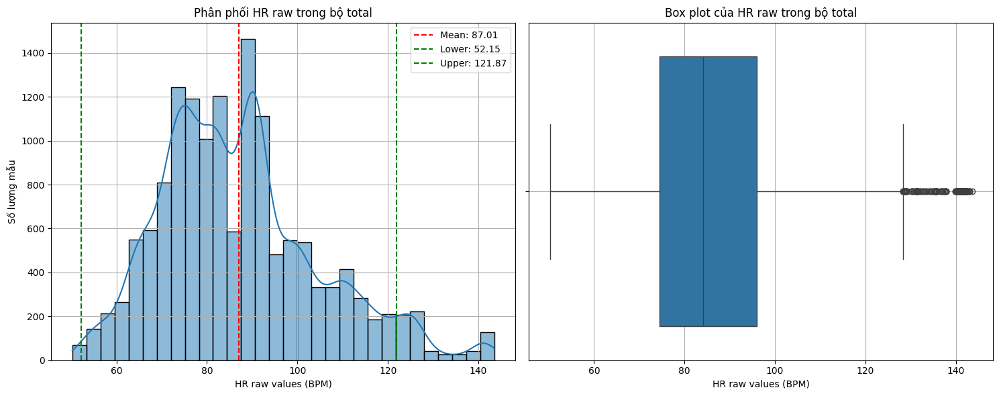


X_total_filtered shape after outlier removal: (13732, 750)
hr_raw_total_filtered shape: (13732,)

Thống kê HR raw total sau khi chuẩn hóa:
Min: 0.0011, Max: 0.9999
Mean: 0.4703, Std: 0.2115


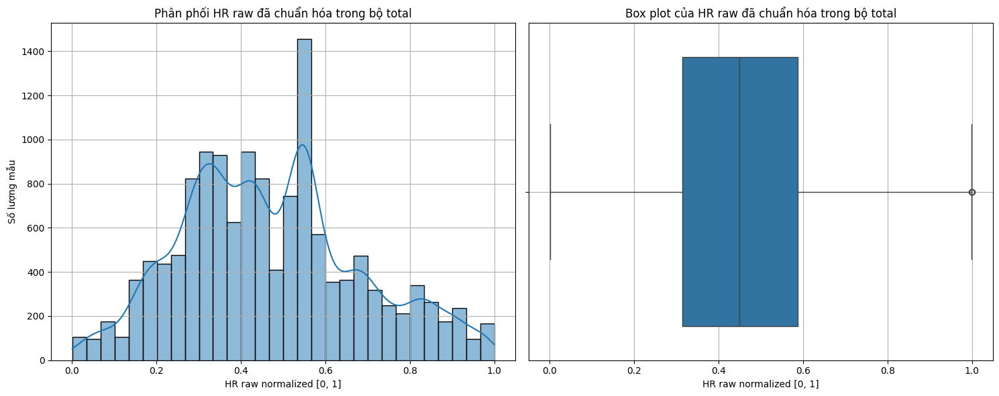


Số mẫu train ban đầu: 11566
Số mẫu train sau khi lọc: 10985
Tỷ lệ giữ lại (train): 94.98%
Số mẫu test ban đầu: 2893
Số mẫu test sau khi lọc: 2747
Tỷ lệ giữ lại (test): 94.95%

Thống kê HR raw sau khi chia tập:
Train - Min: 0.0011, Max: 0.9999
Train - Mean: 0.4694, Std: 0.2115
Test - Min: 0.0015, Max: 0.9971
Test - Mean: 0.4741, Std: 0.2110


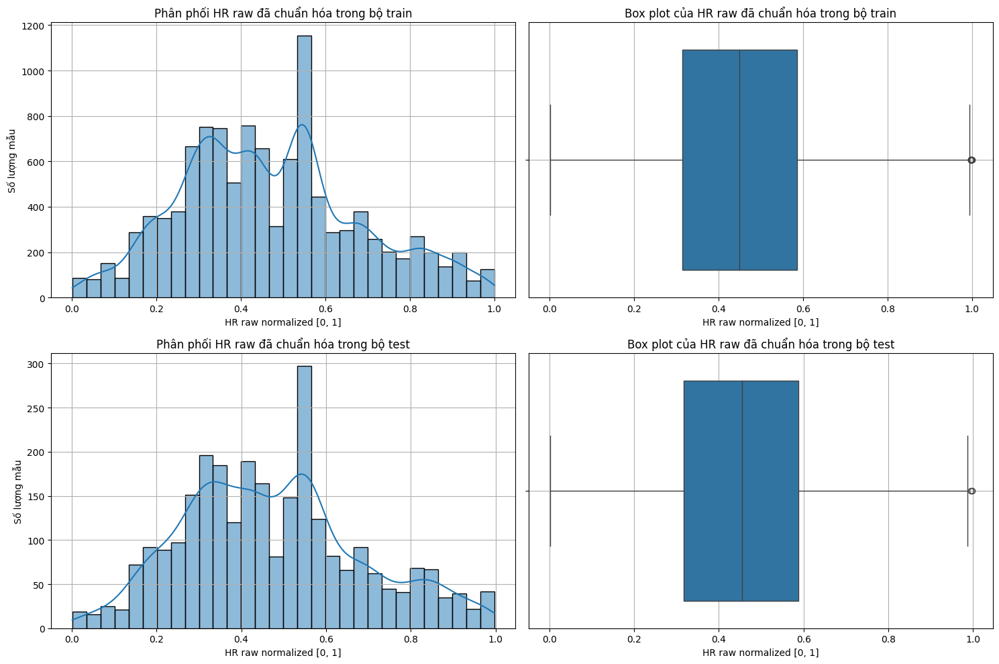

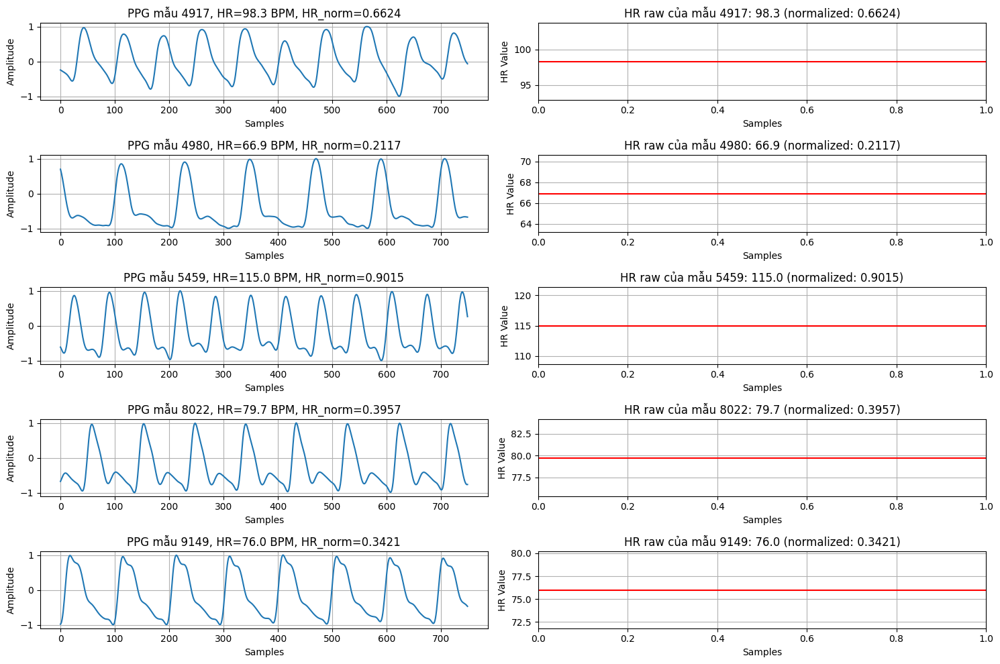

Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data.mat thành công!

X_train_filtered shape: (10985, 750)
hr_raw_train_normalized shape: (10985,)
X_test_filtered shape: (2747, 750)
hr_raw_test_normalized shape: (2747,)
Batch data shape: torch.Size([64, 750])
Batch condition shape: torch.Size([64, 1])
Xây dựng mô hình với input_size=750, condition_size=1

=== Cấu trúc Encoder ===
EncoderFixed(
  (input_layer): Linear(in_features=751, out_features=256, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=256, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=64, bias=True)
  )
  (z_mean): Linear(in_features=64, out_features=64, bias=True)
  (z_log_var): Linear(in_features=64, out_features=64, bias=True)
  (sampling): Sampling()
)

=== Cấu trúc Decoder ===
DecoderFixed(
  (input_layer): Linear(in_features=65, out_features=64, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=64, out_features=128, bi

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch 0/600
Train Loss: 0.3444, Test Loss: 0.3407
Recon Loss: 0.3362, KL Loss: 0.0090
Epoch 10/600
Train Loss: 0.1832, Test Loss: 0.1797
Recon Loss: 0.1312, KL Loss: 0.0971
Epoch 20/600
Train Loss: 0.1415, Test Loss: 0.1435
Recon Loss: 0.0921, KL Loss: 0.1027
Epoch 30/600
Train Loss: 0.1304, Test Loss: 0.1340
Recon Loss: 0.0822, KL Loss: 0.1035
Epoch 40/600
Train Loss: 0.1253, Test Loss: 0.1283
Recon Loss: 0.0789, KL Loss: 0.0986
Epoch 50/600
Train Loss: 0.1220, Test Loss: 0.1273
Recon Loss: 0.0767, KL Loss: 0.1013
Epoch 60/600
Train Loss: 0.1199, Test Loss: 0.1247
Recon Loss: 0.0716, KL Loss: 0.1062
Epoch 70/600
Train Loss: 0.1184, Test Loss: 0.1241
Recon Loss: 0.0739, KL Loss: 0.1005
Epoch 80/600
Train Loss: 0.1170, Test Loss: 0.1222
Recon Loss: 0.0718, KL Loss: 0.1008
Epoch 90/600
Train Loss: 0.1162, Test Loss: 0.1220
Recon Loss: 0.0689, KL Loss: 0.1063
Epoch 100/600
Train Loss: 0.1157, Test Loss: 0.1216
Recon Loss: 0.0717, KL Loss: 0.0999
Epoch 110/600
Train Loss: 0.1148, Test Loss

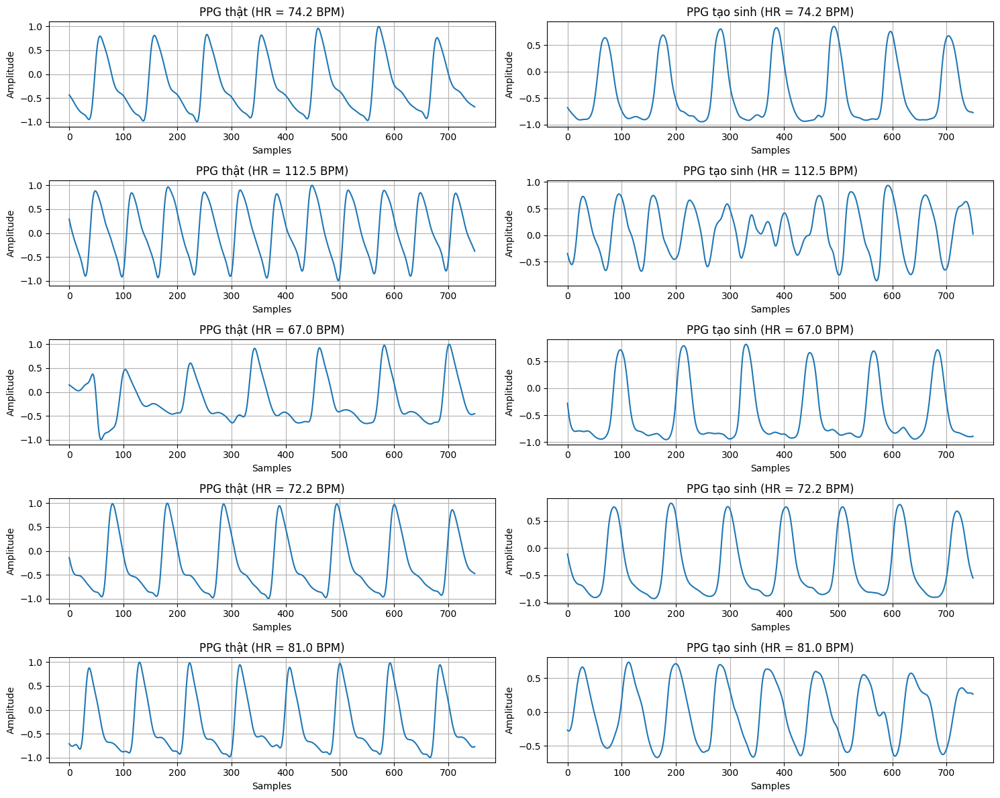

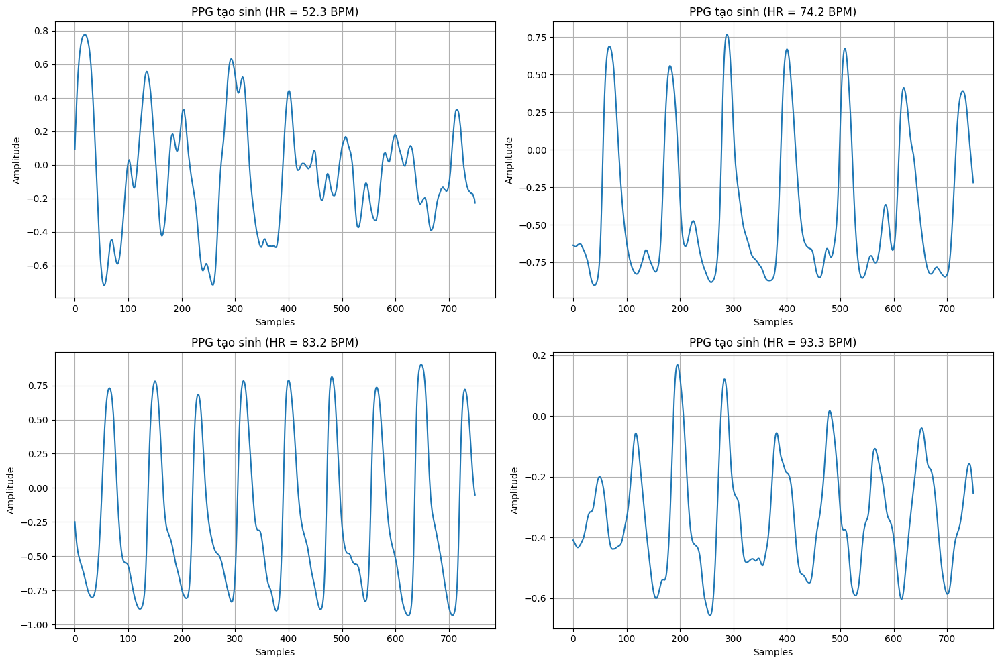

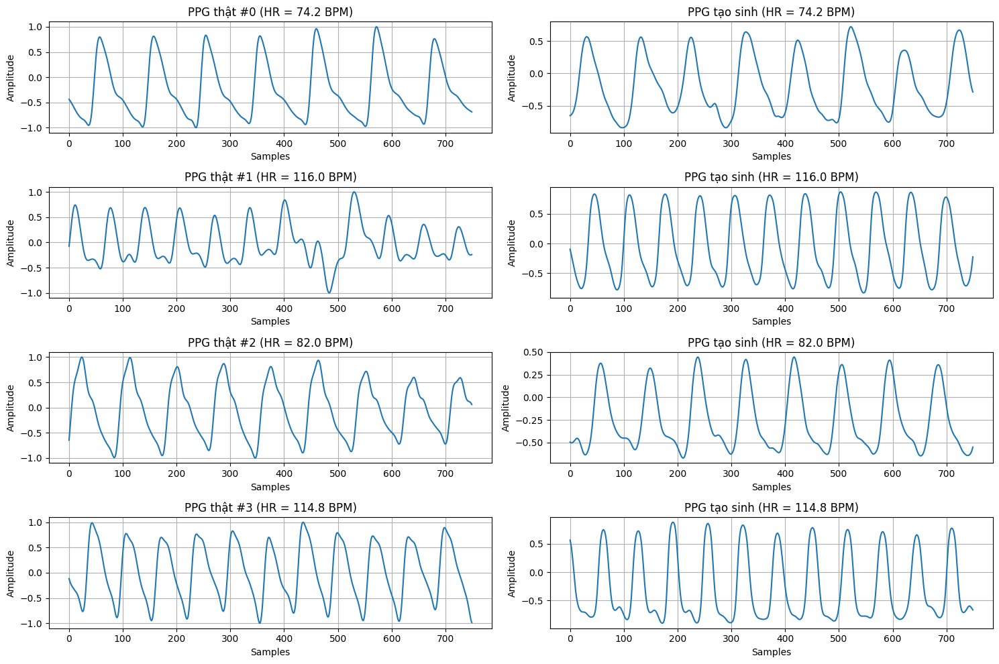

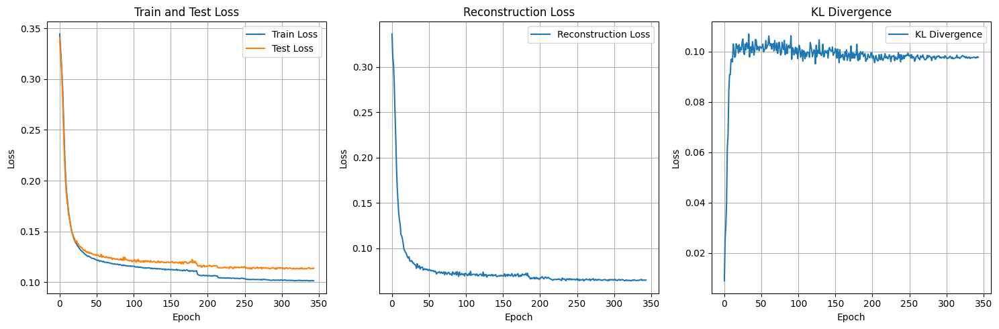

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import loadmat
from google.colab import drive
import os
from sklearn.model_selection import train_test_split

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Sử dụng device: {device}")

# Đường dẫn file dữ liệu
data_path = '/content/drive/MyDrive/Big/processed/combined_data_with_rr.mat'

# Kiểm tra sự tồn tại của file
if not os.path.exists(data_path):
    raise FileNotFoundError(f"File {data_path} không tồn tại.")

# Load dữ liệu từ file
print(f"Đang load dữ liệu từ file {data_path}...")
loaded_data = loadmat(data_path)

# Kiểm tra các trường cần thiết
required_keys = ['X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'X_total_norm', 'hr_raw_total']
for key in required_keys:
    if key not in loaded_data:
        raise ValueError(f"Thiếu trường {key} trong file {data_path}")

# Trích xuất dữ liệu
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
hr_raw_train_loaded = loaded_data['hr_raw_train'].flatten()
hr_raw_test_loaded = loaded_data['hr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
hr_raw_total_loaded = loaded_data['hr_raw_total'].flatten()

# Kiểm tra kích thước dữ liệu đã load
print("\nShape của dữ liệu đã load:")
print(f"X_train_loaded shape: {X_train_loaded.shape}")
print(f"hr_raw_train_loaded shape: {hr_raw_train_loaded.shape}")
print(f"X_test_loaded shape: {X_test_loaded.shape}")
print(f"hr_raw_test_loaded shape: {hr_raw_test_loaded.shape}")
print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"hr_raw_total_loaded shape: {hr_raw_total_loaded.shape}")

# Tính toán thống kê cho hr_raw_total_loaded
hr_raw_total_min = np.min(hr_raw_total_loaded)
hr_raw_total_max = np.max(hr_raw_total_loaded)
hr_raw_total_mean = np.mean(hr_raw_total_loaded)
hr_raw_total_std = np.std(hr_raw_total_loaded)
hr_raw_lower_bound = max(30, hr_raw_total_mean - 2 * hr_raw_total_std)
hr_raw_upper_bound = min(200, hr_raw_total_mean + 2 * hr_raw_total_std)

# In thống kê
print("\nThống kê HR raw total:")
print(f"Min: {hr_raw_total_min:.2f}, Max: {hr_raw_total_max:.2f}")
print(f"Mean: {hr_raw_total_mean:.2f}, Std: {hr_raw_total_std:.2f}")
print(f"Bounds: [{hr_raw_lower_bound:.2f}, {hr_raw_upper_bound:.2f}]")

# Tạo thư mục lưu biểu đồ
os.makedirs('/content/drive/MyDrive/Big/figures/', exist_ok=True)

# Vẽ phân phối HR raw của bộ total
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(hr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {hr_raw_total_mean:.2f}')
plt.axvline(hr_raw_lower_bound, color='g', linestyle='--', label=f'Lower: {hr_raw_lower_bound:.2f}')
plt.axvline(hr_raw_upper_bound, color='g', linestyle='--', label=f'Upper: {hr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_loaded)
plt.title('Box plot của HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/hr_raw_total_distribution_combined.png')
plt.show()

# Lọc dữ liệu nằm trong khoảng [hr_raw_lower_bound, hr_raw_upper_bound]
valid_mask_total = (hr_raw_total_loaded >= hr_raw_lower_bound) & (hr_raw_total_loaded <= hr_raw_upper_bound)
X_total_filtered = X_total_loaded[valid_mask_total]
hr_raw_total_filtered = hr_raw_total_loaded[valid_mask_total]

print(f"\nX_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"hr_raw_total_filtered shape: {hr_raw_total_filtered.shape}")

# Chuẩn hóa HR raw về [0, 1]
def normalize_hr_raw(hr_raw_data, hr_min, hr_max):
    normalized = (hr_raw_data - hr_min) / (hr_max - hr_min)
    normalized = np.clip(normalized, 0, 1)
    return normalized

hr_raw_total_normalized = normalize_hr_raw(hr_raw_total_filtered, hr_raw_lower_bound, hr_raw_upper_bound)

# Kiểm tra kết quả chuẩn hóa
print("\nThống kê HR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(hr_raw_total_normalized):.4f}, Max: {np.max(hr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(hr_raw_total_normalized):.4f}, Std: {np.std(hr_raw_total_normalized):.4f}")

# Vẽ phân phối HR sau khi chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/hr_normalized_total_distribution_combined.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, hr_raw_train_normalized, hr_raw_test_normalized = train_test_split(
    X_total_filtered, hr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy HR thô tương ứng
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
hr_raw_train_filtered = hr_raw_total_filtered[train_indices]
hr_raw_test_filtered = hr_raw_total_filtered[test_indices]

# In thông tin số lượng mẫu
print(f"\nSố mẫu train ban đầu: {X_train_loaded.shape[0]}")
print(f"Số mẫu train sau khi lọc: {X_train_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (train): {X_train_filtered.shape[0]/X_train_loaded.shape[0]*100:.2f}%")
print(f"Số mẫu test ban đầu: {X_test_loaded.shape[0]}")
print(f"Số mẫu test sau khi lọc: {X_test_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (test): {X_test_filtered.shape[0]/X_test_loaded.shape[0]*100:.2f}%")

# Kiểm tra thống kê HR sau khi chia tập
print("\nThống kê HR raw sau khi chia tập:")
print(f"Train - Min: {np.min(hr_raw_train_normalized):.4f}, Max: {np.max(hr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(hr_raw_train_normalized):.4f}, Std: {np.std(hr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(hr_raw_test_normalized):.4f}, Max: {np.max(hr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(hr_raw_test_normalized):.4f}, Std: {np.std(hr_raw_test_normalized):.4f}")

# Vẽ phân phối HR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=hr_raw_train_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(hr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=hr_raw_test_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/hr_normalized_train_test_distribution_combined.png')
plt.show()

# Vẽ một vài mẫu PPG
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, HR={hr_raw_train_filtered[idx]:.1f} BPM, HR_norm={hr_raw_train_normalized[idx]:.4f}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(hr_raw_train_filtered[idx], color='r')
    plt.title(f'HR raw của mẫu {idx}: {hr_raw_train_filtered[idx]:.1f} (normalized: {hr_raw_train_normalized[idx]:.4f})')
    plt.xlabel('Samples')
    plt.ylabel('HR Value')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_samples_combined.png')
plt.show()

# Chuyển đổi dữ liệu thành tensor
X_train_tensor = torch.FloatTensor(X_train_filtered)
hr_raw_train_tensor = torch.FloatTensor(hr_raw_train_normalized.reshape(-1, 1))
X_test_tensor = torch.FloatTensor(X_test_filtered)
hr_raw_test_tensor = torch.FloatTensor(hr_raw_test_normalized.reshape(-1, 1))

# Tạo dataset và dataloader
train_dataset = TensorDataset(X_train_tensor, hr_raw_train_tensor)
test_dataset = TensorDataset(X_test_tensor, hr_raw_test_tensor)
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Lưu dữ liệu đã xử lý vào file .mat
data_to_save = {
    'X_train_filtered': X_train_filtered,
    'hr_raw_train_normalized': hr_raw_train_normalized,
    'X_test_filtered': X_test_filtered,
    'hr_raw_test_normalized': hr_raw_test_normalized
}
sio.savemat('/content/drive/MyDrive/Big/processed/final_combined_data.mat', data_to_save)
print("Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data.mat thành công!")

# Kiểm tra kích thước dữ liệu
print(f"\nX_train_filtered shape: {X_train_filtered.shape}")
print(f"hr_raw_train_normalized shape: {hr_raw_train_normalized.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")
print(f"hr_raw_test_normalized shape: {hr_raw_test_normalized.shape}")

# Kiểm tra kích thước batch
sample_data, sample_condition = next(iter(train_loader))
print(f"Batch data shape: {sample_data.shape}")
print(f"Batch condition shape: {sample_condition.shape}")

# Thiết lập tham số mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 1  # HR normalized
latent_dim = 64
hidden_dims = [256, 128, 64]
print(f"Xây dựng mô hình với input_size={input_size}, condition_size={condition_size}")

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def __init__(self):
        super(Sampling, self).__init__()

    def forward(self, args):
        z_mean, z_log_var = args
        batch_size = z_mean.size(0)
        latent_dim = z_mean.size(1)
        epsilon = torch.randn(batch_size, latent_dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class EncoderFixed(nn.Module):
    def __init__(self, input_dim, condition_dim, latent_dim, hidden_dims=[256, 128, 64]):
        super(EncoderFixed, self).__init__()
        self.input_layer = nn.Linear(input_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.z_mean = nn.Linear(hidden_dims[-1], latent_dim)
        self.z_log_var = nn.Linear(hidden_dims[-1], latent_dim)
        self.sampling = Sampling()

    def forward(self, x, condition):
        x_combined = torch.cat([x, condition], dim=1)
        x = F.relu(self.input_layer(x_combined))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        z = self.sampling((z_mean, z_log_var))
        return z_mean, z_log_var, z

# Định nghĩa Decoder
class DecoderFixed(nn.Module):
    def __init__(self, latent_dim, condition_dim, output_dim, hidden_dims=[64, 128, 256]):
        super(DecoderFixed, self).__init__()
        self.input_layer = nn.Linear(latent_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.output_layer = nn.Linear(hidden_dims[-1], output_dim)

    def forward(self, z, condition):
        z_combined = torch.cat([z, condition], dim=1)
        x = F.relu(self.input_layer(z_combined))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        x = torch.tanh(self.output_layer(x))
        return x

# Định nghĩa CVAE
class CVAEFixed(nn.Module):
    def __init__(self, encoder, decoder):
        super(CVAEFixed, self).__init__()
        self.encoder = encoder
        self.decoder = decoder

    def forward(self, x, condition):
        z_mean, z_log_var, z = self.encoder(x, condition)
        reconstruction = self.decoder(z, condition)
        return reconstruction, z_mean, z_log_var

    def generate(self, condition, z=None):
        if z is None:
            batch_size = condition.size(0)
            latent_dim = self.encoder.z_mean.out_features
            z = torch.randn(batch_size, latent_dim).to(condition.device)
        return self.decoder(z, condition)

# Khởi tạo mô hình
encoder = EncoderFixed(input_size, condition_size, latent_dim, hidden_dims)
decoder = DecoderFixed(latent_dim, condition_size, input_size, hidden_dims[::-1])
cvae = CVAEFixed(encoder, decoder)
cvae.to(device)

# Hiển thị cấu trúc mô hình
print("\n=== Cấu trúc Encoder ===")
print(encoder)
print("\n=== Cấu trúc Decoder ===")
print(decoder)
print("\n=== Cấu trúc CVAE ===")
print(cvae)

# Tính tổng số tham số
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"\nTổng số tham số của Encoder: {count_parameters(encoder):,}")
print(f"Tổng số tham số của Decoder: {count_parameters(decoder):,}")
print(f"Tổng số tham số của CVAE: {count_parameters(cvae):,}")

# Trực quan hóa flow của dữ liệu qua mô hình
def visualize_model_flow(sample_data, sample_condition):
    sample_x = sample_data[0:1].to(device)
    sample_cond = sample_condition[0:1].to(device)
    print(f"\nInput shape: {sample_x.shape}, Condition shape: {sample_cond.shape}")
    x_combined = torch.cat([sample_x, sample_cond], dim=1)
    print(f"Combined input shape (x + condition): {x_combined.shape}")
    z_mean, z_log_var, z = encoder(sample_x, sample_cond)
    print(f"z_mean shape: {z_mean.shape}")
    print(f"z_log_var shape: {z_log_var.shape}")
    print(f"Sampled z shape: {z.shape}")
    z_combined = torch.cat([z, sample_cond], dim=1)
    print(f"Combined latent shape (z + condition): {z_combined.shape}")
    reconstruction = decoder(z, sample_cond)
    print(f"Reconstruction shape: {reconstruction.shape}")

# Gọi hàm visualize_model_flow với sample_data và sample_condition
visualize_model_flow(sample_data, sample_condition)

# Định nghĩa hàm loss
def loss_function_fixed(x, x_recon, z_mean, z_log_var, kl_weight=0.5):
    recon_loss = F.mse_loss(x_recon, x, reduction='mean')
    kl_loss = -0.5 * torch.mean(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    loss = recon_loss + kl_weight * kl_loss
    return loss, recon_loss, kl_loss

# Thiết lập tham số huấn luyện
learning_rate = 1e-3
epochs = 600
kl_weight = 0.5
patience = 50

# Khởi tạo optimizer và scheduler
optimizer = torch.optim.Adam(cvae.parameters(), lr=learning_rate)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=20, verbose=True)

# Tạo thư mục lưu checkpoint
os.makedirs('/content/drive/MyDrive/Big/checkpoints/', exist_ok=True)

# Khởi tạo lịch sử huấn luyện
train_losses = []
test_losses = []
recon_losses = []
kl_losses = []
best_loss = float('inf')
patience_counter = 0

# Vòng lặp huấn luyện
for epoch in range(epochs):
    cvae.train()
    total_train_loss = 0
    total_train_recon_loss = 0
    total_train_kl_loss = 0

    for batch_idx, (data, condition) in enumerate(train_loader):
        data = data.to(device)
        condition = condition.to(device)
        optimizer.zero_grad()
        reconstruction, z_mean, z_log_var = cvae(data, condition)
        loss, recon_loss, kl_loss = loss_function_fixed(data, reconstruction, z_mean, z_log_var, kl_weight)
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item() * data.size(0)
        total_train_recon_loss += recon_loss.item() * data.size(0)
        total_train_kl_loss += kl_loss.item() * data.size(0)

    cvae.eval()
    total_test_loss = 0
    total_test_recon_loss = 0
    total_test_kl_loss = 0

    with torch.no_grad():
        for data, condition in test_loader:
            data = data.to(device)
            condition = condition.to(device)
            reconstruction, z_mean, z_log_var = cvae(data, condition)
            loss, recon_loss, kl_loss = loss_function_fixed(data, reconstruction, z_mean, z_log_var, kl_weight)
            total_test_loss += loss.item() * data.size(0)
            total_test_recon_loss += recon_loss.item() * data.size(0)
            total_test_kl_loss += kl_loss.item() * data.size(0)

    train_loss = total_train_loss / len(train_loader.dataset)
    test_loss = total_test_loss / len(test_loader.dataset)
    train_recon_loss = total_train_recon_loss / len(train_loader.dataset)
    test_recon_loss = total_test_recon_loss / len(test_loader.dataset)
    train_kl_loss = total_train_kl_loss / len(train_loader.dataset)
    test_kl_loss = total_test_kl_loss / len(test_loader.dataset)

    scheduler.step(test_loss)
    train_losses.append(train_loss)
    test_losses.append(test_loss)
    recon_losses.append(test_recon_loss)
    kl_losses.append(test_kl_loss)

    if epoch % 10 == 0:
        print(f"Epoch {epoch}/{epochs}")
        print(f"Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}")
        print(f"Recon Loss: {test_recon_loss:.4f}, KL Loss: {test_kl_loss:.4f}")

    if epoch % 50 == 0:
        checkpoint_path = f'/content/drive/MyDrive/Big/checkpoints/cvae_checkpoint_epoch_{epoch}.pth'
        torch.save({
            'epoch': epoch,
            'model_state_dict': cvae.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'train_loss': train_loss,
            'test_loss': test_loss,
            'train_losses': train_losses,
            'test_losses': test_losses,
            'recon_losses': recon_losses,
            'kl_losses': kl_losses
        }, checkpoint_path)

    if test_loss < best_loss:
        best_loss = test_loss
        best_model_path = '/content/drive/MyDrive/Big/models/best_cvae_combined.pth'
        os.makedirs(os.path.dirname(best_model_path), exist_ok=True)
        torch.save({
            'epoch': epoch,
            'model_state_dict': cvae.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'train_loss': train_loss,
            'test_loss': test_loss
        }, best_model_path)
        patience_counter = 0
    else:
        patience_counter += 1

    if patience_counter >= patience:
        print(f"Early stopping tại epoch {epoch} vì không có cải thiện sau {patience} epochs")
        break

# Lưu lịch sử huấn luyện
history = {
    'train_losses': train_losses,
    'test_losses': test_losses,
    'recon_losses': recon_losses,
    'kl_losses': kl_losses
}
torch.save(history, '/content/drive/MyDrive/Big/models/training_history_combined.pth')

print("Huấn luyện hoàn tất!")

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(cvae, hr_value, device):
    cvae.eval()
    with torch.no_grad():
        hr_condition = hr_value.unsqueeze(0).to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = cvae.decoder(z, hr_condition)
    return generated

# Hàm chuyển đổi HR chuẩn hóa về HR thực
def denormalize_hr(normalized_hr, min_hr=hr_raw_lower_bound, max_hr=hr_raw_upper_bound):
    return normalized_hr * (max_hr - min_hr) + min_hr

# So sánh PPG thật và tạo sinh
n_samples = 5
test_samples = []
test_conditions = []

for i, (data, condition) in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0])
    test_conditions.append(condition[0])

generated_samples = []
for hr_condition in test_conditions:
    generated = evaluate_generation(cvae, hr_condition, device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    actual_hr = denormalize_hr(test_conditions[i].item())
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_comparison_combined_hr.png')
plt.show()

# Tạo PPG với các giá trị HR đa dạng
test_hrs = []
for i, (_, condition) in enumerate(test_loader):
    if i >= 20:
        break
    for hr in condition:
        test_hrs.append(hr.item())

test_hrs = sorted(test_hrs)
selected_indices = [int(len(test_hrs) * i / 4) for i in range(4)]
selected_hrs = [test_hrs[i] for i in selected_indices]

generated_hr_samples = []
for hr in selected_hrs:
    hr_tensor = torch.tensor([hr], dtype=torch.float32)
    generated = evaluate_generation(cvae, hr_tensor, device)
    generated_hr_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 10))
for i, hr in enumerate(selected_hrs):
    actual_hr = denormalize_hr(hr)
    plt.subplot(2, 2, i+1)
    plt.plot(generated_hr_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_generated_hr_combined.png')
plt.show()

# So sánh nhiều mẫu PPG thật và tạo sinh với HR khác nhau
plt.figure(figsize=(15, 10))
selected_samples = []
selected_conditions = []
selected_indices = []
unique_hrs = {}

for i, (data, condition) in enumerate(test_loader):
    if len(unique_hrs) >= 4:
        break
    for j, hr in enumerate(condition):
        hr_val = hr.item()
        hr_actual = denormalize_hr(hr_val)
        hr_rounded = round(hr_actual)
        if hr_rounded not in unique_hrs and len(unique_hrs) < 4:
            unique_hrs[hr_rounded] = (data[j], hr_val, i*len(condition)+j)
            selected_samples.append(data[j])
            selected_conditions.append(hr_val)
            selected_indices.append(i*len(condition)+j)

generated_selected = []
for hr in selected_conditions:
    hr_tensor = torch.tensor([hr], dtype=torch.float32)
    generated = evaluate_generation(cvae, hr_tensor, device)
    generated_selected.append(generated.cpu().squeeze(0))

for i in range(len(selected_samples)):
    actual_hr = denormalize_hr(selected_conditions[i])
    plt.subplot(4, 2, 2*i+1)
    plt.plot(selected_samples[i].cpu().numpy())
    plt.title(f'PPG thật #{selected_indices[i]} (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(4, 2, 2*i+2)
    plt.plot(generated_selected[i].numpy())
    plt.title(f'PPG tạo sinh (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_comparison_unique_hrs_combined.png')
plt.show()

# Vẽ lịch sử huấn luyện
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(test_losses, label='Test Loss')
plt.title('Train and Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 2)
plt.plot(recon_losses, label='Reconstruction Loss')
plt.title('Reconstruction Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 3)
plt.plot(kl_losses, label='KL Divergence')
plt.title('KL Divergence')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/training_history_combined.png')
plt.show()

# CVAE với RR trên bộ Combined

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Sử dụng device: cuda
Đang load dữ liệu từ file /content/drive/MyDrive/Big/processed/combined_data_with_rr.mat...

Shape của dữ liệu đã load:
X_train_loaded shape: (11566, 750)
rr_raw_train_loaded shape: (11566,)
X_test_loaded shape: (2893, 750)
rr_raw_test_loaded shape: (2893,)
X_total_loaded shape: (14459, 750)
rr_raw_total_loaded shape: (14459,)

Thống kê RR raw total:
Min: 1.63, Max: 58.37
Mean: 16.70, Std: 5.84
Bounds: [10.00, 28.39]


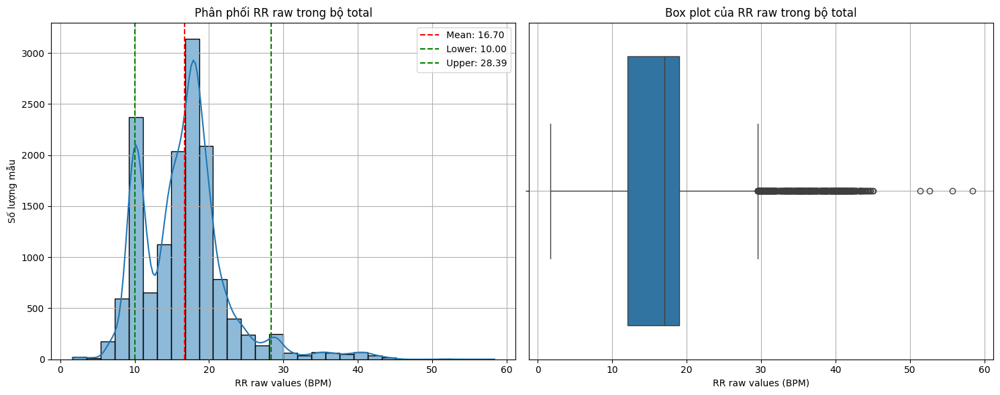


X_total_filtered shape after outlier removal: (12288, 750)
rr_raw_total_filtered shape: (12288,)

Thống kê RR raw total sau khi chuẩn hóa:
Min: 0.0000, Max: 0.9999
Mean: 0.3674, Std: 0.2109


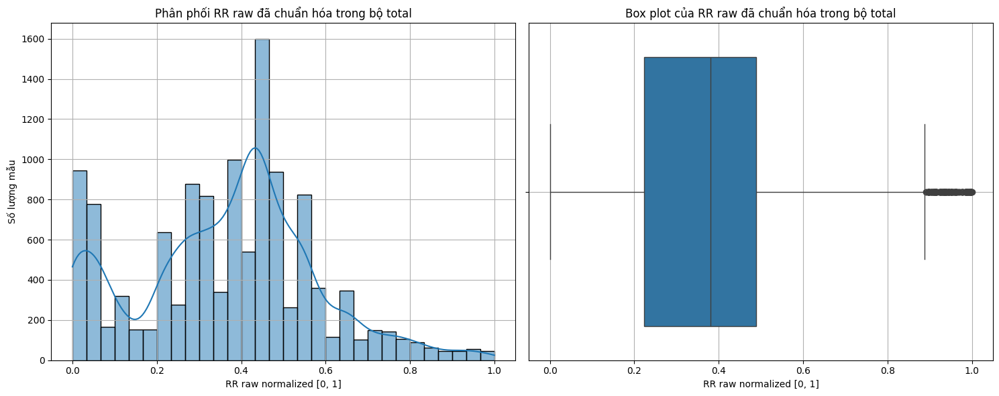


Số mẫu train ban đầu: 11566
Số mẫu train sau khi lọc: 9830
Tỷ lệ giữ lại (train): 84.99%
Số mẫu test ban đầu: 2893
Số mẫu test sau khi lọc: 2458
Tỷ lệ giữ lại (test): 84.96%

Thống kê RR raw sau khi chia tập:
Train - Min: 0.0000, Max: 0.9998
Train - Mean: 0.3682, Std: 0.2103
Test - Min: 0.0000, Max: 0.9999
Test - Mean: 0.3643, Std: 0.2132


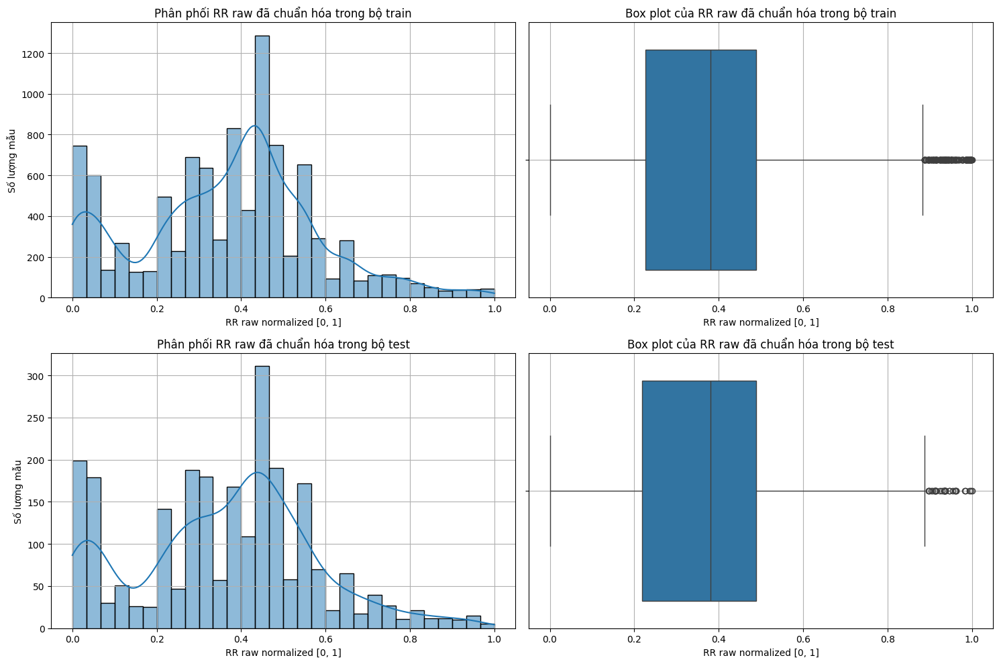

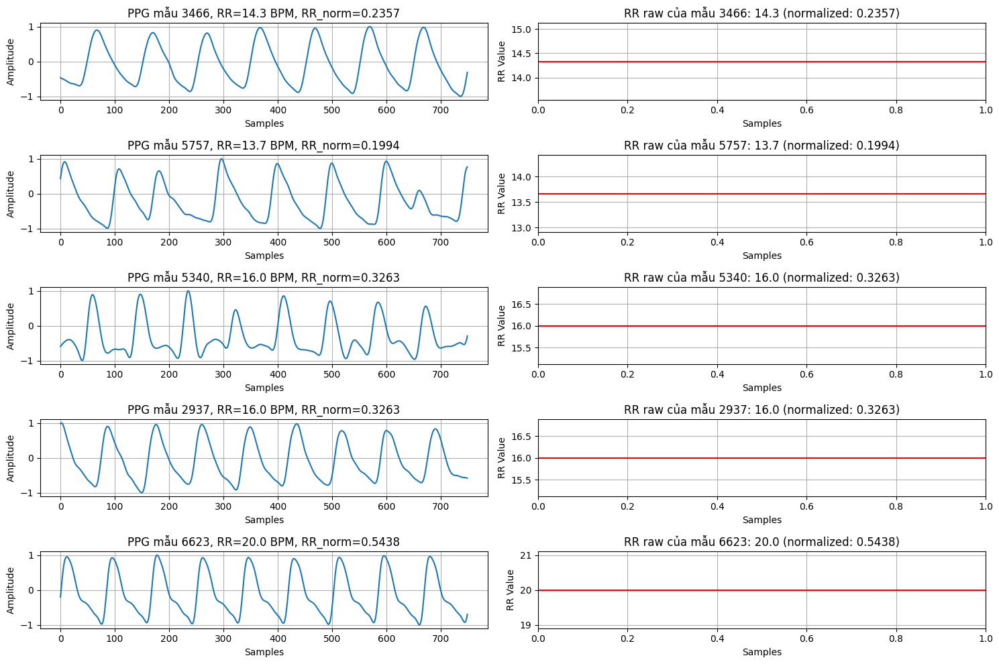

Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_rr.mat thành công!

X_train_filtered shape: (9830, 750)
rr_raw_train_normalized shape: (9830,)
X_test_filtered shape: (2458, 750)
rr_raw_test_normalized shape: (2458,)
Batch data shape: torch.Size([64, 750])
Batch condition shape: torch.Size([64, 1])
Xây dựng mô hình với input_size=750, condition_size=1

=== Cấu trúc Encoder ===
EncoderFixed(
  (input_layer): Linear(in_features=751, out_features=256, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=256, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=64, bias=True)
  )
  (z_mean): Linear(in_features=64, out_features=64, bias=True)
  (z_log_var): Linear(in_features=64, out_features=64, bias=True)
  (sampling): Sampling()
)

=== Cấu trúc Decoder ===
DecoderFixed(
  (input_layer): Linear(in_features=65, out_features=64, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=64, out_features=128, b

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch 0/600
Train Loss: 0.3382, Test Loss: 0.3327
Recon Loss: 0.3286, KL Loss: 0.0084
Epoch 10/600
Train Loss: 0.2001, Test Loss: 0.1966
Recon Loss: 0.1452, KL Loss: 0.1028
Epoch 20/600
Train Loss: 0.1573, Test Loss: 0.1575
Recon Loss: 0.0993, KL Loss: 0.1163
Epoch 30/600
Train Loss: 0.1428, Test Loss: 0.1455
Recon Loss: 0.0848, KL Loss: 0.1214
Epoch 40/600
Train Loss: 0.1384, Test Loss: 0.1419
Recon Loss: 0.0805, KL Loss: 0.1228
Epoch 50/600
Train Loss: 0.1354, Test Loss: 0.1385
Recon Loss: 0.0775, KL Loss: 0.1220
Epoch 60/600
Train Loss: 0.1336, Test Loss: 0.1372
Recon Loss: 0.0761, KL Loss: 0.1222
Epoch 70/600
Train Loss: 0.1313, Test Loss: 0.1367
Recon Loss: 0.0737, KL Loss: 0.1261
Epoch 80/600
Train Loss: 0.1313, Test Loss: 0.1367
Recon Loss: 0.0746, KL Loss: 0.1241
Epoch 90/600
Train Loss: 0.1301, Test Loss: 0.1355
Recon Loss: 0.0725, KL Loss: 0.1261
Epoch 100/600
Train Loss: 0.1293, Test Loss: 0.1345
Recon Loss: 0.0731, KL Loss: 0.1228
Epoch 110/600
Train Loss: 0.1287, Test Loss

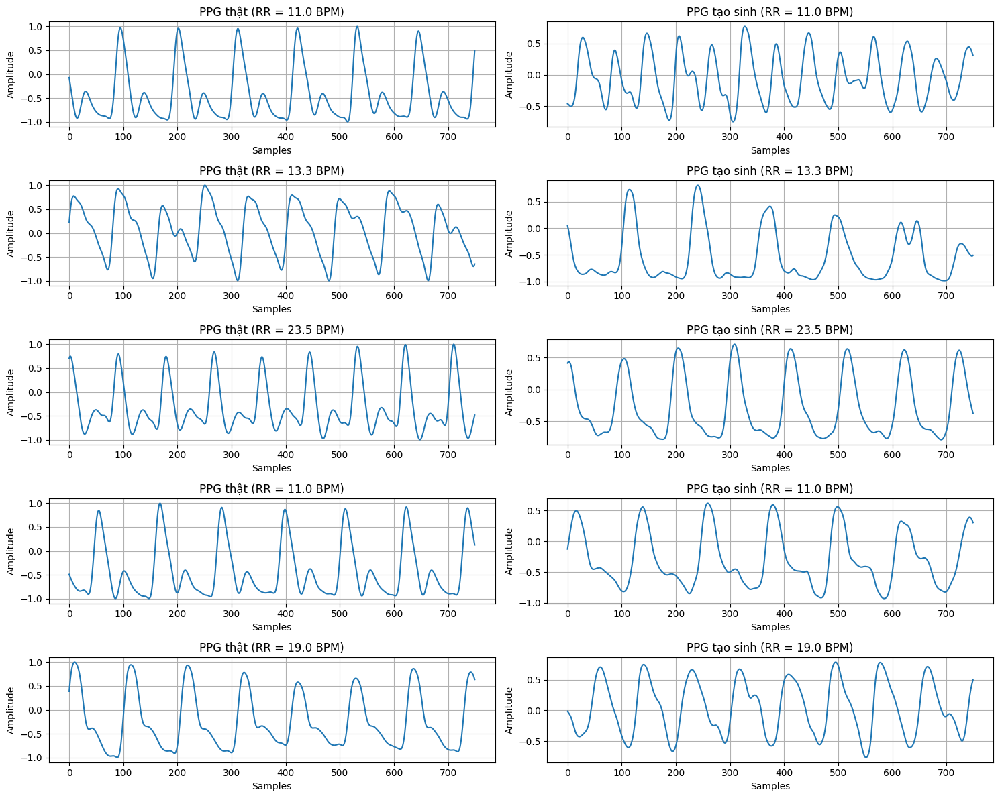

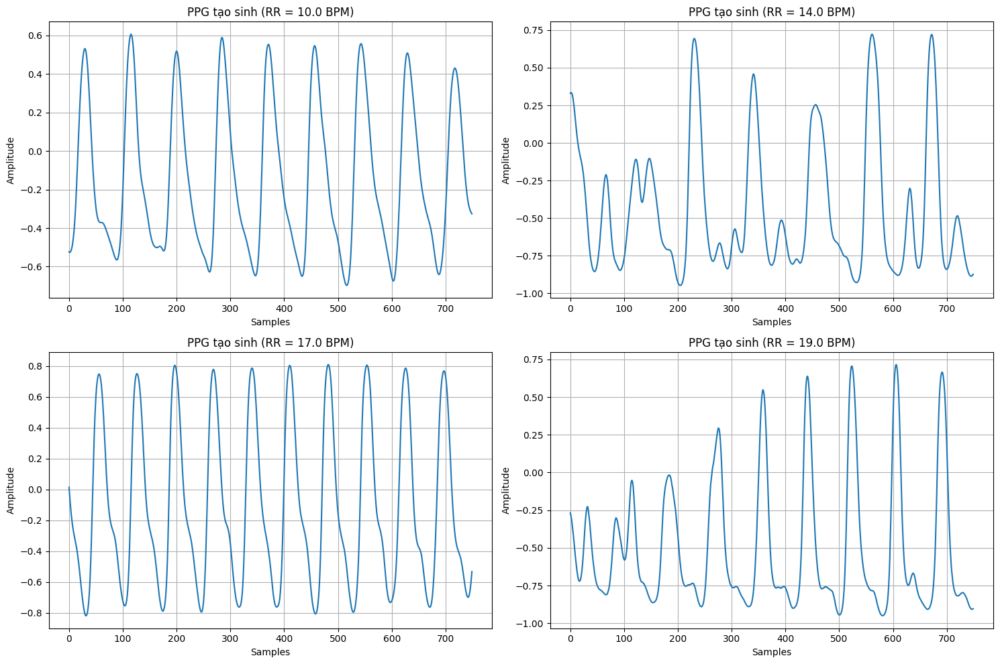

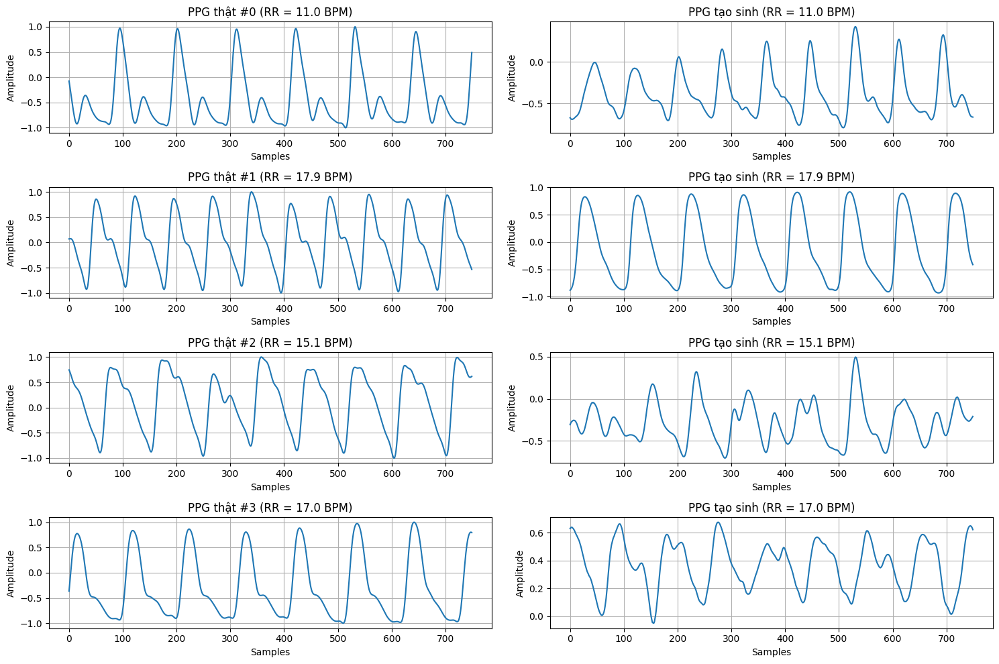

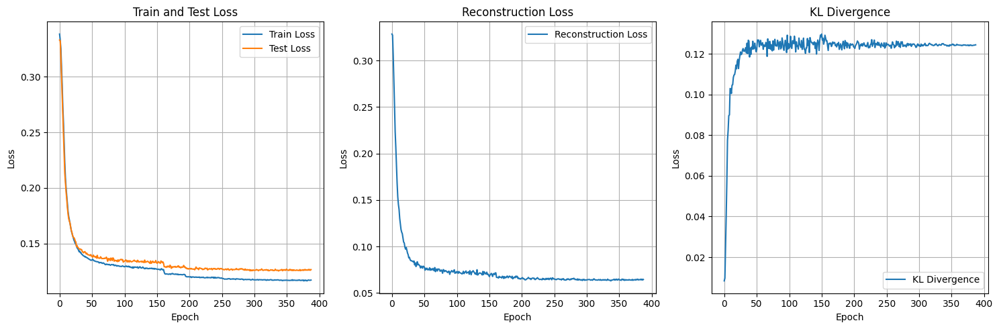

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import loadmat
from google.colab import drive
import os
from sklearn.model_selection import train_test_split

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Sử dụng device: {device}")

# Đường dẫn file dữ liệu
data_path = '/content/drive/MyDrive/Big/processed/combined_data_with_rr.mat'

# Kiểm tra sự tồn tại của file
if not os.path.exists(data_path):
    raise FileNotFoundError(f"File {data_path} không tồn tại.")

# Load dữ liệu từ file
print(f"Đang load dữ liệu từ file {data_path}...")
loaded_data = loadmat(data_path)

# Kiểm tra các trường cần thiết
required_keys = ['X_train_norm', 'X_test_norm', 'rr_raw_train', 'rr_raw_test', 'X_total_norm', 'rr_raw_total']
for key in required_keys:
    if key not in loaded_data:
        raise ValueError(f"Thiếu trường {key} trong file {data_path}")

# Trích xuất dữ liệu
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
rr_raw_train_loaded = loaded_data['rr_raw_train'].flatten()
rr_raw_test_loaded = loaded_data['rr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
rr_raw_total_loaded = loaded_data['rr_raw_total'].flatten()

# Kiểm tra kích thước dữ liệu đã load
print("\nShape của dữ liệu đã load:")
print(f"X_train_loaded shape: {X_train_loaded.shape}")
print(f"rr_raw_train_loaded shape: {rr_raw_train_loaded.shape}")
print(f"X_test_loaded shape: {X_test_loaded.shape}")
print(f"rr_raw_test_loaded shape: {rr_raw_test_loaded.shape}")
print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"rr_raw_total_loaded shape: {rr_raw_total_loaded.shape}")

# Tính toán thống kê cho rr_raw_total_loaded
rr_raw_total_min = np.min(rr_raw_total_loaded)
rr_raw_total_max = np.max(rr_raw_total_loaded)
rr_raw_total_mean = np.mean(rr_raw_total_loaded)
rr_raw_total_std = np.std(rr_raw_total_loaded)
rr_raw_lower_bound = max(10, rr_raw_total_mean - 2 * rr_raw_total_std)  # RR tối thiểu 10 BPM
rr_raw_upper_bound = min(40, rr_raw_total_mean + 2 * rr_raw_total_std)  # RR tối đa 40 BPM

# In thống kê
print("\nThống kê RR raw total:")
print(f"Min: {rr_raw_total_min:.2f}, Max: {rr_raw_total_max:.2f}")
print(f"Mean: {rr_raw_total_mean:.2f}, Std: {rr_raw_total_std:.2f}")
print(f"Bounds: [{rr_raw_lower_bound:.2f}, {rr_raw_upper_bound:.2f}]")

# Tạo thư mục lưu biểu đồ
os.makedirs('/content/drive/MyDrive/Big/figures/', exist_ok=True)

# Vẽ phân phối RR raw của bộ total
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(rr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối RR raw trong bộ total')
plt.xlabel('RR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(rr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {rr_raw_total_mean:.2f}')
plt.axvline(rr_raw_lower_bound, color='g', linestyle='--', label=f'Lower: {rr_raw_lower_bound:.2f}')
plt.axvline(rr_raw_upper_bound, color='g', linestyle='--', label=f'Upper: {rr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=rr_raw_total_loaded)
plt.title('Box plot của RR raw trong bộ total')
plt.xlabel('RR raw values (BPM)')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/rr_raw_total_distribution_combined.png')
plt.show()

# Lọc dữ liệu nằm trong khoảng [rr_raw_lower_bound, rr_raw_upper_bound]
valid_mask_total = (rr_raw_total_loaded >= rr_raw_lower_bound) & (rr_raw_total_loaded <= rr_raw_upper_bound)
X_total_filtered = X_total_loaded[valid_mask_total]
rr_raw_total_filtered = rr_raw_total_loaded[valid_mask_total]

print(f"\nX_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"rr_raw_total_filtered shape: {rr_raw_total_filtered.shape}")

# Chuẩn hóa RR raw về [0, 1]
def normalize_rr_raw(rr_raw_data, rr_min, rr_max):
    normalized = (rr_raw_data - rr_min) / (rr_max - rr_min)
    normalized = np.clip(normalized, 0, 1)
    return normalized

rr_raw_total_normalized = normalize_rr_raw(rr_raw_total_filtered, rr_raw_lower_bound, rr_raw_upper_bound)

# Kiểm tra kết quả chuẩn hóa
print("\nThống kê RR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(rr_raw_total_normalized):.4f}, Max: {np.max(rr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(rr_raw_total_normalized):.4f}, Std: {np.std(rr_raw_total_normalized):.4f}")

# Vẽ phân phối RR sau khi chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(rr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ total')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=rr_raw_total_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ total')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/rr_normalized_total_distribution_combined.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, rr_raw_train_normalized, rr_raw_test_normalized = train_test_split(
    X_total_filtered, rr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy RR thô tương ứng
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
rr_raw_train_filtered = rr_raw_total_filtered[train_indices]
rr_raw_test_filtered = rr_raw_total_filtered[test_indices]

# In thông tin số lượng mẫu
print(f"\nSố mẫu train ban đầu: {X_train_loaded.shape[0]}")
print(f"Số mẫu train sau khi lọc: {X_train_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (train): {X_train_filtered.shape[0]/X_train_loaded.shape[0]*100:.2f}%")
print(f"Số mẫu test ban đầu: {X_test_loaded.shape[0]}")
print(f"Số mẫu test sau khi lọc: {X_test_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (test): {X_test_filtered.shape[0]/X_test_loaded.shape[0]*100:.2f}%")

# Kiểm tra thống kê RR sau khi chia tập
print("\nThống kê RR raw sau khi chia tập:")
print(f"Train - Min: {np.min(rr_raw_train_normalized):.4f}, Max: {np.max(rr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(rr_raw_train_normalized):.4f}, Std: {np.std(rr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(rr_raw_test_normalized):.4f}, Max: {np.max(rr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(rr_raw_test_normalized):.4f}, Std: {np.std(rr_raw_test_normalized):.4f}")

# Vẽ phân phối RR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(rr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ train')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=rr_raw_train_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ train')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(rr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa trong bộ test')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=rr_raw_test_normalized)
plt.title('Box plot của RR raw đã chuẩn hóa trong bộ test')
plt.xlabel('RR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/rr_normalized_train_test_distribution_combined.png')
plt.show()

# Vẽ một vài mẫu PPG
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, RR={rr_raw_train_filtered[idx]:.1f} BPM, RR_norm={rr_raw_train_normalized[idx]:.4f}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(rr_raw_train_filtered[idx], color='r')
    plt.title(f'RR raw của mẫu {idx}: {rr_raw_train_filtered[idx]:.1f} (normalized: {rr_raw_train_normalized[idx]:.4f})')
    plt.xlabel('Samples')
    plt.ylabel('RR Value')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_samples_combined_rr.png')
plt.show()

# Chuyển đổi dữ liệu thành tensor
X_train_tensor = torch.FloatTensor(X_train_filtered)
rr_raw_train_tensor = torch.FloatTensor(rr_raw_train_normalized.reshape(-1, 1))
X_test_tensor = torch.FloatTensor(X_test_filtered)
rr_raw_test_tensor = torch.FloatTensor(rr_raw_test_normalized.reshape(-1, 1))

# Tạo dataset và dataloader
train_dataset = TensorDataset(X_train_tensor, rr_raw_train_tensor)
test_dataset = TensorDataset(X_test_tensor, rr_raw_test_tensor)
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Lưu dữ liệu đã xử lý vào file .mat
data_to_save = {
    'X_train_filtered': X_train_filtered,
    'rr_raw_train_normalized': rr_raw_train_normalized,
    'X_test_filtered': X_test_filtered,
    'rr_raw_test_normalized': rr_raw_test_normalized
}
sio.savemat('/content/drive/MyDrive/Big/processed/final_combined_data_rr.mat', data_to_save)
print("Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_rr.mat thành công!")

# Kiểm tra kích thước dữ liệu
print(f"\nX_train_filtered shape: {X_train_filtered.shape}")
print(f"rr_raw_train_normalized shape: {rr_raw_train_normalized.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")
print(f"rr_raw_test_normalized shape: {rr_raw_test_normalized.shape}")

# Kiểm tra kích thước batch
sample_data, sample_condition = next(iter(train_loader))
print(f"Batch data shape: {sample_data.shape}")
print(f"Batch condition shape: {sample_condition.shape}")

# Thiết lập tham số mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 1  # RR normalized
latent_dim = 64
hidden_dims = [256, 128, 64]
print(f"Xây dựng mô hình với input_size={input_size}, condition_size={condition_size}")

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def __init__(self):
        super(Sampling, self).__init__()

    def forward(self, args):
        z_mean, z_log_var = args
        batch_size = z_mean.size(0)
        latent_dim = z_mean.size(1)
        epsilon = torch.randn(batch_size, latent_dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class EncoderFixed(nn.Module):
    def __init__(self, input_dim, condition_dim, latent_dim, hidden_dims=[256, 128, 64]):
        super(EncoderFixed, self).__init__()
        self.input_layer = nn.Linear(input_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.z_mean = nn.Linear(hidden_dims[-1], latent_dim)
        self.z_log_var = nn.Linear(hidden_dims[-1], latent_dim)
        self.sampling = Sampling()

    def forward(self, x, condition):
        x_combined = torch.cat([x, condition], dim=1)
        x = F.relu(self.input_layer(x_combined))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        z = self.sampling((z_mean, z_log_var))
        return z_mean, z_log_var, z

# Định nghĩa Decoder
class DecoderFixed(nn.Module):
    def __init__(self, latent_dim, condition_dim, output_dim, hidden_dims=[64, 128, 256]):
        super(DecoderFixed, self).__init__()
        self.input_layer = nn.Linear(latent_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.output_layer = nn.Linear(hidden_dims[-1], output_dim)

    def forward(self, z, condition):
        z_combined = torch.cat([z, condition], dim=1)
        x = F.relu(self.input_layer(z_combined))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        x = torch.tanh(self.output_layer(x))
        return x

# Định nghĩa CVAE
class CVAEFixed(nn.Module):
    def __init__(self, encoder, decoder):
        super(CVAEFixed, self).__init__()
        self.encoder = encoder
        self.decoder = decoder

    def forward(self, x, condition):
        z_mean, z_log_var, z = self.encoder(x, condition)
        reconstruction = self.decoder(z, condition)
        return reconstruction, z_mean, z_log_var

    def generate(self, condition, z=None):
        if z is None:
            batch_size = condition.size(0)
            latent_dim = self.encoder.z_mean.out_features
            z = torch.randn(batch_size, latent_dim).to(condition.device)
        return self.decoder(z, condition)

# Khởi tạo mô hình
encoder = EncoderFixed(input_size, condition_size, latent_dim, hidden_dims)
decoder = DecoderFixed(latent_dim, condition_size, input_size, hidden_dims[::-1])
cvae = CVAEFixed(encoder, decoder)
cvae.to(device)

# Hiển thị cấu trúc mô hình
print("\n=== Cấu trúc Encoder ===")
print(encoder)
print("\n=== Cấu trúc Decoder ===")
print(decoder)
print("\n=== Cấu trúc CVAE ===")
print(cvae)

# Tính tổng số tham số
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"\nTổng số tham số của Encoder: {count_parameters(encoder):,}")
print(f"Tổng số tham số của Decoder: {count_parameters(decoder):,}")
print(f"Tổng số tham số của CVAE: {count_parameters(cvae):,}")

# Trực quan hóa flow của dữ liệu qua mô hình
def visualize_model_flow(sample_data, sample_condition):
    sample_x = sample_data[0:1].to(device)
    sample_cond = sample_condition[0:1].to(device)
    print(f"\nInput shape: {sample_x.shape}, Condition shape: {sample_cond.shape}")
    x_combined = torch.cat([sample_x, sample_cond], dim=1)
    print(f"Combined input shape (x + condition): {x_combined.shape}")
    z_mean, z_log_var, z = encoder(sample_x, sample_cond)
    print(f"z_mean shape: {z_mean.shape}")
    print(f"z_log_var shape: {z_log_var.shape}")
    print(f"Sampled z shape: {z.shape}")
    z_combined = torch.cat([z, sample_cond], dim=1)
    print(f"Combined latent shape (z + condition): {z_combined.shape}")
    reconstruction = decoder(z, sample_cond)
    print(f"Reconstruction shape: {reconstruction.shape}")

visualize_model_flow(sample_data, sample_condition)

# Định nghĩa hàm loss
def loss_function_fixed(x, x_recon, z_mean, z_log_var, kl_weight=0.5):
    recon_loss = F.mse_loss(x_recon, x, reduction='mean')
    kl_loss = -0.5 * torch.mean(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    loss = recon_loss + kl_weight * kl_loss
    return loss, recon_loss, kl_loss

# Thiết lập tham số huấn luyện
learning_rate = 1e-3
epochs = 600
kl_weight = 0.5
patience = 50

# Khởi tạo optimizer và scheduler
optimizer = torch.optim.Adam(cvae.parameters(), lr=learning_rate)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=20, verbose=True)

# Tạo thư mục lưu checkpoint
os.makedirs('/content/drive/MyDrive/Big/checkpoints/', exist_ok=True)

# Khởi tạo lịch sử huấn luyện
train_losses = []
test_losses = []
recon_losses = []
kl_losses = []
best_loss = float('inf')
patience_counter = 0

# Vòng lặp huấn luyện
for epoch in range(epochs):
    cvae.train()
    total_train_loss = 0
    total_train_recon_loss = 0
    total_train_kl_loss = 0

    for batch_idx, (data, condition) in enumerate(train_loader):
        data = data.to(device)
        condition = condition.to(device)
        optimizer.zero_grad()
        reconstruction, z_mean, z_log_var = cvae(data, condition)
        loss, recon_loss, kl_loss = loss_function_fixed(data, reconstruction, z_mean, z_log_var, kl_weight)
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item() * data.size(0)
        total_train_recon_loss += recon_loss.item() * data.size(0)
        total_train_kl_loss += kl_loss.item() * data.size(0)

    cvae.eval()
    total_test_loss = 0
    total_test_recon_loss = 0
    total_test_kl_loss = 0

    with torch.no_grad():
        for data, condition in test_loader:
            data = data.to(device)
            condition = condition.to(device)
            reconstruction, z_mean, z_log_var = cvae(data, condition)
            loss, recon_loss, kl_loss = loss_function_fixed(data, reconstruction, z_mean, z_log_var, kl_weight)
            total_test_loss += loss.item() * data.size(0)
            total_test_recon_loss += recon_loss.item() * data.size(0)
            total_test_kl_loss += kl_loss.item() * data.size(0)

    train_loss = total_train_loss / len(train_loader.dataset)
    test_loss = total_test_loss / len(test_loader.dataset)
    train_recon_loss = total_train_recon_loss / len(train_loader.dataset)
    test_recon_loss = total_test_recon_loss / len(test_loader.dataset)
    train_kl_loss = total_train_kl_loss / len(train_loader.dataset)
    test_kl_loss = total_test_kl_loss / len(test_loader.dataset)

    scheduler.step(test_loss)
    train_losses.append(train_loss)
    test_losses.append(test_loss)
    recon_losses.append(test_recon_loss)
    kl_losses.append(test_kl_loss)

    if epoch % 10 == 0:
        print(f"Epoch {epoch}/{epochs}")
        print(f"Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}")
        print(f"Recon Loss: {test_recon_loss:.4f}, KL Loss: {test_kl_loss:.4f}")

    if epoch % 50 == 0:
        checkpoint_path = f'/content/drive/MyDrive/Big/checkpoints/cvae_checkpoint_epoch_{epoch}_rr.pth'
        torch.save({
            'epoch': epoch,
            'model_state_dict': cvae.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'train_loss': train_loss,
            'test_loss': test_loss,
            'train_losses': train_losses,
            'test_losses': test_losses,
            'recon_losses': recon_losses,
            'kl_losses': kl_losses
        }, checkpoint_path)

    if test_loss < best_loss:
        best_loss = test_loss
        best_model_path = '/content/drive/MyDrive/Big/models/best_cvae_combined_rr.pth'
        os.makedirs(os.path.dirname(best_model_path), exist_ok=True)
        torch.save({
            'epoch': epoch,
            'model_state_dict': cvae.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'train_loss': train_loss,
            'test_loss': test_loss
        }, best_model_path)
        patience_counter = 0
    else:
        patience_counter += 1

    if patience_counter >= patience:
        print(f"Early stopping tại epoch {epoch} vì không có cải thiện sau {patience} epochs")
        break

# Lưu lịch sử huấn luyện
history = {
    'train_losses': train_losses,
    'test_losses': test_losses,
    'recon_losses': recon_losses,
    'kl_losses': kl_losses
}
torch.save(history, '/content/drive/MyDrive/Big/models/training_history_combined_rr.pth')

print("Huấn luyện hoàn tất!")

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(cvae, rr_value, device):
    cvae.eval()
    with torch.no_grad():
        rr_condition = rr_value.unsqueeze(0).to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = cvae.decoder(z, rr_condition)
    return generated

# Hàm chuyển đổi RR chuẩn hóa về RR thực
def denormalize_rr(normalized_rr, min_rr=rr_raw_lower_bound, max_rr=rr_raw_upper_bound):
    return normalized_rr * (max_rr - min_rr) + min_rr

# So sánh PPG thật và tạo sinh
n_samples = 5
test_samples = []
test_conditions = []

for i, (data, condition) in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0])
    test_conditions.append(condition[0])

generated_samples = []
for rr_condition in test_conditions:
    generated = evaluate_generation(cvae, rr_condition, device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    actual_rr = denormalize_rr(test_conditions[i].item())
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (RR = {actual_rr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (RR = {actual_rr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_comparison_combined_rr.png')
plt.show()

# Tạo PPG với các giá trị RR đa dạng
test_rrs = []
for i, (_, condition) in enumerate(test_loader):
    if i >= 20:
        break
    for rr in condition:
        test_rrs.append(rr.item())

test_rrs = sorted(test_rrs)
selected_indices = [int(len(test_rrs) * i / 4) for i in range(4)]
selected_rrs = [test_rrs[i] for i in selected_indices]

generated_rr_samples = []
for rr in selected_rrs:
    rr_tensor = torch.tensor([rr], dtype=torch.float32)
    generated = evaluate_generation(cvae, rr_tensor, device)
    generated_rr_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 10))
for i, rr in enumerate(selected_rrs):
    actual_rr = denormalize_rr(rr)
    plt.subplot(2, 2, i+1)
    plt.plot(generated_rr_samples[i].numpy())
    plt.title(f'PPG tạo sinh (RR = {actual_rr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_generated_rr_combined.png')
plt.show()

# So sánh nhiều mẫu PPG thật và tạo sinh với RR khác nhau
plt.figure(figsize=(15, 10))
selected_samples = []
selected_conditions = []
selected_indices = []
unique_rrs = {}

for i, (data, condition) in enumerate(test_loader):
    if len(unique_rrs) >= 4:
        break
    for j, rr in enumerate(condition):
        rr_val = rr.item()
        rr_actual = denormalize_rr(rr_val)
        rr_rounded = round(rr_actual)
        if rr_rounded not in unique_rrs and len(unique_rrs) < 4:
            unique_rrs[rr_rounded] = (data[j], rr_val, i*len(condition)+j)
            selected_samples.append(data[j])
            selected_conditions.append(rr_val)
            selected_indices.append(i*len(condition)+j)

generated_selected = []
for rr in selected_conditions:
    rr_tensor = torch.tensor([rr], dtype=torch.float32)
    generated = evaluate_generation(cvae, rr_tensor, device)
    generated_selected.append(generated.cpu().squeeze(0))

for i in range(len(selected_samples)):
    actual_rr = denormalize_rr(selected_conditions[i])
    plt.subplot(4, 2, 2*i+1)
    plt.plot(selected_samples[i].cpu().numpy())
    plt.title(f'PPG thật #{selected_indices[i]} (RR = {actual_rr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(4, 2, 2*i+2)
    plt.plot(generated_selected[i].numpy())
    plt.title(f'PPG tạo sinh (RR = {actual_rr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_comparison_unique_rrs_combined.png')
plt.show()

# Vẽ lịch sử huấn luyện
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(test_losses, label='Test Loss')
plt.title('Train and Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 2)
plt.plot(recon_losses, label='Reconstruction Loss')
plt.title('Reconstruction Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 3)
plt.plot(kl_losses, label='KL Divergence')
plt.title('KL Divergence')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/training_history_combined_rr.png')
plt.show()

# CVAE với HR+RR trên bộ combined

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Sử dụng device: cuda
Đang load dữ liệu từ file /content/drive/MyDrive/Big/processed/combined_data_with_rr.mat...

Shape của dữ liệu đã load:
X_train_loaded shape: (11566, 750)
hr_raw_train_loaded shape: (11566,)
rr_raw_train_loaded shape: (11566,)
X_test_loaded shape: (2893, 750)
hr_raw_test_loaded shape: (2893,)
rr_raw_test_loaded shape: (2893,)
X_total_loaded shape: (14459, 750)
hr_raw_total_loaded shape: (14459,)
rr_raw_total_loaded shape: (14459,)

Thống kê HR raw total:
Min: 50.23, Max: 143.53
Mean: 87.01, Std: 17.43
Bounds: [52.15, 121.87]

Thống kê RR raw total:
Min: 1.63, Max: 58.37
Mean: 16.70, Std: 5.84
Bounds: [10.00, 28.39]


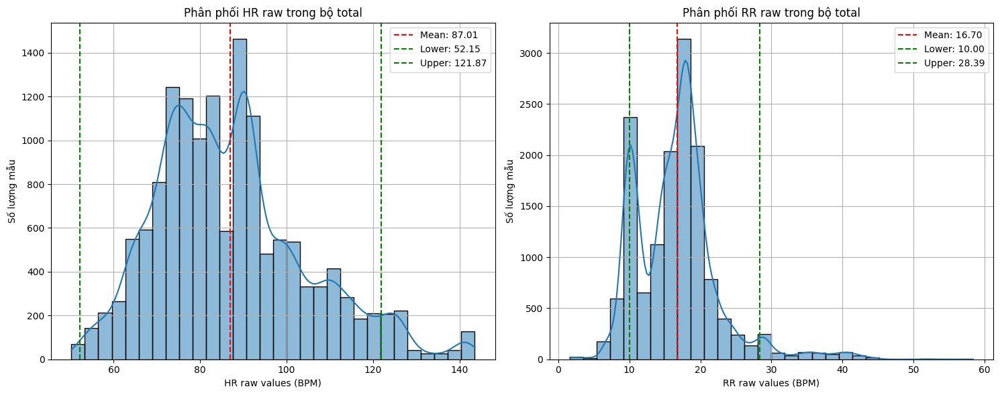


X_total_filtered shape after outlier removal: (11844, 750)
hr_raw_total_filtered shape: (11844,)
rr_raw_total_filtered shape: (11844,)

Thống kê HR raw total sau khi chuẩn hóa:
Min: 0.0040, Max: 0.9993
Mean: 0.4859, Std: 0.1983

Thống kê RR raw total sau khi chuẩn hóa:
Min: 0.0000, Max: 0.9999
Mean: 0.3684, Std: 0.2103


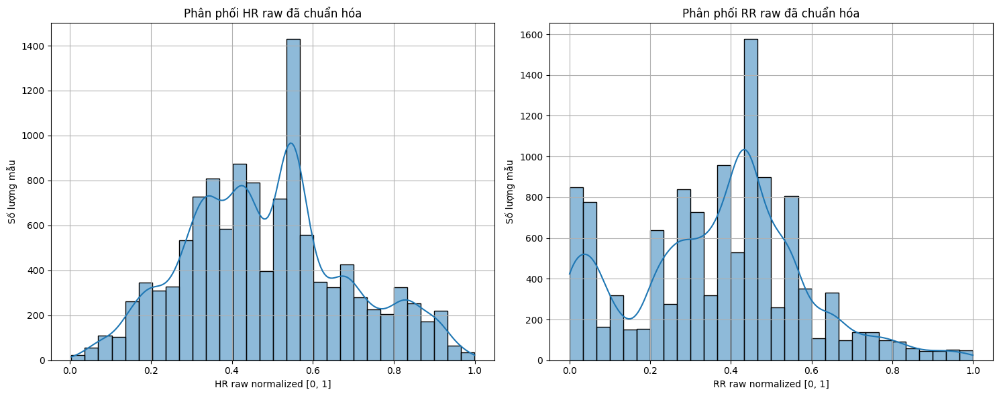


Số mẫu train ban đầu: 11566
Số mẫu train sau khi lọc: 9475
Tỷ lệ giữ lại (train): 81.92%
Số mẫu test ban đầu: 2893
Số mẫu test sau khi lọc: 2369
Tỷ lệ giữ lại (test): 81.89%

Thống kê HR raw sau khi chia tập:
Train - Min: 0.0088, Max: 0.9993
Train - Mean: 0.4853, Std: 0.1984
Test - Min: 0.0040, Max: 0.9971
Test - Mean: 0.4883, Std: 0.1980

Thống kê RR raw sau khi chia tập:
Train - Min: 0.0000, Max: 0.9999
Train - Mean: 0.3692, Std: 0.2106
Test - Min: 0.0000, Max: 0.9986
Test - Mean: 0.3651, Std: 0.2091


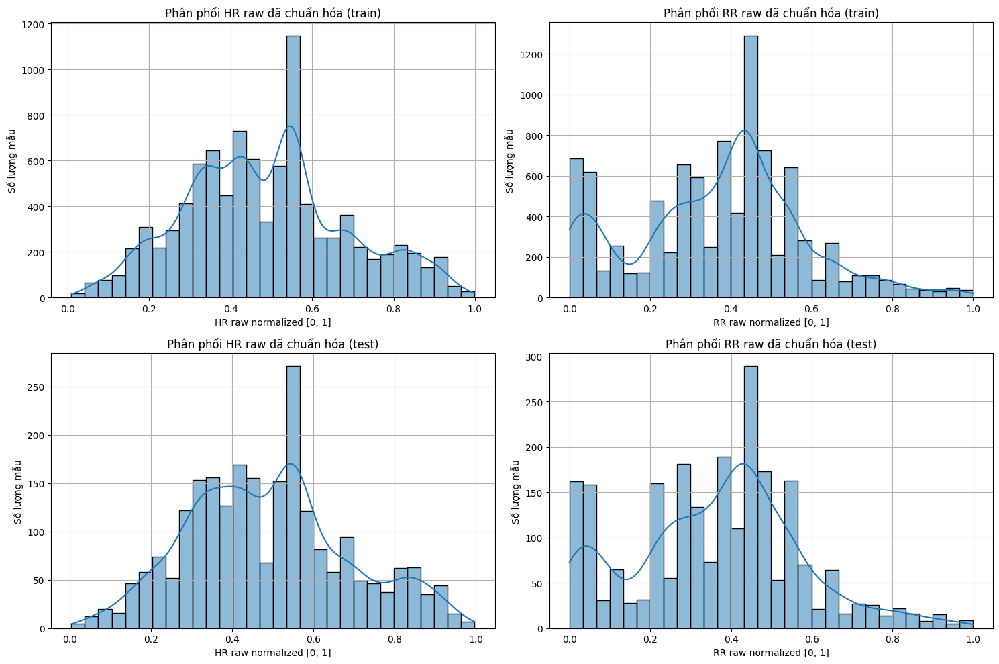

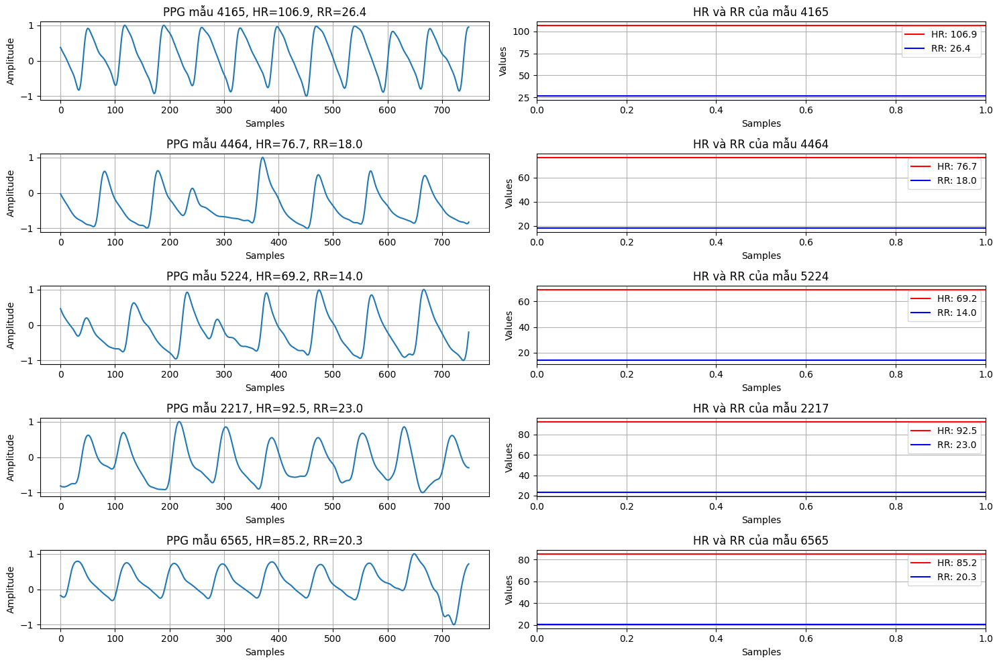

Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_hr_rr.mat thành công!

X_train_filtered shape: (9475, 750)
condition_train_tensor shape: torch.Size([9475, 2])
X_test_filtered shape: (2369, 750)
condition_test_tensor shape: torch.Size([2369, 2])
Batch data shape: torch.Size([64, 750])
Batch condition shape: torch.Size([64, 2])
Xây dựng mô hình với input_size=750, condition_size=2

=== Cấu trúc Encoder ===
EncoderFixed(
  (input_layer): Linear(in_features=752, out_features=256, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=256, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=64, bias=True)
  )
  (z_mean): Linear(in_features=64, out_features=64, bias=True)
  (z_log_var): Linear(in_features=64, out_features=64, bias=True)
  (sampling): Sampling()
)

=== Cấu trúc Decoder ===
DecoderFixed(
  (input_layer): Linear(in_features=66, out_features=64, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_fea

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch 0/600
Train Loss: 0.3388, Test Loss: 0.3344
Recon Loss: 0.3300, KL Loss: 0.0088
Epoch 10/600
Train Loss: 0.1958, Test Loss: 0.1906
Recon Loss: 0.1410, KL Loss: 0.0992
Epoch 20/600
Train Loss: 0.1467, Test Loss: 0.1499
Recon Loss: 0.0940, KL Loss: 0.1117
Epoch 30/600
Train Loss: 0.1347, Test Loss: 0.1384
Recon Loss: 0.0836, KL Loss: 0.1096
Epoch 40/600
Train Loss: 0.1291, Test Loss: 0.1330
Recon Loss: 0.0764, KL Loss: 0.1132
Epoch 50/600
Train Loss: 0.1257, Test Loss: 0.1301
Recon Loss: 0.0761, KL Loss: 0.1080
Epoch 60/600
Train Loss: 0.1237, Test Loss: 0.1272
Recon Loss: 0.0742, KL Loss: 0.1058
Epoch 70/600
Train Loss: 0.1221, Test Loss: 0.1280
Recon Loss: 0.0755, KL Loss: 0.1051
Epoch 80/600
Train Loss: 0.1199, Test Loss: 0.1244
Recon Loss: 0.0726, KL Loss: 0.1036
Epoch 90/600
Train Loss: 0.1199, Test Loss: 0.1253
Recon Loss: 0.0722, KL Loss: 0.1061
Epoch 100/600
Train Loss: 0.1182, Test Loss: 0.1224
Recon Loss: 0.0700, KL Loss: 0.1050
Epoch 110/600
Train Loss: 0.1180, Test Loss

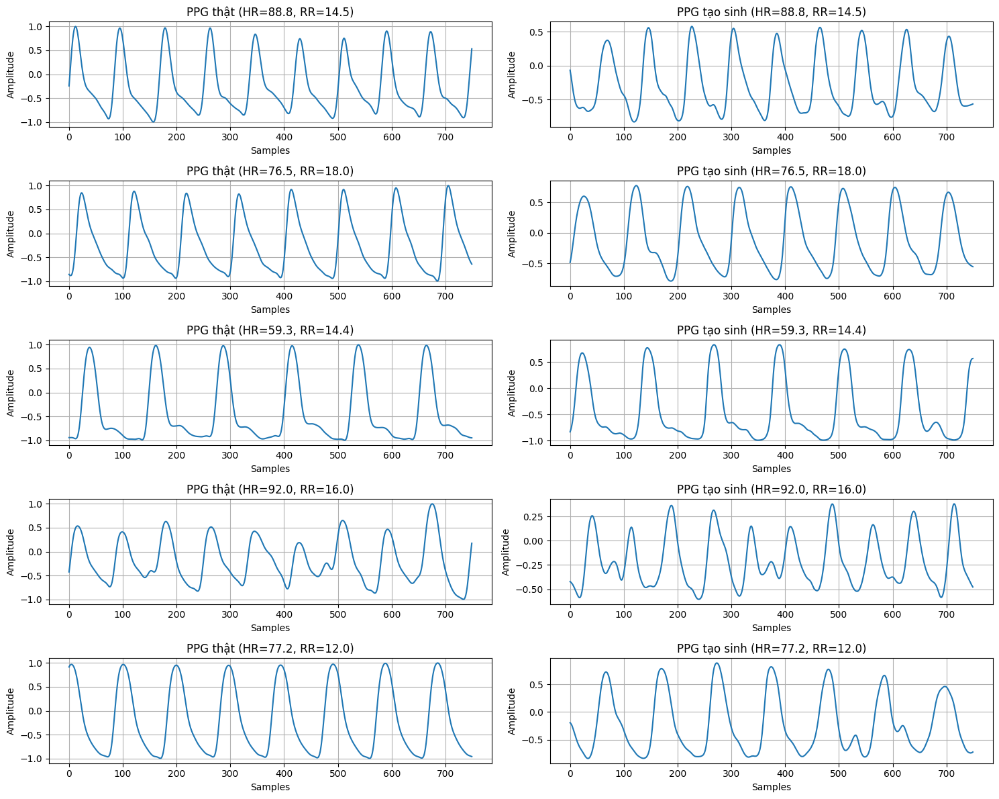

<ipython-input-34-5d6dd12e3d4a>:616: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:254.)
  cond_tensor = torch.tensor([cond], dtype=torch.float32)


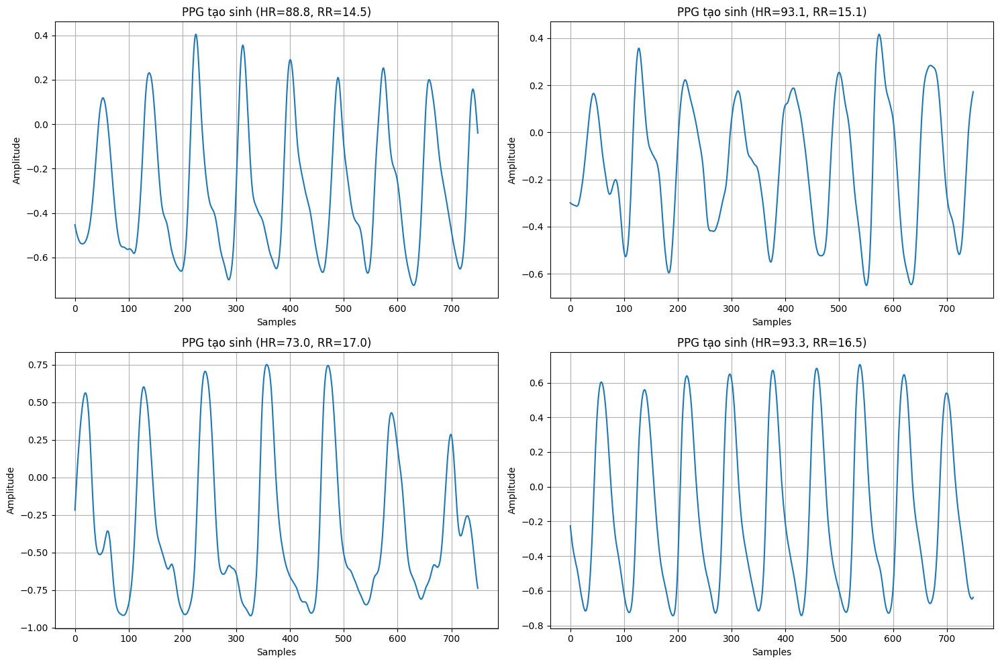

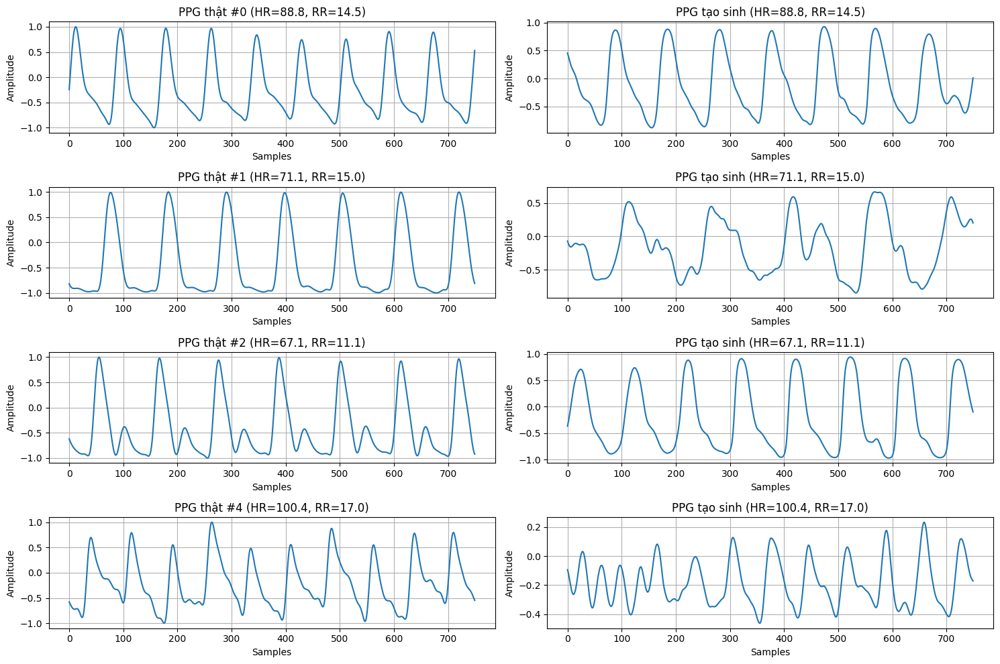

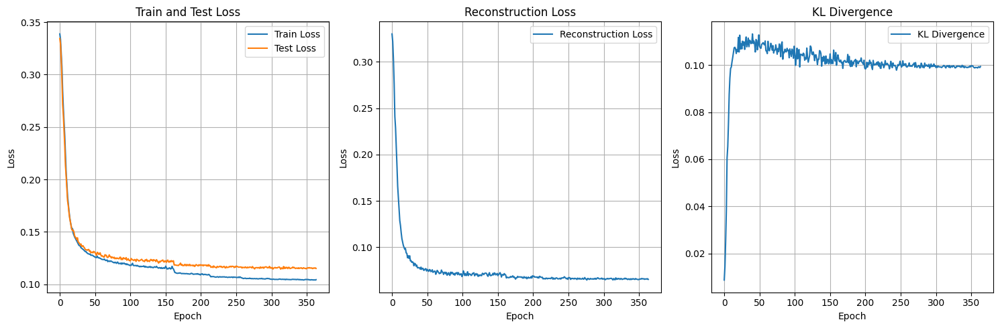

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import loadmat
from google.colab import drive
import os
from sklearn.model_selection import train_test_split
import scipy.io as sio

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Sử dụng device: {device}")

# Đường dẫn file dữ liệu
data_path = '/content/drive/MyDrive/Big/processed/combined_data_with_rr.mat'

# Kiểm tra sự tồn tại của file
if not os.path.exists(data_path):
    raise FileNotFoundError(f"File {data_path} không tồn tại.")

# Load dữ liệu từ file
print(f"Đang load dữ liệu từ file {data_path}...")
loaded_data = loadmat(data_path)

# Kiểm tra các trường cần thiết
required_keys = ['X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'rr_raw_train', 'rr_raw_test',
                 'X_total_norm', 'hr_raw_total', 'rr_raw_total']
for key in required_keys:
    if key not in loaded_data:
        raise ValueError(f"Thiếu trường {key} trong file {data_path}")

# Trích xuất dữ liệu
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
hr_raw_train_loaded = loaded_data['hr_raw_train'].flatten()
hr_raw_test_loaded = loaded_data['hr_raw_test'].flatten()
rr_raw_train_loaded = loaded_data['rr_raw_train'].flatten()
rr_raw_test_loaded = loaded_data['rr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
hr_raw_total_loaded = loaded_data['hr_raw_total'].flatten()
rr_raw_total_loaded = loaded_data['rr_raw_total'].flatten()

# Kiểm tra kích thước dữ liệu đã load
print("\nShape của dữ liệu đã load:")
print(f"X_train_loaded shape: {X_train_loaded.shape}")
print(f"hr_raw_train_loaded shape: {hr_raw_train_loaded.shape}")
print(f"rr_raw_train_loaded shape: {rr_raw_train_loaded.shape}")
print(f"X_test_loaded shape: {X_test_loaded.shape}")
print(f"hr_raw_test_loaded shape: {hr_raw_test_loaded.shape}")
print(f"rr_raw_test_loaded shape: {rr_raw_test_loaded.shape}")
print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"hr_raw_total_loaded shape: {hr_raw_total_loaded.shape}")
print(f"rr_raw_total_loaded shape: {rr_raw_total_loaded.shape}")

# Tính toán thống kê cho HR
hr_raw_total_min = np.min(hr_raw_total_loaded)
hr_raw_total_max = np.max(hr_raw_total_loaded)
hr_raw_total_mean = np.mean(hr_raw_total_loaded)
hr_raw_total_std = np.std(hr_raw_total_loaded)
hr_raw_lower_bound = max(30, hr_raw_total_mean - 2 * hr_raw_total_std)
hr_raw_upper_bound = min(200, hr_raw_total_mean + 2 * hr_raw_total_std)

# Tính toán thống kê cho RR
rr_raw_total_min = np.min(rr_raw_total_loaded)
rr_raw_total_max = np.max(rr_raw_total_loaded)
rr_raw_total_mean = np.mean(rr_raw_total_loaded)
rr_raw_total_std = np.std(rr_raw_total_loaded)
rr_raw_lower_bound = max(10, rr_raw_total_mean - 2 * rr_raw_total_std)
rr_raw_upper_bound = min(40, rr_raw_total_mean + 2 * rr_raw_total_std)

# In thống kê
print("\nThống kê HR raw total:")
print(f"Min: {hr_raw_total_min:.2f}, Max: {hr_raw_total_max:.2f}")
print(f"Mean: {hr_raw_total_mean:.2f}, Std: {hr_raw_total_std:.2f}")
print(f"Bounds: [{hr_raw_lower_bound:.2f}, {hr_raw_upper_bound:.2f}]")

print("\nThống kê RR raw total:")
print(f"Min: {rr_raw_total_min:.2f}, Max: {rr_raw_total_max:.2f}")
print(f"Mean: {rr_raw_total_mean:.2f}, Std: {rr_raw_total_std:.2f}")
print(f"Bounds: [{rr_raw_lower_bound:.2f}, {rr_raw_upper_bound:.2f}]")

# Tạo thư mục lưu biểu đồ
os.makedirs('/content/drive/MyDrive/Big/figures/', exist_ok=True)

# Vẽ phân phối HR và RR raw
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(hr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {hr_raw_total_mean:.2f}')
plt.axvline(hr_raw_lower_bound, color='g', linestyle='--', label=f'Lower: {hr_raw_lower_bound:.2f}')
plt.axvline(hr_raw_upper_bound, color='g', linestyle='--', label=f'Upper: {hr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.histplot(rr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối RR raw trong bộ total')
plt.xlabel('RR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(rr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {rr_raw_total_mean:.2f}')
plt.axvline(rr_raw_lower_bound, color='g', linestyle='--', label=f'Lower: {rr_raw_lower_bound:.2f}')
plt.axvline(rr_raw_upper_bound, color='g', linestyle='--', label=f'Upper: {rr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/hr_rr_raw_total_distribution_combined.png')
plt.show()

# Lọc dữ liệu hợp lệ cho cả HR và RR
valid_mask_total = (
    (hr_raw_total_loaded >= hr_raw_lower_bound) & (hr_raw_total_loaded <= hr_raw_upper_bound) &
    (rr_raw_total_loaded >= rr_raw_lower_bound) & (rr_raw_total_loaded <= rr_raw_upper_bound)
)
X_total_filtered = X_total_loaded[valid_mask_total]
hr_raw_total_filtered = hr_raw_total_loaded[valid_mask_total]
rr_raw_total_filtered = rr_raw_total_loaded[valid_mask_total]

print(f"\nX_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"hr_raw_total_filtered shape: {hr_raw_total_filtered.shape}")
print(f"rr_raw_total_filtered shape: {rr_raw_total_filtered.shape}")

# Chuẩn hóa HR và RR về [0, 1]
def normalize_hr_rr(data, min_val, max_val):
    normalized = (data - min_val) / (max_val - min_val)
    normalized = np.clip(normalized, 0, 1)
    return normalized

hr_raw_total_normalized = normalize_hr_rr(hr_raw_total_filtered, hr_raw_lower_bound, hr_raw_upper_bound)
rr_raw_total_normalized = normalize_hr_rr(rr_raw_total_filtered, rr_raw_lower_bound, rr_raw_upper_bound)

# Kiểm tra kết quả chuẩn hóa
print("\nThống kê HR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(hr_raw_total_normalized):.4f}, Max: {np.max(hr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(hr_raw_total_normalized):.4f}, Std: {np.std(hr_raw_total_normalized):.4f}")

print("\nThống kê RR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(rr_raw_total_normalized):.4f}, Max: {np.max(rr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(rr_raw_total_normalized):.4f}, Std: {np.std(rr_raw_total_normalized):.4f}")

# Vẽ phân phối HR và RR sau khi chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.histplot(rr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/hr_rr_normalized_total_distribution_combined.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, hr_raw_train_normalized, hr_raw_test_normalized, rr_raw_train_normalized, rr_raw_test_normalized = train_test_split(
    X_total_filtered, hr_raw_total_normalized, rr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy HR và RR thô tương ứng
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(train_indices, test_size=0.2, random_state=42)
hr_raw_train_filtered = hr_raw_total_filtered[train_indices]
hr_raw_test_filtered = hr_raw_total_filtered[test_indices]
rr_raw_train_filtered = rr_raw_total_filtered[train_indices]
rr_raw_test_filtered = rr_raw_total_filtered[test_indices]

# In thông tin số lượng mẫu
print(f"\nSố mẫu train ban đầu: {X_train_loaded.shape[0]}")
print(f"Số mẫu train sau khi lọc: {X_train_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (train): {X_train_filtered.shape[0]/X_train_loaded.shape[0]*100:.2f}%")
print(f"Số mẫu test ban đầu: {X_test_loaded.shape[0]}")
print(f"Số mẫu test sau khi lọc: {X_test_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (test): {X_test_filtered.shape[0]/X_test_loaded.shape[0]*100:.2f}%")

# Kiểm tra thống kê HR và RR sau khi chia tập
print("\nThống kê HR raw sau khi chia tập:")
print(f"Train - Min: {np.min(hr_raw_train_normalized):.4f}, Max: {np.max(hr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(hr_raw_train_normalized):.4f}, Std: {np.std(hr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(hr_raw_test_normalized):.4f}, Max: {np.max(hr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(hr_raw_test_normalized):.4f}, Std: {np.std(hr_raw_test_normalized):.4f}")

print("\nThống kê RR raw sau khi chia tập:")
print(f"Train - Min: {np.min(rr_raw_train_normalized):.4f}, Max: {np.max(rr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(rr_raw_train_normalized):.4f}, Std: {np.std(rr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(rr_raw_test_normalized):.4f}, Max: {np.max(rr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(rr_raw_test_normalized):.4f}, Std: {np.std(rr_raw_test_normalized):.4f}")

# Vẽ phân phối HR và RR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa (train)')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.histplot(rr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa (train)')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(hr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa (test)')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.histplot(rr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối RR raw đã chuẩn hóa (test)')
plt.xlabel('RR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/hr_rr_normalized_train_test_distribution_combined.png')
plt.show()

# Vẽ một vài mẫu PPG
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, HR={hr_raw_train_filtered[idx]:.1f}, RR={rr_raw_train_filtered[idx]:.1f}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(hr_raw_train_filtered[idx], color='r', label=f'HR: {hr_raw_train_filtered[idx]:.1f}')
    plt.axhline(rr_raw_train_filtered[idx], color='b', label=f'RR: {rr_raw_train_filtered[idx]:.1f}')
    plt.title(f'HR và RR của mẫu {idx}')
    plt.xlabel('Samples')
    plt.ylabel('Values')
    plt.legend()
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_samples_combined_hr_rr.png')
plt.show()

# Chuyển đổi dữ liệu thành tensor
X_train_tensor = torch.FloatTensor(X_train_filtered)
condition_train_tensor = torch.FloatTensor(np.stack([hr_raw_train_normalized, rr_raw_train_normalized], axis=1))
X_test_tensor = torch.FloatTensor(X_test_filtered)
condition_test_tensor = torch.FloatTensor(np.stack([hr_raw_test_normalized, rr_raw_test_normalized], axis=1))

# Tạo dataset và dataloader
train_dataset = TensorDataset(X_train_tensor, condition_train_tensor)
test_dataset = TensorDataset(X_test_tensor, condition_test_tensor)
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Lưu dữ liệu đã xử lý vào file .mat
data_to_save = {
    'X_train_filtered': X_train_filtered,
    'hr_raw_train_normalized': hr_raw_train_normalized,
    'rr_raw_train_normalized': rr_raw_train_normalized,
    'X_test_filtered': X_test_filtered,
    'hr_raw_test_normalized': hr_raw_test_normalized,
    'rr_raw_test_normalized': rr_raw_test_normalized
}
sio.savemat('/content/drive/MyDrive/Big/processed/final_combined_data_hr_rr.mat', data_to_save)
print("Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_hr_rr.mat thành công!")

# Kiểm tra kích thước dữ liệu
print(f"\nX_train_filtered shape: {X_train_filtered.shape}")
print(f"condition_train_tensor shape: {condition_train_tensor.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")
print(f"condition_test_tensor shape: {condition_test_tensor.shape}")

# Kiểm tra kích thước batch
sample_data, sample_condition = next(iter(train_loader))
print(f"Batch data shape: {sample_data.shape}")
print(f"Batch condition shape: {sample_condition.shape}")

# Thiết lập tham số mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 2  # HR và RR normalized
latent_dim = 64
hidden_dims = [256, 128, 64]
print(f"Xây dựng mô hình với input_size={input_size}, condition_size={condition_size}")

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def __init__(self):
        super(Sampling, self).__init__()

    def forward(self, args):
        z_mean, z_log_var = args
        batch_size = z_mean.size(0)
        latent_dim = z_mean.size(1)
        epsilon = torch.randn(batch_size, latent_dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class EncoderFixed(nn.Module):
    def __init__(self, input_dim, condition_dim, latent_dim, hidden_dims=[256, 128, 64]):
        super(EncoderFixed, self).__init__()
        self.input_layer = nn.Linear(input_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.z_mean = nn.Linear(hidden_dims[-1], latent_dim)
        self.z_log_var = nn.Linear(hidden_dims[-1], latent_dim)
        self.sampling = Sampling()

    def forward(self, x, condition):
        x_combined = torch.cat([x, condition], dim=1)
        x = F.relu(self.input_layer(x_combined))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        z = self.sampling((z_mean, z_log_var))
        return z_mean, z_log_var, z

# Định nghĩa Decoder
class DecoderFixed(nn.Module):
    def __init__(self, latent_dim, condition_dim, output_dim, hidden_dims=[64, 128, 256]):
        super(DecoderFixed, self).__init__()
        self.input_layer = nn.Linear(latent_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.output_layer = nn.Linear(hidden_dims[-1], output_dim)

    def forward(self, z, condition):
        z_combined = torch.cat([z, condition], dim=1)
        x = F.relu(self.input_layer(z_combined))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        x = torch.tanh(self.output_layer(x))
        return x

# Định nghĩa CVAE
class CVAEFixed(nn.Module):
    def __init__(self, encoder, decoder):
        super(CVAEFixed, self).__init__()
        self.encoder = encoder
        self.decoder = decoder

    def forward(self, x, condition):
        z_mean, z_log_var, z = self.encoder(x, condition)
        reconstruction = self.decoder(z, condition)
        return reconstruction, z_mean, z_log_var

    def generate(self, condition, z=None):
        if z is None:
            batch_size = condition.size(0)
            latent_dim = self.encoder.z_mean.out_features
            z = torch.randn(batch_size, latent_dim).to(condition.device)
        return self.decoder(z, condition)

# Khởi tạo mô hình
encoder = EncoderFixed(input_size, condition_size, latent_dim, hidden_dims)
decoder = DecoderFixed(latent_dim, condition_size, input_size, hidden_dims[::-1])
cvae = CVAEFixed(encoder, decoder)
cvae.to(device)

# Hiển thị cấu trúc mô hình
print("\n=== Cấu trúc Encoder ===")
print(encoder)
print("\n=== Cấu trúc Decoder ===")
print(decoder)
print("\n=== Cấu trúc CVAE ===")
print(cvae)

# Tính tổng số tham số
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"\nTổng số tham số của Encoder: {count_parameters(encoder):,}")
print(f"Tổng số tham số của Decoder: {count_parameters(decoder):,}")
print(f"Tổng số tham số của CVAE: {count_parameters(cvae):,}")

# Trực quan hóa flow của dữ liệu qua mô hình
def visualize_model_flow(sample_data, sample_condition):
    sample_x = sample_data[0:1].to(device)
    sample_cond = sample_condition[0:1].to(device)
    print(f"\nInput shape: {sample_x.shape}, Condition shape: {sample_cond.shape}")
    x_combined = torch.cat([sample_x, sample_cond], dim=1)
    print(f"Combined input shape (x + condition): {x_combined.shape}")
    z_mean, z_log_var, z = encoder(sample_x, sample_cond)
    print(f"z_mean shape: {z_mean.shape}")
    print(f"z_log_var shape: {z_log_var.shape}")
    print(f"Sampled z shape: {z.shape}")
    z_combined = torch.cat([z, sample_cond], dim=1)
    print(f"Combined latent shape (z + condition): {z_combined.shape}")
    reconstruction = decoder(z, sample_cond)
    print(f"Reconstruction shape: {reconstruction.shape}")

visualize_model_flow(sample_data, sample_condition)

# Định nghĩa hàm loss
def loss_function_fixed(x, x_recon, z_mean, z_log_var, kl_weight=0.5):
    recon_loss = F.mse_loss(x_recon, x, reduction='mean')
    kl_loss = -0.5 * torch.mean(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    loss = recon_loss + kl_weight * kl_loss
    return loss, recon_loss, kl_loss

# Thiết lập tham số huấn luyện
learning_rate = 1e-3
epochs = 600
kl_weight = 0.5
patience = 50

# Khởi tạo optimizer và scheduler
optimizer = torch.optim.Adam(cvae.parameters(), lr=learning_rate)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=20, verbose=True)

# Tạo thư mục lưu checkpoint
os.makedirs('/content/drive/MyDrive/Big/checkpoints/', exist_ok=True)

# Khởi tạo lịch sử huấn luyện
train_losses = []
test_losses = []
recon_losses = []
kl_losses = []
best_loss = float('inf')
patience_counter = 0

# Vòng lặp huấn luyện
for epoch in range(epochs):
    cvae.train()
    total_train_loss = 0
    total_train_recon_loss = 0
    total_train_kl_loss = 0

    for batch_idx, (data, condition) in enumerate(train_loader):
        data = data.to(device)
        condition = condition.to(device)
        optimizer.zero_grad()
        reconstruction, z_mean, z_log_var = cvae(data, condition)
        loss, recon_loss, kl_loss = loss_function_fixed(data, reconstruction, z_mean, z_log_var, kl_weight)
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item() * data.size(0)
        total_train_recon_loss += recon_loss.item() * data.size(0)
        total_train_kl_loss += kl_loss.item() * data.size(0)

    cvae.eval()
    total_test_loss = 0
    total_test_recon_loss = 0
    total_test_kl_loss = 0

    with torch.no_grad():
        for data, condition in test_loader:
            data = data.to(device)
            condition = condition.to(device)
            reconstruction, z_mean, z_log_var = cvae(data, condition)
            loss, recon_loss, kl_loss = loss_function_fixed(data, reconstruction, z_mean, z_log_var, kl_weight)
            total_test_loss += loss.item() * data.size(0)
            total_test_recon_loss += recon_loss.item() * data.size(0)
            total_test_kl_loss += kl_loss.item() * data.size(0)

    train_loss = total_train_loss / len(train_loader.dataset)
    test_loss = total_test_loss / len(test_loader.dataset)
    train_recon_loss = total_train_recon_loss / len(train_loader.dataset)
    test_recon_loss = total_test_recon_loss / len(test_loader.dataset)
    train_kl_loss = total_train_kl_loss / len(train_loader.dataset)
    test_kl_loss = total_test_kl_loss / len(test_loader.dataset)

    scheduler.step(test_loss)
    train_losses.append(train_loss)
    test_losses.append(test_loss)
    recon_losses.append(test_recon_loss)
    kl_losses.append(test_kl_loss)

    if epoch % 10 == 0:
        print(f"Epoch {epoch}/{epochs}")
        print(f"Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}")
        print(f"Recon Loss: {test_recon_loss:.4f}, KL Loss: {test_kl_loss:.4f}")

    if epoch % 50 == 0:
        checkpoint_path = f'/content/drive/MyDrive/Big/checkpoints/cvae_checkpoint_epoch_{epoch}_hr_rr.pth'
        torch.save({
            'epoch': epoch,
            'model_state_dict': cvae.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'train_loss': train_loss,
            'test_loss': test_loss,
            'train_losses': train_losses,
            'test_losses': test_losses,
            'recon_losses': recon_losses,
            'kl_losses': kl_losses
        }, checkpoint_path)

    if test_loss < best_loss:
        best_loss = test_loss
        best_model_path = '/content/drive/MyDrive/Big/models/best_cvae_combined_hr_rr.pth'
        os.makedirs(os.path.dirname(best_model_path), exist_ok=True)
        torch.save({
            'epoch': epoch,
            'model_state_dict': cvae.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'train_loss': train_loss,
            'test_loss': test_loss
        }, best_model_path)
        patience_counter = 0
    else:
        patience_counter += 1

    if patience_counter >= patience:
        print(f"Early stopping tại epoch {epoch} vì không có cải thiện sau {patience} epochs")
        break

# Lưu lịch sử huấn luyện
history = {
    'train_losses': train_losses,
    'test_losses': test_losses,
    'recon_losses': recon_losses,
    'kl_losses': kl_losses
}
torch.save(history, '/content/drive/MyDrive/Big/models/training_history_combined_hr_rr.pth')

print("Huấn luyện hoàn tất!")

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(cvae, condition, device):
    cvae.eval()
    with torch.no_grad():
        condition = condition.to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = cvae.decoder(z, condition)
    return generated

# Hàm chuyển đổi HR và RR chuẩn hóa về giá trị thực
def denormalize_hr(normalized_hr, min_hr=hr_raw_lower_bound, max_hr=hr_raw_upper_bound):
    return normalized_hr * (max_hr - min_hr) + min_hr

def denormalize_rr(normalized_rr, min_rr=rr_raw_lower_bound, max_rr=rr_raw_upper_bound):
    return normalized_rr * (max_rr - min_rr) + min_rr

# So sánh PPG thật và tạo sinh
n_samples = 5
test_samples = []
test_conditions = []

for i, (data, condition) in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0])
    test_conditions.append(condition[0])

generated_samples = []
for condition in test_conditions:
    generated = evaluate_generation(cvae, condition.unsqueeze(0), device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    actual_hr = denormalize_hr(test_conditions[i][0].item())
    actual_rr = denormalize_rr(test_conditions[i][1].item())
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (HR={actual_hr:.1f}, RR={actual_rr:.1f})')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR={actual_hr:.1f}, RR={actual_rr:.1f})')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_comparison_combined_hr_rr.png')
plt.show()

# Tạo PPG với các giá trị HR và RR đa dạng
test_conditions_list = []
for i, (_, condition) in enumerate(test_loader):
    if i >= 20:
        break
    for cond in condition:
        test_conditions_list.append(cond.numpy())

test_conditions_array = np.array(test_conditions_list)
test_hrs = test_conditions_array[:, 0]
test_rrs = test_conditions_array[:, 1]

# Chọn 4 cặp HR, RR đại diện
selected_indices = [int(len(test_hrs) * i / 4) for i in range(4)]
selected_conditions = test_conditions_array[selected_indices]

generated_samples = []
for cond in selected_conditions:
    cond_tensor = torch.tensor([cond], dtype=torch.float32)
    generated = evaluate_generation(cvae, cond_tensor, device)
    generated_samples.append(generated.cpu().squeeze(0))

plt.figure(figsize=(15, 10))
for i, cond in enumerate(selected_conditions):
    actual_hr = denormalize_hr(cond[0])
    actual_rr = denormalize_rr(cond[1])
    plt.subplot(2, 2, i+1)
    plt.plot(generated_samples[i].numpy())
    plt.title(f'PPG tạo sinh (HR={actual_hr:.1f}, RR={actual_rr:.1f})')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_generated_hr_rr_combined.png')
plt.show()

# So sánh nhiều mẫu PPG thật và tạo sinh với HR, RR khác nhau
plt.figure(figsize=(15, 10))
selected_samples = []
selected_conditions = []
selected_indices = []
unique_pairs = {}

for i, (data, condition) in enumerate(test_loader):
    if len(unique_pairs) >= 4:
        break
    for j, cond in enumerate(condition):
        hr_val = cond[0].item()
        rr_val = cond[1].item()
        hr_actual = denormalize_hr(hr_val)
        rr_actual = denormalize_rr(rr_val)
        pair = (round(hr_actual), round(rr_actual))
        if pair not in unique_pairs and len(unique_pairs) < 4:
            unique_pairs[pair] = (data[j], cond, i*len(condition)+j)
            selected_samples.append(data[j])
            selected_conditions.append(cond)
            selected_indices.append(i*len(condition)+j)

generated_selected = []
for cond in selected_conditions:
    generated = evaluate_generation(cvae, cond.unsqueeze(0), device)
    generated_selected.append(generated.cpu().squeeze(0))

for i in range(len(selected_samples)):
    actual_hr = denormalize_hr(selected_conditions[i][0].item())
    actual_rr = denormalize_rr(selected_conditions[i][1].item())
    plt.subplot(4, 2, 2*i+1)
    plt.plot(selected_samples[i].cpu().numpy())
    plt.title(f'PPG thật #{selected_indices[i]} (HR={actual_hr:.1f}, RR={actual_rr:.1f})')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(4, 2, 2*i+2)
    plt.plot(generated_selected[i].numpy())
    plt.title(f'PPG tạo sinh (HR={actual_hr:.1f}, RR={actual_rr:.1f})')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/ppg_comparison_unique_hr_rr_combined.png')
plt.show()

# Vẽ lịch sử huấn luyện
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(test_losses, label='Test Loss')
plt.title('Train and Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 2)
plt.plot(recon_losses, label='Reconstruction Loss')
plt.title('Reconstruction Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 3, 3)
plt.plot(kl_losses, label='KL Divergence')
plt.title('KL Divergence')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/training_history_combined_hr_rr.png')
plt.show()

# Ta thấy mô hình tốt nhất là CVAE với điều kiện HR.

# VAE với điều kiện HR trên bộ Combined

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Sử dụng device: cuda
Đang load dữ liệu từ file /content/drive/MyDrive/Big/processed/combined_data_with_rr.mat...

Shape của dữ liệu đã load:
X_train_loaded shape: (11566, 750)
hr_raw_train_loaded shape: (11566,)
X_test_loaded shape: (2893, 750)
hr_raw_test_loaded shape: (2893,)
X_total_loaded shape: (14459, 750)
hr_raw_total_loaded shape: (14459,)

Thống kê HR raw total:
Min: 50.23, Max: 143.53
Mean: 87.01, Std: 17.43
Bounds: [52.15, 121.87]


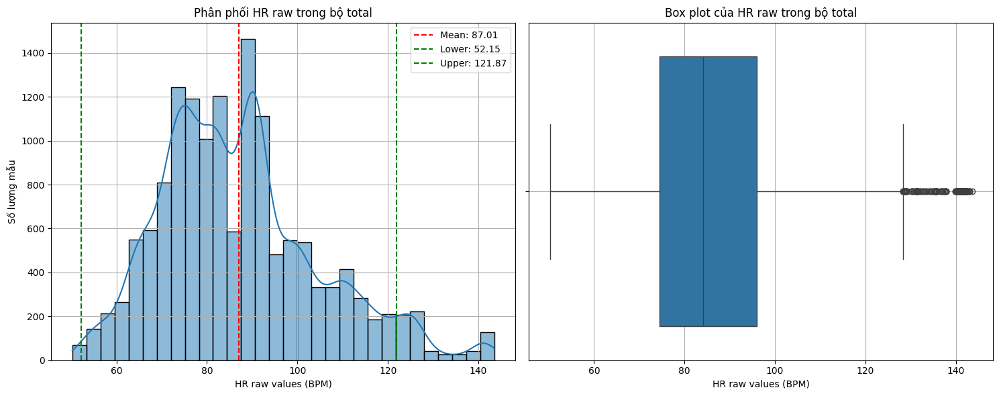


X_total_filtered shape after outlier removal: (13732, 750)
hr_raw_total_filtered shape: (13732,)

Thống kê HR raw total sau khi chuẩn hóa:
Min: 0.0011, Max: 0.9999
Mean: 0.4703, Std: 0.2115


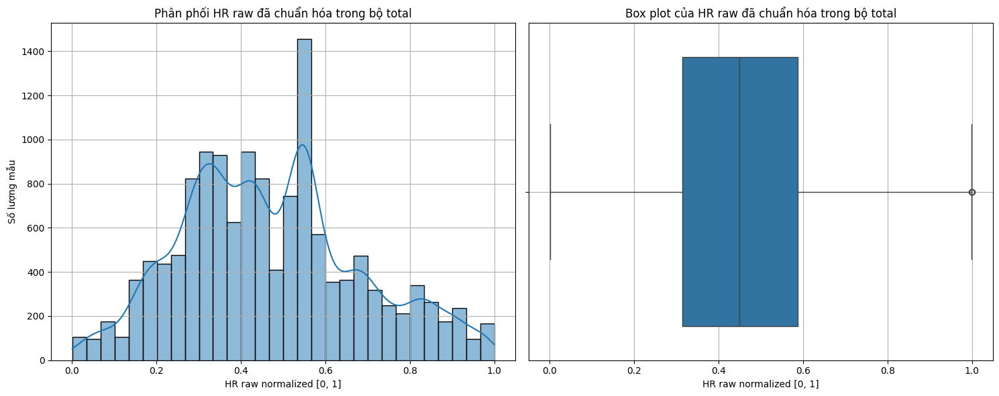


Số mẫu train ban đầu: 11566
Số mẫu train sau khi lọc: 10985
Tỷ lệ giữ lại (train): 94.98%
Số mẫu test ban đầu: 2893
Số mẫu test sau khi lọc: 2747
Tỷ lệ giữ lại (test): 94.95%

Thống kê HR raw sau khi chia tập:
Train - Min: 0.0011, Max: 0.9999
Train - Mean: 0.4694, Std: 0.2115
Test - Min: 0.0015, Max: 0.9971
Test - Mean: 0.4741, Std: 0.2110


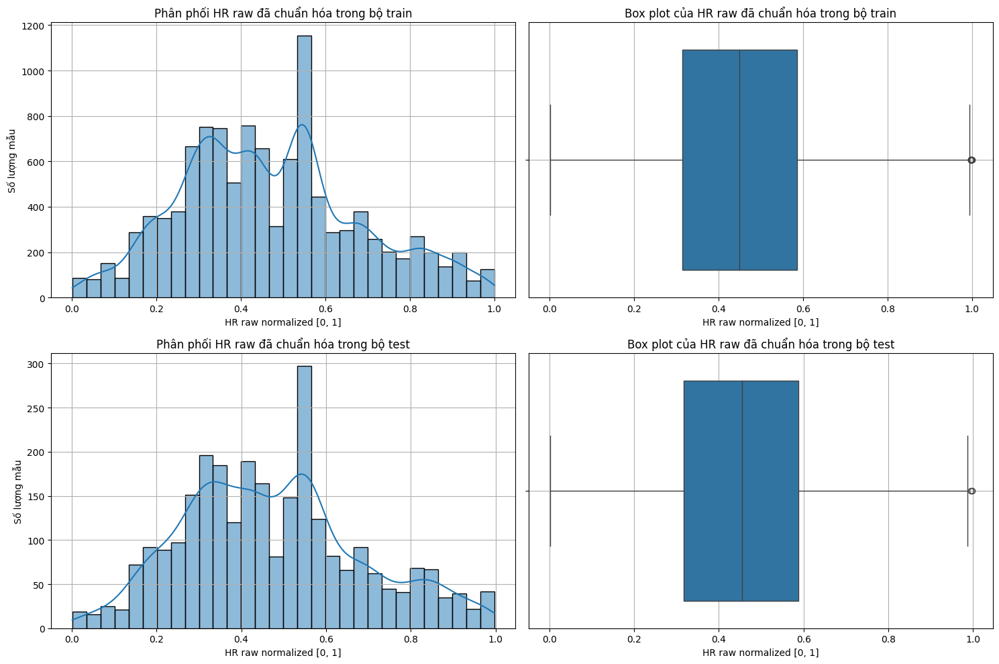

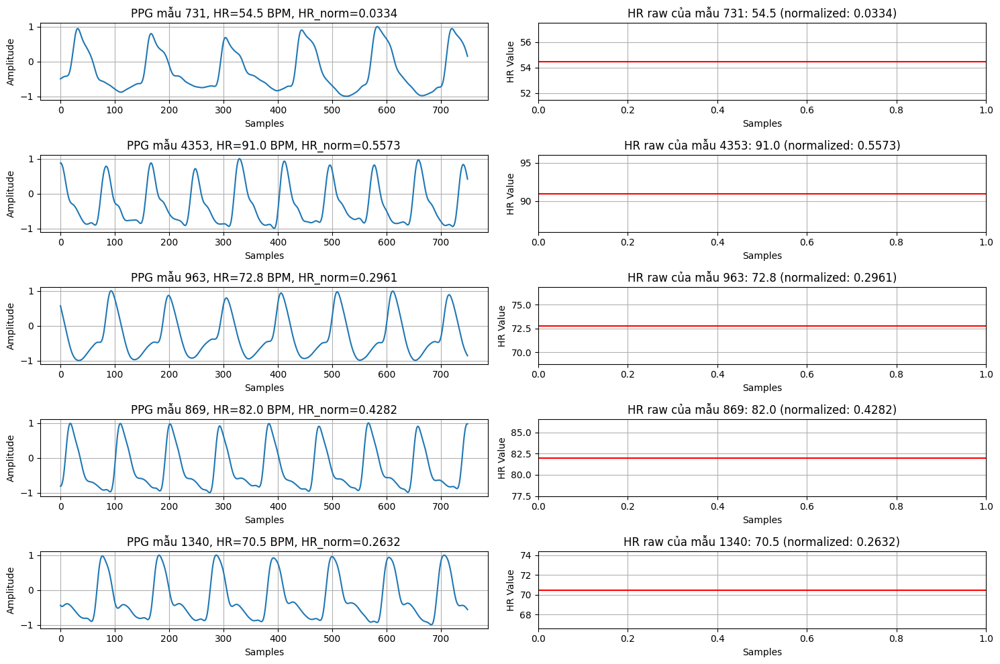

Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_vae.mat thành công!

X_train_filtered shape: (10985, 750)
hr_raw_train_normalized shape: (10985,)
X_test_filtered shape: (2747, 750)
hr_raw_test_normalized shape: (2747,)
Batch data shape: torch.Size([64, 750])
Xây dựng mô hình với input_size=750

=== Cấu trúc Encoder ===
Encoder(
  (input_layer): Linear(in_features=750, out_features=256, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=256, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=64, bias=True)
  )
  (z_mean): Linear(in_features=64, out_features=64, bias=True)
  (z_log_var): Linear(in_features=64, out_features=64, bias=True)
  (sampling): Sampling()
)

=== Cấu trúc Decoder ===
Decoder(
  (input_layer): Linear(in_features=64, out_features=64, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=64, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=256, bias=Tr

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch 0/600
Train Loss: 0.3442, Test Loss: 0.3400
Recon Loss: 0.3352, KL Loss: 0.0097
Epoch 10/600
Train Loss: 0.1883, Test Loss: 0.1847
Recon Loss: 0.1306, KL Loss: 0.1082
Epoch 20/600
Train Loss: 0.1443, Test Loss: 0.1453
Recon Loss: 0.0863, KL Loss: 0.1181
Epoch 30/600
Train Loss: 0.1349, Test Loss: 0.1353
Recon Loss: 0.0725, KL Loss: 0.1257
Epoch 40/600
Train Loss: 0.1312, Test Loss: 0.1334
Recon Loss: 0.0694, KL Loss: 0.1279
Epoch 50/600
Train Loss: 0.1299, Test Loss: 0.1311
Recon Loss: 0.0675, KL Loss: 0.1273
Epoch 60/600
Train Loss: 0.1277, Test Loss: 0.1302
Recon Loss: 0.0684, KL Loss: 0.1235
Epoch 70/600
Train Loss: 0.1271, Test Loss: 0.1295
Recon Loss: 0.0666, KL Loss: 0.1259
Epoch 80/600
Train Loss: 0.1261, Test Loss: 0.1278
Recon Loss: 0.0644, KL Loss: 0.1269
Epoch 90/600
Train Loss: 0.1255, Test Loss: 0.1295
Recon Loss: 0.0673, KL Loss: 0.1243
Epoch 100/600
Train Loss: 0.1253, Test Loss: 0.1276
Recon Loss: 0.0660, KL Loss: 0.1232
Epoch 110/600
Train Loss: 0.1252, Test Loss

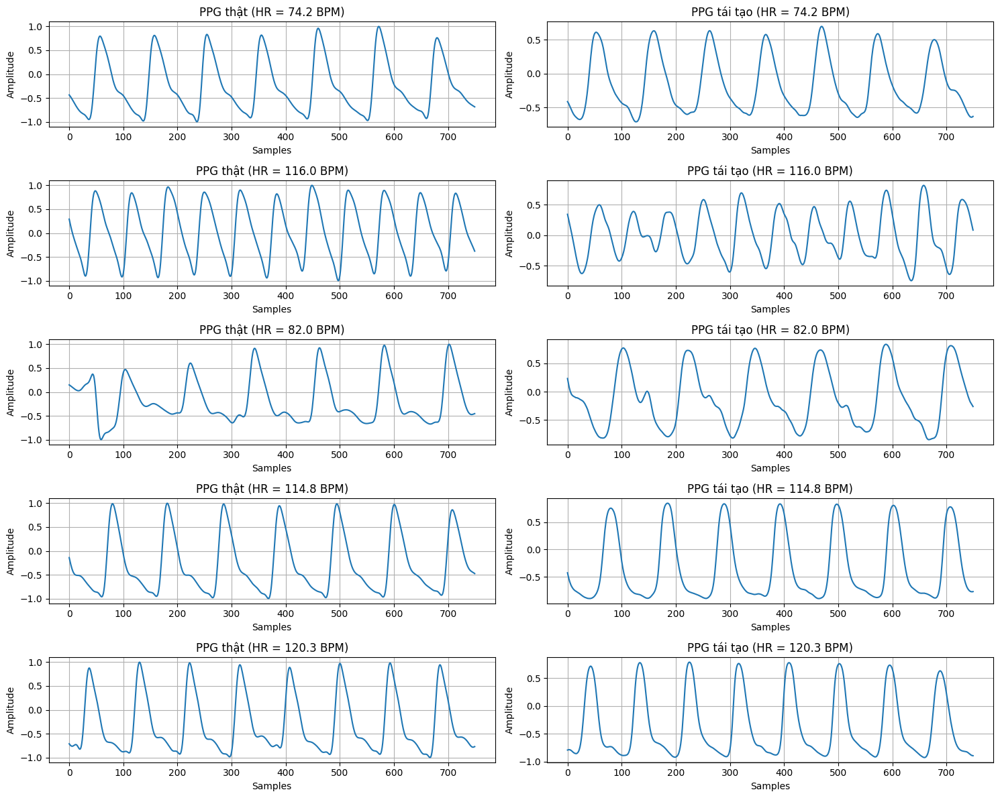

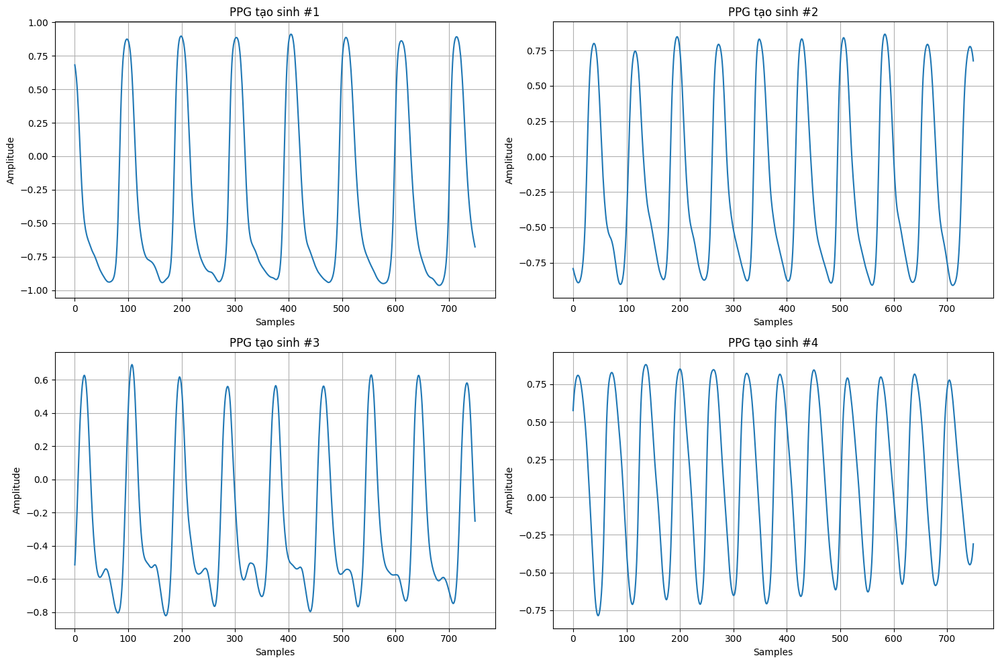

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import loadmat
from google.colab import drive
import os
from sklearn.model_selection import train_test_split
import scipy.io as sio

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Sử dụng device: {device}")

# Đường dẫn file dữ liệu
data_path = '/content/drive/MyDrive/Big/processed/combined_data_with_rr.mat'

# Kiểm tra sự tồn tại của file
if not os.path.exists(data_path):
    raise FileNotFoundError(f"File {data_path} không tồn tại.")

# Load dữ liệu từ file
print(f"Đang load dữ liệu từ file {data_path}...")
loaded_data = loadmat(data_path)

# Kiểm tra các trường cần thiết
required_keys = ['X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'X_total_norm', 'hr_raw_total']
for key in required_keys:
    if key not in loaded_data:
        raise ValueError(f"Thiếu trường {key} trong file {data_path}")

# Trích xuất dữ liệu
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
hr_raw_train_loaded = loaded_data['hr_raw_train'].flatten()
hr_raw_test_loaded = loaded_data['hr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
hr_raw_total_loaded = loaded_data['hr_raw_total'].flatten()

# Kiểm tra kích thước dữ liệu đã load
print("\nShape của dữ liệu đã load:")
print(f"X_train_loaded shape: {X_train_loaded.shape}")
print(f"hr_raw_train_loaded shape: {hr_raw_train_loaded.shape}")
print(f"X_test_loaded shape: {X_test_loaded.shape}")
print(f"hr_raw_test_loaded shape: {hr_raw_test_loaded.shape}")
print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"hr_raw_total_loaded shape: {hr_raw_total_loaded.shape}")

# Tính toán thống kê cho hr_raw_total_loaded
hr_raw_total_min = np.min(hr_raw_total_loaded)
hr_raw_total_max = np.max(hr_raw_total_loaded)
hr_raw_total_mean = np.mean(hr_raw_total_loaded)
hr_raw_total_std = np.std(hr_raw_total_loaded)
hr_raw_lower_bound = max(30, hr_raw_total_mean - 2 * hr_raw_total_std)
hr_raw_upper_bound = min(200, hr_raw_total_mean + 2 * hr_raw_total_std)

# In thống kê
print("\nThống kê HR raw total:")
print(f"Min: {hr_raw_total_min:.2f}, Max: {hr_raw_total_max:.2f}")
print(f"Mean: {hr_raw_total_mean:.2f}, Std: {hr_raw_total_std:.2f}")
print(f"Bounds: [{hr_raw_lower_bound:.2f}, {hr_raw_upper_bound:.2f}]")

# Tạo thư mục lưu biểu đồ
os.makedirs('/content/drive/MyDrive/Big/figures/vae/', exist_ok=True)

# Vẽ phân phối HR raw của bộ total
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(hr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {hr_raw_total_mean:.2f}')
plt.axvline(hr_raw_lower_bound, color='g', linestyle='--', label=f'Lower: {hr_raw_lower_bound:.2f}')
plt.axvline(hr_raw_upper_bound, color='g', linestyle='--', label=f'Upper: {hr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_loaded)
plt.title('Box plot của HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/vae/hr_raw_total_distribution_combined.png')
plt.show()

# Lọc dữ liệu nằm trong khoảng [hr_raw_lower_bound, hr_raw_upper_bound]
valid_mask_total = (hr_raw_total_loaded >= hr_raw_lower_bound) & (hr_raw_total_loaded <= hr_raw_upper_bound)
X_total_filtered = X_total_loaded[valid_mask_total]
hr_raw_total_filtered = hr_raw_total_loaded[valid_mask_total]

print(f"\nX_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"hr_raw_total_filtered shape: {hr_raw_total_filtered.shape}")

# Chuẩn hóa HR raw về [0, 1]
def normalize_hr_raw(hr_raw_data, hr_min, hr_max):
    normalized = (hr_raw_data - hr_min) / (hr_max - hr_min)
    normalized = np.clip(normalized, 0, 1)
    return normalized

hr_raw_total_normalized = normalize_hr_raw(hr_raw_total_filtered, hr_raw_lower_bound, hr_raw_upper_bound)

# Kiểm tra kết quả chuẩn hóa
print("\nThống kê HR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(hr_raw_total_normalized):.4f}, Max: {np.max(hr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(hr_raw_total_normalized):.4f}, Std: {np.std(hr_raw_total_normalized):.4f}")

# Vẽ phân phối HR sau khi chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/vae/hr_normalized_total_distribution_combined.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, hr_raw_train_normalized, hr_raw_test_normalized = train_test_split(
    X_total_filtered, hr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy HR thô tương ứng
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
hr_raw_train_filtered = hr_raw_total_filtered[train_indices]
hr_raw_test_filtered = hr_raw_total_filtered[test_indices]

# In thông tin số lượng mẫu
print(f"\nSố mẫu train ban đầu: {X_train_loaded.shape[0]}")
print(f"Số mẫu train sau khi lọc: {X_train_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (train): {X_train_filtered.shape[0]/X_train_loaded.shape[0]*100:.2f}%")
print(f"Số mẫu test ban đầu: {X_test_loaded.shape[0]}")
print(f"Số mẫu test sau khi lọc: {X_test_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (test): {X_test_filtered.shape[0]/X_test_loaded.shape[0]*100:.2f}%")

# Kiểm tra thống kê HR sau khi chia tập
print("\nThống kê HR raw sau khi chia tập:")
print(f"Train - Min: {np.min(hr_raw_train_normalized):.4f}, Max: {np.max(hr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(hr_raw_train_normalized):.4f}, Std: {np.std(hr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(hr_raw_test_normalized):.4f}, Max: {np.max(hr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(hr_raw_test_normalized):.4f}, Std: {np.std(hr_raw_test_normalized):.4f}")

# Vẽ phân phối HR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=hr_raw_train_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(hr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=hr_raw_test_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/vae/hr_normalized_train_test_distribution_combined.png')
plt.show()

# Vẽ một vài mẫu PPG
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, HR={hr_raw_train_filtered[idx]:.1f} BPM, HR_norm={hr_raw_train_normalized[idx]:.4f}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(hr_raw_train_filtered[idx], color='r')
    plt.title(f'HR raw của mẫu {idx}: {hr_raw_train_filtered[idx]:.1f} (normalized: {hr_raw_train_normalized[idx]:.4f})')
    plt.xlabel('Samples')
    plt.ylabel('HR Value')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/vae/ppg_samples_combined.png')
plt.show()

# Chuyển đổi dữ liệu thành tensor
X_train_tensor = torch.FloatTensor(X_train_filtered)
X_test_tensor = torch.FloatTensor(X_test_filtered)
hr_raw_train_tensor = torch.FloatTensor(hr_raw_train_normalized.reshape(-1, 1))
hr_raw_test_tensor = torch.FloatTensor(hr_raw_test_normalized.reshape(-1, 1))

# Tạo dataset và dataloader (chỉ dùng PPG, không cần HR vì VAE không có điều kiện)
train_dataset = TensorDataset(X_train_tensor)
test_dataset = TensorDataset(X_test_tensor)
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Lưu dữ liệu đã xử lý vào file .mat
data_to_save = {
    'X_train_filtered': X_train_filtered,
    'hr_raw_train_normalized': hr_raw_train_normalized,
    'X_test_filtered': X_test_filtered,
    'hr_raw_test_normalized': hr_raw_test_normalized
}
sio.savemat('/content/drive/MyDrive/Big/processed/final_combined_data_vae.mat', data_to_save)
print("Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_vae.mat thành công!")

# Kiểm tra kích thước dữ liệu
print(f"\nX_train_filtered shape: {X_train_filtered.shape}")
print(f"hr_raw_train_normalized shape: {hr_raw_train_normalized.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")
print(f"hr_raw_test_normalized shape: {hr_raw_test_normalized.shape}")

# Kiểm tra kích thước batch
sample_data = next(iter(train_loader))[0]
print(f"Batch data shape: {sample_data.shape}")

# Thiết lập tham số mô hình
input_size = X_train_filtered.shape[1]  # 750
latent_dim = 64
hidden_dims = [256, 128, 64]
print(f"Xây dựng mô hình với input_size={input_size}")

# Định nghĩa lớp Sampling
class Sampling(nn.Module):
    def __init__(self):
        super(Sampling, self).__init__()

    def forward(self, args):
        z_mean, z_log_var = args
        batch_size = z_mean.size(0)
        latent_dim = z_mean.size(1)
        epsilon = torch.randn(batch_size, latent_dim).to(z_mean.device)
        return z_mean + torch.exp(0.5 * z_log_var) * epsilon

# Định nghĩa Encoder
class Encoder(nn.Module):
    def __init__(self, input_dim, latent_dim, hidden_dims=[256, 128, 64]):
        super(Encoder, self).__init__()
        self.input_layer = nn.Linear(input_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.z_mean = nn.Linear(hidden_dims[-1], latent_dim)
        self.z_log_var = nn.Linear(hidden_dims[-1], latent_dim)
        self.sampling = Sampling()

    def forward(self, x):
        x = F.relu(self.input_layer(x))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        z = self.sampling((z_mean, z_log_var))
        return z_mean, z_log_var, z

# Định nghĩa Decoder
class Decoder(nn.Module):
    def __init__(self, latent_dim, output_dim, hidden_dims=[64, 128, 256]):
        super(Decoder, self).__init__()
        self.input_layer = nn.Linear(latent_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.output_layer = nn.Linear(hidden_dims[-1], output_dim)

    def forward(self, z):
        x = F.relu(self.input_layer(z))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        x = torch.tanh(self.output_layer(x))
        return x

# Định nghĩa VAE
class VAE(nn.Module):
    def __init__(self, input_dim, latent_dim, hidden_dims=[256, 128, 64]):
        super(VAE, self).__init__()
        self.encoder = Encoder(input_dim, latent_dim, hidden_dims)
        self.decoder = Decoder(latent_dim, input_dim, hidden_dims[::-1])

    def forward(self, x):
        z_mean, z_log_var, z = self.encoder(x)
        reconstruction = self.decoder(z)
        return reconstruction, z_mean, z_log_var

    def generate(self, num_samples=1):
        self.eval()
        with torch.no_grad():
            z = torch.randn(num_samples, self.encoder.z_mean.out_features).to(device)
            generated = self.decoder(z)
        return generated

# Khởi tạo mô hình
vae = VAE(input_size, latent_dim, hidden_dims).to(device)

# Hiển thị cấu trúc mô hình
print("\n=== Cấu trúc Encoder ===")
print(vae.encoder)
print("\n=== Cấu trúc Decoder ===")
print(vae.decoder)
print("\n=== Cấu trúc VAE ===")
print(vae)

# Tính tổng số tham số
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"\nTổng số tham số của Encoder: {count_parameters(vae.encoder):,}")
print(f"Tổng số tham số của Decoder: {count_parameters(vae.decoder):,}")
print(f"Tổng số tham số của VAE: {count_parameters(vae):,}")

# Trực quan hóa flow của dữ liệu qua mô hình
def visualize_model_flow(sample_data):
    sample_x = sample_data[0:1].to(device)
    print(f"\nInput shape: {sample_x.shape}")
    z_mean, z_log_var, z = vae.encoder(sample_x)
    print(f"z_mean shape: {z_mean.shape}")
    print(f"z_log_var shape: {z_log_var.shape}")
    print(f"Sampled z shape: {z.shape}")
    reconstruction = vae.decoder(z)
    print(f"Reconstruction shape: {reconstruction.shape}")

visualize_model_flow(sample_data)

# Định nghĩa hàm loss
def loss_function(x, x_recon, z_mean, z_log_var, kl_weight=0.5):
    recon_loss = F.mse_loss(x_recon, x, reduction='mean')
    kl_loss = -0.5 * torch.mean(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
    loss = recon_loss + kl_weight * kl_loss
    return loss, recon_loss, kl_loss

# Thiết lập tham số huấn luyện
learning_rate = 1e-3
epochs = 600
kl_weight = 0.5
patience = 50

# Khởi tạo optimizer và scheduler
optimizer = torch.optim.Adam(vae.parameters(), lr=learning_rate)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=20, verbose=True)

# Tạo thư mục lưu checkpoint
os.makedirs('/content/drive/MyDrive/Big/checkpoints/vae/', exist_ok=True)

# Khởi tạo lịch sử huấn luyện
train_losses = []
test_losses = []
recon_losses = []
kl_losses = []
best_loss = float('inf')
patience_counter = 0

# Vòng lặp huấn luyện
for epoch in range(epochs):
    vae.train()
    total_train_loss = 0
    total_train_recon_loss = 0
    total_train_kl_loss = 0

    for batch_idx, data in enumerate(train_loader):
        data = data[0].to(device)
        optimizer.zero_grad()
        reconstruction, z_mean, z_log_var = vae(data)
        loss, recon_loss, kl_loss = loss_function(data, reconstruction, z_mean, z_log_var, kl_weight)
        loss.backward()
        optimizer.step()
        total_train_loss += loss.item() * data.size(0)
        total_train_recon_loss += recon_loss.item() * data.size(0)
        total_train_kl_loss += kl_loss.item() * data.size(0)

    vae.eval()
    total_test_loss = 0
    total_test_recon_loss = 0
    total_test_kl_loss = 0

    with torch.no_grad():
        for data in test_loader:
            data = data[0].to(device)
            reconstruction, z_mean, z_log_var = vae(data)
            loss, recon_loss, kl_loss = loss_function(data, reconstruction, z_mean, z_log_var, kl_weight)
            total_test_loss += loss.item() * data.size(0)
            total_test_recon_loss += recon_loss.item() * data.size(0)
            total_test_kl_loss += kl_loss.item() * data.size(0)

    train_loss = total_train_loss / len(train_loader.dataset)
    test_loss = total_test_loss / len(test_loader.dataset)
    train_recon_loss = total_train_recon_loss / len(train_loader.dataset)
    test_recon_loss = total_test_recon_loss / len(test_loader.dataset)
    train_kl_loss = total_train_kl_loss / len(train_loader.dataset)
    test_kl_loss = total_test_kl_loss / len(test_loader.dataset)

    scheduler.step(test_loss)
    train_losses.append(train_loss)
    test_losses.append(test_loss)
    recon_losses.append(test_recon_loss)
    kl_losses.append(test_kl_loss)

    if epoch % 10 == 0:
        print(f"Epoch {epoch}/{epochs}")
        print(f"Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}")
        print(f"Recon Loss: {test_recon_loss:.4f}, KL Loss: {test_kl_loss:.4f}")

    if epoch % 50 == 0:
        checkpoint_path = f'/content/drive/MyDrive/Big/checkpoints/vae/vae_checkpoint_epoch_{epoch}.pth'
        torch.save({
            'epoch': epoch,
            'model_state_dict': vae.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'train_loss': train_loss,
            'test_loss': test_loss,
            'train_losses': train_losses,
            'test_losses': test_losses,
            'recon_losses': recon_losses,
            'kl_losses': kl_losses
        }, checkpoint_path)

    if test_loss < best_loss:
        best_loss = test_loss
        best_model_path = '/content/drive/MyDrive/Big/models/vae/best_vae_combined.pth'
        os.makedirs(os.path.dirname(best_model_path), exist_ok=True)
        torch.save({
            'epoch': epoch,
            'model_state_dict': vae.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'train_loss': train_loss,
            'test_loss': test_loss
        }, best_model_path)
        patience_counter = 0
    else:
        patience_counter += 1

    if patience_counter >= patience:
        print(f"Early stopping tại epoch {epoch} vì không có cải thiện sau {patience} epochs")
        break

# Lưu lịch sử huấn luyện
history = {
    'train_losses': train_losses,
    'test_losses': test_losses,
    'recon_losses': recon_losses,
    'kl_losses': kl_losses
}
torch.save(history, '/content/drive/MyDrive/Big/models/vae/training_history_combined.pth')

print("Huấn luyện hoàn tất!")

# Hàm đánh giá và tạo sinh PPG
def evaluate_generation(vae, num_samples=1):
    vae.eval()
    with torch.no_grad():
        generated = vae.generate(num_samples)
    return generated

# Hàm chuyển đổi HR chuẩn hóa về HR thực
def denormalize_hr(normalized_hr, min_hr=hr_raw_lower_bound, max_hr=hr_raw_upper_bound):
    return normalized_hr * (max_hr - min_hr) + min_hr

# So sánh PPG thật và tái tạo
n_samples = 5
test_samples = []
test_conditions = []

for i, data in enumerate(test_loader):
    if i >= n_samples:
        break
    test_samples.append(data[0][0])
    # Lấy HR từ hr_raw_test_normalized tương ứng
    test_conditions.append(hr_raw_test_normalized[i])

reconstructed_samples = []
vae.eval()
with torch.no_grad():
    for sample in test_samples:
        sample = sample.unsqueeze(0).to(device)
        reconstruction, _, _ = vae(sample)
        reconstructed_samples.append(reconstruction.cpu().squeeze(0))

plt.figure(figsize=(15, 12))
for i in range(n_samples):
    actual_hr = denormalize_hr(test_conditions[i])
    plt.subplot(n_samples, 2, 2*i+1)
    plt.plot(test_samples[i].cpu().numpy())
    plt.title(f'PPG thật (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(n_samples, 2, 2*i+2)
    plt.plot(reconstructed_samples[i].numpy())
    plt.title(f'PPG tái tạo (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/vae/ppg_comparison_combined.png')
plt.show()

# Tạo PPG ngẫu nhiên
generated_samples = evaluate_generation(vae, num_samples=4)

plt.figure(figsize=(15, 10))
for i in range(4):
    plt.subplot(2, 2, i+1)
    plt.plot(generated_samples[i].cpu().numpy())
    plt.title(f'PPG tạo sinh #{i+1}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/vae/ppg_generated_combined.png')
plt.show()

# So

# GAN với điều kiện HR trên bộ combined

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Sử dụng device: cuda
Đang load dữ liệu từ file /content/drive/MyDrive/Big/processed/combined_data_with_rr.mat...

Shape của dữ liệu đã load:
X_train_loaded shape: (11566, 750)
hr_raw_train_loaded shape: (11566,)
X_test_loaded shape: (2893, 750)
hr_raw_test_loaded shape: (2893,)
X_total_loaded shape: (14459, 750)
hr_raw_total_loaded shape: (14459,)

Thống kê HR raw total:
Min: 50.23, Max: 143.53
Mean: 87.01, Std: 17.43
Bounds: [52.15, 121.87]


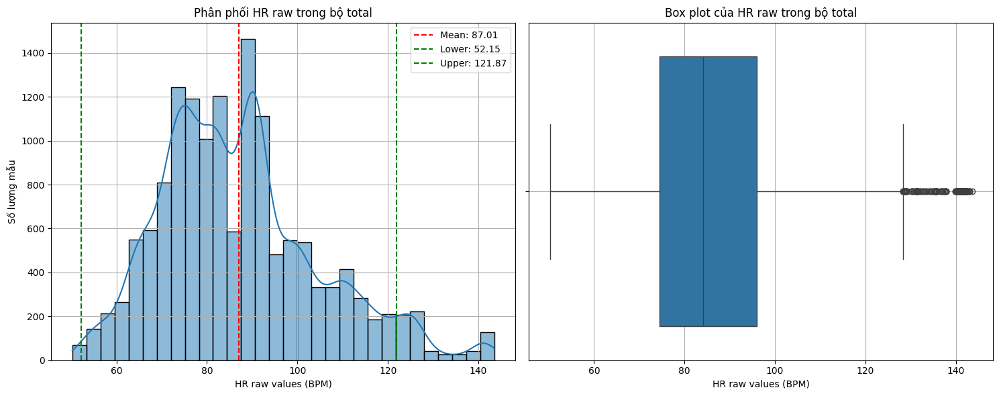


X_total_filtered shape after outlier removal: (13732, 750)
hr_raw_total_filtered shape: (13732,)

Thống kê HR raw total sau khi chuẩn hóa:
Min: 0.0011, Max: 0.9999
Mean: 0.4703, Std: 0.2115


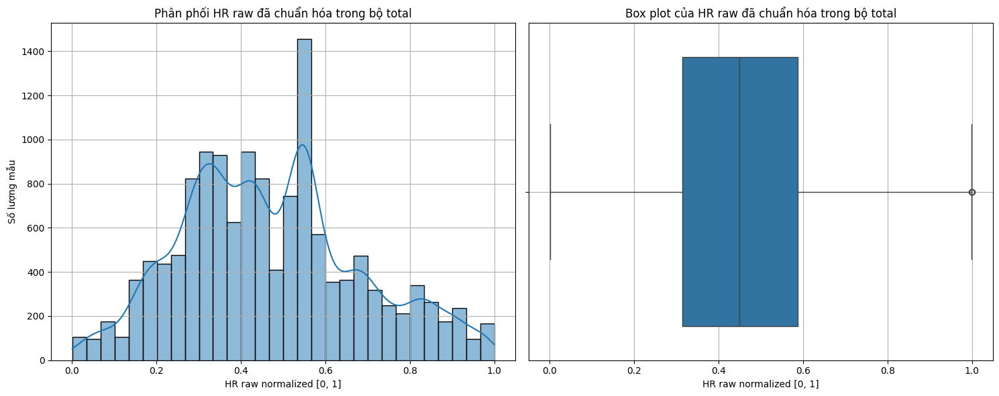


Số mẫu train ban đầu: 11566
Số mẫu train sau khi lọc: 10985
Tỷ lệ giữ lại (train): 94.98%
Số mẫu test ban đầu: 2893
Số mẫu test sau khi lọc: 2747
Tỷ lệ giữ lại (test): 94.95%

Thống kê HR raw sau khi chia tập:
Train - Min: 0.0011, Max: 0.9999
Train - Mean: 0.4694, Std: 0.2115
Test - Min: 0.0015, Max: 0.9971
Test - Mean: 0.4741, Std: 0.2110


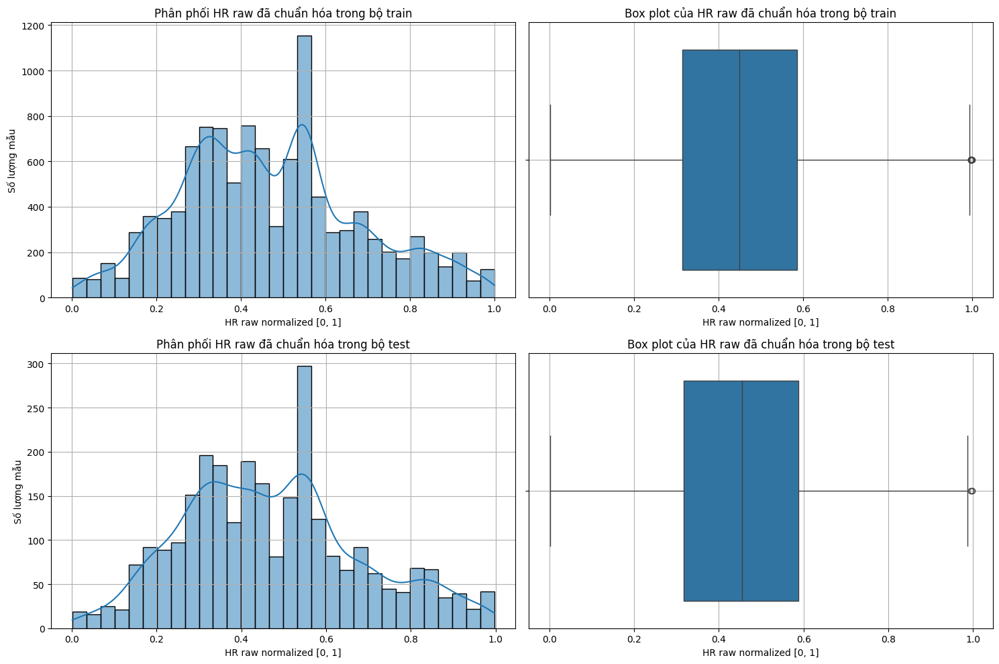

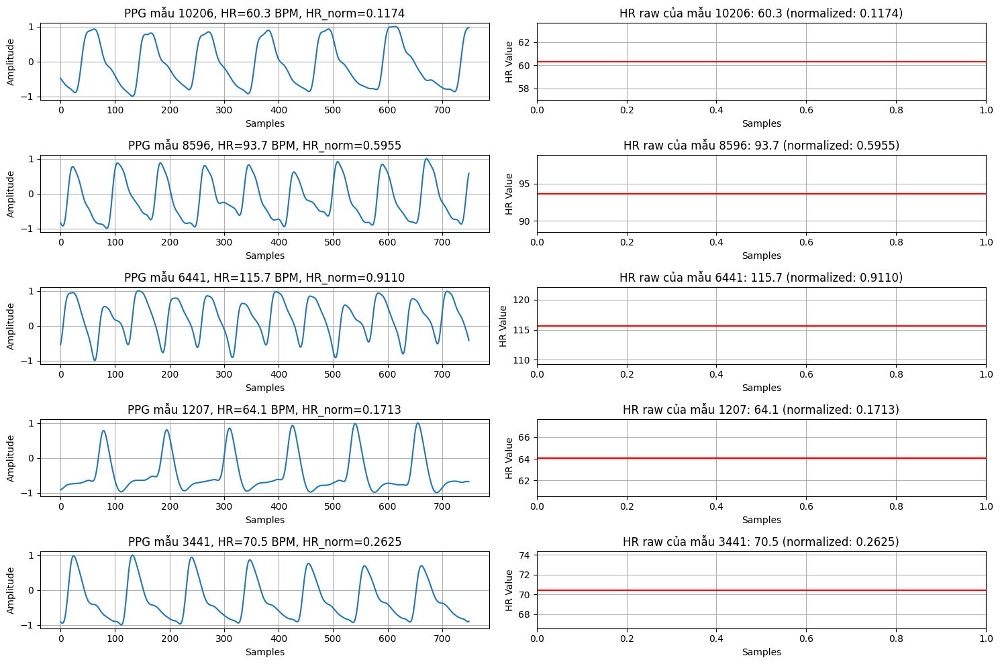

Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_cgan.mat thành công!

X_train_filtered shape: (10985, 750)
hr_raw_train_normalized shape: (10985,)
X_test_filtered shape: (2747, 750)
hr_raw_test_normalized shape: (2747,)
Batch data shape: torch.Size([64, 750])
Batch condition shape: torch.Size([64, 1])

=== Cấu trúc Generator ===
Generator(
  (input_layer): Linear(in_features=65, out_features=256, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=256, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=64, bias=True)
  )
  (output_layer): Linear(in_features=64, out_features=750, bias=True)
)

=== Cấu trúc Discriminator ===
Discriminator(
  (input_layer): Linear(in_features=751, out_features=256, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=256, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=64, bias=True)
  )
  (output_layer): Linear(in_features=64, out_featur

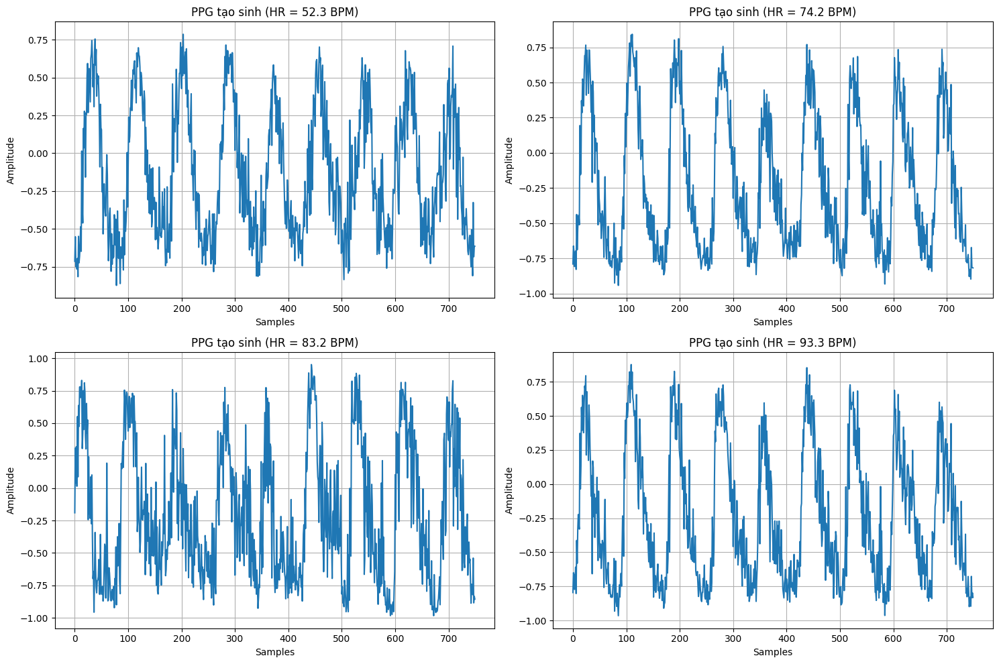

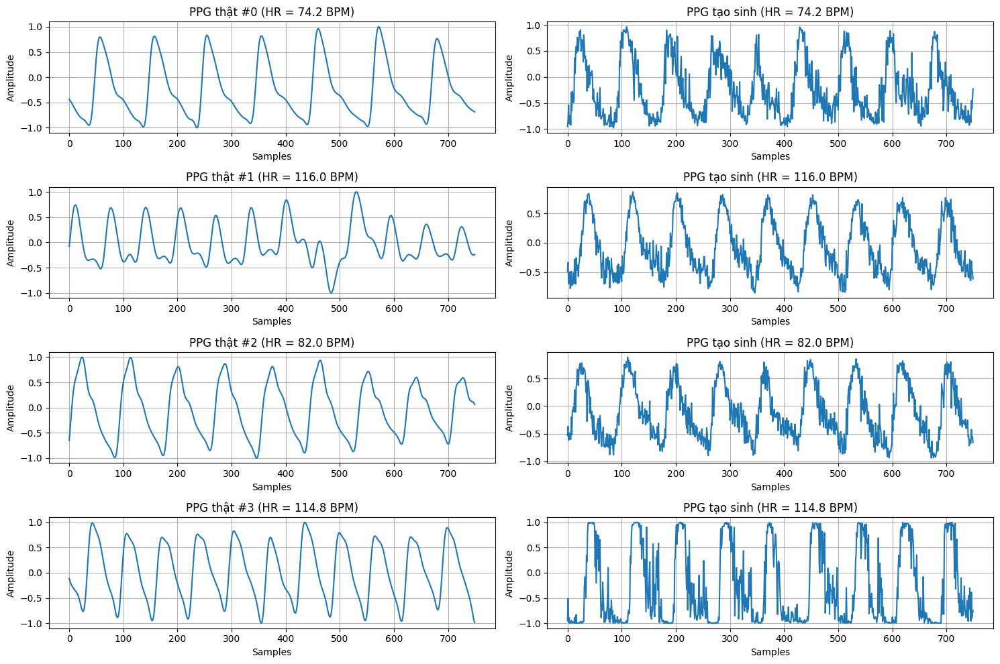

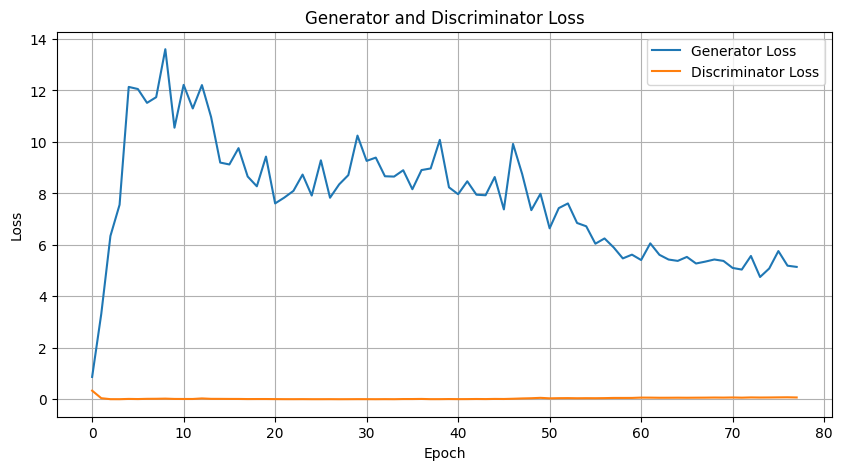

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import loadmat
from google.colab import drive
import os
from sklearn.model_selection import train_test_split
import scipy.io as sio

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Sử dụng device: {device}")

# Đường dẫn file dữ liệu
data_path = '/content/drive/MyDrive/Big/processed/combined_data_with_rr.mat'

# Kiểm tra sự tồn tại của file
if not os.path.exists(data_path):
    raise FileNotFoundError(f"File {data_path} không tồn tại.")

# Load dữ liệu từ file
print(f"Đang load dữ liệu từ file {data_path}...")
loaded_data = loadmat(data_path)

# Kiểm tra các trường cần thiết
required_keys = ['X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'X_total_norm', 'hr_raw_total']
for key in required_keys:
    if key not in loaded_data:
        raise ValueError(f"Thiếu trường {key} trong file {data_path}")

# Trích xuất dữ liệu
X_train_loaded = loaded_data['X_train_norm']
X_test_loaded = loaded_data['X_test_norm']
hr_raw_train_loaded = loaded_data['hr_raw_train'].flatten()
hr_raw_test_loaded = loaded_data['hr_raw_test'].flatten()
X_total_loaded = loaded_data['X_total_norm']
hr_raw_total_loaded = loaded_data['hr_raw_total'].flatten()

# Kiểm tra kích thước dữ liệu đã load
print("\nShape của dữ liệu đã load:")
print(f"X_train_loaded shape: {X_train_loaded.shape}")
print(f"hr_raw_train_loaded shape: {hr_raw_train_loaded.shape}")
print(f"X_test_loaded shape: {X_test_loaded.shape}")
print(f"hr_raw_test_loaded shape: {hr_raw_test_loaded.shape}")
print(f"X_total_loaded shape: {X_total_loaded.shape}")
print(f"hr_raw_total_loaded shape: {hr_raw_total_loaded.shape}")

# Tính toán thống kê cho hr_raw_total_loaded
hr_raw_total_min = np.min(hr_raw_total_loaded)
hr_raw_total_max = np.max(hr_raw_total_loaded)
hr_raw_total_mean = np.mean(hr_raw_total_loaded)
hr_raw_total_std = np.std(hr_raw_total_loaded)
hr_raw_lower_bound = max(30, hr_raw_total_mean - 2 * hr_raw_total_std)
hr_raw_upper_bound = min(200, hr_raw_total_mean + 2 * hr_raw_total_std)

# In thống kê
print("\nThống kê HR raw total:")
print(f"Min: {hr_raw_total_min:.2f}, Max: {hr_raw_total_max:.2f}")
print(f"Mean: {hr_raw_total_mean:.2f}, Std: {hr_raw_total_std:.2f}")
print(f"Bounds: [{hr_raw_lower_bound:.2f}, {hr_raw_upper_bound:.2f}]")

# Tạo thư mục lưu biểu đồ
os.makedirs('/content/drive/MyDrive/Big/figures/cgan/', exist_ok=True)

# Vẽ phân phối HR raw của bộ total
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_loaded, kde=True, bins=30)
plt.title('Phân phối HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.ylabel('Số lượng mẫu')
plt.axvline(hr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {hr_raw_total_mean:.2f}')
plt.axvline(hr_raw_lower_bound, color='g', linestyle='--', label=f'Lower: {hr_raw_lower_bound:.2f}')
plt.axvline(hr_raw_upper_bound, color='g', linestyle='--', label=f'Upper: {hr_raw_upper_bound:.2f}')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_loaded)
plt.title('Box plot của HR raw trong bộ total')
plt.xlabel('HR raw values (BPM)')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/cgan/hr_raw_total_distribution_combined.png')
plt.show()

# Lọc dữ liệu nằm trong khoảng [hr_raw_lower_bound, hr_raw_upper_bound]
valid_mask_total = (hr_raw_total_loaded >= hr_raw_lower_bound) & (hr_raw_total_loaded <= hr_raw_upper_bound)
X_total_filtered = X_total_loaded[valid_mask_total]
hr_raw_total_filtered = hr_raw_total_loaded[valid_mask_total]

print(f"\nX_total_filtered shape after outlier removal: {X_total_filtered.shape}")
print(f"hr_raw_total_filtered shape: {hr_raw_total_filtered.shape}")

# Chuẩn hóa HR raw về [0, 1]
def normalize_hr_raw(hr_raw_data, hr_min, hr_max):
    normalized = (hr_raw_data - hr_min) / (hr_max - hr_min)
    normalized = np.clip(normalized, 0, 1)
    return normalized

hr_raw_total_normalized = normalize_hr_raw(hr_raw_total_filtered, hr_raw_lower_bound, hr_raw_upper_bound)

# Kiểm tra kết quả chuẩn hóa
print("\nThống kê HR raw total sau khi chuẩn hóa:")
print(f"Min: {np.min(hr_raw_total_normalized):.4f}, Max: {np.max(hr_raw_total_normalized):.4f}")
print(f"Mean: {np.mean(hr_raw_total_normalized):.4f}, Std: {np.std(hr_raw_total_normalized):.4f}")

# Vẽ phân phối HR sau khi chuẩn hóa
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
sns.histplot(hr_raw_total_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(1, 2, 2)
sns.boxplot(x=hr_raw_total_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ total')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/cgan/hr_normalized_total_distribution_combined.png')
plt.show()

# Chia lại train/test
X_train_filtered, X_test_filtered, hr_raw_train_normalized, hr_raw_test_normalized = train_test_split(
    X_total_filtered, hr_raw_total_normalized, test_size=0.2, random_state=42
)

# Lấy HR thô tương ứng
train_indices = np.arange(len(X_total_filtered))
train_indices, test_indices = train_test_split(
    train_indices, test_size=0.2, random_state=42
)
hr_raw_train_filtered = hr_raw_total_filtered[train_indices]
hr_raw_test_filtered = hr_raw_total_filtered[test_indices]

# In thông tin số lượng mẫu
print(f"\nSố mẫu train ban đầu: {X_train_loaded.shape[0]}")
print(f"Số mẫu train sau khi lọc: {X_train_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (train): {X_train_filtered.shape[0]/X_train_loaded.shape[0]*100:.2f}%")
print(f"Số mẫu test ban đầu: {X_test_loaded.shape[0]}")
print(f"Số mẫu test sau khi lọc: {X_test_filtered.shape[0]}")
print(f"Tỷ lệ giữ lại (test): {X_test_filtered.shape[0]/X_test_loaded.shape[0]*100:.2f}%")

# Kiểm tra thống kê HR sau khi chia tập
print("\nThống kê HR raw sau khi chia tập:")
print(f"Train - Min: {np.min(hr_raw_train_normalized):.4f}, Max: {np.max(hr_raw_train_normalized):.4f}")
print(f"Train - Mean: {np.mean(hr_raw_train_normalized):.4f}, Std: {np.std(hr_raw_train_normalized):.4f}")
print(f"Test - Min: {np.min(hr_raw_test_normalized):.4f}, Max: {np.max(hr_raw_test_normalized):.4f}")
print(f"Test - Mean: {np.mean(hr_raw_test_normalized):.4f}, Std: {np.std(hr_raw_test_normalized):.4f}")

# Vẽ phân phối HR sau khi chia tập
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
sns.histplot(hr_raw_train_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 2)
sns.boxplot(x=hr_raw_train_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ train')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.subplot(2, 2, 3)
sns.histplot(hr_raw_test_normalized, kde=True, bins=30)
plt.title('Phân phối HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.ylabel('Số lượng mẫu')
plt.grid(True)

plt.subplot(2, 2, 4)
sns.boxplot(x=hr_raw_test_normalized)
plt.title('Box plot của HR raw đã chuẩn hóa trong bộ test')
plt.xlabel('HR raw normalized [0, 1]')
plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/cgan/hr_normalized_train_test_distribution_combined.png')
plt.show()

# Vẽ một vài mẫu PPG
plt.figure(figsize=(15, 10))
for i in range(5):
    idx = np.random.randint(0, X_train_filtered.shape[0])
    plt.subplot(5, 2, i*2+1)
    plt.plot(X_train_filtered[idx])
    plt.title(f'PPG mẫu {idx}, HR={hr_raw_train_filtered[idx]:.1f} BPM, HR_norm={hr_raw_train_normalized[idx]:.4f}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(5, 2, i*2+2)
    plt.axhline(hr_raw_train_filtered[idx], color='r')
    plt.title(f'HR raw của mẫu {idx}: {hr_raw_train_filtered[idx]:.1f} (normalized: {hr_raw_train_normalized[idx]:.4f})')
    plt.xlabel('Samples')
    plt.ylabel('HR Value')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/cgan/ppg_samples_combined.png')
plt.show()

# Chuyển đổi dữ liệu thành tensor
X_train_tensor = torch.FloatTensor(X_train_filtered)
hr_raw_train_tensor = torch.FloatTensor(hr_raw_train_normalized.reshape(-1, 1))
X_test_tensor = torch.FloatTensor(X_test_filtered)
hr_raw_test_tensor = torch.FloatTensor(hr_raw_test_normalized.reshape(-1, 1))

# Tạo dataset và dataloader
train_dataset = TensorDataset(X_train_tensor, hr_raw_train_tensor)
test_dataset = TensorDataset(X_test_tensor, hr_raw_test_tensor)
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Lưu dữ liệu đã xử lý vào file .mat
data_to_save = {
    'X_train_filtered': X_train_filtered,
    'hr_raw_train_normalized': hr_raw_train_normalized,
    'X_test_filtered': X_test_filtered,
    'hr_raw_test_normalized': hr_raw_test_normalized
}
sio.savemat('/content/drive/MyDrive/Big/processed/final_combined_data_cgan.mat', data_to_save)
print("Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_cgan.mat thành công!")

# Kiểm tra kích thước dữ liệu
print(f"\nX_train_filtered shape: {X_train_filtered.shape}")
print(f"hr_raw_train_normalized shape: {hr_raw_train_normalized.shape}")
print(f"X_test_filtered shape: {X_test_filtered.shape}")
print(f"hr_raw_test_normalized shape: {hr_raw_test_normalized.shape}")

# Kiểm tra kích thước batch
sample_data, sample_condition = next(iter(train_loader))
print(f"Batch data shape: {sample_data.shape}")
print(f"Batch condition shape: {sample_condition.shape}")

# Thiết lập tham số mô hình
input_size = X_train_filtered.shape[1]  # 750
condition_size = 1  # HR normalized
latent_dim = 64
hidden_dims = [256, 128, 64]

# Định nghĩa Generator
class Generator(nn.Module):
    def __init__(self, latent_dim, condition_dim, output_dim, hidden_dims=[64, 128, 256]):
        super(Generator, self).__init__()
        self.input_layer = nn.Linear(latent_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.output_layer = nn.Linear(hidden_dims[-1], output_dim)

    def forward(self, z, condition):
        x = torch.cat([z, condition], dim=1)
        x = F.relu(self.input_layer(x))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        x = torch.tanh(self.output_layer(x))
        return x

# Định nghĩa Discriminator
class Discriminator(nn.Module):
    def __init__(self, input_dim, condition_dim, hidden_dims=[256, 128, 64]):
        super(Discriminator, self).__init__()
        self.input_layer = nn.Linear(input_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.output_layer = nn.Linear(hidden_dims[-1], 1)

    def forward(self, x, condition):
        x = torch.cat([x, condition], dim=1)
        x = F.relu(self.input_layer(x))
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        x = torch.sigmoid(self.output_layer(x))
        return x

# Khởi tạo mô hình
generator = Generator(latent_dim, condition_size, input_size, hidden_dims).to(device)
discriminator = Discriminator(input_size, condition_size, hidden_dims).to(device)

# Hiển thị cấu trúc mô hình
print("\n=== Cấu trúc Generator ===")
print(generator)
print("\n=== Cấu trúc Discriminator ===")
print(discriminator)

# Tính tổng số tham số
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"\nTổng số tham số của Generator: {count_parameters(generator):,}")
print(f"Tổng số tham số của Discriminator: {count_parameters(discriminator):,}")

# Định nghĩa hàm loss
adversarial_loss = nn.BCELoss()

# Thiết lập optimizer
g_optimizer = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Tạo thư mục lưu checkpoint
os.makedirs('/content/drive/MyDrive/Big/checkpoints/cgan/', exist_ok=True)

# Khởi tạo lịch sử huấn luyện
g_losses = []
d_losses = []
epochs = 600
patience = 50
best_d_loss = float('inf')
patience_counter = 0

# Vòng lặp huấn luyện
for epoch in range(epochs):
    generator.train()
    discriminator.train()
    total_g_loss = 0
    total_d_loss = 0

    for batch_idx, (real_data, condition) in enumerate(train_loader):
        real_data = real_data.to(device)
        condition = condition.to(device)
        batch_size = real_data.size(0)

        # Huấn luyện Discriminator
        d_optimizer.zero_grad()
        real_labels = torch.ones(batch_size, 1).to(device)
        fake_labels = torch.zeros(batch_size, 1).to(device)

        # Discriminator trên dữ liệu thật
        real_output = discriminator(real_data, condition)
        d_real_loss = adversarial_loss(real_output, real_labels)

        # Discriminator trên dữ liệu giả
        z = torch.randn(batch_size, latent_dim).to(device)
        fake_data = generator(z, condition)
        fake_output = discriminator(fake_data.detach(), condition)
        d_fake_loss = adversarial_loss(fake_output, fake_labels)

        # Tổng loss Discriminator
        d_loss = (d_real_loss + d_fake_loss) / 2
        d_loss.backward()
        d_optimizer.step()

        # Huấn luyện Generator
        g_optimizer.zero_grad()
        fake_output = discriminator(fake_data, condition)
        g_loss = adversarial_loss(fake_output, real_labels)
        g_loss.backward()
        g_optimizer.step()

        total_g_loss += g_loss.item() * batch_size
        total_d_loss += d_loss.item() * batch_size

    g_loss = total_g_loss / len(train_loader.dataset)
    d_loss = total_d_loss / len(train_loader.dataset)
    g_losses.append(g_loss)
    d_losses.append(d_loss)

    if epoch % 10 == 0:
        print(f"Epoch {epoch}/{epochs}")
        print(f"Generator Loss: {g_loss:.4f}, Discriminator Loss: {d_loss:.4f}")

    if epoch % 50 == 0:
        checkpoint_path = f'/content/drive/MyDrive/Big/checkpoints/cgan/cgan_checkpoint_epoch_{epoch}.pth'
        torch.save({
            'epoch': epoch,
            'generator_state_dict': generator.state_dict(),
            'discriminator_state_dict': discriminator.state_dict(),
            'g_optimizer_state_dict': g_optimizer.state_dict(),
            'd_optimizer_state_dict': d_optimizer.state_dict(),
            'g_loss': g_loss,
            'd_loss': d_loss,
            'g_losses': g_losses,
            'd_losses': d_losses
        }, checkpoint_path)

        # Tạo và lưu biểu đồ PPG tạo sinh trong quá trình huấn luyện
        generator.eval()
        with torch.no_grad():
            test_hrs = torch.linspace(0.2, 0.8, 4).unsqueeze(1).to(device)
            z = torch.randn(4, latent_dim).to(device)
            generated_samples = generator(z, test_hrs).cpu().numpy()
            test_hrs_np = test_hrs.cpu().numpy()

        plt.figure(figsize=(15, 10))
        for i in range(4):
            actual_hr = denormalize_hr(test_hrs_np[i][0])
            plt.subplot(2, 2, i+1)
            plt.plot(generated_samples[i])
            plt.title(f'PPG tạo sinh (HR = {actual_hr:.1f} BPM)')
            plt.xlabel('Samples')
            plt.ylabel('Amplitude')
            plt.grid(True)
        plt.tight_layout()
        plt.savefig(f'/content/drive/MyDrive/Big/figures/cgan/ppg_generated_hr_epoch_{epoch}.png')
        plt.close()

    if d_loss < best_d_loss:
        best_d_loss = d_loss
        best_model_path = '/content/drive/MyDrive/Big/models/cgan/best_cgan_combined.pth'
        os.makedirs(os.path.dirname(best_model_path), exist_ok=True)
        torch.save({
            'epoch': epoch,
            'generator_state_dict': generator.state_dict(),
            'discriminator_state_dict': discriminator.state_dict(),
            'g_optimizer_state_dict': g_optimizer.state_dict(),
            'd_optimizer_state_dict': d_optimizer.state_dict(),
            'g_loss': g_loss,
            'd_loss': d_loss
        }, best_model_path)
        patience_counter = 0
    else:
        patience_counter += 1

    if patience_counter >= patience:
        print(f"Early stopping tại epoch {epoch} vì không có cải thiện sau {patience} epochs")
        break

# Lưu lịch sử huấn luyện
history = {
    'g_losses': g_losses,
    'd_losses': d_losses
}
torch.save(history, '/content/drive/MyDrive/Big/models/cgan/training_history_combined.pth')

print("Huấn luyện hoàn tất!")

# Hàm chuyển đổi HR chuẩn hóa về HR thực
def denormalize_hr(normalized_hr, min_hr=hr_raw_lower_bound, max_hr=hr_raw_upper_bound):
    return normalized_hr * (max_hr - min_hr) + min_hr

# Tạo PPG với các giá trị HR đa dạng
generator.eval()
test_hrs = []
for i, (_, condition) in enumerate(test_loader):
    if i >= 20:
        break
    for hr in condition:
        test_hrs.append(hr.item())

test_hrs = sorted(test_hrs)
selected_indices = [int(len(test_hrs) * i / 4) for i in range(4)]
selected_hrs = [test_hrs[i] for i in selected_indices]

generated_hr_samples = []
with torch.no_grad():
    for hr in selected_hrs:
        hr_tensor = torch.tensor([hr], dtype=torch.float32).unsqueeze(1).to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = generator(z, hr_tensor).cpu().squeeze(0).numpy()
        generated_hr_samples.append(generated)

plt.figure(figsize=(15, 10))
for i, hr in enumerate(selected_hrs):
    actual_hr = denormalize_hr(hr)
    plt.subplot(2, 2, i+1)
    plt.plot(generated_hr_samples[i])
    plt.title(f'PPG tạo sinh (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/cgan/ppg_generated_hr_combined.png')
plt.show()

# So sánh nhiều mẫu PPG thật và tạo sinh với HR khác nhau
plt.figure(figsize=(15, 10))
selected_samples = []
selected_conditions = []
selected_indices = []
unique_hrs = {}

for i in range(len(X_test_filtered)):
    hr_val = hr_raw_test_normalized[i]
    hr_actual = denormalize_hr(hr_val)
    hr_rounded = round(hr_actual)
    if hr_rounded not in unique_hrs and len(unique_hrs) < 4:
        unique_hrs[hr_rounded] = (X_test_filtered[i], hr_val, i)
        selected_samples.append(X_test_filtered[i])
        selected_conditions.append(hr_val)
        selected_indices.append(i)

generated_selected = []
with torch.no_grad():
    for hr in selected_conditions:
        hr_tensor = torch.tensor([hr], dtype=torch.float32).unsqueeze(1).to(device)
        z = torch.randn(1, latent_dim).to(device)
        generated = generator(z, hr_tensor).cpu().squeeze(0).numpy()
        generated_selected.append(generated)

for i in range(len(selected_samples)):
    actual_hr = denormalize_hr(selected_conditions[i])
    plt.subplot(4, 2, 2*i+1)
    plt.plot(selected_samples[i])
    plt.title(f'PPG thật #{selected_indices[i]} (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

    plt.subplot(4, 2, 2*i+2)
    plt.plot(generated_selected[i])
    plt.title(f'PPG tạo sinh (HR = {actual_hr:.1f} BPM)')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid(True)

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Big/figures/cgan/ppg_comparison_unique_hrs_combined.png')
plt.show()

# Vẽ lịch sử huấn luyện
plt.figure(figsize=(10, 5))
plt.plot(g_losses, label='Generator Loss')
plt.plot(d_losses, label='Discriminator Loss')
plt.title('Generator and Discriminator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.savefig('/content/drive/MyDrive/Big/figures/cgan/training_history_combined.png')
plt.show()

# cGAN với điều kiện HR trên bộ combined

Đang liên kết Google Drive...
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Sử dụng device: cuda
Đang load dữ liệu từ file /content/drive/MyDrive/Big/processed/combined_data_with_rr.mat...

Thống kê HR raw total:
Min: 50.23, Max: 143.53
Mean: 87.01, Std: 17.43
Bounds: [52.15, 121.87]


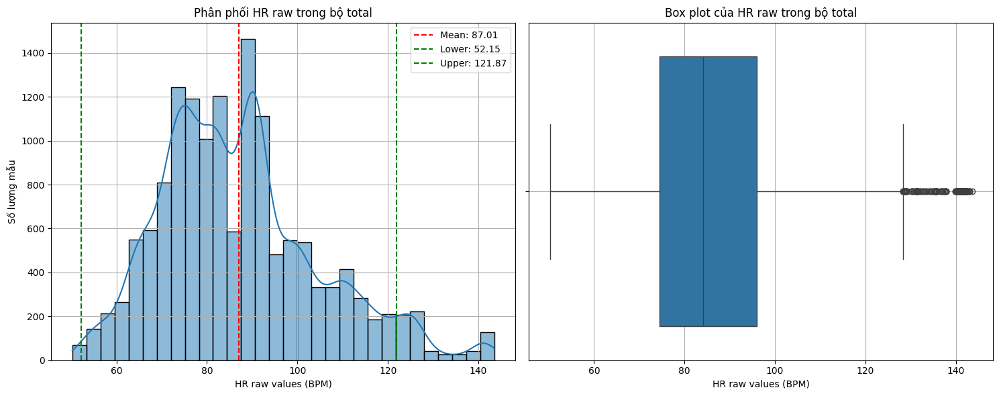


X_total_filtered shape after outlier removal: (13732, 750)

Thống kê HR raw total sau khi chuẩn hóa:
Min: 0.0011, Max: 0.9999
Mean: 0.4703, Std: 0.2115


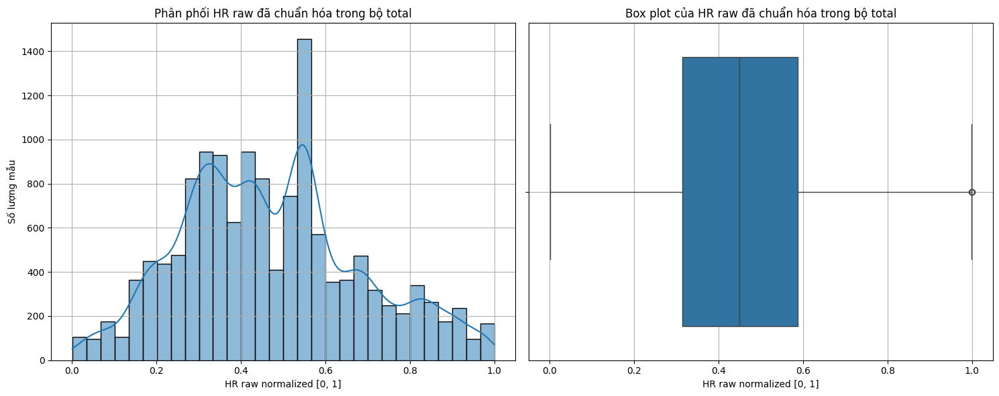


Số mẫu train sau khi lọc: 10985
Số mẫu test sau khi lọc: 2747

Thống kê HR raw sau khi chia tập:
Train - Min: 0.0011, Max: 0.9999
Train - Mean: 0.4694, Std: 0.2115
Test - Min: 0.0015, Max: 0.9971
Test - Mean: 0.4741, Std: 0.2110


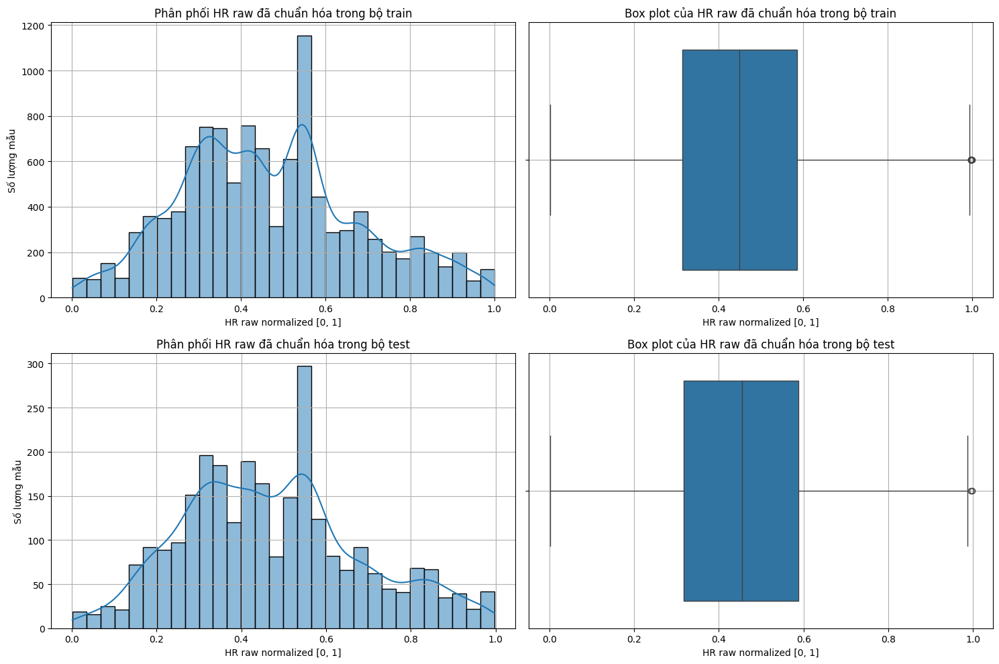

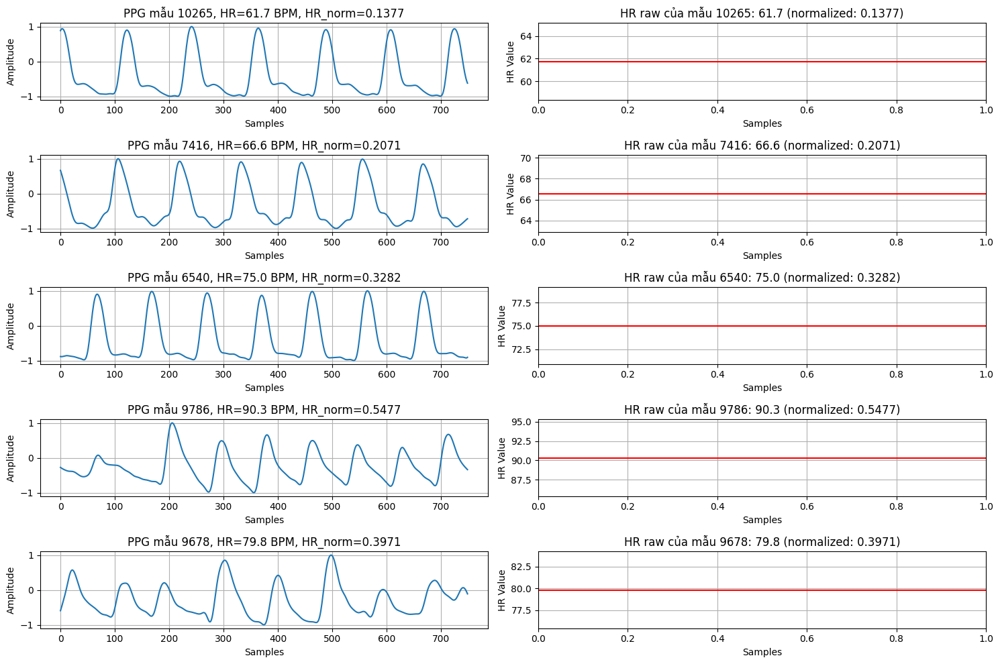

Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_cgan.mat

=== Cấu trúc Generator ===
Generator(
  (input_layer): Linear(in_features=65, out_features=64, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=64, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=256, bias=True)
  )
  (output_layer): Linear(in_features=256, out_features=750, bias=True)
)

=== Cấu trúc Discriminator ===
Discriminator(
  (input_layer): Linear(in_features=751, out_features=256, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=256, out_features=128, bias=True)
    (1): Linear(in_features=128, out_features=64, bias=True)
  )
  (output_layer): Linear(in_features=64, out_features=1, bias=True)
)

Tổng số tham số của Generator: 238,318
Tổng số tham số của Discriminator: 233,729
Epoch 0/600
Generator Loss: 0.9180, Discriminator Loss: 0.4877
Epoch 10/600
Generator Loss: 2.2805, Discriminator Loss: 0.3285
Epoch 20/600
Gene

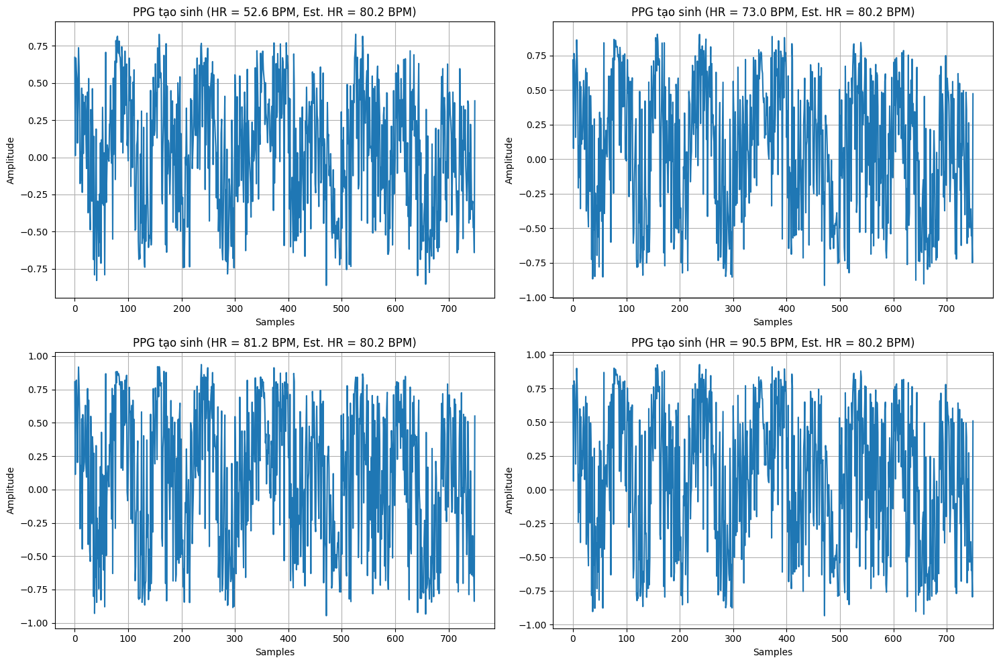

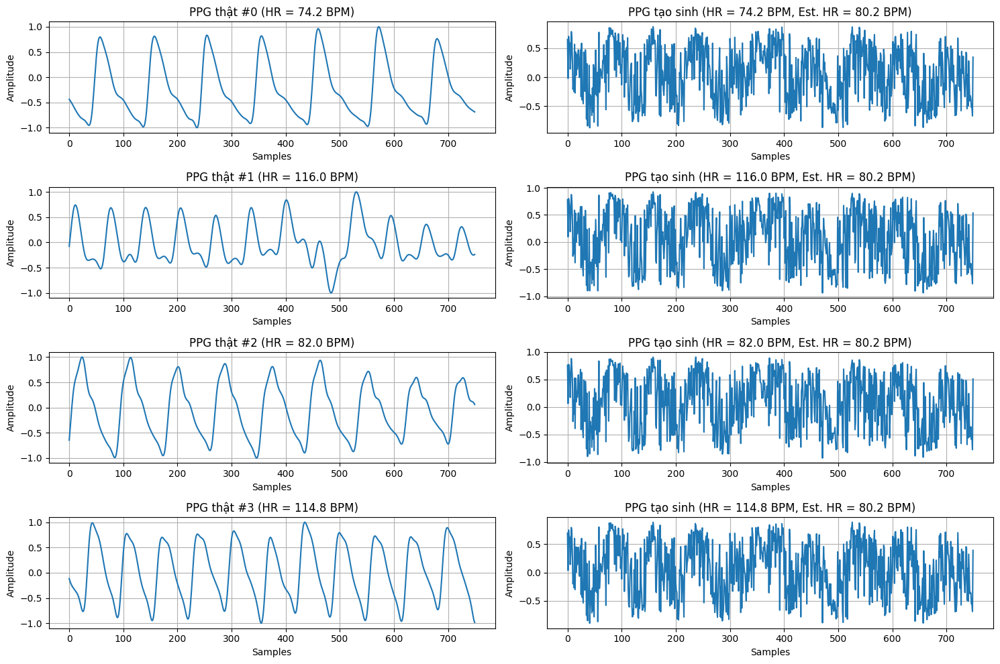

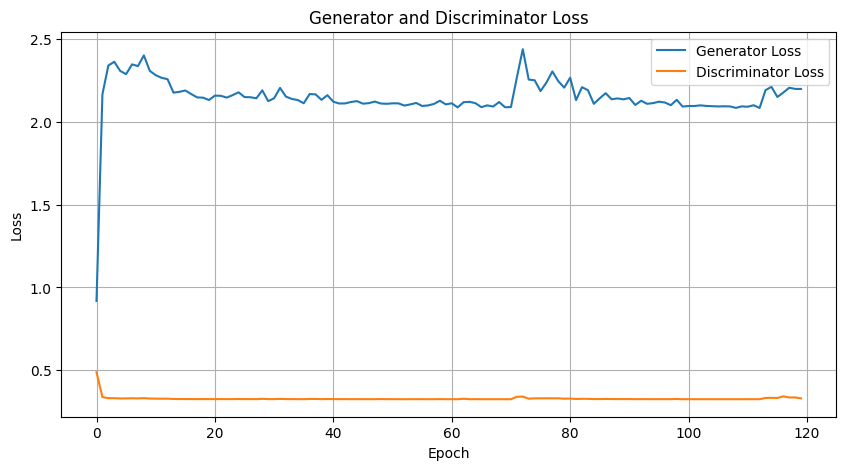

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import loadmat
from google.colab import drive
import os
from sklearn.model_selection import train_test_split
import scipy.io as sio
from scipy.fft import fft

# Mount Google Drive
print("Đang liên kết Google Drive...")
drive.mount('/content/drive')

# Thiết lập thiết bị
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Sử dụng device: {device}")

# Đường dẫn file dữ liệu
data_path = '/content/drive/MyDrive/Big/processed/combined_data_with_rr.mat'

# Kiểm tra sự tồn tại của file
if not os.path.exists(data_path):
    raise FileNotFoundError(f"File {data_path} không tồn tại.")

# Hàm chuẩn hóa HR
def normalize_hr_raw(hr_raw_data, hr_min, hr_max):
    normalized = (hr_raw_data - hr_min) / (hr_max - hr_min)
    return np.clip(normalized, 0, 1)

# Hàm chuyển đổi HR chuẩn hóa về HR thực
def denormalize_hr(normalized_hr, min_hr, max_hr):
    return normalized_hr * (max_hr - min_hr) + min_hr

# Hàm phân tích tần số của PPG
def analyze_frequency(ppg, fs=100):
    n = len(ppg)
    yf = fft(ppg)
    xf = np.linspace(0.0, fs/2.0, n//2)
    yf = 2.0/n * np.abs(yf[0:n//2])
    peak_freq = xf[np.argmax(yf)]
    return peak_freq * 60  # BPM

# Hàm xử lý dữ liệu
def prepare_data(data_path):
    print(f"Đang load dữ liệu từ file {data_path}...")
    loaded_data = loadmat(data_path)

    # Kiểm tra các trường cần thiết
    required_keys = ['X_train_norm', 'X_test_norm', 'hr_raw_train', 'hr_raw_test', 'X_total_norm', 'hr_raw_total']
    for key in required_keys:
        if key not in loaded_data:
            raise ValueError(f"Thiếu trường {key} trong file {data_path}")

    # Trích xuất dữ liệu
    X_total = loaded_data['X_total_norm']
    hr_raw_total = loaded_data['hr_raw_total'].flatten()

    # Tính toán thống kê HR
    hr_raw_total_min = np.min(hr_raw_total)
    hr_raw_total_max = np.max(hr_raw_total)
    hr_raw_total_mean = np.mean(hr_raw_total)
    hr_raw_total_std = np.std(hr_raw_total)
    hr_raw_lower_bound = max(30, hr_raw_total_mean - 2 * hr_raw_total_std)
    hr_raw_upper_bound = min(200, hr_raw_total_mean + 2 * hr_raw_total_std)

    print("\nThống kê HR raw total:")
    print(f"Min: {hr_raw_total_min:.2f}, Max: {hr_raw_total_max:.2f}")
    print(f"Mean: {hr_raw_total_mean:.2f}, Std: {hr_raw_total_std:.2f}")
    print(f"Bounds: [{hr_raw_lower_bound:.2f}, {hr_raw_upper_bound:.2f}]")

    # Vẽ phân phối HR raw
    plt.figure(figsize=(15, 6))
    plt.subplot(1, 2, 1)
    sns.histplot(hr_raw_total, kde=True, bins=30)
    plt.title('Phân phối HR raw trong bộ total')
    plt.xlabel('HR raw values (BPM)')
    plt.ylabel('Số lượng mẫu')
    plt.axvline(hr_raw_total_mean, color='r', linestyle='--', label=f'Mean: {hr_raw_total_mean:.2f}')
    plt.axvline(hr_raw_lower_bound, color='g', linestyle='--', label=f'Lower: {hr_raw_lower_bound:.2f}')
    plt.axvline(hr_raw_upper_bound, color='g', linestyle='--', label=f'Upper: {hr_raw_upper_bound:.2f}')
    plt.legend()
    plt.grid(True)

    plt.subplot(1, 2, 2)
    sns.boxplot(x=hr_raw_total)
    plt.title('Box plot của HR raw trong bộ total')
    plt.xlabel('HR raw values (BPM)')
    plt.grid(True)
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/Big/figures/cgan/hr_raw_total_distribution_combined.png')
    plt.show()

    # Lọc dữ liệu HR
    valid_mask = (hr_raw_total >= hr_raw_lower_bound) & (hr_raw_total <= hr_raw_upper_bound)
    X_total_filtered = X_total[valid_mask]
    hr_raw_total_filtered = hr_raw_total[valid_mask]
    print(f"\nX_total_filtered shape after outlier removal: {X_total_filtered.shape}")

    # Chuẩn hóa HR
    hr_raw_total_normalized = normalize_hr_raw(hr_raw_total_filtered, hr_raw_lower_bound, hr_raw_upper_bound)
    print("\nThống kê HR raw total sau khi chuẩn hóa:")
    print(f"Min: {np.min(hr_raw_total_normalized):.4f}, Max: {np.max(hr_raw_total_normalized):.4f}")
    print(f"Mean: {np.mean(hr_raw_total_normalized):.4f}, Std: {np.std(hr_raw_total_normalized):.4f}")

    # Vẽ phân phối HR chuẩn hóa
    plt.figure(figsize=(15, 6))
    plt.subplot(1, 2, 1)
    sns.histplot(hr_raw_total_normalized, kde=True, bins=30)
    plt.title('Phân phối HR raw đã chuẩn hóa trong bộ total')
    plt.xlabel('HR raw normalized [0, 1]')
    plt.ylabel('Số lượng mẫu')
    plt.grid(True)

    plt.subplot(1, 2, 2)
    sns.boxplot(x=hr_raw_total_normalized)
    plt.title('Box plot của HR raw đã chuẩn hóa trong bộ total')
    plt.xlabel('HR raw normalized [0, 1]')
    plt.grid(True)
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/Big/figures/cgan/hr_normalized_total_distribution_combined.png')
    plt.show()

    # Chia train/test
    X_train, X_test, hr_train_norm, hr_test_norm = train_test_split(
        X_total_filtered, hr_raw_total_normalized, test_size=0.2, random_state=42
    )
    hr_train_raw = hr_raw_total_filtered[train_indices]
    hr_test_raw = hr_raw_total_filtered[test_indices]

    print(f"\nSố mẫu train sau khi lọc: {X_train.shape[0]}")
    print(f"Số mẫu test sau khi lọc: {X_test.shape[0]}")
    print("\nThống kê HR raw sau khi chia tập:")
    print(f"Train - Min: {np.min(hr_train_norm):.4f}, Max: {np.max(hr_train_norm):.4f}")
    print(f"Train - Mean: {np.mean(hr_train_norm):.4f}, Std: {np.std(hr_train_norm):.4f}")
    print(f"Test - Min: {np.min(hr_test_norm):.4f}, Max: {np.max(hr_test_norm):.4f}")
    print(f"Test - Mean: {np.mean(hr_test_norm):.4f}, Std: {np.std(hr_test_norm):.4f}")

    # Vẽ phân phối HR train/test
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 2, 1)
    sns.histplot(hr_train_norm, kde=True, bins=30)
    plt.title('Phân phối HR raw đã chuẩn hóa trong bộ train')
    plt.xlabel('HR raw normalized [0, 1]')
    plt.ylabel('Số lượng mẫu')
    plt.grid(True)

    plt.subplot(2, 2, 2)
    sns.boxplot(x=hr_train_norm)
    plt.title('Box plot của HR raw đã chuẩn hóa trong bộ train')
    plt.xlabel('HR raw normalized [0, 1]')
    plt.grid(True)

    plt.subplot(2, 2, 3)
    sns.histplot(hr_test_norm, kde=True, bins=30)
    plt.title('Phân phối HR raw đã chuẩn hóa trong bộ test')
    plt.xlabel('HR raw normalized [0, 1]')
    plt.ylabel('Số lượng mẫu')
    plt.grid(True)

    plt.subplot(2, 2, 4)
    sns.boxplot(x=hr_test_norm)
    plt.title('Box plot của HR raw đã chuẩn hóa trong bộ test')
    plt.xlabel('HR raw normalized [0, 1]')
    plt.grid(True)
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/Big/figures/cgan/hr_normalized_train_test_distribution_combined.png')
    plt.show()

    # Vẽ mẫu PPG
    plt.figure(figsize=(15, 10))
    for i in range(5):
        idx = np.random.randint(0, X_train.shape[0])
        plt.subplot(5, 2, i*2+1)
        plt.plot(X_train[idx])
        plt.title(f'PPG mẫu {idx}, HR={hr_train_raw[idx]:.1f} BPM, HR_norm={hr_train_norm[idx]:.4f}')
        plt.xlabel('Samples')
        plt.ylabel('Amplitude')
        plt.grid(True)

        plt.subplot(5, 2, i*2+2)
        plt.axhline(hr_train_raw[idx], color='r')
        plt.title(f'HR raw của mẫu {idx}: {hr_train_raw[idx]:.1f} (normalized: {hr_train_norm[idx]:.4f})')
        plt.xlabel('Samples')
        plt.ylabel('HR Value')
        plt.grid(True)
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/Big/figures/cgan/ppg_samples_combined.png')
    plt.show()

    # Chuyển đổi thành tensor
    X_train_tensor = torch.FloatTensor(X_train)
    hr_train_tensor = torch.FloatTensor(hr_train_norm.reshape(-1, 1))
    X_test_tensor = torch.FloatTensor(X_test)
    hr_test_tensor = torch.FloatTensor(hr_test_norm.reshape(-1, 1))

    # Tạo DataLoader
    train_dataset = TensorDataset(X_train_tensor, hr_train_tensor)
    test_dataset = TensorDataset(X_test_tensor, hr_test_tensor)
    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

    # Lưu dữ liệu
    data_to_save = {
        'X_train_filtered': X_train,
        'hr_raw_train_normalized': hr_train_norm,
        'X_test_filtered': X_test,
        'hr_raw_test_normalized': hr_test_norm,
        'hr_raw_train_raw': hr_train_raw,
        'hr_raw_test_raw': hr_test_raw
    }
    sio.savemat('/content/drive/MyDrive/Big/processed/final_combined_data_cgan.mat', data_to_save)
    print("Đã lưu dữ liệu vào file /content/drive/MyDrive/Big/processed/final_combined_data_cgan.mat")

    return {
        'train_loader': train_loader,
        'test_loader': test_loader,
        'hr_train_raw': hr_train_raw,
        'hr_test_raw': hr_test_raw,
        'hr_min': hr_raw_lower_bound,
        'hr_max': hr_raw_upper_bound
    }

# Định nghĩa Generator
class Generator(nn.Module):
    def __init__(self, latent_dim, condition_dim, output_dim, hidden_dims=[64, 128, 256]):
        super(Generator, self).__init__()
        self.input_layer = nn.Linear(latent_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.output_layer = nn.Linear(hidden_dims[-1], output_dim)

    def forward(self, z, condition):
        x = torch.cat([z, condition], dim=1)
        x = F.leaky_relu(self.input_layer(x), 0.2)
        for layer in self.hidden_layers:
            x = F.leaky_relu(layer(x), 0.2)
        x = torch.tanh(self.output_layer(x))
        return x

# Định nghĩa Discriminator
class Discriminator(nn.Module):
    def __init__(self, input_dim, condition_dim, hidden_dims=[256, 128, 64]):
        super(Discriminator, self).__init__()
        self.input_layer = nn.Linear(input_dim + condition_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims) - 1):
            self.hidden_layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
        self.output_layer = nn.Linear(hidden_dims[-1], 1)

    def forward(self, x, condition):
        x = torch.cat([x, condition], dim=1)
        x = F.leaky_relu(self.input_layer(x), 0.2)
        for layer in self.hidden_layers:
            x = F.leaky_relu(layer(x), 0.2)
        x = torch.sigmoid(self.output_layer(x))
        return x

# Hàm huấn luyện cGAN
def train_cgan(generator, discriminator, train_loader, test_loader, epochs=600, latent_dim=64, device='cuda'):
    adversarial_loss = nn.BCELoss()
    g_optimizer = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

    g_losses = []
    d_losses = []
    best_d_loss = float('inf')
    patience = 50
    patience_counter = 0

    for epoch in range(epochs):
        generator.train()
        discriminator.train()
        total_g_loss = 0
        total_d_loss = 0

        for real_data, condition in train_loader:
            real_data = real_data.to(device)
            condition = condition.to(device)
            batch_size = real_data.size(0)

            # Label smoothing
            real_labels = torch.ones(batch_size, 1).to(device) * 0.9
            fake_labels = torch.zeros(batch_size, 1).to(device) + 0.1

            # Huấn luyện Discriminator
            d_optimizer.zero_grad()
            real_output = discriminator(real_data, condition)
            d_real_loss = adversarial_loss(real_output, real_labels)

            z = torch.randn(batch_size, latent_dim).to(device)
            fake_data = generator(z, condition)
            fake_output = discriminator(fake_data.detach(), condition)
            d_fake_loss = adversarial_loss(fake_output, fake_labels)

            d_loss = (d_real_loss + d_fake_loss) / 2
            d_loss.backward()
            d_optimizer.step()

            # Huấn luyện Generator
            g_optimizer.zero_grad()
            fake_output = discriminator(fake_data, condition)
            g_loss = adversarial_loss(fake_output, real_labels)
            g_loss.backward()
            g_optimizer.step()

            total_g_loss += g_loss.item() * batch_size
            total_d_loss += d_loss.item() * batch_size

        g_loss = total_g_loss / len(train_loader.dataset)
        d_loss = total_d_loss / len(train_loader.dataset)
        g_losses.append(g_loss)
        d_losses.append(d_loss)

        if epoch % 10 == 0:
            print(f"Epoch {epoch}/{epochs}")
            print(f"Generator Loss: {g_loss:.4f}, Discriminator Loss: {d_loss:.4f}")

        if epoch % 50 == 0:
            checkpoint_path = f'/content/drive/MyDrive/Big/checkpoints/cgan/cgan_checkpoint_epoch_{epoch}.pth'
            torch.save({
                'epoch': epoch,
                'generator_state_dict': generator.state_dict(),
                'discriminator_state_dict': discriminator.state_dict(),
                'g_optimizer_state_dict': g_optimizer.state_dict(),
                'd_optimizer_state_dict': d_optimizer.state_dict(),
                'g_loss': g_loss,
                'd_loss': d_loss
            }, checkpoint_path)

            # Tạo PPG tạo sinh
            generator.eval()
            with torch.no_grad():
                test_hrs = torch.linspace(0.2, 0.8, 4).unsqueeze(1).to(device)
                z = torch.randn(4, latent_dim).to(device)
                generated_samples = generator(z, test_hrs).cpu().numpy()
                test_hrs_np = test_hrs.cpu().numpy()

            plt.figure(figsize=(15, 10))
            for i in range(4):
                actual_hr = denormalize_hr(test_hrs_np[i][0], hr_min, hr_max)
                estimated_hr = analyze_frequency(generated_samples[i])
                plt.subplot(2, 2, i+1)
                plt.plot(generated_samples[i])
                plt.title(f'PPG tạo sinh (HR = {actual_hr:.1f} BPM, Est. HR = {estimated_hr:.1f} BPM)')
                plt.xlabel('Samples')
                plt.ylabel('Amplitude')
                plt.grid(True)
            plt.tight_layout()
            plt.savefig(f'/content/drive/MyDrive/Big/figures/cgan/ppg_generated_hr_epoch_{epoch}.png')
            plt.close()

        if d_loss < best_d_loss:
            best_d_loss = d_loss
            best_model_path = '/content/drive/MyDrive/Big/models/cgan/best_cgan_combined.pth'
            os.makedirs(os.path.dirname(best_model_path), exist_ok=True)
            torch.save({
                'epoch': epoch,
                'generator_state_dict': generator.state_dict(),
                'discriminator_state_dict': discriminator.state_dict(),
                'g_optimizer_state_dict': g_optimizer.state_dict(),
                'd_optimizer_state_dict': d_optimizer.state_dict(),
                'g_loss': g_loss,
                'd_loss': d_loss
            }, best_model_path)
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= patience:
            print(f"Early stopping tại epoch {epoch} vì không có cải thiện sau {patience} epochs")
            break

    return g_losses, d_losses

# Hàm đánh giá và tạo biểu đồ
def evaluate_cgan(generator, test_loader, hr_test_raw, hr_min, hr_max):
    generator.eval()

    # Tạo PPG với các giá trị HR đa dạng
    test_hrs = []
    for _, condition in test_loader:
        for hr in condition:
            test_hrs.append(hr.item())
        if len(test_hrs) >= 80:
            break

    test_hrs = sorted(test_hrs)
    selected_indices = [int(len(test_hrs) * i / 4) for i in range(4)]
    selected_hrs = [test_hrs[i] for i in selected_indices]

    generated_hr_samples = []
    with torch.no_grad():
        for hr in selected_hrs:
            hr_tensor = torch.tensor([hr], dtype=torch.float32).unsqueeze(1).to(device)
            z = torch.randn(1, latent_dim).to(device)
            generated = generator(z, hr_tensor).cpu().squeeze(0).numpy()
            generated_hr_samples.append(generated)

    plt.figure(figsize=(15, 10))
    for i, hr in enumerate(selected_hrs):
        actual_hr = denormalize_hr(hr, hr_min, hr_max)
        estimated_hr = analyze_frequency(generated_hr_samples[i])
        plt.subplot(2, 2, i+1)
        plt.plot(generated_hr_samples[i])
        plt.title(f'PPG tạo sinh (HR = {actual_hr:.1f} BPM, Est. HR = {estimated_hr:.1f} BPM)')
        plt.xlabel('Samples')
        plt.ylabel('Amplitude')
        plt.grid(True)
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/Big/figures/cgan/ppg_generated_hr_combined.png')
    plt.show()

    # So sánh PPG thật và tạo sinh
    selected_samples = []
    selected_conditions = []
    selected_indices = []
    unique_hrs = {}

    for i in range(len(X_test)):
        hr_val = hr_test_norm[i]
        hr_actual = denormalize_hr(hr_val, hr_min, hr_max)
        hr_rounded = round(hr_actual)
        if hr_rounded not in unique_hrs and len(unique_hrs) < 4:
            unique_hrs[hr_rounded] = (X_test[i], hr_val, i)
            selected_samples.append(X_test[i])
            selected_conditions.append(hr_val)
            selected_indices.append(i)

    generated_selected = []
    with torch.no_grad():
        for hr in selected_conditions:
            hr_tensor = torch.tensor([hr], dtype=torch.float32).unsqueeze(1).to(device)
            z = torch.randn(1, latent_dim).to(device)
            generated = generator(z, hr_tensor).cpu().squeeze(0).numpy()
            generated_selected.append(generated)

    plt.figure(figsize=(15, 10))
    for i in range(len(selected_samples)):
        actual_hr = denormalize_hr(selected_conditions[i], hr_min, hr_max)
        estimated_hr = analyze_frequency(generated_selected[i])
        plt.subplot(4, 2, 2*i+1)
        plt.plot(selected_samples[i])
        plt.title(f'PPG thật #{selected_indices[i]} (HR = {actual_hr:.1f} BPM)')
        plt.xlabel('Samples')
        plt.ylabel('Amplitude')
        plt.grid(True)

        plt.subplot(4, 2, 2*i+2)
        plt.plot(generated_selected[i])
        plt.title(f'PPG tạo sinh (HR = {actual_hr:.1f} BPM, Est. HR = {estimated_hr:.1f} BPM)')
        plt.xlabel('Samples')
        plt.ylabel('Amplitude')
        plt.grid(True)
    plt.tight_layout()
    plt.savefig('/content/drive/MyDrive/Big/figures/cgan/ppg_comparison_unique_hrs_combined.png')
    plt.show()

# Main
def main():
    # Tạo thư mục
    os.makedirs('/content/drive/MyDrive/Big/figures/cgan/', exist_ok=True)
    os.makedirs('/content/drive/MyDrive/Big/checkpoints/cgan/', exist_ok=True)
    os.makedirs('/content/drive/MyDrive/Big/models/cgan/', exist_ok=True)

    # Chuẩn bị dữ liệu
    data_dict = prepare_data(data_path)
    global train_loader, test_loader, X_test, hr_test_norm, hr_min, hr_max
    train_loader = data_dict['train_loader']
    test_loader = data_dict['test_loader']
    X_test = data_dict['test_loader'].dataset.tensors[0].numpy()
    hr_test_norm = data_dict['test_loader'].dataset.tensors[1].numpy().flatten()
    hr_min = data_dict['hr_min']
    hr_max = data_dict['hr_max']

    # Khởi tạo mô hình
    input_size = X_test.shape[1]  # 750
    condition_size = 1
    latent_dim = 64
    hidden_dims = [256, 128, 64]

    generator = Generator(latent_dim, condition_size, input_size, hidden_dims=[64, 128, 256]).to(device)
    discriminator = Discriminator(input_size, condition_size, hidden_dims).to(device)

    print("\n=== Cấu trúc Generator ===")
    print(generator)
    print("\n=== Cấu trúc Discriminator ===")
    print(discriminator)
    print(f"\nTổng số tham số của Generator: {sum(p.numel() for p in generator.parameters() if p.requires_grad):,}")
    print(f"Tổng số tham số của Discriminator: {sum(p.numel() for p in discriminator.parameters() if p.requires_grad):,}")

    # Huấn luyện
    g_losses, d_losses = train_cgan(generator, discriminator, train_loader, test_loader, epochs=600, latent_dim=latent_dim, device=device)

    # Đánh giá
    evaluate_cgan(generator, test_loader, data_dict['hr_test_raw'], hr_min, hr_max)

    # Vẽ lịch sử huấn luyện
    plt.figure(figsize=(10, 5))
    plt.plot(g_losses, label='Generator Loss')
    plt.plot(d_losses, label='Discriminator Loss')
    plt.title('Generator and Discriminator Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    plt.savefig('/content/drive/MyDrive/Big/figures/cgan/training_history_combined.png')
    plt.show()

if __name__ == "__main__":
    main()